In [1]:
if 'google.colab' in str(get_ipython()):
    # Colab specific setup
    assignment_path = '/content/gdrive/My Drive/CIS680_2021/Project'
    # Mount your drive
    from google.colab import drive
    drive.mount("/content/gdrive", force_remount=True)
    
    # Setup assignment folder and switch
    import io
    import os
    os.makedirs(assignment_path, exist_ok=True)
    os.chdir(assignment_path)

Mounted at /content/gdrive


In [2]:
%cd /content/gdrive/MyDrive/CIS680_2021/Project

/content/gdrive/MyDrive/CIS680_2021/Project


In [4]:
print(os.listdir())

['vis_tools.py', 'datasets.py', 'edges2shoes', 'Interim Presenetation.gslides', 'Interm Report Questions.gdoc', '__pycache__', 'models.py', 'CIS680_Project.ipynb']


In [5]:
'''
from torchvision.models import resnet18
import torch.nn.functional as F
import torch.nn as nn
import numpy as np
import torch
import pdb

##############################
#        Encoder 
##############################
class Encoder(nn.Module):
    def __init__(self, latent_dim):
        super(Encoder, self).__init__()
        """ The encoder used in both cVAE-GAN and cLR-GAN, which encode image B or B_hat to latent vector
            This encoder uses resnet-18 to extract features, and further encode them into a distribution
            similar to VAE encoder. 

            Note: You may either add "reparametrization trick" and "KL divergence" or in the train.py file
            
            Args in constructor: 
                latent_dim: latent dimension for z 
  
            Args in forward function: 
                img: image input (from domain B)

            Returns: 
                mu: mean of the latent code 
                logvar: sigma of the latent code 
        """

        # Extracts features at the last fully-connected
        resnet18_model = resnet18(pretrained=True)      
        self.feature_extractor = nn.Sequential(*list(resnet18_model.children())[:-3])
        self.pooling = nn.AvgPool2d(kernel_size=8, stride=8, padding=0)

        # Output is mu and log(var) for reparameterization trick used in VAEs
        self.fc_mu = nn.Linear(256, latent_dim)
        self.fc_logvar = nn.Linear(256, latent_dim)

    def forward(self, img):
        out = self.feature_extractor(img)
        out = self.pooling(out)
        out = out.view(out.size(0), -1)
        mu = self.fc_mu(out)
        logvar = self.fc_logvar(out)
        return mu, logvar


##############################
#        Generator 
##############################
class UNetDown(nn.Module):
    def __init__(self, in_dim, out_dim, kernel=4, stride=2, padding=1):
        super(UNetDown, self).__init__()
        layers = [nn.Conv2d(in_dim, out_dim, kernel_size=kernel, stride=stride, padding=padding)]

        # Normalization like in paper implemenation
        layers += [nn.InstanceNorm2d(out_dim, affine=True)]
        # leakyrule option 
        # turns out doing inplace will save memory, neat
        layers += [nn.LeakyReLU(negative_slope=0.2, inplace=True)]

        self.u_net = nn.Sequential(*layers)
        
    def forward(self, x):
        out = self.u_net(x)
        return out


class UNetUp(nn.Module):
    def __init__(self, in_dim, out_dim, kernel=4, stride=2, padding=1, relu=True):
        super(UNetUp, self).__init__()

        # 2 Conv layers
        layers = [nn.ConvTranspose2d(in_dim, out_dim, kernel_size=kernel, stride=stride, padding=padding)]

        # Normalization like in paper implemenation
        layers += [nn.InstanceNorm2d(out_dim, affine=True)]
        # relu option 
        # turns out doing inplace will save memory, neat
        if not relu:
            layers += [nn.Tanh()]
        else:
            layers += [nn.ReLU()]
        
        self.u_net = nn.Sequential(*layers)
        
    def forward(self, x):
        out = self.u_net(x)
        return out


class Generator(nn.Module):
    """ The generator used in both cVAE-GAN and cLR-GAN, which transform A to B
        
        Args in constructor: 
            latent_dim: latent dimension for z 
            image_shape: (channel, h, w), you may need this to specify the output dimension (optional)
        
        Args in forward function: 
            x: image input (from domain A)
            z: latent vector (encoded B)

        Returns: 
            fake_B: generated image in domain B
    """
  
    def __init__(self, latent_dim, img_shape):
        super(Generator, self).__init__()
        channels, self.h, self.w = img_shape
        # (TODO: add layers...)
        self.down_convs = nn.ModuleList()
        self.up_convs = nn.ModuleList()

        # this would be add_to_input
        in_channels = [channels + latent_dim, 64, 128, 256, 512, 1024, 2048]
        out_channels = [64, 128, 256, 512, 1024, 2048, 4096]
        for in_c, out_c in zip(in_channels, out_channels):
            self.down_convs.append(UNetDown(in_c, out_c))

        in_channels_u = [4096, 2048, 1024, 512, 256, 128, 64]
        out_channels_u = [64, 128, 256, 512, 1024, 2048, 3]
        relu = [True, True, True, True, True, True, False]

        for in_c, out_c, relu_c in zip(in_channels_u, out_channels_u, relu):
            self.up_convs.append(UNetUp(in_c, out_c, relu=relu_c))

    def forward(self, x, z):
        # (TODO: add layers...)
       
        x_add_z = torch.cat([x, z], dim=1)
        downsamples = [cur_input]
        
        for i, down_c in enumerate(self.down_convs):
            downsamples.append(down_c(downsamples[i]))

        upsamples = [downsamples[-1]]

        for i, up_c in enumerate(self.up_convs):
            if i == 0:
                upsamples.append(up_c(upsamples[i]))
            else:
                upsamples.append(up_c(torch.cat([upsamples[i], downsamples[-i - 1]], dim=1)))

        return upsamples[-1]


##############################
#        Discriminator
##############################
class Discriminator(nn.Module):
    def __init__(self, in_channels=3):
        super(Discriminator, self).__init__()
        """ The discriminator used in both cVAE-GAN and cLR-GAN
            
            Args in constructor: 
                in_channels: number of channel in image (default: 3 for RGB)

            Args in forward function: 
                x: image input (real_B, fake_B)
 
            Returns: 
                discriminator output: could be a single value or a matrix depending on the type of GAN
        """
        self.layer =  nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=128, kernel_size=(4,4), stride=2, padding=1, bias=False),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),

            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=(4,4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),

            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=(4,4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),

            nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=(4,4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),

            nn.Conv2d(in_channels=1024, out_channels=1, kernel_size=(4,4), stride=1, padding=0, bias=False),
            nn.Sigmoid(),
        )


    def forward(self, x):
        return self.layer(input)
'''

'\nfrom torchvision.models import resnet18\nimport torch.nn.functional as F\nimport torch.nn as nn\nimport numpy as np\nimport torch\nimport pdb\n\n##############################\n#        Encoder \n##############################\nclass Encoder(nn.Module):\n    def __init__(self, latent_dim):\n        super(Encoder, self).__init__()\n        """ The encoder used in both cVAE-GAN and cLR-GAN, which encode image B or B_hat to latent vector\n            This encoder uses resnet-18 to extract features, and further encode them into a distribution\n            similar to VAE encoder. \n\n            Note: You may either add "reparametrization trick" and "KL divergence" or in the train.py file\n            \n            Args in constructor: \n                latent_dim: latent dimension for z \n  \n            Args in forward function: \n                img: image input (from domain B)\n\n            Returns: \n                mu: mean of the latent code \n                logvar: sigma of the

In [6]:
from torchvision.models import resnet18
import torch.nn.functional as F
import torch.nn as nn
import numpy as np
import torch
import pdb

##############################
#        Encoder 
##############################
class Encoder(nn.Module):
    def __init__(self, latent_dim):
        super(Encoder, self).__init__()
        """ The encoder used in both cVAE-GAN and cLR-GAN, which encode image B or B_hat to latent vector
            This encoder uses resnet-18 to extract features, and further encode them into a distribution
            similar to VAE encoder. 

            Note: You may either add "reparametrization trick" and "KL divergence" or in the train.py file
            
            Args in constructor: 
                latent_dim: latent dimension for z 
  
            Args in forward function: 
                img: image input (from domain B)

            Returns: 
                mu: mean of the latent code 
                logvar: sigma of the latent code 
        """

        # Extracts features at the last fully-connected
        resnet18_model = resnet18(pretrained=True)      
        self.feature_extractor = nn.Sequential(*list(resnet18_model.children())[:-3])
        self.pooling = nn.AvgPool2d(kernel_size=8, stride=8, padding=0)

        # Output is mu and log(var) for reparameterization trick used in VAEs
        self.fc_mu = nn.Linear(256, latent_dim)
        self.fc_logvar = nn.Linear(256, latent_dim)

    def forward(self, img):
        out = self.feature_extractor(img)
        out = self.pooling(out)
        out = out.view(out.size(0), -1)
        mu = self.fc_mu(out)
        logvar = self.fc_logvar(out)
        return mu, logvar


##############################
#        Generator 
##############################
class UNetDown(nn.Module):
    def __init__(self, in_channels, out_channels, normalize=True, dropout=0.0):
        super(UNetDown, self).__init__()
        layers = [
            nn.Conv2d(in_channels, out_channels, 3, stride=2, padding=1, bias=False),  
            nn.LeakyReLU(0.2, inplace=True)    
        ]
        if normalize:
            layers.insert(1, nn.BatchNorm2d(out_channels, 0.8))
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)


class UNetUp(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(UNetUp, self).__init__()
        self.model = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.Conv2d(in_channels, out_channels, 3, stride=1, padding=1, bias=False),
            nn.BatchNorm2d(out_channels, 0.8),
            nn.ReLU(inplace=True),
        )

    def forward(self, x, skip_input):
        x = self.model(x)
        x = torch.cat((x, skip_input), 1)
        return x


class Generator(nn.Module):
    """ The generator used in both cVAE-GAN and cLR-GAN, which transform A to B
        
        Args in constructor: 
            latent_dim: latent dimension for z 
            image_shape: (channel, h, w), you may need this to specify the output dimension (optional)
        
        Args in forward function: 
            x: image input (from domain A)
            z: latent vector (encoded B)

        Returns: 
            fake_B: generated image in domain B
    """
  
    def __init__(self, latent_dim, img_shape):
        super(Generator, self).__init__()
        channels, self.h, self.w = img_shape
        # (TODO: add layers...)
        self.fc = nn.Linear(latent_dim, self.h * self.w)

        self.down_modules = nn.ModuleList()
        self.up_modules = nn.ModuleList()

        # this would be add_to_input
        in_channels = [channels + 1, 64, 128, 256, 512, 512, 512]
        out_channels = [64, 128, 256, 512, 512, 512, 512]
        normalize_u = [False, True, True, True, True, True, False]
        for in_c, out_c, norm_c in zip(in_channels, out_channels, normalize_u):
            self.down_modules.append(UNetDown(in_c, out_c, normalize=norm_c))

        in_channels_u = [512, 1024, 1024, 1024, 512, 256]
        out_channels_u = [512, 512, 512, 256, 128, 64]
        for in_c, out_c in zip(in_channels_u, out_channels_u):
            self.up_modules.append(UNetUp(in_c, out_c))

        self.out = nn.Sequential(
            nn.Upsample(scale_factor=2),
            nn.Conv2d(128, channels, 3, stride=1, padding=1),
            nn.Tanh()
        )


    def forward(self, x, z):
        # (TODO: add layers...)
        z = self.fc(z).view(z.size(0), 1, self.h, self.w)
        
        x_injected = torch.cat([x, z], dim=1)
        x_down = [x_injected]
        
        for i, down_module in enumerate(self.down_modules):
            x_down.append(down_module(x_down[i]))

        x_up = self.up_modules[0](x_down[7], x_down[6])
        x_up = self.up_modules[1](x_up, x_down[5])
        x_up = self.up_modules[2](x_up, x_down[4])
        x_up = self.up_modules[3](x_up, x_down[3])
        x_up = self.up_modules[4](x_up, x_down[2])
        x_up = self.up_modules[5](x_up, x_down[1])

        out = self.out(x_up)

        return out


##############################
#        Discriminator
##############################
class Discriminator(nn.Module):
    def __init__(self, in_channels=3):
        super(Discriminator, self).__init__()
        """ The discriminator used in both cVAE-GAN and cLR-GAN
            
            Args in constructor: 
                in_channels: number of channel in image (default: 3 for RGB)

            Args in forward function: 
                x: image input (real_B, fake_B)
 
            Returns: 
                discriminator output: could be a single value or a matrix depending on the type of GAN
        """
        self.layers = nn.ModuleList()

        self.layers.append(nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=128, kernel_size=(4,4), stride=2, padding=1, bias=False),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
        ))

        self.layers.append(nn.Sequential(
            nn.Conv2d(in_channels=128, out_channels=256, kernel_size=(4,4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
        ))

        self.layers.append(nn.Sequential(
            nn.Conv2d(in_channels=256, out_channels=512, kernel_size=(4,4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
        ))

        self.layers.append(nn.Sequential(
            nn.Conv2d(in_channels=512, out_channels=1024, kernel_size=(4,4), stride=2, padding=1, bias=False),
            nn.BatchNorm2d(1024),
            nn.LeakyReLU(negative_slope=0.2, inplace=True),
        ))

        self.layers.append(nn.Sequential(
            nn.Conv2d(in_channels=1024, out_channels=1, kernel_size=(4,4), stride=1, padding=0, bias=False),
            nn.Sigmoid(),
        ))

    def forward(self, x):
        for layer in self.layers:
            x = layer(x)
        return x

In [77]:
import warnings
warnings.filterwarnings("ignore")
from torch.utils import data
from torch import nn, optim
from vis_tools import *
from datasets import *
# from models import *
import argparse, os
import itertools
import torch
import time
import pdb

# Training Configurations 
# (You may put your needed configuration here. Please feel free to add more or use argparse. )
img_dir = './edges2shoes/train/'
img_shape = (3, 128, 128) # Please use this image dimension faster training purpose
num_epochs = 2
batch_size = 1
# batch_size = 5
lr_rate = 0.0002      # Adam optimizer learning rate
betas = (.5, .999)			  # Adam optimizer beta 1, beta 2
lambda_pixel = 10       # Loss weights for pixel loss
lambda_latent = 0.5      # Loss weights for latent regression 
lambda_kl =  0.01         # Loss weights for kl divergence
latent_dim = 8         # latent dimension for the encoded images from domain B
device = 'cuda' if torch.cuda.is_available() else 'cpu'
report_feq = 10        # Visualize image every 'report_feq' iters
visual_feq = 500
save_feq = 1000      # Save models every 'save_feq' iters

# Normalize image tensor
def norm(image):
	return (image/255.0-0.5)*2.0

# Denormalize image tensor
def denorm(tensor):
	return ((tensor+1.0)/2.0)*255.0

# Reparameterization helper function 
# (You may need this helper function here or inside models.py, depending on your encoder implementation)
def reparam_z(z, mu, log_variance):
	std = torch.exp(log_variance * 0.5)
	return z * std + mu

# Random seeds (optional)
torch.manual_seed(1); np.random.seed(1)

# Define DataLoader
# dataset = Edge2Shoe(img_dir)
loader = data.DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [78]:
criterion_GAN = nn.BCELoss().to(device)

def loss_discriminator(D, real_B, fake_B, Valid_label, Fake_label, criterion):
    D_output_real = D(real_B).squeeze()
    D_output_fake = D(fake_B).squeeze()

    loss_real = criterion(D_output_real, Valid_label)
    loss_fake = criterion(D_output_fake, Fake_label)

    loss_D = loss_real + loss_fake

    return loss_D

def loss_generator(D_output, Valid_label, criterion):
    loss_G = criterion(D_output.squeeze(), Valid_label)
    return loss_G

criterion_L1 = torch.nn.L1Loss().to(device)

In [79]:
running_loss_total = 0
running_loss_GAN = 0

running_loss_GAN_VAE = 0
running_loss_GAN_LR = 0
running_loss_L1_VAE = 0
running_loss_L1_latent = 0
running_loss_KL = 0

running_loss_D_VAE = 0
running_loss_D_LR = 0

running_loss_total_list = []
running_loss_GAN_list = []

running_loss_GAN_VAE_list = []
running_loss_GAN_LR_list = []
running_loss_L1_VAE_list = []
running_loss_L1_latent_list = []
running_loss_KL_list = []

running_loss_D_VAE_list = []
running_loss_D_LR_list = []

In [84]:
%matplotlib inline

tensor([[ 0.2155, -0.6566, -1.0278,  0.4228,  0.7710,  0.7871,  0.0369,  2.0239],
        [ 0.1063, -0.0299,  1.1826, -1.1616,  0.4455,  1.0169, -0.3304,  0.5162],
        [-0.0909,  1.1564, -0.8322,  0.4195,  1.1675, -0.2835, -0.8020, -2.0756],
        [ 0.9107,  0.9704, -0.7552, -1.9551,  0.6681,  1.5026,  0.1005,  1.0958]],
       device='cuda:0')


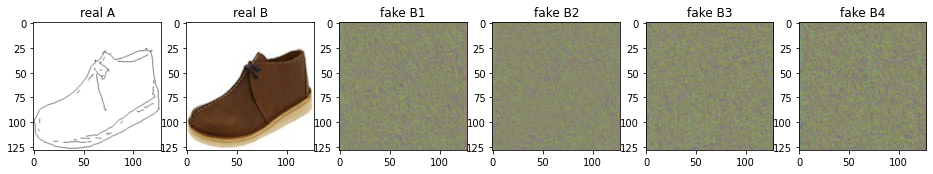

Train Epoch: 1 0% 	Total Loss: 15.563165 	Loss_GAN: 12.168020	Loss_GAN_VAE: 1.867222	Loss_GAN_LR: 1.914517	Loss_D_VAE: 1.554702	Loss_D_LR: 1.840443
0 9 T:  3.275881767272949
Train Epoch: 1 0% 	Total Loss: 9.277783 	Loss_GAN: 6.416255	Loss_GAN_VAE: 0.999873	Loss_GAN_LR: 1.109500	Loss_D_VAE: 1.449300	Loss_D_LR: 1.412227
0 19 T:  2.4440677165985107
Train Epoch: 1 0% 	Total Loss: 8.420413 	Loss_GAN: 5.752328	Loss_GAN_VAE: 1.069073	Loss_GAN_LR: 1.050752	Loss_D_VAE: 1.380893	Loss_D_LR: 1.287192
0 29 T:  2.4957404136657715
Train Epoch: 1 0% 	Total Loss: 9.552579 	Loss_GAN: 7.314971	Loss_GAN_VAE: 1.609919	Loss_GAN_LR: 1.737076	Loss_D_VAE: 1.153056	Loss_D_LR: 1.084552
0 39 T:  2.4691426753997803
Train Epoch: 1 0% 	Total Loss: 9.088771 	Loss_GAN: 6.615035	Loss_GAN_VAE: 1.097456	Loss_GAN_LR: 1.238254	Loss_D_VAE: 1.208754	Loss_D_LR: 1.264982
0 49 T:  2.639153003692627
Train Epoch: 1 0% 	Total Loss: 9.132842 	Loss_GAN: 7.438934	Loss_GAN_VAE: 1.749492	Loss_GAN_LR: 1.609929	Loss_D_VAE: 0.866704	Loss_

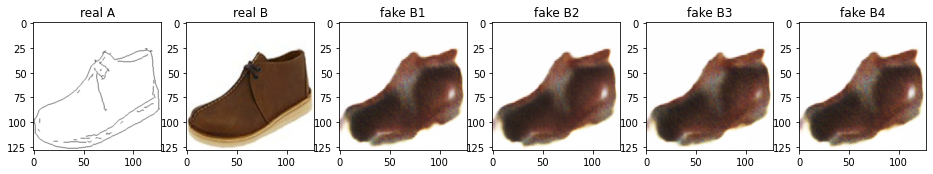

Train Epoch: 1 1% 	Total Loss: 6.636983 	Loss_GAN: 4.174047	Loss_GAN_VAE: 0.740106	Loss_GAN_LR: 1.236472	Loss_D_VAE: 1.454494	Loss_D_LR: 1.008442
0 509 T:  3.198636293411255
Train Epoch: 1 1% 	Total Loss: 7.059627 	Loss_GAN: 4.850969	Loss_GAN_VAE: 0.810296	Loss_GAN_LR: 1.643138	Loss_D_VAE: 1.318116	Loss_D_LR: 0.890543
0 519 T:  2.4801173210144043
Train Epoch: 1 1% 	Total Loss: 7.258543 	Loss_GAN: 4.737038	Loss_GAN_VAE: 0.838340	Loss_GAN_LR: 1.152408	Loss_D_VAE: 1.301479	Loss_D_LR: 1.220026
0 529 T:  2.4512979984283447
Train Epoch: 1 1% 	Total Loss: 7.809702 	Loss_GAN: 4.969346	Loss_GAN_VAE: 0.950385	Loss_GAN_LR: 1.341834	Loss_D_VAE: 1.394160	Loss_D_LR: 1.446195
0 539 T:  2.421168088912964
Train Epoch: 1 1% 	Total Loss: 6.644473 	Loss_GAN: 4.531067	Loss_GAN_VAE: 0.866704	Loss_GAN_LR: 1.184702	Loss_D_VAE: 1.169204	Loss_D_LR: 0.944202
0 549 T:  2.4048702716827393
Train Epoch: 1 1% 	Total Loss: 7.325802 	Loss_GAN: 4.363168	Loss_GAN_VAE: 1.068531	Loss_GAN_LR: 1.068945	Loss_D_VAE: 1.458660	L

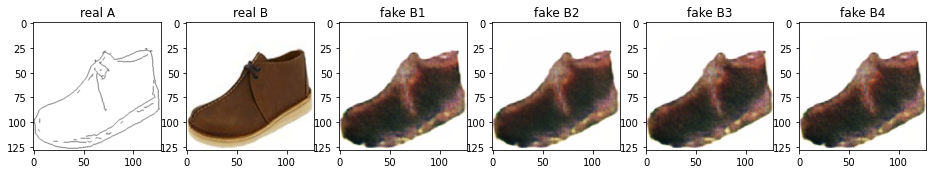

Train Epoch: 1 2% 	Total Loss: 6.174593 	Loss_GAN: 3.552018	Loss_GAN_VAE: 0.894501	Loss_GAN_LR: 0.934573	Loss_D_VAE: 1.299969	Loss_D_LR: 1.322606
0 1009 T:  3.8859236240386963
Train Epoch: 1 2% 	Total Loss: 6.349040 	Loss_GAN: 3.476609	Loss_GAN_VAE: 0.819758	Loss_GAN_LR: 0.823021	Loss_D_VAE: 1.434207	Loss_D_LR: 1.438224
0 1019 T:  2.4520435333251953
Train Epoch: 1 2% 	Total Loss: 6.125206 	Loss_GAN: 3.445746	Loss_GAN_VAE: 0.763845	Loss_GAN_LR: 0.789976	Loss_D_VAE: 1.362238	Loss_D_LR: 1.317222
0 1029 T:  2.4807522296905518
Train Epoch: 1 2% 	Total Loss: 6.185532 	Loss_GAN: 3.852612	Loss_GAN_VAE: 0.850746	Loss_GAN_LR: 0.922947	Loss_D_VAE: 1.213489	Loss_D_LR: 1.119431
0 1039 T:  2.7171642780303955
Train Epoch: 1 2% 	Total Loss: 7.401321 	Loss_GAN: 4.715255	Loss_GAN_VAE: 1.049635	Loss_GAN_LR: 1.159257	Loss_D_VAE: 1.355596	Loss_D_LR: 1.330470
0 1049 T:  2.492644786834717
Train Epoch: 1 2% 	Total Loss: 6.163010 	Loss_GAN: 3.428748	Loss_GAN_VAE: 0.792822	Loss_GAN_LR: 0.896205	Loss_D_VAE: 1.41

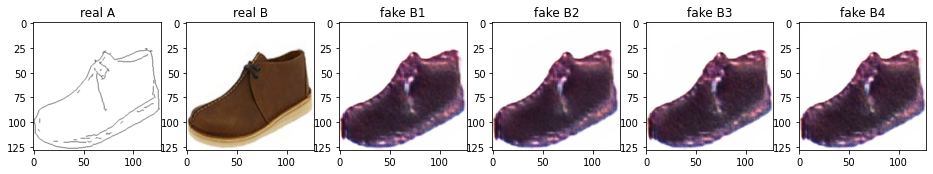

Train Epoch: 1 3% 	Total Loss: 6.402195 	Loss_GAN: 3.674836	Loss_GAN_VAE: 0.701324	Loss_GAN_LR: 0.939701	Loss_D_VAE: 1.453732	Loss_D_LR: 1.273628
0 1509 T:  3.136373996734619
Train Epoch: 1 3% 	Total Loss: 6.127250 	Loss_GAN: 3.806774	Loss_GAN_VAE: 0.808501	Loss_GAN_LR: 1.405217	Loss_D_VAE: 1.245579	Loss_D_LR: 1.074896
0 1519 T:  2.5081372261047363
Train Epoch: 1 3% 	Total Loss: 7.026330 	Loss_GAN: 4.800938	Loss_GAN_VAE: 1.021816	Loss_GAN_LR: 1.084141	Loss_D_VAE: 1.175551	Loss_D_LR: 1.049842
0 1529 T:  2.4244041442871094
Train Epoch: 1 3% 	Total Loss: 6.904560 	Loss_GAN: 3.960909	Loss_GAN_VAE: 0.848355	Loss_GAN_LR: 0.965465	Loss_D_VAE: 1.555245	Loss_D_LR: 1.388406
0 1539 T:  2.4547581672668457
Train Epoch: 1 3% 	Total Loss: 6.764393 	Loss_GAN: 3.984182	Loss_GAN_VAE: 0.950903	Loss_GAN_LR: 1.203119	Loss_D_VAE: 1.391586	Loss_D_LR: 1.388625
0 1549 T:  2.473872661590576
Train Epoch: 1 3% 	Total Loss: 6.265581 	Loss_GAN: 3.708350	Loss_GAN_VAE: 0.797307	Loss_GAN_LR: 0.849837	Loss_D_VAE: 1.291

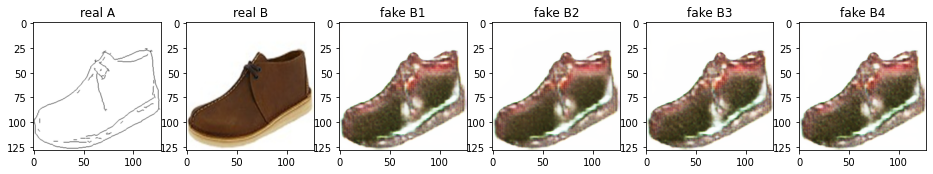

Train Epoch: 1 4% 	Total Loss: 7.139022 	Loss_GAN: 4.034302	Loss_GAN_VAE: 0.797771	Loss_GAN_LR: 1.075929	Loss_D_VAE: 1.478826	Loss_D_LR: 1.625894
0 2009 T:  3.742804527282715
Train Epoch: 1 4% 	Total Loss: 6.278190 	Loss_GAN: 3.576582	Loss_GAN_VAE: 0.790104	Loss_GAN_LR: 0.915986	Loss_D_VAE: 1.307165	Loss_D_LR: 1.394444
0 2019 T:  2.468445062637329
Train Epoch: 1 4% 	Total Loss: 6.383667 	Loss_GAN: 3.734019	Loss_GAN_VAE: 0.833935	Loss_GAN_LR: 0.892380	Loss_D_VAE: 1.301711	Loss_D_LR: 1.347937
0 2029 T:  2.499659299850464
Train Epoch: 1 4% 	Total Loss: 6.848631 	Loss_GAN: 4.102952	Loss_GAN_VAE: 0.834483	Loss_GAN_LR: 0.870537	Loss_D_VAE: 1.370462	Loss_D_LR: 1.375218
0 2039 T:  2.769301176071167
Train Epoch: 1 4% 	Total Loss: 6.675969 	Loss_GAN: 4.015479	Loss_GAN_VAE: 0.881306	Loss_GAN_LR: 1.000090	Loss_D_VAE: 1.318160	Loss_D_LR: 1.342329
0 2049 T:  2.4759786128997803
Train Epoch: 1 4% 	Total Loss: 6.567753 	Loss_GAN: 4.001704	Loss_GAN_VAE: 0.838662	Loss_GAN_LR: 0.942157	Loss_D_VAE: 1.34394

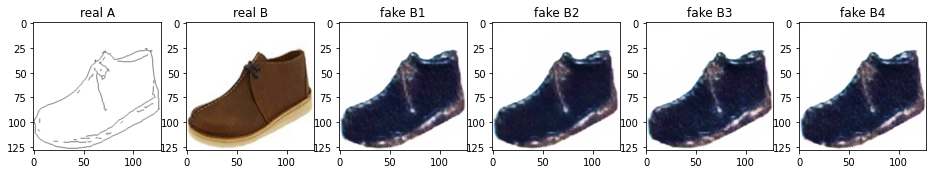

Train Epoch: 1 5% 	Total Loss: 7.088382 	Loss_GAN: 4.215412	Loss_GAN_VAE: 0.803184	Loss_GAN_LR: 1.116952	Loss_D_VAE: 1.363593	Loss_D_LR: 1.509377
0 2509 T:  3.2385923862457275
Train Epoch: 1 5% 	Total Loss: 6.521940 	Loss_GAN: 4.101711	Loss_GAN_VAE: 0.803645	Loss_GAN_LR: 0.933488	Loss_D_VAE: 1.237755	Loss_D_LR: 1.182475
0 2519 T:  2.5297558307647705
Train Epoch: 1 5% 	Total Loss: 7.161533 	Loss_GAN: 4.537918	Loss_GAN_VAE: 0.816538	Loss_GAN_LR: 1.040850	Loss_D_VAE: 1.338752	Loss_D_LR: 1.284864
0 2529 T:  2.4760780334472656
Train Epoch: 1 5% 	Total Loss: 6.775590 	Loss_GAN: 4.280094	Loss_GAN_VAE: 0.835582	Loss_GAN_LR: 1.383027	Loss_D_VAE: 1.484973	Loss_D_LR: 1.010524
0 2539 T:  2.539607524871826
Train Epoch: 1 5% 	Total Loss: 7.337946 	Loss_GAN: 4.740323	Loss_GAN_VAE: 0.795887	Loss_GAN_LR: 1.158795	Loss_D_VAE: 1.299280	Loss_D_LR: 1.298343
0 2549 T:  2.4899866580963135
Train Epoch: 1 5% 	Total Loss: 5.824351 	Loss_GAN: 3.061976	Loss_GAN_VAE: 0.766502	Loss_GAN_LR: 0.917960	Loss_D_VAE: 1.41

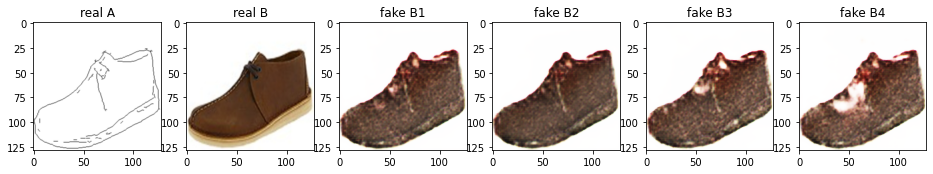

Train Epoch: 1 6% 	Total Loss: 5.857260 	Loss_GAN: 3.479009	Loss_GAN_VAE: 0.832345	Loss_GAN_LR: 1.169123	Loss_D_VAE: 1.243148	Loss_D_LR: 1.135103
0 3009 T:  3.7130815982818604
Train Epoch: 1 6% 	Total Loss: 6.498554 	Loss_GAN: 3.580369	Loss_GAN_VAE: 0.784977	Loss_GAN_LR: 0.830463	Loss_D_VAE: 1.473131	Loss_D_LR: 1.445053
0 3019 T:  2.4656357765197754
Train Epoch: 1 6% 	Total Loss: 5.783131 	Loss_GAN: 3.413388	Loss_GAN_VAE: 0.842618	Loss_GAN_LR: 0.958892	Loss_D_VAE: 1.281833	Loss_D_LR: 1.087910
0 3029 T:  2.6638946533203125
Train Epoch: 1 6% 	Total Loss: 6.187032 	Loss_GAN: 3.340458	Loss_GAN_VAE: 0.793035	Loss_GAN_LR: 0.941008	Loss_D_VAE: 1.402288	Loss_D_LR: 1.444285
0 3039 T:  2.6735479831695557
Train Epoch: 1 6% 	Total Loss: 5.904844 	Loss_GAN: 3.286534	Loss_GAN_VAE: 0.778316	Loss_GAN_LR: 0.865221	Loss_D_VAE: 1.381243	Loss_D_LR: 1.237066
0 3049 T:  2.429612159729004
Train Epoch: 1 6% 	Total Loss: 6.052888 	Loss_GAN: 3.442362	Loss_GAN_VAE: 0.827952	Loss_GAN_LR: 0.838049	Loss_D_VAE: 1.29

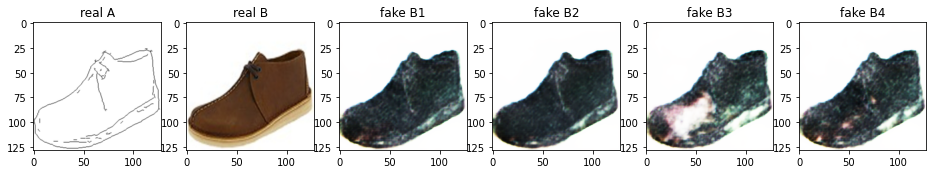

Train Epoch: 1 7% 	Total Loss: 5.778447 	Loss_GAN: 3.009374	Loss_GAN_VAE: 0.734212	Loss_GAN_LR: 0.797623	Loss_D_VAE: 1.412221	Loss_D_LR: 1.356851
0 3509 T:  3.167757272720337
Train Epoch: 1 7% 	Total Loss: 6.033763 	Loss_GAN: 3.612200	Loss_GAN_VAE: 0.753843	Loss_GAN_LR: 1.046112	Loss_D_VAE: 1.354250	Loss_D_LR: 1.067313
0 3519 T:  2.4922544956207275
Train Epoch: 1 7% 	Total Loss: 5.499905 	Loss_GAN: 2.763233	Loss_GAN_VAE: 0.752703	Loss_GAN_LR: 0.783609	Loss_D_VAE: 1.377409	Loss_D_LR: 1.359262
0 3529 T:  2.4820313453674316
Train Epoch: 1 7% 	Total Loss: 5.360319 	Loss_GAN: 2.860915	Loss_GAN_VAE: 0.702260	Loss_GAN_LR: 0.993227	Loss_D_VAE: 1.400721	Loss_D_LR: 1.098683
0 3539 T:  2.4648616313934326
Train Epoch: 1 7% 	Total Loss: 5.837622 	Loss_GAN: 3.448150	Loss_GAN_VAE: 0.762113	Loss_GAN_LR: 1.245768	Loss_D_VAE: 1.332956	Loss_D_LR: 1.056515
0 3549 T:  2.476280689239502
Train Epoch: 1 7% 	Total Loss: 6.387871 	Loss_GAN: 3.739127	Loss_GAN_VAE: 0.735787	Loss_GAN_LR: 1.094428	Loss_D_VAE: 1.383

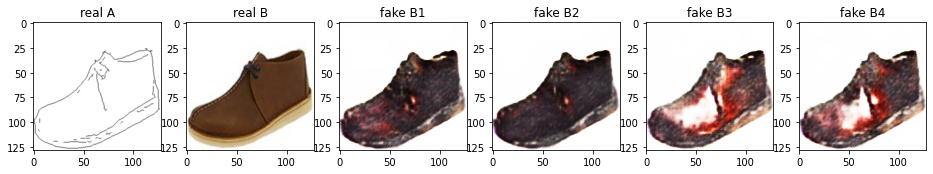

Train Epoch: 1 8% 	Total Loss: 6.028928 	Loss_GAN: 3.064231	Loss_GAN_VAE: 0.817383	Loss_GAN_LR: 0.871620	Loss_D_VAE: 1.374543	Loss_D_LR: 1.590153
0 4009 T:  3.865694999694824
Train Epoch: 1 8% 	Total Loss: 6.213635 	Loss_GAN: 3.543835	Loss_GAN_VAE: 0.806183	Loss_GAN_LR: 0.851616	Loss_D_VAE: 1.303754	Loss_D_LR: 1.366046
0 4019 T:  2.4802844524383545
Train Epoch: 1 8% 	Total Loss: 6.021422 	Loss_GAN: 3.551076	Loss_GAN_VAE: 0.878613	Loss_GAN_LR: 0.860340	Loss_D_VAE: 1.269758	Loss_D_LR: 1.200588
0 4029 T:  2.471144199371338
Train Epoch: 1 8% 	Total Loss: 6.004632 	Loss_GAN: 3.490637	Loss_GAN_VAE: 0.807959	Loss_GAN_LR: 0.955066	Loss_D_VAE: 1.371123	Loss_D_LR: 1.142872
0 4039 T:  2.7987172603607178
Train Epoch: 1 8% 	Total Loss: 6.188093 	Loss_GAN: 3.657947	Loss_GAN_VAE: 0.841144	Loss_GAN_LR: 1.090356	Loss_D_VAE: 1.344876	Loss_D_LR: 1.185270
0 4049 T:  2.546722173690796
Train Epoch: 1 8% 	Total Loss: 6.974092 	Loss_GAN: 4.367857	Loss_GAN_VAE: 0.877700	Loss_GAN_LR: 1.268176	Loss_D_VAE: 1.3749

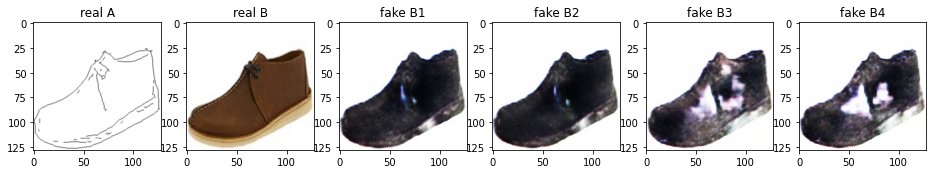

Train Epoch: 1 9% 	Total Loss: 6.312373 	Loss_GAN: 3.332273	Loss_GAN_VAE: 0.781691	Loss_GAN_LR: 0.800244	Loss_D_VAE: 1.569200	Loss_D_LR: 1.410899
0 4509 T:  3.157789468765259
Train Epoch: 1 9% 	Total Loss: 5.956474 	Loss_GAN: 3.209498	Loss_GAN_VAE: 0.857140	Loss_GAN_LR: 0.906747	Loss_D_VAE: 1.423285	Loss_D_LR: 1.323691
0 4519 T:  2.450065851211548
Train Epoch: 1 9% 	Total Loss: 5.663022 	Loss_GAN: 3.171391	Loss_GAN_VAE: 0.736328	Loss_GAN_LR: 0.994237	Loss_D_VAE: 1.523154	Loss_D_LR: 0.968478
0 4529 T:  2.527038812637329
Train Epoch: 1 9% 	Total Loss: 6.126870 	Loss_GAN: 3.425767	Loss_GAN_VAE: 0.748971	Loss_GAN_LR: 0.874619	Loss_D_VAE: 1.378151	Loss_D_LR: 1.322951
0 4539 T:  2.4528274536132812
Train Epoch: 1 9% 	Total Loss: 5.506782 	Loss_GAN: 2.906943	Loss_GAN_VAE: 0.767263	Loss_GAN_LR: 1.102511	Loss_D_VAE: 1.376264	Loss_D_LR: 1.223575
0 4549 T:  2.443234920501709
Train Epoch: 1 9% 	Total Loss: 5.829801 	Loss_GAN: 3.162348	Loss_GAN_VAE: 0.781712	Loss_GAN_LR: 0.918051	Loss_D_VAE: 1.36692

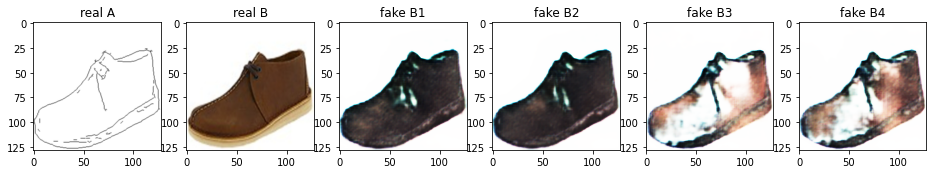

Train Epoch: 1 10% 	Total Loss: 6.454911 	Loss_GAN: 3.888688	Loss_GAN_VAE: 0.848557	Loss_GAN_LR: 0.977071	Loss_D_VAE: 1.304270	Loss_D_LR: 1.261953
0 5009 T:  4.378645658493042
Train Epoch: 1 10% 	Total Loss: 6.071792 	Loss_GAN: 3.247694	Loss_GAN_VAE: 0.806595	Loss_GAN_LR: 1.126967	Loss_D_VAE: 1.428061	Loss_D_LR: 1.396037
0 5019 T:  2.586392641067505
Train Epoch: 1 10% 	Total Loss: 5.763548 	Loss_GAN: 3.108626	Loss_GAN_VAE: 0.718485	Loss_GAN_LR: 0.975737	Loss_D_VAE: 1.413241	Loss_D_LR: 1.241681
0 5029 T:  2.464705228805542
Train Epoch: 1 10% 	Total Loss: 5.756611 	Loss_GAN: 3.145840	Loss_GAN_VAE: 0.781651	Loss_GAN_LR: 0.963951	Loss_D_VAE: 1.291449	Loss_D_LR: 1.319321
0 5039 T:  2.7993526458740234
Train Epoch: 1 10% 	Total Loss: 5.822233 	Loss_GAN: 3.352837	Loss_GAN_VAE: 0.887882	Loss_GAN_LR: 1.214793	Loss_D_VAE: 1.334396	Loss_D_LR: 1.135000
0 5049 T:  2.5623955726623535
Train Epoch: 1 10% 	Total Loss: 6.006000 	Loss_GAN: 3.466136	Loss_GAN_VAE: 0.791269	Loss_GAN_LR: 0.977589	Loss_D_VAE: 

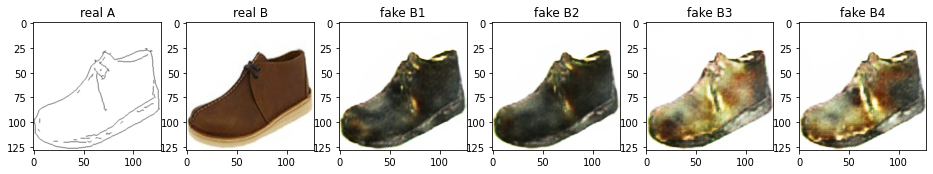

Train Epoch: 1 11% 	Total Loss: 5.840754 	Loss_GAN: 3.434221	Loss_GAN_VAE: 0.887400	Loss_GAN_LR: 0.946154	Loss_D_VAE: 1.279047	Loss_D_LR: 1.127486
0 5509 T:  3.2413158416748047
Train Epoch: 1 11% 	Total Loss: 6.143119 	Loss_GAN: 3.472521	Loss_GAN_VAE: 0.852638	Loss_GAN_LR: 0.913253	Loss_D_VAE: 1.369830	Loss_D_LR: 1.300767
0 5519 T:  2.6021242141723633
Train Epoch: 1 11% 	Total Loss: 6.167310 	Loss_GAN: 3.875802	Loss_GAN_VAE: 0.876619	Loss_GAN_LR: 0.991479	Loss_D_VAE: 1.191947	Loss_D_LR: 1.099560
0 5529 T:  2.540181875228882
Train Epoch: 1 11% 	Total Loss: 6.294776 	Loss_GAN: 3.730737	Loss_GAN_VAE: 0.860447	Loss_GAN_LR: 1.186265	Loss_D_VAE: 1.409466	Loss_D_LR: 1.154573
0 5539 T:  2.51088809967041
Train Epoch: 1 11% 	Total Loss: 6.007031 	Loss_GAN: 3.470961	Loss_GAN_VAE: 0.811442	Loss_GAN_LR: 0.943134	Loss_D_VAE: 1.353831	Loss_D_LR: 1.182240
0 5549 T:  2.4443533420562744
Train Epoch: 1 11% 	Total Loss: 6.579853 	Loss_GAN: 4.020167	Loss_GAN_VAE: 0.889745	Loss_GAN_LR: 1.225812	Loss_D_VAE: 

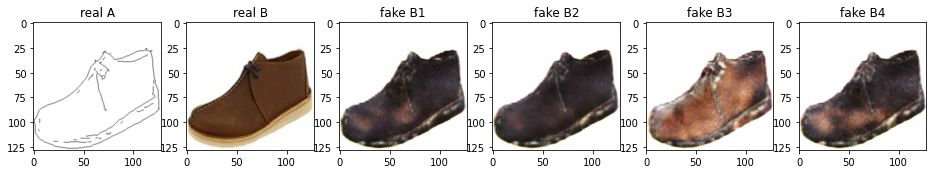

Train Epoch: 1 12% 	Total Loss: 5.936422 	Loss_GAN: 3.326180	Loss_GAN_VAE: 0.765362	Loss_GAN_LR: 0.894687	Loss_D_VAE: 1.435361	Loss_D_LR: 1.174881
0 6009 T:  3.820375442504883
Train Epoch: 1 12% 	Total Loss: 5.628512 	Loss_GAN: 3.063574	Loss_GAN_VAE: 0.768527	Loss_GAN_LR: 0.930573	Loss_D_VAE: 1.367625	Loss_D_LR: 1.197313
0 6019 T:  2.4719176292419434
Train Epoch: 1 12% 	Total Loss: 6.464504 	Loss_GAN: 3.854974	Loss_GAN_VAE: 0.829958	Loss_GAN_LR: 1.043403	Loss_D_VAE: 1.365235	Loss_D_LR: 1.244295
0 6029 T:  2.458658218383789
Train Epoch: 1 12% 	Total Loss: 5.834761 	Loss_GAN: 3.159686	Loss_GAN_VAE: 0.823956	Loss_GAN_LR: 1.041701	Loss_D_VAE: 1.361010	Loss_D_LR: 1.314066
0 6039 T:  2.69707989692688
Train Epoch: 1 12% 	Total Loss: 6.270970 	Loss_GAN: 3.426838	Loss_GAN_VAE: 0.838374	Loss_GAN_LR: 0.858020	Loss_D_VAE: 1.289866	Loss_D_LR: 1.554266
0 6049 T:  2.5316481590270996
Train Epoch: 1 12% 	Total Loss: 5.869192 	Loss_GAN: 3.596210	Loss_GAN_VAE: 0.948443	Loss_GAN_LR: 0.889671	Loss_D_VAE: 1

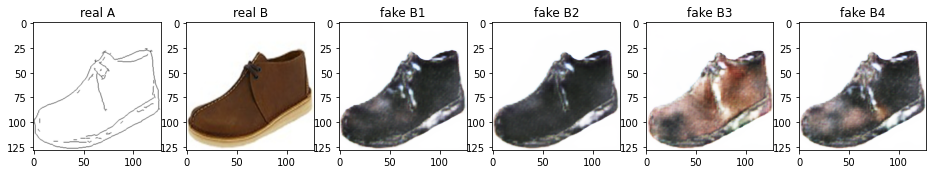

Train Epoch: 1 13% 	Total Loss: 6.785381 	Loss_GAN: 4.374280	Loss_GAN_VAE: 1.057902	Loss_GAN_LR: 1.136259	Loss_D_VAE: 1.269796	Loss_D_LR: 1.141305
0 6509 T:  3.140127658843994
Train Epoch: 1 13% 	Total Loss: 6.025160 	Loss_GAN: 3.688703	Loss_GAN_VAE: 0.894478	Loss_GAN_LR: 1.208713	Loss_D_VAE: 1.245697	Loss_D_LR: 1.090759
0 6519 T:  2.525207757949829
Train Epoch: 1 13% 	Total Loss: 6.320808 	Loss_GAN: 3.665118	Loss_GAN_VAE: 0.826203	Loss_GAN_LR: 0.974667	Loss_D_VAE: 1.363402	Loss_D_LR: 1.292288
0 6529 T:  2.4635555744171143
Train Epoch: 1 13% 	Total Loss: 7.087864 	Loss_GAN: 4.588747	Loss_GAN_VAE: 1.187455	Loss_GAN_LR: 1.250497	Loss_D_VAE: 1.146097	Loss_D_LR: 1.353020
0 6539 T:  2.435865879058838
Train Epoch: 1 13% 	Total Loss: 6.167895 	Loss_GAN: 3.483837	Loss_GAN_VAE: 1.007277	Loss_GAN_LR: 0.920883	Loss_D_VAE: 1.465029	Loss_D_LR: 1.219029
0 6549 T:  2.4567277431488037
Train Epoch: 1 13% 	Total Loss: 5.446503 	Loss_GAN: 2.820071	Loss_GAN_VAE: 0.732210	Loss_GAN_LR: 0.926521	Loss_D_VAE: 

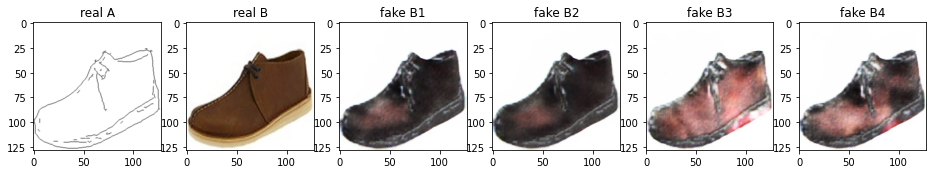

Train Epoch: 1 14% 	Total Loss: 5.683394 	Loss_GAN: 3.103165	Loss_GAN_VAE: 0.843916	Loss_GAN_LR: 0.932617	Loss_D_VAE: 1.293028	Loss_D_LR: 1.287200
0 7009 T:  3.855731725692749
Train Epoch: 1 14% 	Total Loss: 5.467034 	Loss_GAN: 2.923315	Loss_GAN_VAE: 0.866135	Loss_GAN_LR: 0.895178	Loss_D_VAE: 1.298121	Loss_D_LR: 1.245598
0 7019 T:  2.634744167327881
Train Epoch: 1 14% 	Total Loss: 5.755089 	Loss_GAN: 3.147406	Loss_GAN_VAE: 0.862714	Loss_GAN_LR: 0.961570	Loss_D_VAE: 1.406479	Loss_D_LR: 1.201205
0 7029 T:  2.484400749206543
Train Epoch: 1 14% 	Total Loss: 5.955000 	Loss_GAN: 4.097822	Loss_GAN_VAE: 1.067629	Loss_GAN_LR: 1.138276	Loss_D_VAE: 1.013019	Loss_D_LR: 0.844159
0 7039 T:  2.789278507232666
Train Epoch: 1 14% 	Total Loss: 5.989064 	Loss_GAN: 3.525425	Loss_GAN_VAE: 0.895641	Loss_GAN_LR: 1.020700	Loss_D_VAE: 1.290340	Loss_D_LR: 1.173300
0 7049 T:  2.5877459049224854
Train Epoch: 1 14% 	Total Loss: 6.775706 	Loss_GAN: 4.127726	Loss_GAN_VAE: 1.066019	Loss_GAN_LR: 1.181109	Loss_D_VAE: 1

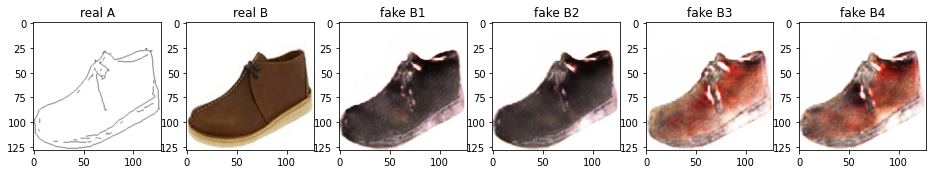

Train Epoch: 1 15% 	Total Loss: 6.061942 	Loss_GAN: 3.822879	Loss_GAN_VAE: 0.963257	Loss_GAN_LR: 1.031589	Loss_D_VAE: 1.157949	Loss_D_LR: 1.081114
0 7509 T:  3.1221988201141357
Train Epoch: 1 15% 	Total Loss: 6.513601 	Loss_GAN: 4.014832	Loss_GAN_VAE: 1.047809	Loss_GAN_LR: 1.216365	Loss_D_VAE: 1.229684	Loss_D_LR: 1.269084
0 7519 T:  2.5108087062835693
Train Epoch: 1 15% 	Total Loss: 6.117335 	Loss_GAN: 4.061853	Loss_GAN_VAE: 1.049841	Loss_GAN_LR: 1.248928	Loss_D_VAE: 1.175986	Loss_D_LR: 0.879496
0 7529 T:  2.444490909576416
Train Epoch: 1 15% 	Total Loss: 6.822474 	Loss_GAN: 3.924968	Loss_GAN_VAE: 1.023593	Loss_GAN_LR: 0.994869	Loss_D_VAE: 1.675951	Loss_D_LR: 1.221556
0 7539 T:  2.4436774253845215
Train Epoch: 1 15% 	Total Loss: 6.152917 	Loss_GAN: 3.899144	Loss_GAN_VAE: 0.962120	Loss_GAN_LR: 1.094748	Loss_D_VAE: 1.099196	Loss_D_LR: 1.154577
0 7549 T:  2.475403070449829
Train Epoch: 1 15% 	Total Loss: 6.099893 	Loss_GAN: 3.788546	Loss_GAN_VAE: 1.057282	Loss_GAN_LR: 1.209332	Loss_D_VAE:

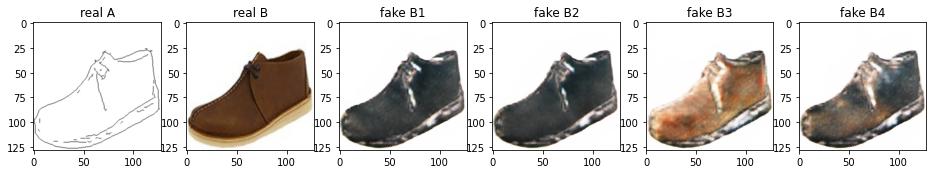

Train Epoch: 1 16% 	Total Loss: 5.916997 	Loss_GAN: 3.339623	Loss_GAN_VAE: 0.884158	Loss_GAN_LR: 0.949868	Loss_D_VAE: 1.336770	Loss_D_LR: 1.240604
0 8009 T:  4.382862567901611
Train Epoch: 1 16% 	Total Loss: 6.105148 	Loss_GAN: 3.769255	Loss_GAN_VAE: 0.857828	Loss_GAN_LR: 1.172300	Loss_D_VAE: 1.210668	Loss_D_LR: 1.125225
0 8019 T:  2.558702230453491
Train Epoch: 1 16% 	Total Loss: 6.138091 	Loss_GAN: 3.455365	Loss_GAN_VAE: 0.919560	Loss_GAN_LR: 1.116894	Loss_D_VAE: 1.359360	Loss_D_LR: 1.323366
0 8029 T:  2.502687454223633
Train Epoch: 1 16% 	Total Loss: 6.072796 	Loss_GAN: 3.365365	Loss_GAN_VAE: 0.909169	Loss_GAN_LR: 0.901750	Loss_D_VAE: 1.372726	Loss_D_LR: 1.334705
0 8039 T:  2.778534173965454
Train Epoch: 1 16% 	Total Loss: 6.375657 	Loss_GAN: 3.679700	Loss_GAN_VAE: 0.822396	Loss_GAN_LR: 1.016277	Loss_D_VAE: 1.340640	Loss_D_LR: 1.355316
0 8049 T:  2.4250292778015137
Train Epoch: 1 16% 	Total Loss: 6.234199 	Loss_GAN: 3.674668	Loss_GAN_VAE: 0.909194	Loss_GAN_LR: 0.969203	Loss_D_VAE: 1

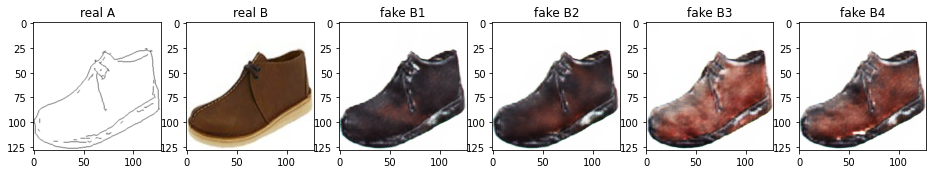

Train Epoch: 1 17% 	Total Loss: 5.908846 	Loss_GAN: 3.217736	Loss_GAN_VAE: 0.743616	Loss_GAN_LR: 0.931397	Loss_D_VAE: 1.457777	Loss_D_LR: 1.233332
0 8509 T:  3.2604453563690186
Train Epoch: 1 17% 	Total Loss: 6.591922 	Loss_GAN: 3.505041	Loss_GAN_VAE: 0.777653	Loss_GAN_LR: 0.803051	Loss_D_VAE: 1.428596	Loss_D_LR: 1.658285
0 8519 T:  2.5112717151641846
Train Epoch: 1 17% 	Total Loss: 5.864126 	Loss_GAN: 3.726702	Loss_GAN_VAE: 0.966415	Loss_GAN_LR: 1.004232	Loss_D_VAE: 1.096252	Loss_D_LR: 1.041173
0 8529 T:  2.4499199390411377
Train Epoch: 1 17% 	Total Loss: 5.380791 	Loss_GAN: 3.037834	Loss_GAN_VAE: 0.786608	Loss_GAN_LR: 1.014175	Loss_D_VAE: 1.413739	Loss_D_LR: 0.929219
0 8539 T:  2.4911253452301025
Train Epoch: 1 17% 	Total Loss: 5.977777 	Loss_GAN: 3.036146	Loss_GAN_VAE: 0.755213	Loss_GAN_LR: 0.780544	Loss_D_VAE: 1.407945	Loss_D_LR: 1.533687
0 8549 T:  2.447434663772583
Train Epoch: 1 17% 	Total Loss: 6.075381 	Loss_GAN: 3.805460	Loss_GAN_VAE: 0.965108	Loss_GAN_LR: 1.044290	Loss_D_VAE

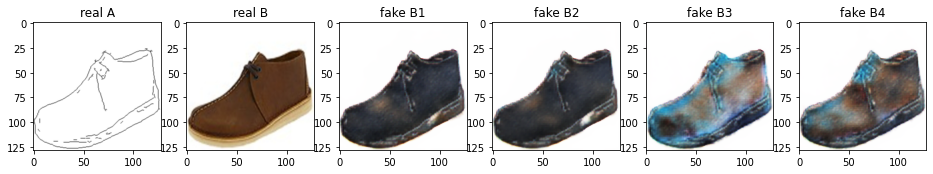

Train Epoch: 1 18% 	Total Loss: 6.317000 	Loss_GAN: 3.779640	Loss_GAN_VAE: 0.944857	Loss_GAN_LR: 1.157494	Loss_D_VAE: 1.296652	Loss_D_LR: 1.240708
0 9009 T:  3.8890185356140137
Train Epoch: 1 18% 	Total Loss: 6.402051 	Loss_GAN: 3.882731	Loss_GAN_VAE: 1.016494	Loss_GAN_LR: 1.044641	Loss_D_VAE: 1.478571	Loss_D_LR: 1.040749
0 9019 T:  2.483304977416992
Train Epoch: 1 18% 	Total Loss: 6.540518 	Loss_GAN: 3.859078	Loss_GAN_VAE: 0.847759	Loss_GAN_LR: 1.009535	Loss_D_VAE: 1.319329	Loss_D_LR: 1.362111
0 9029 T:  2.493100881576538
Train Epoch: 1 18% 	Total Loss: 5.885849 	Loss_GAN: 3.781813	Loss_GAN_VAE: 1.013476	Loss_GAN_LR: 1.279890	Loss_D_VAE: 1.178287	Loss_D_LR: 0.925750
0 9039 T:  2.757326364517212
Train Epoch: 1 18% 	Total Loss: 6.618490 	Loss_GAN: 5.090695	Loss_GAN_VAE: 1.356407	Loss_GAN_LR: 1.612540	Loss_D_VAE: 0.950841	Loss_D_LR: 0.576954
0 9049 T:  2.5082921981811523
Train Epoch: 1 18% 	Total Loss: 6.362751 	Loss_GAN: 3.923718	Loss_GAN_VAE: 0.898035	Loss_GAN_LR: 1.408048	Loss_D_VAE: 

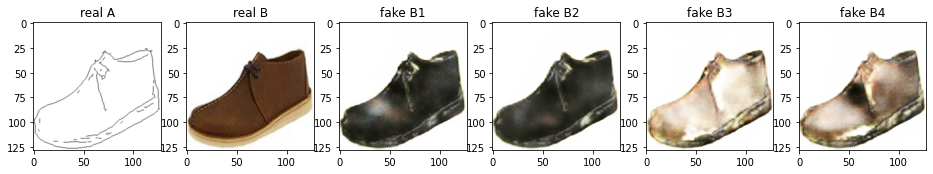

Train Epoch: 1 19% 	Total Loss: 6.412546 	Loss_GAN: 4.054955	Loss_GAN_VAE: 1.101137	Loss_GAN_LR: 0.880744	Loss_D_VAE: 1.130780	Loss_D_LR: 1.226810
0 9509 T:  3.1416544914245605
Train Epoch: 1 19% 	Total Loss: 6.202962 	Loss_GAN: 3.638017	Loss_GAN_VAE: 1.071264	Loss_GAN_LR: 0.980582	Loss_D_VAE: 1.236469	Loss_D_LR: 1.328476
0 9519 T:  2.458667039871216
Train Epoch: 1 19% 	Total Loss: 5.845211 	Loss_GAN: 3.591650	Loss_GAN_VAE: 1.086207	Loss_GAN_LR: 1.036199	Loss_D_VAE: 1.184426	Loss_D_LR: 1.069136
0 9529 T:  2.471247911453247
Train Epoch: 1 19% 	Total Loss: 6.009345 	Loss_GAN: 3.357327	Loss_GAN_VAE: 0.800966	Loss_GAN_LR: 1.112427	Loss_D_VAE: 1.371785	Loss_D_LR: 1.280233
0 9539 T:  2.5270307064056396
Train Epoch: 1 19% 	Total Loss: 6.223364 	Loss_GAN: 3.765371	Loss_GAN_VAE: 0.944172	Loss_GAN_LR: 1.091832	Loss_D_VAE: 1.285911	Loss_D_LR: 1.172081
0 9549 T:  2.4708452224731445
Train Epoch: 1 19% 	Total Loss: 5.773501 	Loss_GAN: 3.406472	Loss_GAN_VAE: 1.041748	Loss_GAN_LR: 1.026903	Loss_D_VAE:

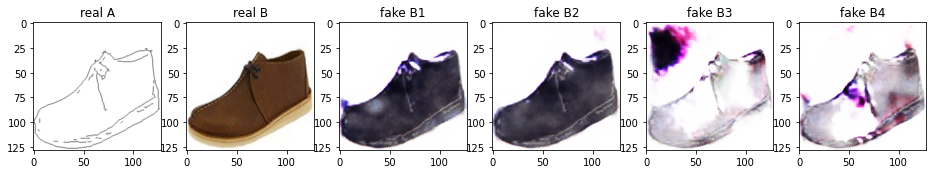

Train Epoch: 1 20% 	Total Loss: 6.347119 	Loss_GAN: 4.291732	Loss_GAN_VAE: 1.026177	Loss_GAN_LR: 1.385813	Loss_D_VAE: 1.130978	Loss_D_LR: 0.924409
0 10009 T:  3.892329692840576
Train Epoch: 1 20% 	Total Loss: 6.055575 	Loss_GAN: 3.820467	Loss_GAN_VAE: 0.930811	Loss_GAN_LR: 1.150193	Loss_D_VAE: 1.288948	Loss_D_LR: 0.946160
0 10019 T:  2.444890022277832
Train Epoch: 1 20% 	Total Loss: 6.017726 	Loss_GAN: 3.309299	Loss_GAN_VAE: 0.826148	Loss_GAN_LR: 1.084043	Loss_D_VAE: 1.410204	Loss_D_LR: 1.298223
0 10029 T:  2.4403185844421387
Train Epoch: 1 20% 	Total Loss: 5.990897 	Loss_GAN: 3.091609	Loss_GAN_VAE: 0.815031	Loss_GAN_LR: 0.797580	Loss_D_VAE: 1.399879	Loss_D_LR: 1.499409
0 10039 T:  2.7728323936462402
Train Epoch: 1 20% 	Total Loss: 5.795065 	Loss_GAN: 3.376671	Loss_GAN_VAE: 0.912799	Loss_GAN_LR: 1.032890	Loss_D_VAE: 1.196359	Loss_D_LR: 1.222035
0 10049 T:  2.475205659866333
Train Epoch: 1 20% 	Total Loss: 6.274014 	Loss_GAN: 3.661473	Loss_GAN_VAE: 0.860546	Loss_GAN_LR: 0.963946	Loss_D_

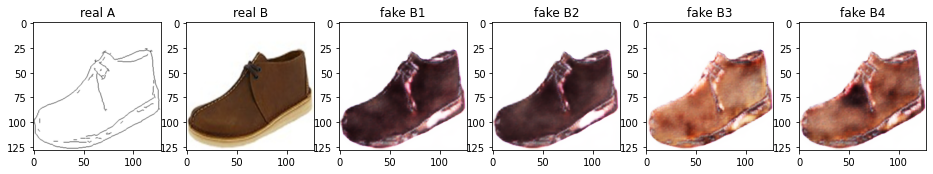

Train Epoch: 1 21% 	Total Loss: 6.348647 	Loss_GAN: 4.346861	Loss_GAN_VAE: 1.233401	Loss_GAN_LR: 1.331499	Loss_D_VAE: 1.074854	Loss_D_LR: 0.926933
0 10509 T:  3.1270060539245605
Train Epoch: 1 21% 	Total Loss: 5.824022 	Loss_GAN: 2.994820	Loss_GAN_VAE: 0.811432	Loss_GAN_LR: 0.915494	Loss_D_VAE: 1.418705	Loss_D_LR: 1.410497
0 10519 T:  2.5257773399353027
Train Epoch: 1 21% 	Total Loss: 5.584045 	Loss_GAN: 2.839984	Loss_GAN_VAE: 0.759629	Loss_GAN_LR: 0.867201	Loss_D_VAE: 1.373301	Loss_D_LR: 1.370760
0 10529 T:  2.491326332092285
Train Epoch: 1 21% 	Total Loss: 6.046446 	Loss_GAN: 3.351795	Loss_GAN_VAE: 0.795751	Loss_GAN_LR: 0.912161	Loss_D_VAE: 1.431291	Loss_D_LR: 1.263359
0 10539 T:  2.4355130195617676
Train Epoch: 1 21% 	Total Loss: 5.786736 	Loss_GAN: 3.411077	Loss_GAN_VAE: 0.835350	Loss_GAN_LR: 0.986700	Loss_D_VAE: 1.258181	Loss_D_LR: 1.117477
0 10549 T:  2.4806442260742188
Train Epoch: 1 21% 	Total Loss: 5.927192 	Loss_GAN: 3.495195	Loss_GAN_VAE: 0.937578	Loss_GAN_LR: 1.011298	Loss_

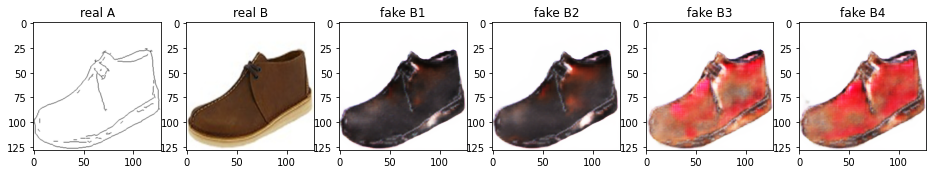

Train Epoch: 1 22% 	Total Loss: 5.621491 	Loss_GAN: 3.147674	Loss_GAN_VAE: 0.788953	Loss_GAN_LR: 1.087918	Loss_D_VAE: 1.307797	Loss_D_LR: 1.166020
0 11009 T:  4.415925741195679
Train Epoch: 1 22% 	Total Loss: 5.623363 	Loss_GAN: 2.913281	Loss_GAN_VAE: 0.788744	Loss_GAN_LR: 0.937373	Loss_D_VAE: 1.293056	Loss_D_LR: 1.417026
0 11019 T:  2.5179200172424316
Train Epoch: 1 22% 	Total Loss: 6.296540 	Loss_GAN: 3.525790	Loss_GAN_VAE: 0.864417	Loss_GAN_LR: 0.903678	Loss_D_VAE: 1.187116	Loss_D_LR: 1.583634
0 11029 T:  2.6292736530303955
Train Epoch: 1 22% 	Total Loss: 5.727385 	Loss_GAN: 3.046406	Loss_GAN_VAE: 0.937246	Loss_GAN_LR: 0.854283	Loss_D_VAE: 1.283680	Loss_D_LR: 1.397298
0 11039 T:  2.6067898273468018
Train Epoch: 1 22% 	Total Loss: 5.875126 	Loss_GAN: 3.326579	Loss_GAN_VAE: 0.936873	Loss_GAN_LR: 0.798690	Loss_D_VAE: 1.294401	Loss_D_LR: 1.254146
0 11049 T:  2.4719197750091553
Train Epoch: 1 22% 	Total Loss: 6.370969 	Loss_GAN: 3.589536	Loss_GAN_VAE: 0.903250	Loss_GAN_LR: 1.012423	Loss_

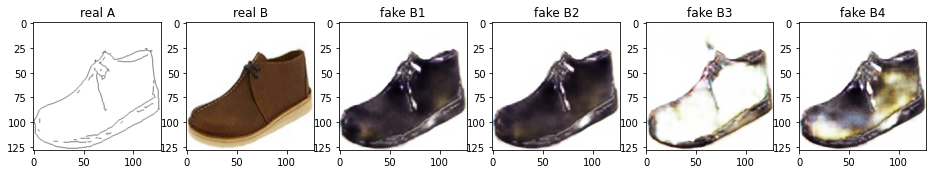

Train Epoch: 1 23% 	Total Loss: 6.277954 	Loss_GAN: 3.539889	Loss_GAN_VAE: 0.948571	Loss_GAN_LR: 0.994160	Loss_D_VAE: 1.329228	Loss_D_LR: 1.408837
0 11509 T:  3.1964564323425293
Train Epoch: 1 23% 	Total Loss: 6.438185 	Loss_GAN: 4.087260	Loss_GAN_VAE: 1.152620	Loss_GAN_LR: 1.036804	Loss_D_VAE: 1.153658	Loss_D_LR: 1.197267
0 11519 T:  2.469815731048584
Train Epoch: 1 23% 	Total Loss: 6.309309 	Loss_GAN: 3.505764	Loss_GAN_VAE: 0.898359	Loss_GAN_LR: 0.954434	Loss_D_VAE: 1.448032	Loss_D_LR: 1.355513
0 11529 T:  2.535290241241455
Train Epoch: 1 23% 	Total Loss: 6.258442 	Loss_GAN: 3.500605	Loss_GAN_VAE: 0.906171	Loss_GAN_LR: 1.031117	Loss_D_VAE: 1.441354	Loss_D_LR: 1.316483
0 11539 T:  2.55904221534729
Train Epoch: 1 23% 	Total Loss: 6.260989 	Loss_GAN: 3.971538	Loss_GAN_VAE: 1.128927	Loss_GAN_LR: 1.048886	Loss_D_VAE: 1.164113	Loss_D_LR: 1.125338
0 11549 T:  2.5659055709838867
Train Epoch: 1 23% 	Total Loss: 6.659630 	Loss_GAN: 3.843007	Loss_GAN_VAE: 0.913699	Loss_GAN_LR: 1.144569	Loss_D_V

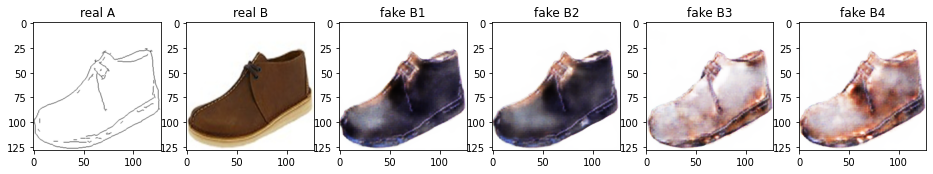

Train Epoch: 1 24% 	Total Loss: 5.837108 	Loss_GAN: 3.052712	Loss_GAN_VAE: 0.735892	Loss_GAN_LR: 0.893271	Loss_D_VAE: 1.501958	Loss_D_LR: 1.282439
0 12009 T:  3.7962822914123535
Train Epoch: 1 24% 	Total Loss: 6.378121 	Loss_GAN: 3.690579	Loss_GAN_VAE: 0.906047	Loss_GAN_LR: 0.801700	Loss_D_VAE: 1.251566	Loss_D_LR: 1.435976
0 12019 T:  2.443390369415283
Train Epoch: 1 24% 	Total Loss: 5.616614 	Loss_GAN: 3.034535	Loss_GAN_VAE: 0.853599	Loss_GAN_LR: 0.995473	Loss_D_VAE: 1.313479	Loss_D_LR: 1.268600
0 12029 T:  2.4609148502349854
Train Epoch: 1 24% 	Total Loss: 5.551502 	Loss_GAN: 2.958765	Loss_GAN_VAE: 0.807061	Loss_GAN_LR: 0.842859	Loss_D_VAE: 1.250291	Loss_D_LR: 1.342446
0 12039 T:  2.7467050552368164
Train Epoch: 1 24% 	Total Loss: 5.832507 	Loss_GAN: 3.142965	Loss_GAN_VAE: 0.848681	Loss_GAN_LR: 0.789037	Loss_D_VAE: 1.293781	Loss_D_LR: 1.395761
0 12049 T:  2.5413529872894287
Train Epoch: 1 24% 	Total Loss: 5.689766 	Loss_GAN: 3.161111	Loss_GAN_VAE: 0.884451	Loss_GAN_LR: 0.843368	Loss_

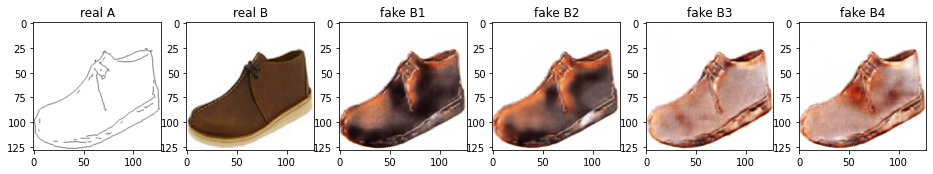

Train Epoch: 1 25% 	Total Loss: 6.021864 	Loss_GAN: 4.263053	Loss_GAN_VAE: 1.126617	Loss_GAN_LR: 1.449301	Loss_D_VAE: 0.934491	Loss_D_LR: 0.824320
0 12509 T:  3.245788812637329
Train Epoch: 1 25% 	Total Loss: 6.595608 	Loss_GAN: 3.529089	Loss_GAN_VAE: 0.951760	Loss_GAN_LR: 1.204264	Loss_D_VAE: 1.500544	Loss_D_LR: 1.565975
0 12519 T:  2.4853343963623047
Train Epoch: 1 25% 	Total Loss: 5.850949 	Loss_GAN: 3.382449	Loss_GAN_VAE: 0.953480	Loss_GAN_LR: 0.919626	Loss_D_VAE: 1.162348	Loss_D_LR: 1.306152
0 12529 T:  2.4933319091796875
Train Epoch: 1 25% 	Total Loss: 5.968053 	Loss_GAN: 3.142832	Loss_GAN_VAE: 0.829549	Loss_GAN_LR: 0.751157	Loss_D_VAE: 1.345484	Loss_D_LR: 1.479736
0 12539 T:  2.4075074195861816
Train Epoch: 1 25% 	Total Loss: 5.801820 	Loss_GAN: 3.301560	Loss_GAN_VAE: 0.887298	Loss_GAN_LR: 0.945705	Loss_D_VAE: 1.250451	Loss_D_LR: 1.249809
0 12549 T:  2.5996789932250977
Train Epoch: 1 25% 	Total Loss: 5.367256 	Loss_GAN: 3.120604	Loss_GAN_VAE: 1.003228	Loss_GAN_LR: 0.940004	Loss_

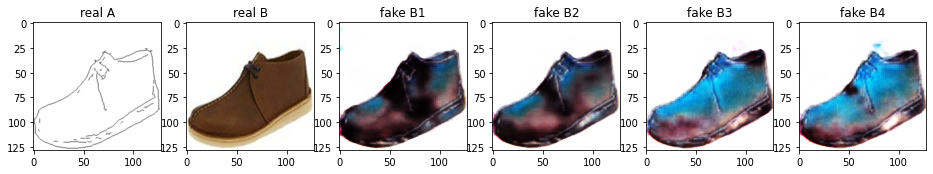

Train Epoch: 1 26% 	Total Loss: 6.721015 	Loss_GAN: 4.356564	Loss_GAN_VAE: 1.143999	Loss_GAN_LR: 1.387504	Loss_D_VAE: 1.491351	Loss_D_LR: 0.873099
0 13009 T:  3.9918081760406494
Train Epoch: 1 26% 	Total Loss: 7.071090 	Loss_GAN: 4.805998	Loss_GAN_VAE: 1.258209	Loss_GAN_LR: 1.523403	Loss_D_VAE: 1.254792	Loss_D_LR: 1.010301
0 13019 T:  2.513413906097412
Train Epoch: 1 26% 	Total Loss: 7.055047 	Loss_GAN: 3.614195	Loss_GAN_VAE: 0.873570	Loss_GAN_LR: 0.846761	Loss_D_VAE: 1.411094	Loss_D_LR: 2.029757
0 13029 T:  2.503962993621826
Train Epoch: 1 26% 	Total Loss: 6.133589 	Loss_GAN: 3.243626	Loss_GAN_VAE: 0.764696	Loss_GAN_LR: 0.895550	Loss_D_VAE: 1.415412	Loss_D_LR: 1.474552
0 13039 T:  2.849062919616699
Train Epoch: 1 26% 	Total Loss: 5.771059 	Loss_GAN: 3.530984	Loss_GAN_VAE: 0.843770	Loss_GAN_LR: 1.149267	Loss_D_VAE: 1.306126	Loss_D_LR: 0.933949
0 13049 T:  2.5519165992736816
Train Epoch: 1 26% 	Total Loss: 5.640014 	Loss_GAN: 2.969706	Loss_GAN_VAE: 0.759834	Loss_GAN_LR: 1.052301	Loss_D_

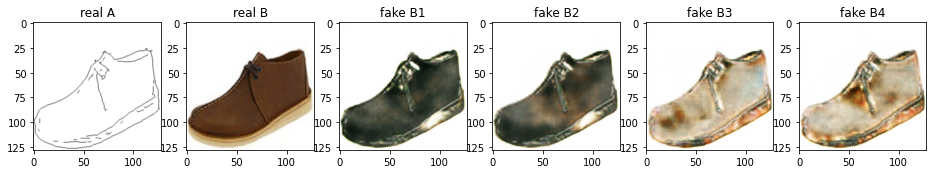

Train Epoch: 1 27% 	Total Loss: 5.963555 	Loss_GAN: 3.436234	Loss_GAN_VAE: 0.943919	Loss_GAN_LR: 0.919097	Loss_D_VAE: 1.320507	Loss_D_LR: 1.206814
0 13509 T:  3.235870599746704
Train Epoch: 1 27% 	Total Loss: 5.571887 	Loss_GAN: 2.826077	Loss_GAN_VAE: 0.779453	Loss_GAN_LR: 0.832798	Loss_D_VAE: 1.359869	Loss_D_LR: 1.385941
0 13519 T:  2.4736242294311523
Train Epoch: 1 27% 	Total Loss: 5.136044 	Loss_GAN: 2.833290	Loss_GAN_VAE: 0.878034	Loss_GAN_LR: 0.886839	Loss_D_VAE: 1.152056	Loss_D_LR: 1.150698
0 13529 T:  2.5000221729278564
Train Epoch: 1 27% 	Total Loss: 6.331315 	Loss_GAN: 3.575483	Loss_GAN_VAE: 0.899766	Loss_GAN_LR: 1.292101	Loss_D_VAE: 1.422285	Loss_D_LR: 1.333546
0 13539 T:  2.4754676818847656
Train Epoch: 1 27% 	Total Loss: 5.970664 	Loss_GAN: 3.856416	Loss_GAN_VAE: 0.980513	Loss_GAN_LR: 1.165215	Loss_D_VAE: 1.232913	Loss_D_LR: 0.881335
0 13549 T:  2.5183985233306885
Train Epoch: 1 27% 	Total Loss: 6.082959 	Loss_GAN: 3.818665	Loss_GAN_VAE: 1.036517	Loss_GAN_LR: 1.054563	Loss_

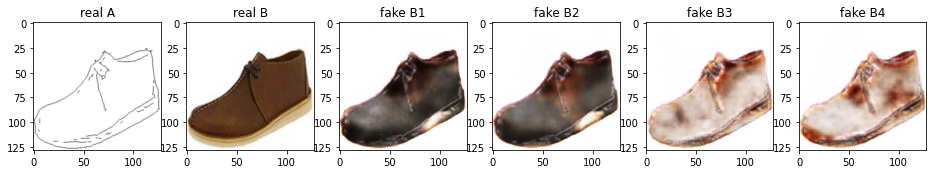

Train Epoch: 1 28% 	Total Loss: 5.958269 	Loss_GAN: 3.462376	Loss_GAN_VAE: 0.862259	Loss_GAN_LR: 0.965895	Loss_D_VAE: 1.215106	Loss_D_LR: 1.280788
0 14009 T:  4.355269432067871
Train Epoch: 1 28% 	Total Loss: 5.862780 	Loss_GAN: 3.390867	Loss_GAN_VAE: 0.902750	Loss_GAN_LR: 0.919655	Loss_D_VAE: 1.327823	Loss_D_LR: 1.144090
0 14019 T:  2.510855197906494
Train Epoch: 1 28% 	Total Loss: 6.083927 	Loss_GAN: 3.171427	Loss_GAN_VAE: 0.830456	Loss_GAN_LR: 1.143600	Loss_D_VAE: 1.314400	Loss_D_LR: 1.598100
0 14029 T:  2.5720391273498535
Train Epoch: 1 28% 	Total Loss: 5.872920 	Loss_GAN: 3.310346	Loss_GAN_VAE: 0.896552	Loss_GAN_LR: 0.987190	Loss_D_VAE: 1.268399	Loss_D_LR: 1.294175
0 14039 T:  2.838662624359131
Train Epoch: 1 28% 	Total Loss: 5.829355 	Loss_GAN: 2.864626	Loss_GAN_VAE: 0.708738	Loss_GAN_LR: 0.797246	Loss_D_VAE: 1.515577	Loss_D_LR: 1.449152
0 14049 T:  2.5557429790496826
Train Epoch: 1 28% 	Total Loss: 5.457579 	Loss_GAN: 2.892341	Loss_GAN_VAE: 0.893427	Loss_GAN_LR: 0.827951	Loss_D_

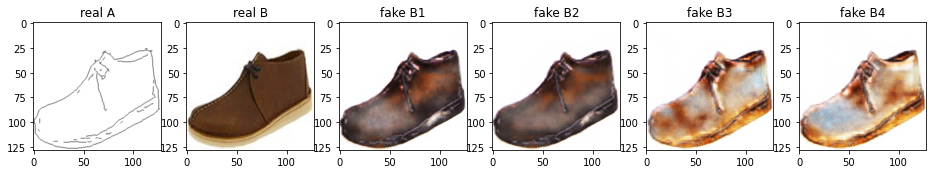

Train Epoch: 1 29% 	Total Loss: 6.077401 	Loss_GAN: 4.022633	Loss_GAN_VAE: 1.026102	Loss_GAN_LR: 1.339716	Loss_D_VAE: 1.034637	Loss_D_LR: 1.020130
0 14509 T:  3.1204934120178223
Train Epoch: 1 29% 	Total Loss: 6.175748 	Loss_GAN: 3.458479	Loss_GAN_VAE: 0.834661	Loss_GAN_LR: 0.876998	Loss_D_VAE: 1.263960	Loss_D_LR: 1.453309
0 14519 T:  2.4826109409332275
Train Epoch: 1 29% 	Total Loss: 6.097827 	Loss_GAN: 3.391189	Loss_GAN_VAE: 0.808330	Loss_GAN_LR: 0.974549	Loss_D_VAE: 1.531468	Loss_D_LR: 1.175170
0 14529 T:  2.465644598007202
Train Epoch: 1 29% 	Total Loss: 5.723664 	Loss_GAN: 3.250683	Loss_GAN_VAE: 0.804547	Loss_GAN_LR: 0.948169	Loss_D_VAE: 1.279205	Loss_D_LR: 1.193776
0 14539 T:  2.546910285949707
Train Epoch: 1 29% 	Total Loss: 6.041124 	Loss_GAN: 3.954295	Loss_GAN_VAE: 1.025125	Loss_GAN_LR: 0.956783	Loss_D_VAE: 0.931150	Loss_D_LR: 1.155679
0 14549 T:  2.4304609298706055
Train Epoch: 1 29% 	Total Loss: 6.294885 	Loss_GAN: 3.692149	Loss_GAN_VAE: 0.999607	Loss_GAN_LR: 1.083529	Loss_D

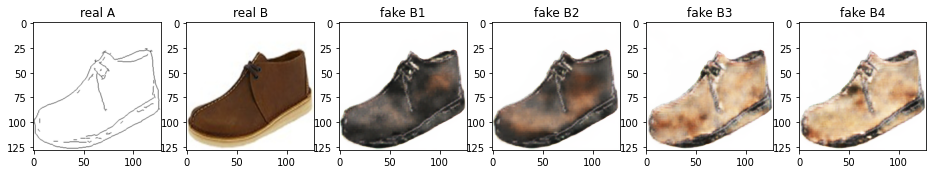

Train Epoch: 1 30% 	Total Loss: 6.960789 	Loss_GAN: 4.253329	Loss_GAN_VAE: 1.460186	Loss_GAN_LR: 0.907914	Loss_D_VAE: 1.441475	Loss_D_LR: 1.265985
0 15009 T:  3.8733081817626953
Train Epoch: 1 30% 	Total Loss: 5.916395 	Loss_GAN: 3.105803	Loss_GAN_VAE: 0.875134	Loss_GAN_LR: 0.775848	Loss_D_VAE: 1.342975	Loss_D_LR: 1.467617
0 15019 T:  2.466998338699341
Train Epoch: 1 30% 	Total Loss: 5.220407 	Loss_GAN: 2.672891	Loss_GAN_VAE: 0.794079	Loss_GAN_LR: 0.788785	Loss_D_VAE: 1.195298	Loss_D_LR: 1.352217
0 15029 T:  2.441114664077759
Train Epoch: 1 30% 	Total Loss: 5.706903 	Loss_GAN: 3.228659	Loss_GAN_VAE: 1.055497	Loss_GAN_LR: 0.938624	Loss_D_VAE: 1.294680	Loss_D_LR: 1.183564
0 15039 T:  2.7929022312164307
Train Epoch: 1 30% 	Total Loss: 5.655156 	Loss_GAN: 2.783176	Loss_GAN_VAE: 0.818288	Loss_GAN_LR: 0.764187	Loss_D_VAE: 1.474747	Loss_D_LR: 1.397233
0 15049 T:  2.5158634185791016
Train Epoch: 1 30% 	Total Loss: 5.875751 	Loss_GAN: 3.645542	Loss_GAN_VAE: 0.992810	Loss_GAN_LR: 0.983751	Loss_D

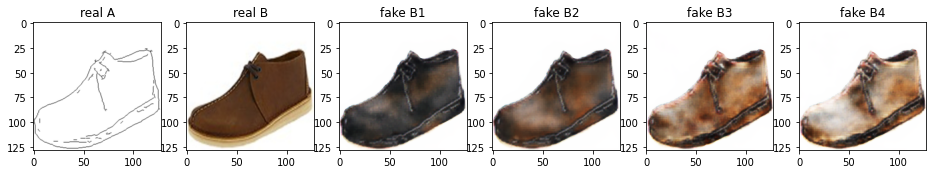

Train Epoch: 1 31% 	Total Loss: 5.980273 	Loss_GAN: 3.245645	Loss_GAN_VAE: 1.012319	Loss_GAN_LR: 0.915928	Loss_D_VAE: 1.149903	Loss_D_LR: 1.584725
0 15509 T:  3.130070209503174
Train Epoch: 1 31% 	Total Loss: 5.885376 	Loss_GAN: 3.038329	Loss_GAN_VAE: 0.752766	Loss_GAN_LR: 0.758038	Loss_D_VAE: 1.474120	Loss_D_LR: 1.372927
0 15519 T:  2.5338134765625
Train Epoch: 1 31% 	Total Loss: 5.732692 	Loss_GAN: 3.093171	Loss_GAN_VAE: 0.841231	Loss_GAN_LR: 0.906957	Loss_D_VAE: 1.274153	Loss_D_LR: 1.365368
0 15529 T:  2.5337812900543213
Train Epoch: 1 31% 	Total Loss: 5.651387 	Loss_GAN: 3.322164	Loss_GAN_VAE: 0.889748	Loss_GAN_LR: 1.025104	Loss_D_VAE: 1.231222	Loss_D_LR: 1.098000
0 15539 T:  2.5067789554595947
Train Epoch: 1 31% 	Total Loss: 5.853542 	Loss_GAN: 3.231240	Loss_GAN_VAE: 0.935058	Loss_GAN_LR: 0.776118	Loss_D_VAE: 1.283054	Loss_D_LR: 1.339248
0 15549 T:  2.419706106185913
Train Epoch: 1 31% 	Total Loss: 5.795824 	Loss_GAN: 2.893337	Loss_GAN_VAE: 0.957806	Loss_GAN_LR: 0.738924	Loss_D_VA

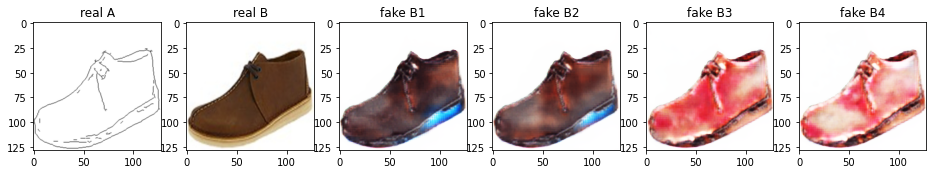

Train Epoch: 1 32% 	Total Loss: 5.752504 	Loss_GAN: 3.384065	Loss_GAN_VAE: 0.897833	Loss_GAN_LR: 1.105079	Loss_D_VAE: 1.232213	Loss_D_LR: 1.136226
0 16009 T:  3.9186458587646484
Train Epoch: 1 32% 	Total Loss: 6.513839 	Loss_GAN: 3.818607	Loss_GAN_VAE: 0.879248	Loss_GAN_LR: 1.173513	Loss_D_VAE: 1.299107	Loss_D_LR: 1.396125
0 16019 T:  2.3903000354766846
Train Epoch: 1 32% 	Total Loss: 5.914064 	Loss_GAN: 3.107346	Loss_GAN_VAE: 0.798154	Loss_GAN_LR: 0.918008	Loss_D_VAE: 1.370207	Loss_D_LR: 1.436511
0 16029 T:  2.4279537200927734
Train Epoch: 1 32% 	Total Loss: 6.235387 	Loss_GAN: 3.507678	Loss_GAN_VAE: 0.815202	Loss_GAN_LR: 0.843326	Loss_D_VAE: 1.364724	Loss_D_LR: 1.362984
0 16039 T:  2.6803998947143555
Train Epoch: 1 32% 	Total Loss: 5.826444 	Loss_GAN: 3.560353	Loss_GAN_VAE: 0.851940	Loss_GAN_LR: 1.208556	Loss_D_VAE: 1.264348	Loss_D_LR: 1.001744
0 16049 T:  2.5409436225891113
Train Epoch: 1 32% 	Total Loss: 5.971849 	Loss_GAN: 3.455902	Loss_GAN_VAE: 1.027835	Loss_GAN_LR: 0.829391	Loss

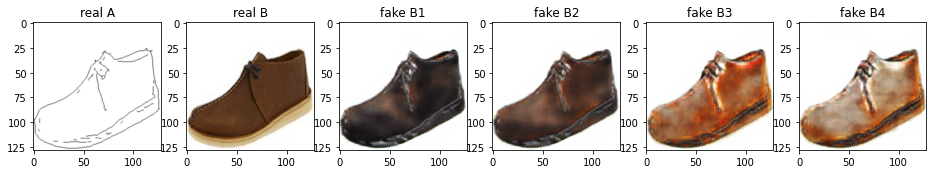

Train Epoch: 1 33% 	Total Loss: 5.648721 	Loss_GAN: 3.162392	Loss_GAN_VAE: 0.883769	Loss_GAN_LR: 0.882150	Loss_D_VAE: 1.269077	Loss_D_LR: 1.217251
0 16509 T:  3.1454851627349854
Train Epoch: 1 33% 	Total Loss: 5.827056 	Loss_GAN: 3.192371	Loss_GAN_VAE: 0.782567	Loss_GAN_LR: 0.902101	Loss_D_VAE: 1.465285	Loss_D_LR: 1.169399
0 16519 T:  2.576434850692749
Train Epoch: 1 33% 	Total Loss: 5.533754 	Loss_GAN: 3.115280	Loss_GAN_VAE: 0.893063	Loss_GAN_LR: 0.859297	Loss_D_VAE: 1.219391	Loss_D_LR: 1.199083
0 16529 T:  2.4566750526428223
Train Epoch: 1 33% 	Total Loss: 5.615960 	Loss_GAN: 3.199871	Loss_GAN_VAE: 0.893590	Loss_GAN_LR: 0.972250	Loss_D_VAE: 1.207883	Loss_D_LR: 1.208206
0 16539 T:  2.5820059776306152
Train Epoch: 1 33% 	Total Loss: 5.897734 	Loss_GAN: 3.472782	Loss_GAN_VAE: 0.947589	Loss_GAN_LR: 0.912520	Loss_D_VAE: 1.277921	Loss_D_LR: 1.147032
0 16549 T:  2.474951982498169
Train Epoch: 1 33% 	Total Loss: 5.738290 	Loss_GAN: 3.258808	Loss_GAN_VAE: 0.786242	Loss_GAN_LR: 1.080123	Loss_D

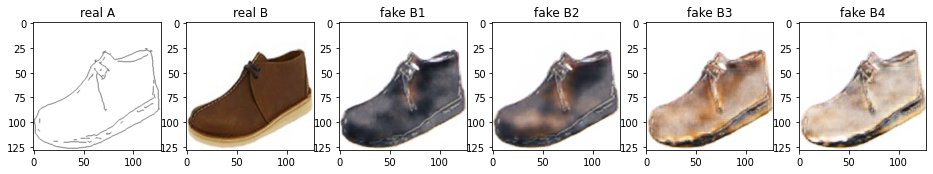

Train Epoch: 1 34% 	Total Loss: 5.827634 	Loss_GAN: 3.266135	Loss_GAN_VAE: 0.976280	Loss_GAN_LR: 0.928967	Loss_D_VAE: 1.062162	Loss_D_LR: 1.499338
0 17009 T:  4.381298542022705
Train Epoch: 1 34% 	Total Loss: 5.847754 	Loss_GAN: 3.442849	Loss_GAN_VAE: 0.943354	Loss_GAN_LR: 0.984401	Loss_D_VAE: 1.277775	Loss_D_LR: 1.127130
0 17019 T:  2.601017475128174
Train Epoch: 1 34% 	Total Loss: 6.323297 	Loss_GAN: 3.616605	Loss_GAN_VAE: 0.826689	Loss_GAN_LR: 1.047385	Loss_D_VAE: 1.443090	Loss_D_LR: 1.263602
0 17029 T:  2.5721869468688965
Train Epoch: 1 34% 	Total Loss: 6.104827 	Loss_GAN: 3.588166	Loss_GAN_VAE: 0.903796	Loss_GAN_LR: 1.036658	Loss_D_VAE: 1.296329	Loss_D_LR: 1.220332
0 17039 T:  2.855991840362549
Train Epoch: 1 34% 	Total Loss: 5.664436 	Loss_GAN: 3.052480	Loss_GAN_VAE: 0.783312	Loss_GAN_LR: 0.819080	Loss_D_VAE: 1.293589	Loss_D_LR: 1.318367
0 17049 T:  2.422163486480713
Train Epoch: 1 34% 	Total Loss: 5.731056 	Loss_GAN: 3.149079	Loss_GAN_VAE: 0.846092	Loss_GAN_LR: 0.938920	Loss_D_V

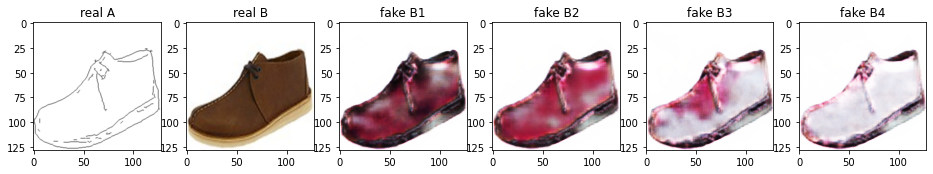

Train Epoch: 1 35% 	Total Loss: 6.075534 	Loss_GAN: 3.842901	Loss_GAN_VAE: 0.933119	Loss_GAN_LR: 1.143052	Loss_D_VAE: 1.172851	Loss_D_LR: 1.059781
0 17509 T:  3.1635208129882812
Train Epoch: 1 35% 	Total Loss: 5.964764 	Loss_GAN: 3.405098	Loss_GAN_VAE: 0.818530	Loss_GAN_LR: 1.056835	Loss_D_VAE: 1.356756	Loss_D_LR: 1.202910
0 17519 T:  2.429811954498291
Train Epoch: 1 35% 	Total Loss: 5.461035 	Loss_GAN: 2.817678	Loss_GAN_VAE: 0.786245	Loss_GAN_LR: 0.872534	Loss_D_VAE: 1.290899	Loss_D_LR: 1.352458
0 17529 T:  2.485414505004883
Train Epoch: 1 35% 	Total Loss: 5.735133 	Loss_GAN: 3.143194	Loss_GAN_VAE: 0.834786	Loss_GAN_LR: 0.913686	Loss_D_VAE: 1.324595	Loss_D_LR: 1.267344
0 17539 T:  2.503124713897705
Train Epoch: 1 35% 	Total Loss: 5.595031 	Loss_GAN: 2.960334	Loss_GAN_VAE: 0.944905	Loss_GAN_LR: 0.844629	Loss_D_VAE: 1.263584	Loss_D_LR: 1.371113
0 17549 T:  2.524040699005127
Train Epoch: 1 35% 	Total Loss: 5.814710 	Loss_GAN: 3.340969	Loss_GAN_VAE: 0.882630	Loss_GAN_LR: 0.952191	Loss_D_V

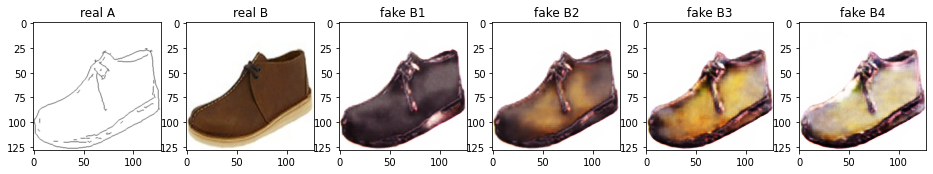

Train Epoch: 1 36% 	Total Loss: 5.828383 	Loss_GAN: 3.204463	Loss_GAN_VAE: 0.798563	Loss_GAN_LR: 0.930503	Loss_D_VAE: 1.345015	Loss_D_LR: 1.278906
0 18009 T:  3.9596681594848633
Train Epoch: 1 36% 	Total Loss: 6.217485 	Loss_GAN: 4.346336	Loss_GAN_VAE: 1.028176	Loss_GAN_LR: 1.365578	Loss_D_VAE: 1.194859	Loss_D_LR: 0.676290
0 18019 T:  2.595353126525879
Train Epoch: 1 36% 	Total Loss: 6.583379 	Loss_GAN: 4.639272	Loss_GAN_VAE: 1.266595	Loss_GAN_LR: 1.734967	Loss_D_VAE: 1.108200	Loss_D_LR: 0.835906
0 18029 T:  2.4225869178771973
Train Epoch: 1 36% 	Total Loss: 5.626974 	Loss_GAN: 2.887591	Loss_GAN_VAE: 0.687073	Loss_GAN_LR: 0.985831	Loss_D_VAE: 1.606136	Loss_D_LR: 1.133248
0 18039 T:  2.877967357635498
Train Epoch: 1 36% 	Total Loss: 5.921138 	Loss_GAN: 3.150214	Loss_GAN_VAE: 0.723694	Loss_GAN_LR: 1.026122	Loss_D_VAE: 1.353565	Loss_D_LR: 1.417360
0 18049 T:  2.56868314743042
Train Epoch: 1 36% 	Total Loss: 5.903775 	Loss_GAN: 3.526941	Loss_GAN_VAE: 0.915053	Loss_GAN_LR: 1.246840	Loss_D_V

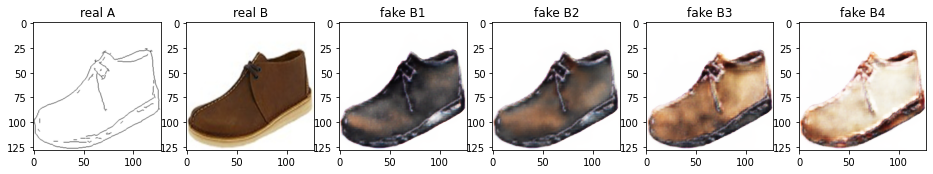

Train Epoch: 1 37% 	Total Loss: 6.239756 	Loss_GAN: 3.385712	Loss_GAN_VAE: 0.786829	Loss_GAN_LR: 0.946058	Loss_D_VAE: 1.412661	Loss_D_LR: 1.441383
0 18509 T:  3.2172374725341797
Train Epoch: 1 37% 	Total Loss: 5.696497 	Loss_GAN: 3.632205	Loss_GAN_VAE: 0.896945	Loss_GAN_LR: 1.286256	Loss_D_VAE: 1.214032	Loss_D_LR: 0.850260
0 18519 T:  2.547750473022461
Train Epoch: 1 37% 	Total Loss: 5.633919 	Loss_GAN: 3.298306	Loss_GAN_VAE: 0.950705	Loss_GAN_LR: 1.095214	Loss_D_VAE: 1.354103	Loss_D_LR: 0.981510
0 18529 T:  2.440019130706787
Train Epoch: 1 37% 	Total Loss: 5.987069 	Loss_GAN: 3.246808	Loss_GAN_VAE: 0.819740	Loss_GAN_LR: 1.038252	Loss_D_VAE: 1.318978	Loss_D_LR: 1.421284
0 18539 T:  2.498657703399658
Train Epoch: 1 37% 	Total Loss: 5.510766 	Loss_GAN: 2.972355	Loss_GAN_VAE: 0.805855	Loss_GAN_LR: 0.778663	Loss_D_VAE: 1.249962	Loss_D_LR: 1.288449
0 18549 T:  2.478508949279785
Train Epoch: 1 37% 	Total Loss: 5.890339 	Loss_GAN: 3.379039	Loss_GAN_VAE: 0.857993	Loss_GAN_LR: 1.127700	Loss_D_V

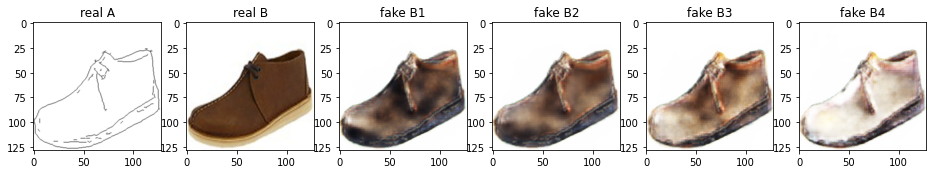

Train Epoch: 1 38% 	Total Loss: 6.044999 	Loss_GAN: 3.406883	Loss_GAN_VAE: 0.931329	Loss_GAN_LR: 0.829469	Loss_D_VAE: 1.207500	Loss_D_LR: 1.430617
0 19009 T:  3.824398994445801
Train Epoch: 1 38% 	Total Loss: 5.597429 	Loss_GAN: 3.186041	Loss_GAN_VAE: 0.883902	Loss_GAN_LR: 0.938554	Loss_D_VAE: 1.212505	Loss_D_LR: 1.198883
0 19019 T:  2.4385812282562256
Train Epoch: 1 38% 	Total Loss: 5.554999 	Loss_GAN: 3.347646	Loss_GAN_VAE: 1.018523	Loss_GAN_LR: 0.949990	Loss_D_VAE: 1.170971	Loss_D_LR: 1.036382
0 19029 T:  2.4833853244781494
Train Epoch: 1 38% 	Total Loss: 5.994449 	Loss_GAN: 3.282828	Loss_GAN_VAE: 0.838687	Loss_GAN_LR: 0.869965	Loss_D_VAE: 1.353074	Loss_D_LR: 1.358547
0 19039 T:  2.779928684234619
Train Epoch: 1 38% 	Total Loss: 5.757994 	Loss_GAN: 3.020816	Loss_GAN_VAE: 0.773209	Loss_GAN_LR: 0.911579	Loss_D_VAE: 1.477745	Loss_D_LR: 1.259432
0 19049 T:  2.61970853805542
Train Epoch: 1 38% 	Total Loss: 6.061592 	Loss_GAN: 3.745042	Loss_GAN_VAE: 0.819770	Loss_GAN_LR: 0.943467	Loss_D_V

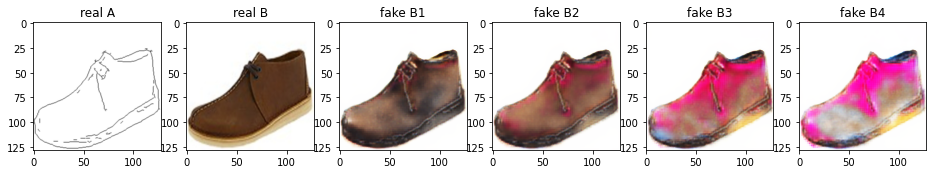

Train Epoch: 1 39% 	Total Loss: 6.169370 	Loss_GAN: 3.218538	Loss_GAN_VAE: 0.736341	Loss_GAN_LR: 0.899252	Loss_D_VAE: 1.515455	Loss_D_LR: 1.435377
0 19509 T:  3.28790545463562
Train Epoch: 1 39% 	Total Loss: 5.741464 	Loss_GAN: 2.992238	Loss_GAN_VAE: 0.737864	Loss_GAN_LR: 0.861604	Loss_D_VAE: 1.382859	Loss_D_LR: 1.366367
0 19519 T:  2.5272393226623535
Train Epoch: 1 39% 	Total Loss: 5.739296 	Loss_GAN: 2.869976	Loss_GAN_VAE: 0.833850	Loss_GAN_LR: 0.831262	Loss_D_VAE: 1.417395	Loss_D_LR: 1.451925
0 19529 T:  2.4564032554626465
Train Epoch: 1 39% 	Total Loss: 5.558623 	Loss_GAN: 3.110897	Loss_GAN_VAE: 0.828033	Loss_GAN_LR: 0.961669	Loss_D_VAE: 1.263672	Loss_D_LR: 1.184054
0 19539 T:  2.5353832244873047
Train Epoch: 1 39% 	Total Loss: 5.772079 	Loss_GAN: 3.620535	Loss_GAN_VAE: 0.968415	Loss_GAN_LR: 1.000622	Loss_D_VAE: 1.077896	Loss_D_LR: 1.073648
0 19549 T:  2.537874221801758
Train Epoch: 1 39% 	Total Loss: 5.614990 	Loss_GAN: 3.535335	Loss_GAN_VAE: 0.952967	Loss_GAN_LR: 1.208574	Loss_D_

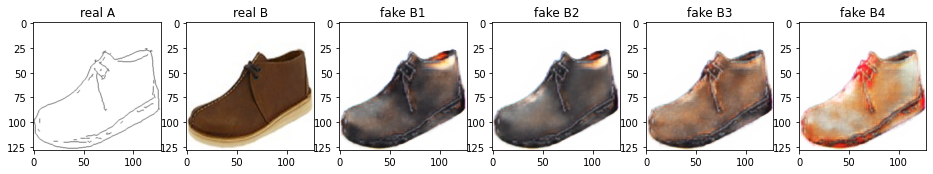

Train Epoch: 1 40% 	Total Loss: 5.535387 	Loss_GAN: 2.922600	Loss_GAN_VAE: 0.796623	Loss_GAN_LR: 0.809220	Loss_D_VAE: 1.326679	Loss_D_LR: 1.286109
0 20009 T:  4.2277512550354
Train Epoch: 1 40% 	Total Loss: 5.721499 	Loss_GAN: 3.267424	Loss_GAN_VAE: 1.040017	Loss_GAN_LR: 0.811164	Loss_D_VAE: 1.107985	Loss_D_LR: 1.346091
0 20019 T:  2.5183982849121094
Train Epoch: 1 40% 	Total Loss: 5.537636 	Loss_GAN: 2.934773	Loss_GAN_VAE: 0.851897	Loss_GAN_LR: 0.855957	Loss_D_VAE: 1.303349	Loss_D_LR: 1.299514
0 20029 T:  2.365999460220337
Train Epoch: 1 40% 	Total Loss: 5.760643 	Loss_GAN: 3.466638	Loss_GAN_VAE: 1.000665	Loss_GAN_LR: 1.075253	Loss_D_VAE: 1.174523	Loss_D_LR: 1.119482
0 20039 T:  2.72127103805542
Train Epoch: 1 40% 	Total Loss: 6.241373 	Loss_GAN: 3.967111	Loss_GAN_VAE: 0.840952	Loss_GAN_LR: 1.239426	Loss_D_VAE: 1.337308	Loss_D_LR: 0.936954
0 20049 T:  2.473832607269287
Train Epoch: 1 40% 	Total Loss: 6.168397 	Loss_GAN: 3.308517	Loss_GAN_VAE: 0.900277	Loss_GAN_LR: 0.760597	Loss_D_VAE:

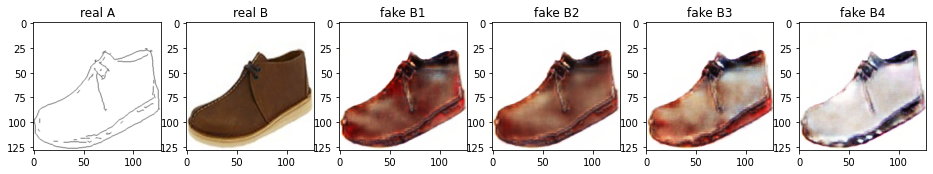

Train Epoch: 1 41% 	Total Loss: 6.129053 	Loss_GAN: 3.352489	Loss_GAN_VAE: 0.969229	Loss_GAN_LR: 0.969485	Loss_D_VAE: 1.470961	Loss_D_LR: 1.305603
0 20509 T:  11.232387065887451
Train Epoch: 1 41% 	Total Loss: 5.449095 	Loss_GAN: 2.620498	Loss_GAN_VAE: 0.807642	Loss_GAN_LR: 0.757296	Loss_D_VAE: 1.357747	Loss_D_LR: 1.470851
0 20519 T:  9.296743392944336
Train Epoch: 1 41% 	Total Loss: 5.506938 	Loss_GAN: 2.964100	Loss_GAN_VAE: 0.898382	Loss_GAN_LR: 0.830275	Loss_D_VAE: 1.221609	Loss_D_LR: 1.321228
0 20529 T:  9.33641767501831
Train Epoch: 1 41% 	Total Loss: 6.189292 	Loss_GAN: 3.671433	Loss_GAN_VAE: 0.930777	Loss_GAN_LR: 0.817328	Loss_D_VAE: 1.189466	Loss_D_LR: 1.328393
0 20539 T:  9.386086702346802
Train Epoch: 1 41% 	Total Loss: 6.131126 	Loss_GAN: 3.010304	Loss_GAN_VAE: 0.798829	Loss_GAN_LR: 0.759208	Loss_D_VAE: 1.486124	Loss_D_LR: 1.634698
0 20549 T:  9.780810594558716
Train Epoch: 1 41% 	Total Loss: 5.670385 	Loss_GAN: 3.074053	Loss_GAN_VAE: 0.816851	Loss_GAN_LR: 0.796516	Loss_D_VA

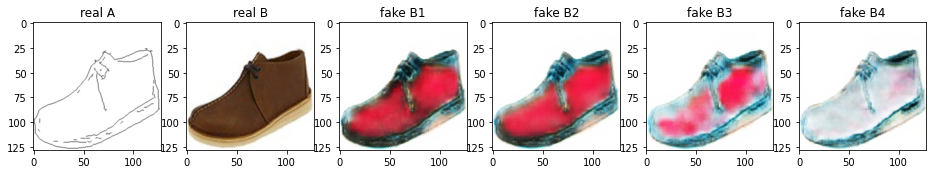

Train Epoch: 1 42% 	Total Loss: 6.357102 	Loss_GAN: 4.207256	Loss_GAN_VAE: 1.059175	Loss_GAN_LR: 0.949047	Loss_D_VAE: 1.064761	Loss_D_LR: 1.085085
0 21009 T:  9.707429647445679
Train Epoch: 1 42% 	Total Loss: 5.942538 	Loss_GAN: 3.261039	Loss_GAN_VAE: 0.940134	Loss_GAN_LR: 0.854592	Loss_D_VAE: 1.138276	Loss_D_LR: 1.543222
0 21019 T:  8.721805334091187
Train Epoch: 1 42% 	Total Loss: 5.674456 	Loss_GAN: 3.040469	Loss_GAN_VAE: 0.941063	Loss_GAN_LR: 0.823688	Loss_D_VAE: 1.311002	Loss_D_LR: 1.322985
0 21029 T:  8.856568574905396
Train Epoch: 1 42% 	Total Loss: 5.700970 	Loss_GAN: 3.292138	Loss_GAN_VAE: 0.822990	Loss_GAN_LR: 0.934989	Loss_D_VAE: 1.306573	Loss_D_LR: 1.102260
0 21039 T:  8.803835391998291
Train Epoch: 1 42% 	Total Loss: 5.441776 	Loss_GAN: 2.782297	Loss_GAN_VAE: 0.805531	Loss_GAN_LR: 0.816992	Loss_D_VAE: 1.274655	Loss_D_LR: 1.384825
0 21049 T:  9.404619455337524
Train Epoch: 1 42% 	Total Loss: 6.159322 	Loss_GAN: 3.882957	Loss_GAN_VAE: 1.178911	Loss_GAN_LR: 0.984228	Loss_D_VA

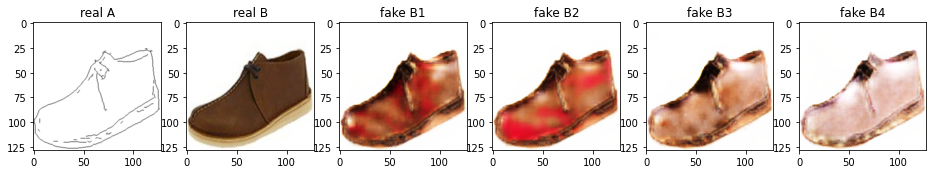

Train Epoch: 1 43% 	Total Loss: 5.764961 	Loss_GAN: 2.935518	Loss_GAN_VAE: 0.943431	Loss_GAN_LR: 0.814458	Loss_D_VAE: 1.332663	Loss_D_LR: 1.496780
0 21509 T:  9.971604824066162
Train Epoch: 1 43% 	Total Loss: 5.562484 	Loss_GAN: 3.011654	Loss_GAN_VAE: 0.877191	Loss_GAN_LR: 0.998994	Loss_D_VAE: 1.295383	Loss_D_LR: 1.255448
0 21519 T:  8.587074279785156
Train Epoch: 1 43% 	Total Loss: 5.811764 	Loss_GAN: 2.991386	Loss_GAN_VAE: 0.885849	Loss_GAN_LR: 0.785934	Loss_D_VAE: 1.307930	Loss_D_LR: 1.512448
0 21529 T:  9.060103178024292
Train Epoch: 1 43% 	Total Loss: 5.813111 	Loss_GAN: 3.112495	Loss_GAN_VAE: 0.882035	Loss_GAN_LR: 0.776448	Loss_D_VAE: 1.322333	Loss_D_LR: 1.378283
0 21539 T:  8.399945497512817
Train Epoch: 1 43% 	Total Loss: 5.426522 	Loss_GAN: 2.757494	Loss_GAN_VAE: 0.830832	Loss_GAN_LR: 0.829619	Loss_D_VAE: 1.327886	Loss_D_LR: 1.341142
0 21549 T:  8.322805404663086
Train Epoch: 1 43% 	Total Loss: 5.729285 	Loss_GAN: 3.175479	Loss_GAN_VAE: 0.960863	Loss_GAN_LR: 0.946260	Loss_D_VA

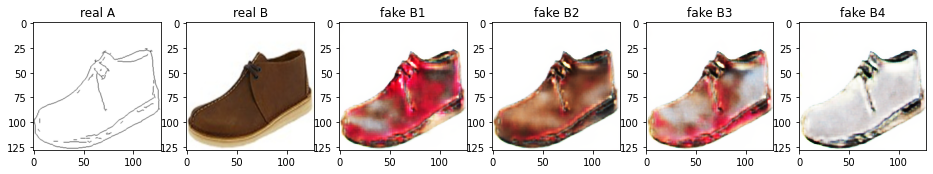

Train Epoch: 1 44% 	Total Loss: 6.220112 	Loss_GAN: 3.310446	Loss_GAN_VAE: 0.735851	Loss_GAN_LR: 0.908153	Loss_D_VAE: 1.516087	Loss_D_LR: 1.393579
0 22009 T:  11.955261468887329
Train Epoch: 1 44% 	Total Loss: 5.429021 	Loss_GAN: 2.866137	Loss_GAN_VAE: 0.753615	Loss_GAN_LR: 0.908594	Loss_D_VAE: 1.417510	Loss_D_LR: 1.145373
0 22019 T:  8.918075323104858
Train Epoch: 1 44% 	Total Loss: 5.673922 	Loss_GAN: 3.439522	Loss_GAN_VAE: 0.832235	Loss_GAN_LR: 1.020249	Loss_D_VAE: 1.285940	Loss_D_LR: 0.948460
0 22029 T:  9.219385623931885
Train Epoch: 1 44% 	Total Loss: 5.912427 	Loss_GAN: 3.412354	Loss_GAN_VAE: 0.911750	Loss_GAN_LR: 1.067392	Loss_D_VAE: 1.235351	Loss_D_LR: 1.264722
0 22039 T:  9.149272680282593
Train Epoch: 1 44% 	Total Loss: 5.990504 	Loss_GAN: 3.580948	Loss_GAN_VAE: 0.902068	Loss_GAN_LR: 1.073332	Loss_D_VAE: 1.108722	Loss_D_LR: 1.300833
0 22049 T:  9.010620594024658
Train Epoch: 1 44% 	Total Loss: 5.960145 	Loss_GAN: 3.676734	Loss_GAN_VAE: 0.766717	Loss_GAN_LR: 1.208415	Loss_D_V

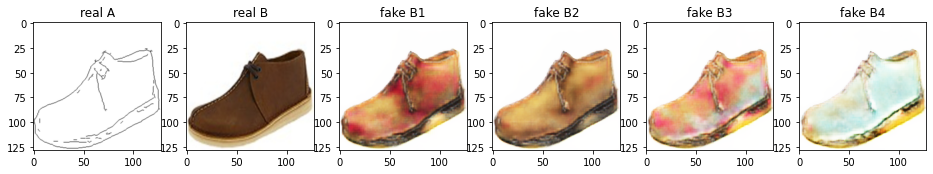

Train Epoch: 1 45% 	Total Loss: 5.904082 	Loss_GAN: 3.556516	Loss_GAN_VAE: 0.880696	Loss_GAN_LR: 1.008497	Loss_D_VAE: 1.257095	Loss_D_LR: 1.090471
0 22509 T:  9.550412893295288
Train Epoch: 1 45% 	Total Loss: 6.091471 	Loss_GAN: 3.821590	Loss_GAN_VAE: 1.010310	Loss_GAN_LR: 1.240561	Loss_D_VAE: 1.228971	Loss_D_LR: 1.040910
0 22519 T:  8.780974388122559
Train Epoch: 1 45% 	Total Loss: 6.152035 	Loss_GAN: 3.441342	Loss_GAN_VAE: 0.877182	Loss_GAN_LR: 0.825884	Loss_D_VAE: 1.396720	Loss_D_LR: 1.313973
0 22529 T:  8.724770307540894
Train Epoch: 1 45% 	Total Loss: 5.678256 	Loss_GAN: 2.997733	Loss_GAN_VAE: 0.865600	Loss_GAN_LR: 0.878192	Loss_D_VAE: 1.326902	Loss_D_LR: 1.353620
0 22539 T:  8.457564353942871
Train Epoch: 1 45% 	Total Loss: 5.924275 	Loss_GAN: 3.236191	Loss_GAN_VAE: 0.815126	Loss_GAN_LR: 0.870573	Loss_D_VAE: 1.449739	Loss_D_LR: 1.238346
0 22549 T:  8.885029554367065
Train Epoch: 1 45% 	Total Loss: 5.847970 	Loss_GAN: 3.328613	Loss_GAN_VAE: 0.879967	Loss_GAN_LR: 0.832169	Loss_D_VA

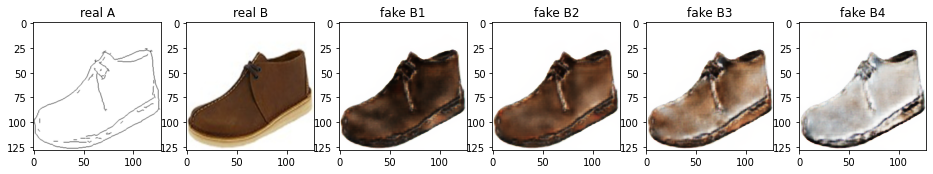

Train Epoch: 1 46% 	Total Loss: 5.981797 	Loss_GAN: 3.255176	Loss_GAN_VAE: 0.818790	Loss_GAN_LR: 0.826608	Loss_D_VAE: 1.250214	Loss_D_LR: 1.476408
0 23009 T:  11.772290229797363
Train Epoch: 1 46% 	Total Loss: 5.188269 	Loss_GAN: 2.612843	Loss_GAN_VAE: 0.823084	Loss_GAN_LR: 0.885860	Loss_D_VAE: 1.333167	Loss_D_LR: 1.242259
0 23019 T:  8.904450416564941
Train Epoch: 1 46% 	Total Loss: 5.519877 	Loss_GAN: 2.948547	Loss_GAN_VAE: 0.776058	Loss_GAN_LR: 0.893317	Loss_D_VAE: 1.320397	Loss_D_LR: 1.250933
0 23029 T:  9.648606538772583
Train Epoch: 1 46% 	Total Loss: 5.262916 	Loss_GAN: 2.665724	Loss_GAN_VAE: 0.817561	Loss_GAN_LR: 0.813116	Loss_D_VAE: 1.289936	Loss_D_LR: 1.307256
0 23039 T:  9.058768272399902
Train Epoch: 1 46% 	Total Loss: 5.325810 	Loss_GAN: 2.559910	Loss_GAN_VAE: 0.710670	Loss_GAN_LR: 0.841760	Loss_D_VAE: 1.414891	Loss_D_LR: 1.351008
0 23049 T:  8.91460394859314
Train Epoch: 1 46% 	Total Loss: 5.963948 	Loss_GAN: 3.854506	Loss_GAN_VAE: 1.002092	Loss_GAN_LR: 1.067331	Loss_D_VA

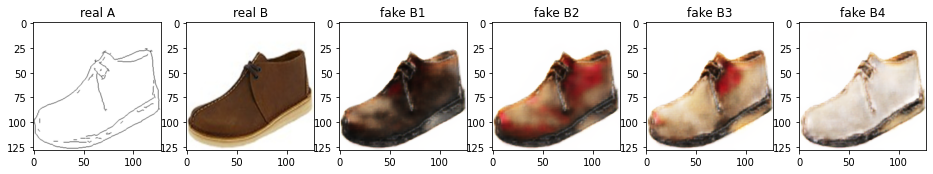

Train Epoch: 1 47% 	Total Loss: 5.363844 	Loss_GAN: 2.922795	Loss_GAN_VAE: 0.887655	Loss_GAN_LR: 0.866783	Loss_D_VAE: 1.198080	Loss_D_LR: 1.242969
0 23509 T:  9.60717511177063
Train Epoch: 1 47% 	Total Loss: 5.706569 	Loss_GAN: 3.169962	Loss_GAN_VAE: 0.844095	Loss_GAN_LR: 0.959376	Loss_D_VAE: 1.250274	Loss_D_LR: 1.286333
0 23519 T:  9.240463733673096
Train Epoch: 1 47% 	Total Loss: 5.652886 	Loss_GAN: 3.037618	Loss_GAN_VAE: 0.895029	Loss_GAN_LR: 0.809653	Loss_D_VAE: 1.197925	Loss_D_LR: 1.417344
0 23529 T:  7.850548982620239
Train Epoch: 1 47% 	Total Loss: 5.346405 	Loss_GAN: 3.048257	Loss_GAN_VAE: 0.894843	Loss_GAN_LR: 0.856472	Loss_D_VAE: 1.166386	Loss_D_LR: 1.131762
0 23539 T:  9.49418592453003
Train Epoch: 1 47% 	Total Loss: 6.470240 	Loss_GAN: 3.891661	Loss_GAN_VAE: 1.297693	Loss_GAN_LR: 1.289667	Loss_D_VAE: 1.365394	Loss_D_LR: 1.213185
0 23549 T:  9.402097225189209
Train Epoch: 1 47% 	Total Loss: 6.115878 	Loss_GAN: 3.774161	Loss_GAN_VAE: 0.955981	Loss_GAN_LR: 0.949738	Loss_D_VAE:

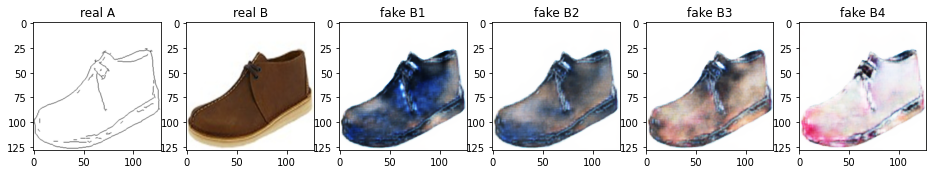

Train Epoch: 1 48% 	Total Loss: 6.012138 	Loss_GAN: 4.169548	Loss_GAN_VAE: 0.972473	Loss_GAN_LR: 1.790577	Loss_D_VAE: 1.059982	Loss_D_LR: 0.782608
0 24009 T:  10.5859854221344
Train Epoch: 1 48% 	Total Loss: 6.374927 	Loss_GAN: 3.201762	Loss_GAN_VAE: 0.777026	Loss_GAN_LR: 0.811551	Loss_D_VAE: 1.515186	Loss_D_LR: 1.657979
0 24019 T:  8.671655893325806
Train Epoch: 1 48% 	Total Loss: 5.791327 	Loss_GAN: 2.927768	Loss_GAN_VAE: 0.852611	Loss_GAN_LR: 0.790448	Loss_D_VAE: 1.375214	Loss_D_LR: 1.488345
0 24029 T:  8.62828540802002
Train Epoch: 1 48% 	Total Loss: 6.364761 	Loss_GAN: 3.933475	Loss_GAN_VAE: 1.028676	Loss_GAN_LR: 1.010054	Loss_D_VAE: 1.161514	Loss_D_LR: 1.269773
0 24039 T:  9.128025531768799
Train Epoch: 1 48% 	Total Loss: 5.461420 	Loss_GAN: 2.824155	Loss_GAN_VAE: 0.801759	Loss_GAN_LR: 0.836603	Loss_D_VAE: 1.286561	Loss_D_LR: 1.350704
0 24049 T:  8.89884638786316
Train Epoch: 1 48% 	Total Loss: 6.078634 	Loss_GAN: 3.452927	Loss_GAN_VAE: 0.884263	Loss_GAN_LR: 0.974497	Loss_D_VAE: 

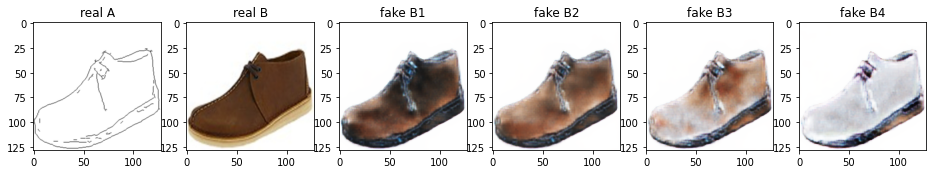

Train Epoch: 1 49% 	Total Loss: 5.965822 	Loss_GAN: 3.477534	Loss_GAN_VAE: 1.072495	Loss_GAN_LR: 1.082274	Loss_D_VAE: 1.387567	Loss_D_LR: 1.100721
0 24509 T:  9.914880514144897
Train Epoch: 1 49% 	Total Loss: 5.721924 	Loss_GAN: 3.006122	Loss_GAN_VAE: 0.875828	Loss_GAN_LR: 0.809242	Loss_D_VAE: 1.398629	Loss_D_LR: 1.317173
0 24519 T:  8.748661518096924
Train Epoch: 1 49% 	Total Loss: 6.547562 	Loss_GAN: 3.659496	Loss_GAN_VAE: 0.877946	Loss_GAN_LR: 1.115926	Loss_D_VAE: 1.333780	Loss_D_LR: 1.554286
0 24529 T:  8.607207536697388
Train Epoch: 1 49% 	Total Loss: 6.022710 	Loss_GAN: 3.364446	Loss_GAN_VAE: 0.966115	Loss_GAN_LR: 0.906311	Loss_D_VAE: 1.359710	Loss_D_LR: 1.298554
0 24539 T:  9.23877739906311
Train Epoch: 1 49% 	Total Loss: 6.043459 	Loss_GAN: 3.414658	Loss_GAN_VAE: 0.888621	Loss_GAN_LR: 1.089353	Loss_D_VAE: 1.376404	Loss_D_LR: 1.252398
0 24549 T:  8.45655369758606
Train Epoch: 1 49% 	Total Loss: 5.396835 	Loss_GAN: 3.032492	Loss_GAN_VAE: 0.822028	Loss_GAN_LR: 0.963564	Loss_D_VAE:

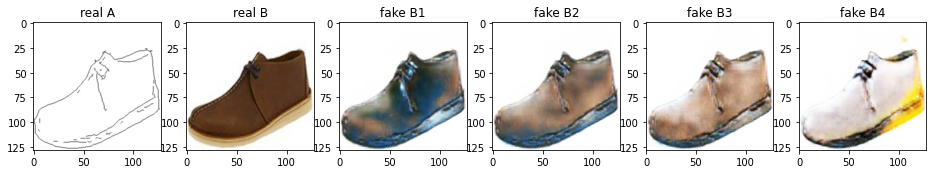

Train Epoch: 1 50% 	Total Loss: 5.677206 	Loss_GAN: 3.383209	Loss_GAN_VAE: 0.825856	Loss_GAN_LR: 1.075368	Loss_D_VAE: 1.340660	Loss_D_LR: 0.953337
0 25009 T:  11.431608200073242
Train Epoch: 1 50% 	Total Loss: 6.093596 	Loss_GAN: 4.160561	Loss_GAN_VAE: 0.977850	Loss_GAN_LR: 1.366607	Loss_D_VAE: 1.111100	Loss_D_LR: 0.821935
0 25019 T:  9.146173477172852
Train Epoch: 1 50% 	Total Loss: 6.559692 	Loss_GAN: 3.488926	Loss_GAN_VAE: 0.821928	Loss_GAN_LR: 1.070794	Loss_D_VAE: 1.444482	Loss_D_LR: 1.626284
0 25029 T:  8.791491270065308
Train Epoch: 1 50% 	Total Loss: 5.825063 	Loss_GAN: 3.251801	Loss_GAN_VAE: 0.850819	Loss_GAN_LR: 0.942617	Loss_D_VAE: 1.295478	Loss_D_LR: 1.277784
0 25039 T:  8.892495155334473
Train Epoch: 1 50% 	Total Loss: 5.666852 	Loss_GAN: 3.140540	Loss_GAN_VAE: 0.823834	Loss_GAN_LR: 1.006448	Loss_D_VAE: 1.379748	Loss_D_LR: 1.146563
0 25049 T:  8.458697080612183
Train Epoch: 1 50% 	Total Loss: 5.775001 	Loss_GAN: 3.077923	Loss_GAN_VAE: 0.744591	Loss_GAN_LR: 0.938262	Loss_D_V

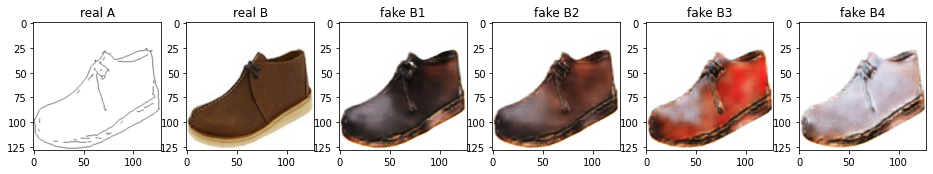

Train Epoch: 1 51% 	Total Loss: 6.553050 	Loss_GAN: 3.710061	Loss_GAN_VAE: 1.095937	Loss_GAN_LR: 1.103585	Loss_D_VAE: 1.515306	Loss_D_LR: 1.327683
0 25509 T:  10.314448356628418
Train Epoch: 1 51% 	Total Loss: 5.660169 	Loss_GAN: 3.374950	Loss_GAN_VAE: 1.010821	Loss_GAN_LR: 0.979280	Loss_D_VAE: 1.164113	Loss_D_LR: 1.121106
0 25519 T:  9.095699787139893
Train Epoch: 1 51% 	Total Loss: 5.543410 	Loss_GAN: 3.073668	Loss_GAN_VAE: 0.831814	Loss_GAN_LR: 0.891359	Loss_D_VAE: 1.356983	Loss_D_LR: 1.112759
0 25529 T:  8.335511445999146
Train Epoch: 1 51% 	Total Loss: 5.874218 	Loss_GAN: 3.961630	Loss_GAN_VAE: 1.248853	Loss_GAN_LR: 1.137219	Loss_D_VAE: 0.943086	Loss_D_LR: 0.969502
0 25539 T:  8.64723515510559
Train Epoch: 1 51% 	Total Loss: 6.420469 	Loss_GAN: 3.681455	Loss_GAN_VAE: 0.900874	Loss_GAN_LR: 1.185484	Loss_D_VAE: 1.614524	Loss_D_LR: 1.124490
0 25549 T:  8.910065650939941
Train Epoch: 1 51% 	Total Loss: 6.169193 	Loss_GAN: 3.471843	Loss_GAN_VAE: 0.992193	Loss_GAN_LR: 0.928127	Loss_D_VA

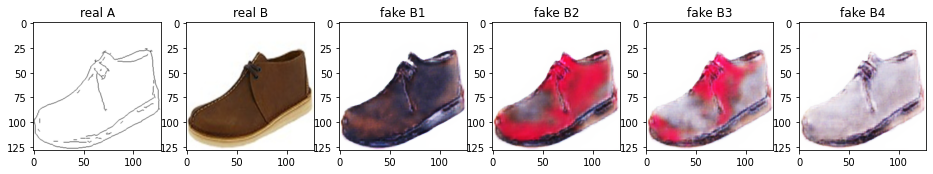

Train Epoch: 1 52% 	Total Loss: 5.753196 	Loss_GAN: 3.858297	Loss_GAN_VAE: 1.002297	Loss_GAN_LR: 1.481550	Loss_D_VAE: 1.037747	Loss_D_LR: 0.857152
0 26009 T:  10.456586599349976
Train Epoch: 1 52% 	Total Loss: 6.153166 	Loss_GAN: 3.751051	Loss_GAN_VAE: 0.924403	Loss_GAN_LR: 1.213026	Loss_D_VAE: 1.233769	Loss_D_LR: 1.168347
0 26019 T:  8.74343490600586
Train Epoch: 1 52% 	Total Loss: 5.721126 	Loss_GAN: 3.331182	Loss_GAN_VAE: 0.942621	Loss_GAN_LR: 1.008460	Loss_D_VAE: 1.175285	Loss_D_LR: 1.214660
0 26029 T:  8.345555782318115
Train Epoch: 1 52% 	Total Loss: 6.129464 	Loss_GAN: 3.073057	Loss_GAN_VAE: 0.995522	Loss_GAN_LR: 0.922481	Loss_D_VAE: 1.538857	Loss_D_LR: 1.517550
0 26039 T:  8.547295331954956
Train Epoch: 1 52% 	Total Loss: 5.756462 	Loss_GAN: 3.084087	Loss_GAN_VAE: 0.773610	Loss_GAN_LR: 0.818329	Loss_D_VAE: 1.275834	Loss_D_LR: 1.396542
0 26049 T:  8.852277517318726
Train Epoch: 1 52% 	Total Loss: 6.367560 	Loss_GAN: 4.090275	Loss_GAN_VAE: 1.248047	Loss_GAN_LR: 1.327422	Loss_D_VA

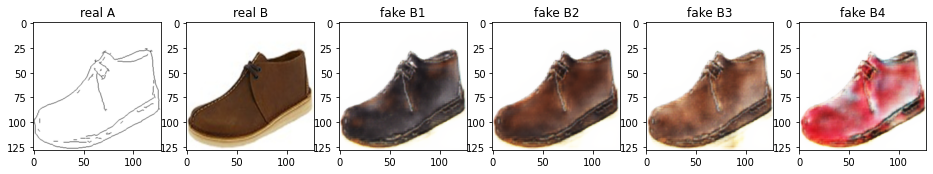

Train Epoch: 1 53% 	Total Loss: 5.730343 	Loss_GAN: 3.308768	Loss_GAN_VAE: 0.908365	Loss_GAN_LR: 0.846132	Loss_D_VAE: 1.249037	Loss_D_LR: 1.172538
0 26509 T:  9.700290441513062
Train Epoch: 1 53% 	Total Loss: 5.551708 	Loss_GAN: 3.380297	Loss_GAN_VAE: 0.937388	Loss_GAN_LR: 1.004236	Loss_D_VAE: 1.160997	Loss_D_LR: 1.010414
0 26519 T:  8.38301682472229
Train Epoch: 1 53% 	Total Loss: 5.976666 	Loss_GAN: 3.287715	Loss_GAN_VAE: 0.907788	Loss_GAN_LR: 0.973271	Loss_D_VAE: 1.444169	Loss_D_LR: 1.244783
0 26529 T:  8.701475381851196
Train Epoch: 1 53% 	Total Loss: 5.580564 	Loss_GAN: 2.748566	Loss_GAN_VAE: 0.789259	Loss_GAN_LR: 0.811826	Loss_D_VAE: 1.469359	Loss_D_LR: 1.362638
0 26539 T:  8.621095657348633
Train Epoch: 1 53% 	Total Loss: 5.844755 	Loss_GAN: 2.993715	Loss_GAN_VAE: 0.746411	Loss_GAN_LR: 0.888158	Loss_D_VAE: 1.478867	Loss_D_LR: 1.372172
0 26549 T:  9.413953304290771
Train Epoch: 1 53% 	Total Loss: 5.513443 	Loss_GAN: 3.091719	Loss_GAN_VAE: 0.784173	Loss_GAN_LR: 1.003977	Loss_D_VAE

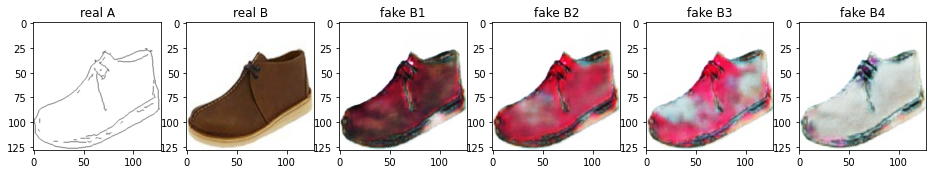

Train Epoch: 1 54% 	Total Loss: 5.681907 	Loss_GAN: 2.759044	Loss_GAN_VAE: 0.756370	Loss_GAN_LR: 0.644486	Loss_D_VAE: 1.418264	Loss_D_LR: 1.504599
0 27009 T:  10.454339981079102
Train Epoch: 1 54% 	Total Loss: 5.821115 	Loss_GAN: 3.346682	Loss_GAN_VAE: 0.830147	Loss_GAN_LR: 0.950989	Loss_D_VAE: 1.169304	Loss_D_LR: 1.305129
0 27019 T:  8.821423530578613
Train Epoch: 1 54% 	Total Loss: 5.478065 	Loss_GAN: 3.099855	Loss_GAN_VAE: 0.802471	Loss_GAN_LR: 1.002336	Loss_D_VAE: 1.352533	Loss_D_LR: 1.025677
0 27029 T:  8.53864860534668
Train Epoch: 1 54% 	Total Loss: 6.255639 	Loss_GAN: 3.141525	Loss_GAN_VAE: 0.838700	Loss_GAN_LR: 0.866946	Loss_D_VAE: 1.521335	Loss_D_LR: 1.592779
0 27039 T:  9.272148370742798
Train Epoch: 1 54% 	Total Loss: 5.485268 	Loss_GAN: 2.938061	Loss_GAN_VAE: 0.826746	Loss_GAN_LR: 0.831522	Loss_D_VAE: 1.187554	Loss_D_LR: 1.359653
0 27049 T:  8.627851724624634
Train Epoch: 1 54% 	Total Loss: 5.245035 	Loss_GAN: 2.789161	Loss_GAN_VAE: 0.864475	Loss_GAN_LR: 0.883563	Loss_D_VA

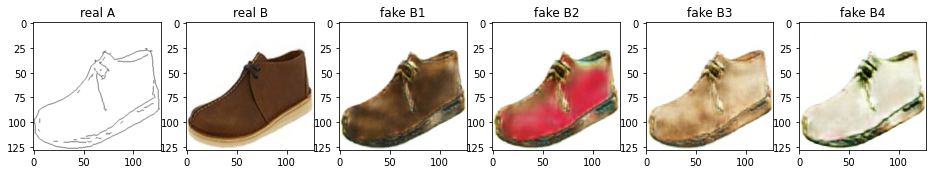

Train Epoch: 1 55% 	Total Loss: 5.736140 	Loss_GAN: 3.243279	Loss_GAN_VAE: 0.806306	Loss_GAN_LR: 0.955798	Loss_D_VAE: 1.429954	Loss_D_LR: 1.062907
0 27509 T:  9.603453397750854
Train Epoch: 1 55% 	Total Loss: 5.836754 	Loss_GAN: 3.202220	Loss_GAN_VAE: 0.814714	Loss_GAN_LR: 1.056305	Loss_D_VAE: 1.322995	Loss_D_LR: 1.311540
0 27519 T:  9.376342058181763
Train Epoch: 1 55% 	Total Loss: 5.543820 	Loss_GAN: 3.193542	Loss_GAN_VAE: 0.826885	Loss_GAN_LR: 1.019122	Loss_D_VAE: 1.221302	Loss_D_LR: 1.128976
0 27529 T:  9.356260776519775
Train Epoch: 1 55% 	Total Loss: 5.809787 	Loss_GAN: 3.460228	Loss_GAN_VAE: 0.944363	Loss_GAN_LR: 1.032886	Loss_D_VAE: 1.125144	Loss_D_LR: 1.224415
0 27539 T:  8.75749158859253
Train Epoch: 1 55% 	Total Loss: 5.379301 	Loss_GAN: 2.570828	Loss_GAN_VAE: 0.807705	Loss_GAN_LR: 0.777308	Loss_D_VAE: 1.419010	Loss_D_LR: 1.389463
0 27549 T:  8.99138855934143
Train Epoch: 1 55% 	Total Loss: 5.759190 	Loss_GAN: 3.218783	Loss_GAN_VAE: 0.931324	Loss_GAN_LR: 0.888730	Loss_D_VAE:

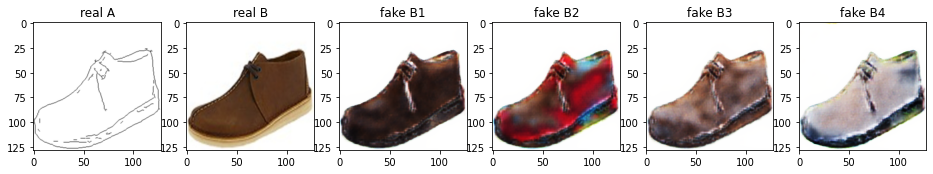

Train Epoch: 1 56% 	Total Loss: 5.484181 	Loss_GAN: 2.891714	Loss_GAN_VAE: 0.810484	Loss_GAN_LR: 0.865191	Loss_D_VAE: 1.379592	Loss_D_LR: 1.212875
0 28009 T:  11.624044418334961
Train Epoch: 1 56% 	Total Loss: 5.894428 	Loss_GAN: 3.920849	Loss_GAN_VAE: 0.925504	Loss_GAN_LR: 1.319177	Loss_D_VAE: 1.179478	Loss_D_LR: 0.794102
0 28019 T:  9.467362642288208
Train Epoch: 1 56% 	Total Loss: 5.904150 	Loss_GAN: 3.576610	Loss_GAN_VAE: 0.757490	Loss_GAN_LR: 1.086468	Loss_D_VAE: 1.411015	Loss_D_LR: 0.916525
0 28029 T:  8.923903703689575
Train Epoch: 1 56% 	Total Loss: 5.915573 	Loss_GAN: 3.083491	Loss_GAN_VAE: 0.871702	Loss_GAN_LR: 0.872880	Loss_D_VAE: 1.264817	Loss_D_LR: 1.567265
0 28039 T:  9.343913555145264
Train Epoch: 1 56% 	Total Loss: 6.050849 	Loss_GAN: 3.499591	Loss_GAN_VAE: 0.867883	Loss_GAN_LR: 0.953142	Loss_D_VAE: 1.239118	Loss_D_LR: 1.312140
0 28049 T:  8.921125888824463
Train Epoch: 1 56% 	Total Loss: 5.683983 	Loss_GAN: 3.346859	Loss_GAN_VAE: 0.840631	Loss_GAN_LR: 0.978600	Loss_D_V

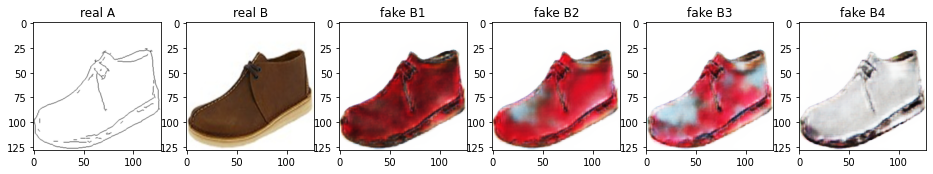

Train Epoch: 1 57% 	Total Loss: 5.726880 	Loss_GAN: 3.013925	Loss_GAN_VAE: 0.797737	Loss_GAN_LR: 0.888347	Loss_D_VAE: 1.354162	Loss_D_LR: 1.358793
0 28509 T:  10.303155183792114
Train Epoch: 1 57% 	Total Loss: 5.870989 	Loss_GAN: 3.245917	Loss_GAN_VAE: 0.773093	Loss_GAN_LR: 0.984427	Loss_D_VAE: 1.406909	Loss_D_LR: 1.218164
0 28519 T:  9.412926435470581
Train Epoch: 1 57% 	Total Loss: 5.280369 	Loss_GAN: 2.572577	Loss_GAN_VAE: 0.854655	Loss_GAN_LR: 0.815800	Loss_D_VAE: 1.388490	Loss_D_LR: 1.319301
0 28529 T:  10.98705267906189
Train Epoch: 1 57% 	Total Loss: 5.857658 	Loss_GAN: 3.022444	Loss_GAN_VAE: 0.812913	Loss_GAN_LR: 0.836695	Loss_D_VAE: 1.368214	Loss_D_LR: 1.467000
0 28539 T:  9.633395433425903
Train Epoch: 1 57% 	Total Loss: 5.809580 	Loss_GAN: 3.175807	Loss_GAN_VAE: 0.831596	Loss_GAN_LR: 0.765479	Loss_D_VAE: 1.218244	Loss_D_LR: 1.415529
0 28549 T:  14.68706727027893
Train Epoch: 1 57% 	Total Loss: 5.705813 	Loss_GAN: 3.039740	Loss_GAN_VAE: 0.786469	Loss_GAN_LR: 0.848243	Loss_D_V

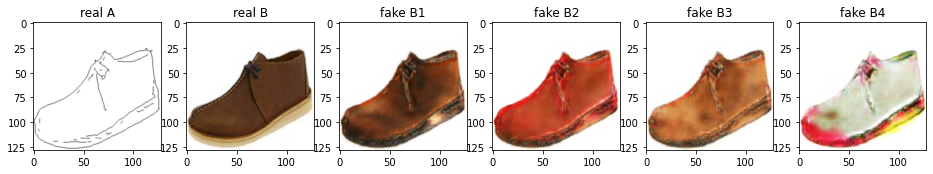

Train Epoch: 1 58% 	Total Loss: 6.002417 	Loss_GAN: 3.301186	Loss_GAN_VAE: 0.767371	Loss_GAN_LR: 1.060950	Loss_D_VAE: 1.390014	Loss_D_LR: 1.311216
0 29009 T:  11.34216570854187
Train Epoch: 1 58% 	Total Loss: 5.517658 	Loss_GAN: 2.617923	Loss_GAN_VAE: 0.786177	Loss_GAN_LR: 0.877293	Loss_D_VAE: 1.423820	Loss_D_LR: 1.475916
0 29019 T:  9.810447216033936
Train Epoch: 1 58% 	Total Loss: 5.767524 	Loss_GAN: 3.045685	Loss_GAN_VAE: 0.774606	Loss_GAN_LR: 0.937798	Loss_D_VAE: 1.393129	Loss_D_LR: 1.328710
0 29029 T:  9.44852352142334
Train Epoch: 1 58% 	Total Loss: 5.672997 	Loss_GAN: 3.048036	Loss_GAN_VAE: 0.751371	Loss_GAN_LR: 0.916097	Loss_D_VAE: 1.391109	Loss_D_LR: 1.233853
0 29039 T:  9.166953325271606
Train Epoch: 1 58% 	Total Loss: 5.989720 	Loss_GAN: 3.251089	Loss_GAN_VAE: 0.834652	Loss_GAN_LR: 0.901084	Loss_D_VAE: 1.324557	Loss_D_LR: 1.414074
0 29049 T:  9.552804470062256
Train Epoch: 1 58% 	Total Loss: 5.718495 	Loss_GAN: 3.058479	Loss_GAN_VAE: 0.760742	Loss_GAN_LR: 0.815338	Loss_D_VAE

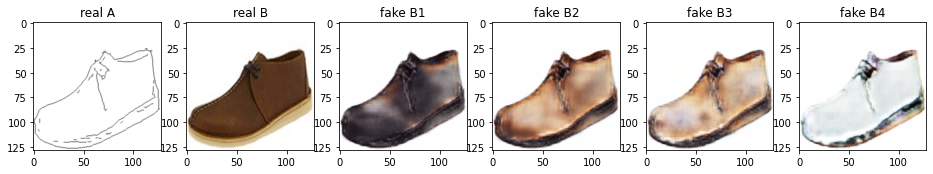

Train Epoch: 1 59% 	Total Loss: 5.906030 	Loss_GAN: 3.177542	Loss_GAN_VAE: 0.879808	Loss_GAN_LR: 0.862130	Loss_D_VAE: 1.153939	Loss_D_LR: 1.574549
0 29509 T:  10.816284656524658
Train Epoch: 1 59% 	Total Loss: 5.374368 	Loss_GAN: 2.675904	Loss_GAN_VAE: 0.863601	Loss_GAN_LR: 0.797027	Loss_D_VAE: 1.372340	Loss_D_LR: 1.326124
0 29519 T:  11.292773008346558
Train Epoch: 1 59% 	Total Loss: 6.070647 	Loss_GAN: 3.467814	Loss_GAN_VAE: 0.900467	Loss_GAN_LR: 1.005054	Loss_D_VAE: 1.403534	Loss_D_LR: 1.199299
0 29529 T:  8.806624412536621
Train Epoch: 1 59% 	Total Loss: 5.896709 	Loss_GAN: 3.369601	Loss_GAN_VAE: 0.933866	Loss_GAN_LR: 0.757914	Loss_D_VAE: 1.202225	Loss_D_LR: 1.324883
0 29539 T:  9.906672477722168
Train Epoch: 1 59% 	Total Loss: 6.342673 	Loss_GAN: 3.941073	Loss_GAN_VAE: 0.994249	Loss_GAN_LR: 1.324319	Loss_D_VAE: 1.437064	Loss_D_LR: 0.964536
0 29549 T:  9.02207326889038
Train Epoch: 1 59% 	Total Loss: 5.974059 	Loss_GAN: 3.579515	Loss_GAN_VAE: 0.929991	Loss_GAN_LR: 1.115164	Loss_D_V

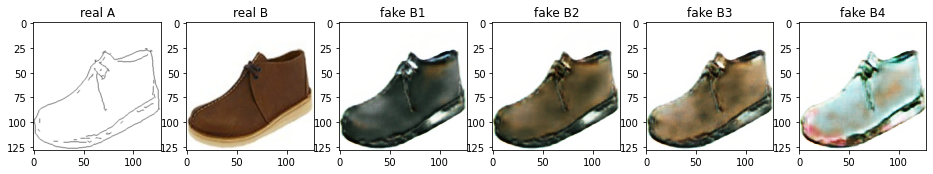

Train Epoch: 1 60% 	Total Loss: 5.990497 	Loss_GAN: 3.544583	Loss_GAN_VAE: 0.853642	Loss_GAN_LR: 1.150092	Loss_D_VAE: 1.362526	Loss_D_LR: 1.083387
0 30009 T:  10.822623252868652
Train Epoch: 1 60% 	Total Loss: 6.281910 	Loss_GAN: 3.341150	Loss_GAN_VAE: 0.880372	Loss_GAN_LR: 0.908091	Loss_D_VAE: 1.443682	Loss_D_LR: 1.497077
0 30019 T:  8.461551666259766
Train Epoch: 1 60% 	Total Loss: 5.618467 	Loss_GAN: 3.025838	Loss_GAN_VAE: 0.730914	Loss_GAN_LR: 0.880123	Loss_D_VAE: 1.349260	Loss_D_LR: 1.243369
0 30029 T:  8.148894786834717
Train Epoch: 1 60% 	Total Loss: 5.743755 	Loss_GAN: 3.319004	Loss_GAN_VAE: 0.815502	Loss_GAN_LR: 0.944399	Loss_D_VAE: 1.292396	Loss_D_LR: 1.132356
0 30039 T:  8.661591053009033
Train Epoch: 1 60% 	Total Loss: 5.832969 	Loss_GAN: 3.252499	Loss_GAN_VAE: 0.870396	Loss_GAN_LR: 1.116534	Loss_D_VAE: 1.170495	Loss_D_LR: 1.409976
0 30049 T:  9.248073816299438
Train Epoch: 1 60% 	Total Loss: 5.917557 	Loss_GAN: 3.046363	Loss_GAN_VAE: 0.871924	Loss_GAN_LR: 0.774729	Loss_D_V

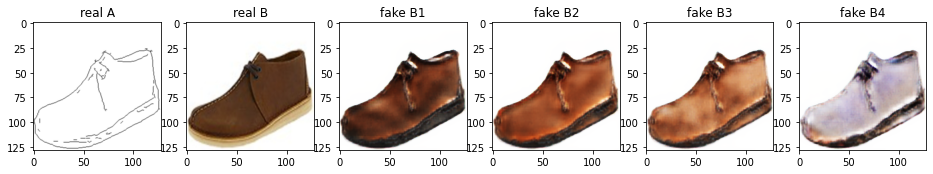

Train Epoch: 1 61% 	Total Loss: 5.723769 	Loss_GAN: 2.887778	Loss_GAN_VAE: 0.770431	Loss_GAN_LR: 0.858043	Loss_D_VAE: 1.427492	Loss_D_LR: 1.408499
0 30509 T:  9.696687698364258
Train Epoch: 1 61% 	Total Loss: 5.995073 	Loss_GAN: 3.102313	Loss_GAN_VAE: 0.735760	Loss_GAN_LR: 0.752240	Loss_D_VAE: 1.519593	Loss_D_LR: 1.373166
0 30519 T:  8.304458141326904
Train Epoch: 1 61% 	Total Loss: 6.078636 	Loss_GAN: 3.740833	Loss_GAN_VAE: 0.862367	Loss_GAN_LR: 0.890025	Loss_D_VAE: 1.249442	Loss_D_LR: 1.088361
0 30529 T:  9.106090545654297
Train Epoch: 1 61% 	Total Loss: 5.846409 	Loss_GAN: 3.307324	Loss_GAN_VAE: 0.866269	Loss_GAN_LR: 1.022822	Loss_D_VAE: 1.318497	Loss_D_LR: 1.220588
0 30539 T:  9.306248188018799
Train Epoch: 1 61% 	Total Loss: 5.580687 	Loss_GAN: 3.213616	Loss_GAN_VAE: 0.828317	Loss_GAN_LR: 0.935397	Loss_D_VAE: 1.239120	Loss_D_LR: 1.127951
0 30549 T:  9.272669315338135
Train Epoch: 1 61% 	Total Loss: 5.566944 	Loss_GAN: 3.061490	Loss_GAN_VAE: 0.865173	Loss_GAN_LR: 0.923116	Loss_D_VA

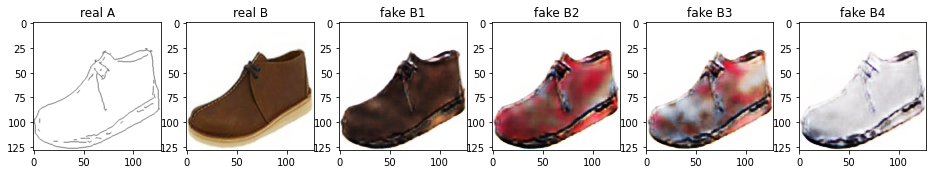

Train Epoch: 1 62% 	Total Loss: 5.890462 	Loss_GAN: 3.376567	Loss_GAN_VAE: 0.834414	Loss_GAN_LR: 0.912199	Loss_D_VAE: 1.338465	Loss_D_LR: 1.175431
0 31009 T:  10.57709002494812
Train Epoch: 1 62% 	Total Loss: 5.457948 	Loss_GAN: 2.776167	Loss_GAN_VAE: 0.870020	Loss_GAN_LR: 0.818204	Loss_D_VAE: 1.389818	Loss_D_LR: 1.291962
0 31019 T:  8.885130882263184
Train Epoch: 1 62% 	Total Loss: 5.396474 	Loss_GAN: 3.245268	Loss_GAN_VAE: 0.921344	Loss_GAN_LR: 0.946237	Loss_D_VAE: 1.115773	Loss_D_LR: 1.035433
0 31029 T:  8.172973394393921
Train Epoch: 1 62% 	Total Loss: 5.625478 	Loss_GAN: 2.795424	Loss_GAN_VAE: 0.834917	Loss_GAN_LR: 0.740521	Loss_D_VAE: 1.373760	Loss_D_LR: 1.456294
0 31039 T:  8.32472014427185
Train Epoch: 1 62% 	Total Loss: 6.042042 	Loss_GAN: 3.327075	Loss_GAN_VAE: 0.805210	Loss_GAN_LR: 0.828226	Loss_D_VAE: 1.354125	Loss_D_LR: 1.360842
0 31049 T:  9.659452438354492
Train Epoch: 1 62% 	Total Loss: 5.835370 	Loss_GAN: 3.271041	Loss_GAN_VAE: 0.854070	Loss_GAN_LR: 1.074634	Loss_D_VAE

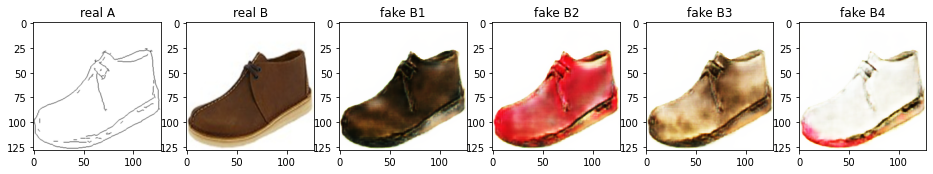

Train Epoch: 1 63% 	Total Loss: 5.676321 	Loss_GAN: 2.925302	Loss_GAN_VAE: 0.779374	Loss_GAN_LR: 0.865297	Loss_D_VAE: 1.487723	Loss_D_LR: 1.263296
0 31509 T:  9.551900386810303
Train Epoch: 1 63% 	Total Loss: 5.147746 	Loss_GAN: 2.859954	Loss_GAN_VAE: 0.822773	Loss_GAN_LR: 0.962399	Loss_D_VAE: 1.217657	Loss_D_LR: 1.070134
0 31519 T:  9.236707210540771
Train Epoch: 1 63% 	Total Loss: 5.811350 	Loss_GAN: 3.175085	Loss_GAN_VAE: 0.897583	Loss_GAN_LR: 0.876953	Loss_D_VAE: 1.244015	Loss_D_LR: 1.392250
0 31529 T:  8.556804895401001
Train Epoch: 1 63% 	Total Loss: 5.506227 	Loss_GAN: 3.054728	Loss_GAN_VAE: 0.863886	Loss_GAN_LR: 0.894446	Loss_D_VAE: 1.285778	Loss_D_LR: 1.165720
0 31539 T:  8.585602283477783
Train Epoch: 1 63% 	Total Loss: 5.770772 	Loss_GAN: 3.171344	Loss_GAN_VAE: 0.841709	Loss_GAN_LR: 0.876516	Loss_D_VAE: 1.210093	Loss_D_LR: 1.389335
0 31549 T:  8.93435025215149
Train Epoch: 1 63% 	Total Loss: 5.331029 	Loss_GAN: 2.663303	Loss_GAN_VAE: 0.791497	Loss_GAN_LR: 0.830031	Loss_D_VAE

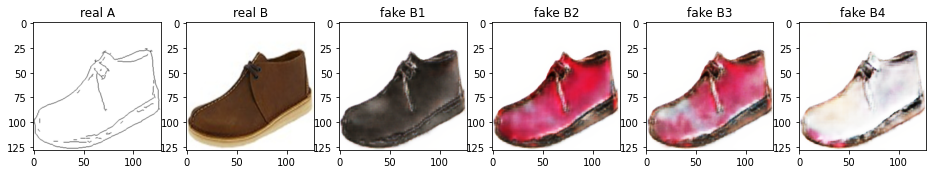

Train Epoch: 1 64% 	Total Loss: 5.458413 	Loss_GAN: 3.296594	Loss_GAN_VAE: 0.962556	Loss_GAN_LR: 0.867052	Loss_D_VAE: 1.016282	Loss_D_LR: 1.145536
0 32009 T:  10.53902292251587
Train Epoch: 1 64% 	Total Loss: 6.108635 	Loss_GAN: 3.602321	Loss_GAN_VAE: 1.024450	Loss_GAN_LR: 1.005216	Loss_D_VAE: 1.248468	Loss_D_LR: 1.257847
0 32019 T:  8.82422661781311
Train Epoch: 1 64% 	Total Loss: 6.050481 	Loss_GAN: 3.286462	Loss_GAN_VAE: 0.690817	Loss_GAN_LR: 0.885531	Loss_D_VAE: 1.585083	Loss_D_LR: 1.178936
0 32029 T:  8.619369506835938
Train Epoch: 1 64% 	Total Loss: 5.944475 	Loss_GAN: 3.343960	Loss_GAN_VAE: 0.850447	Loss_GAN_LR: 0.952739	Loss_D_VAE: 1.400767	Loss_D_LR: 1.199748
0 32039 T:  9.145984172821045
Train Epoch: 1 64% 	Total Loss: 5.566675 	Loss_GAN: 2.931660	Loss_GAN_VAE: 0.796978	Loss_GAN_LR: 0.893413	Loss_D_VAE: 1.393463	Loss_D_LR: 1.241552
0 32049 T:  8.527271747589111
Train Epoch: 1 64% 	Total Loss: 5.931244 	Loss_GAN: 3.325425	Loss_GAN_VAE: 0.825314	Loss_GAN_LR: 0.874618	Loss_D_VAE

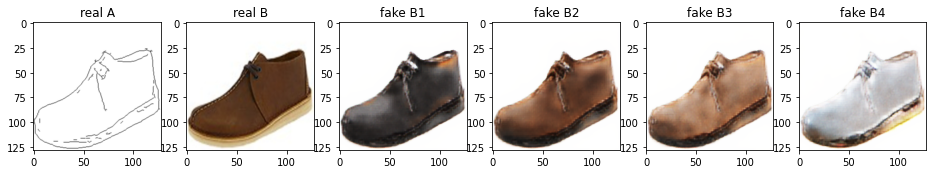

Train Epoch: 1 65% 	Total Loss: 5.924663 	Loss_GAN: 3.408759	Loss_GAN_VAE: 0.893621	Loss_GAN_LR: 1.032657	Loss_D_VAE: 1.286364	Loss_D_LR: 1.229540
0 32509 T:  9.36940598487854
Train Epoch: 1 65% 	Total Loss: 5.536882 	Loss_GAN: 3.118586	Loss_GAN_VAE: 0.888018	Loss_GAN_LR: 0.922095	Loss_D_VAE: 1.244179	Loss_D_LR: 1.174117
0 32519 T:  9.126814365386963
Train Epoch: 1 65% 	Total Loss: 5.325304 	Loss_GAN: 2.850816	Loss_GAN_VAE: 0.827866	Loss_GAN_LR: 0.805843	Loss_D_VAE: 1.270481	Loss_D_LR: 1.204006
0 32529 T:  8.890551567077637
Train Epoch: 1 65% 	Total Loss: 6.054125 	Loss_GAN: 3.383539	Loss_GAN_VAE: 0.743099	Loss_GAN_LR: 0.972959	Loss_D_VAE: 1.463115	Loss_D_LR: 1.207471
0 32539 T:  9.585968255996704
Train Epoch: 1 65% 	Total Loss: 5.620308 	Loss_GAN: 3.160228	Loss_GAN_VAE: 0.795896	Loss_GAN_LR: 0.865245	Loss_D_VAE: 1.276780	Loss_D_LR: 1.183300
0 32549 T:  8.721524238586426
Train Epoch: 1 65% 	Total Loss: 5.339366 	Loss_GAN: 2.855700	Loss_GAN_VAE: 0.863008	Loss_GAN_LR: 0.906410	Loss_D_VAE

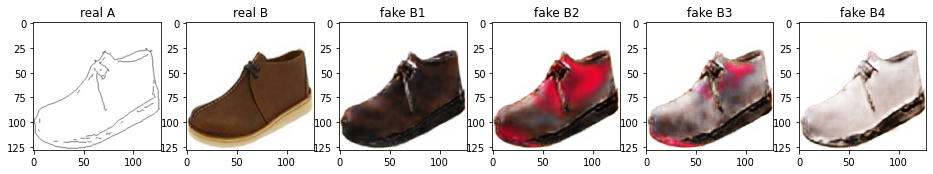

Train Epoch: 1 66% 	Total Loss: 5.672768 	Loss_GAN: 3.042815	Loss_GAN_VAE: 0.857061	Loss_GAN_LR: 0.834867	Loss_D_VAE: 1.357423	Loss_D_LR: 1.272530
0 33009 T:  9.966876029968262
Train Epoch: 1 66% 	Total Loss: 5.740809 	Loss_GAN: 3.255899	Loss_GAN_VAE: 0.807121	Loss_GAN_LR: 0.880910	Loss_D_VAE: 1.293527	Loss_D_LR: 1.191383
0 33019 T:  8.457489490509033
Train Epoch: 1 66% 	Total Loss: 5.549796 	Loss_GAN: 2.733965	Loss_GAN_VAE: 0.727505	Loss_GAN_LR: 0.791868	Loss_D_VAE: 1.431680	Loss_D_LR: 1.384151
0 33029 T:  8.929728269577026
Train Epoch: 1 66% 	Total Loss: 6.089610 	Loss_GAN: 3.973710	Loss_GAN_VAE: 0.928913	Loss_GAN_LR: 1.185195	Loss_D_VAE: 1.172135	Loss_D_LR: 0.943765
0 33039 T:  8.566516876220703
Train Epoch: 1 66% 	Total Loss: 5.777514 	Loss_GAN: 2.771086	Loss_GAN_VAE: 0.785263	Loss_GAN_LR: 0.707773	Loss_D_VAE: 1.509504	Loss_D_LR: 1.496923
0 33049 T:  8.444491863250732
Train Epoch: 1 66% 	Total Loss: 5.579489 	Loss_GAN: 3.090002	Loss_GAN_VAE: 0.846776	Loss_GAN_LR: 0.898139	Loss_D_VA

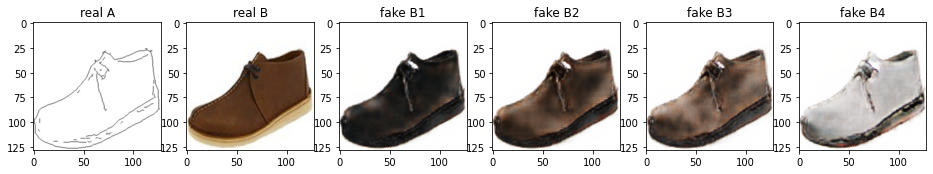

Train Epoch: 1 67% 	Total Loss: 5.608506 	Loss_GAN: 2.813187	Loss_GAN_VAE: 0.827003	Loss_GAN_LR: 0.790237	Loss_D_VAE: 1.437039	Loss_D_LR: 1.358279
0 33509 T:  9.42051076889038
Train Epoch: 1 67% 	Total Loss: 5.327756 	Loss_GAN: 2.727462	Loss_GAN_VAE: 0.843220	Loss_GAN_LR: 0.808879	Loss_D_VAE: 1.244157	Loss_D_LR: 1.356138
0 33519 T:  8.612144231796265
Train Epoch: 1 67% 	Total Loss: 5.430388 	Loss_GAN: 2.987122	Loss_GAN_VAE: 0.962969	Loss_GAN_LR: 0.920199	Loss_D_VAE: 1.175547	Loss_D_LR: 1.267720
0 33529 T:  8.96715259552002
Train Epoch: 1 67% 	Total Loss: 6.098810 	Loss_GAN: 3.861175	Loss_GAN_VAE: 1.035607	Loss_GAN_LR: 1.107259	Loss_D_VAE: 1.307856	Loss_D_LR: 0.929780
0 33539 T:  8.813798666000366
Train Epoch: 1 67% 	Total Loss: 5.414993 	Loss_GAN: 3.337206	Loss_GAN_VAE: 1.054303	Loss_GAN_LR: 1.157905	Loss_D_VAE: 1.138137	Loss_D_LR: 0.939650
0 33549 T:  8.937693119049072
Train Epoch: 1 67% 	Total Loss: 6.046506 	Loss_GAN: 3.363208	Loss_GAN_VAE: 0.902318	Loss_GAN_LR: 1.008334	Loss_D_VAE:

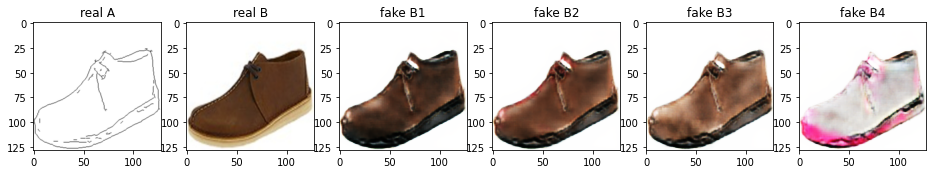

Train Epoch: 1 68% 	Total Loss: 6.135194 	Loss_GAN: 2.963327	Loss_GAN_VAE: 0.750090	Loss_GAN_LR: 0.685639	Loss_D_VAE: 1.551854	Loss_D_LR: 1.620013
0 34009 T:  10.155181169509888
Train Epoch: 1 68% 	Total Loss: 5.651707 	Loss_GAN: 3.069398	Loss_GAN_VAE: 0.823189	Loss_GAN_LR: 0.865930	Loss_D_VAE: 1.324712	Loss_D_LR: 1.257597
0 34019 T:  8.454192399978638
Train Epoch: 1 68% 	Total Loss: 6.039982 	Loss_GAN: 3.589423	Loss_GAN_VAE: 0.908409	Loss_GAN_LR: 0.948885	Loss_D_VAE: 1.232735	Loss_D_LR: 1.217825
0 34029 T:  8.793533563613892
Train Epoch: 1 68% 	Total Loss: 5.483099 	Loss_GAN: 3.057771	Loss_GAN_VAE: 0.825560	Loss_GAN_LR: 1.062796	Loss_D_VAE: 1.296116	Loss_D_LR: 1.129211
0 34039 T:  8.471698522567749
Train Epoch: 1 68% 	Total Loss: 5.920269 	Loss_GAN: 3.097298	Loss_GAN_VAE: 0.758213	Loss_GAN_LR: 0.861437	Loss_D_VAE: 1.479426	Loss_D_LR: 1.343545
0 34049 T:  9.23446249961853
Train Epoch: 1 68% 	Total Loss: 5.510849 	Loss_GAN: 3.186230	Loss_GAN_VAE: 0.858739	Loss_GAN_LR: 1.108420	Loss_D_VA

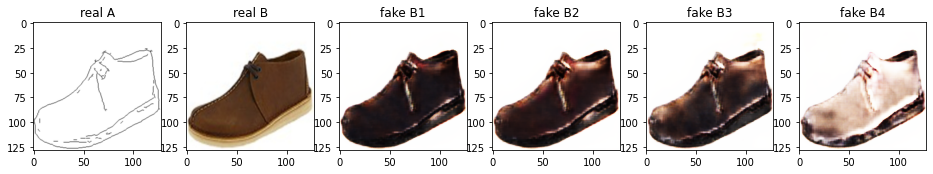

Train Epoch: 1 69% 	Total Loss: 5.714045 	Loss_GAN: 3.049007	Loss_GAN_VAE: 0.729462	Loss_GAN_LR: 0.833621	Loss_D_VAE: 1.467494	Loss_D_LR: 1.197544
0 34509 T:  9.449185132980347
Train Epoch: 1 69% 	Total Loss: 5.724543 	Loss_GAN: 3.148087	Loss_GAN_VAE: 0.763464	Loss_GAN_LR: 0.886318	Loss_D_VAE: 1.284850	Loss_D_LR: 1.291606
0 34519 T:  9.000674724578857
Train Epoch: 1 69% 	Total Loss: 5.948225 	Loss_GAN: 3.546032	Loss_GAN_VAE: 0.921540	Loss_GAN_LR: 1.051417	Loss_D_VAE: 1.359680	Loss_D_LR: 1.042513
0 34529 T:  8.955493688583374
Train Epoch: 1 69% 	Total Loss: 5.721332 	Loss_GAN: 3.067975	Loss_GAN_VAE: 0.781526	Loss_GAN_LR: 0.999651	Loss_D_VAE: 1.398830	Loss_D_LR: 1.254527
0 34539 T:  8.961776971817017
Train Epoch: 1 69% 	Total Loss: 5.741538 	Loss_GAN: 3.363634	Loss_GAN_VAE: 0.888404	Loss_GAN_LR: 0.960057	Loss_D_VAE: 1.150899	Loss_D_LR: 1.227005
0 34549 T:  8.386616945266724
Train Epoch: 1 69% 	Total Loss: 6.037644 	Loss_GAN: 3.568101	Loss_GAN_VAE: 0.892960	Loss_GAN_LR: 1.013712	Loss_D_VA

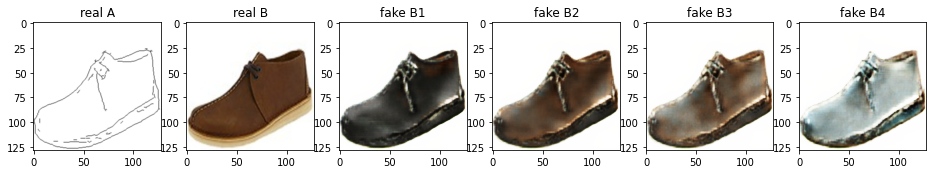

Train Epoch: 1 70% 	Total Loss: 6.037848 	Loss_GAN: 3.741296	Loss_GAN_VAE: 1.010257	Loss_GAN_LR: 1.076618	Loss_D_VAE: 1.174052	Loss_D_LR: 1.122500
0 35009 T:  10.375515222549438
Train Epoch: 1 70% 	Total Loss: 5.885592 	Loss_GAN: 3.346661	Loss_GAN_VAE: 0.894180	Loss_GAN_LR: 1.177870	Loss_D_VAE: 1.363230	Loss_D_LR: 1.175700
0 35019 T:  8.873510360717773
Train Epoch: 1 70% 	Total Loss: 5.466716 	Loss_GAN: 3.036007	Loss_GAN_VAE: 0.803129	Loss_GAN_LR: 1.078553	Loss_D_VAE: 1.280950	Loss_D_LR: 1.149758
0 35029 T:  8.620646953582764
Train Epoch: 1 70% 	Total Loss: 5.790141 	Loss_GAN: 3.711050	Loss_GAN_VAE: 0.971694	Loss_GAN_LR: 1.226399	Loss_D_VAE: 1.126236	Loss_D_LR: 0.952855
0 35039 T:  8.721036672592163
Train Epoch: 1 70% 	Total Loss: 5.885267 	Loss_GAN: 3.520649	Loss_GAN_VAE: 0.953835	Loss_GAN_LR: 1.121377	Loss_D_VAE: 1.308686	Loss_D_LR: 1.055932
0 35049 T:  8.680958271026611
Train Epoch: 1 70% 	Total Loss: 5.604823 	Loss_GAN: 3.294556	Loss_GAN_VAE: 1.007762	Loss_GAN_LR: 0.970654	Loss_D_V

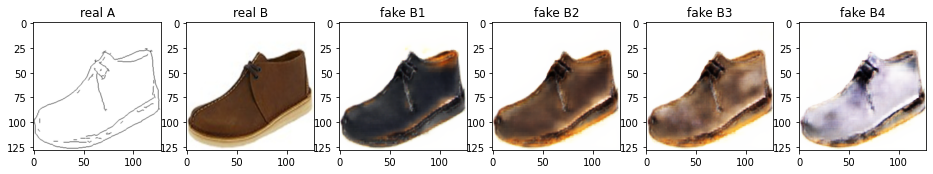

Train Epoch: 1 71% 	Total Loss: 5.484997 	Loss_GAN: 2.838763	Loss_GAN_VAE: 0.839831	Loss_GAN_LR: 0.811271	Loss_D_VAE: 1.317187	Loss_D_LR: 1.329046
0 35509 T:  9.527093410491943
Train Epoch: 1 71% 	Total Loss: 5.720865 	Loss_GAN: 3.451722	Loss_GAN_VAE: 0.990406	Loss_GAN_LR: 0.934383	Loss_D_VAE: 1.106910	Loss_D_LR: 1.162233
0 35519 T:  8.594231367111206
Train Epoch: 1 71% 	Total Loss: 5.474570 	Loss_GAN: 2.850408	Loss_GAN_VAE: 0.857704	Loss_GAN_LR: 0.854177	Loss_D_VAE: 1.346821	Loss_D_LR: 1.277342
0 35529 T:  8.367010354995728
Train Epoch: 1 71% 	Total Loss: 5.366998 	Loss_GAN: 2.658011	Loss_GAN_VAE: 0.898661	Loss_GAN_LR: 0.830692	Loss_D_VAE: 1.284101	Loss_D_LR: 1.424887
0 35539 T:  8.747806787490845
Train Epoch: 1 71% 	Total Loss: 5.941902 	Loss_GAN: 3.331904	Loss_GAN_VAE: 0.943443	Loss_GAN_LR: 0.890098	Loss_D_VAE: 1.308884	Loss_D_LR: 1.301114
0 35549 T:  9.20782732963562
Train Epoch: 1 71% 	Total Loss: 5.343193 	Loss_GAN: 2.659321	Loss_GAN_VAE: 0.770533	Loss_GAN_LR: 0.877609	Loss_D_VAE

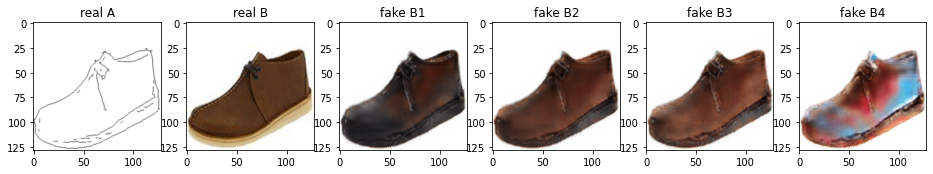

Train Epoch: 1 72% 	Total Loss: 6.197086 	Loss_GAN: 3.808344	Loss_GAN_VAE: 0.956077	Loss_GAN_LR: 1.084604	Loss_D_VAE: 1.270954	Loss_D_LR: 1.117789
0 36009 T:  9.731751918792725
Train Epoch: 1 72% 	Total Loss: 5.385072 	Loss_GAN: 2.962115	Loss_GAN_VAE: 0.789037	Loss_GAN_LR: 0.944011	Loss_D_VAE: 1.343948	Loss_D_LR: 1.079009
0 36019 T:  8.480791568756104
Train Epoch: 1 72% 	Total Loss: 5.835641 	Loss_GAN: 3.558651	Loss_GAN_VAE: 0.933274	Loss_GAN_LR: 1.060820	Loss_D_VAE: 1.139390	Loss_D_LR: 1.137600
0 36029 T:  8.737171173095703
Train Epoch: 1 72% 	Total Loss: 5.983026 	Loss_GAN: 3.499329	Loss_GAN_VAE: 0.687210	Loss_GAN_LR: 1.394713	Loss_D_VAE: 1.610462	Loss_D_LR: 0.873236
0 36039 T:  8.828545808792114
Train Epoch: 1 72% 	Total Loss: 6.191424 	Loss_GAN: 4.097347	Loss_GAN_VAE: 0.886263	Loss_GAN_LR: 1.434746	Loss_D_VAE: 1.146366	Loss_D_LR: 0.947711
0 36049 T:  8.58698320388794
Train Epoch: 1 72% 	Total Loss: 6.083617 	Loss_GAN: 2.913765	Loss_GAN_VAE: 0.808418	Loss_GAN_LR: 0.889751	Loss_D_VAE

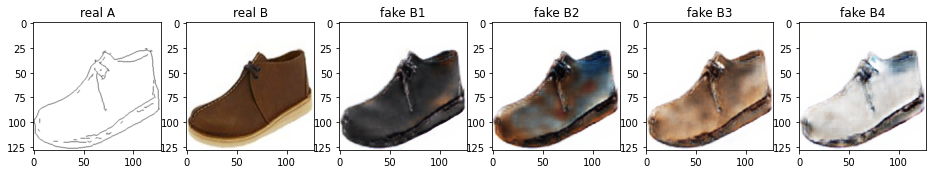

Train Epoch: 1 73% 	Total Loss: 5.936873 	Loss_GAN: 3.794419	Loss_GAN_VAE: 0.982989	Loss_GAN_LR: 1.277526	Loss_D_VAE: 1.076915	Loss_D_LR: 1.065540
0 36509 T:  9.941669464111328
Train Epoch: 1 73% 	Total Loss: 5.411123 	Loss_GAN: 2.847336	Loss_GAN_VAE: 0.901462	Loss_GAN_LR: 0.898846	Loss_D_VAE: 1.287404	Loss_D_LR: 1.276382
0 36519 T:  8.942378997802734
Train Epoch: 1 73% 	Total Loss: 5.565117 	Loss_GAN: 2.937874	Loss_GAN_VAE: 0.769813	Loss_GAN_LR: 0.892927	Loss_D_VAE: 1.348403	Loss_D_LR: 1.278840
0 36529 T:  9.10370659828186
Train Epoch: 1 73% 	Total Loss: 5.398016 	Loss_GAN: 2.760796	Loss_GAN_VAE: 0.814915	Loss_GAN_LR: 0.799593	Loss_D_VAE: 1.268422	Loss_D_LR: 1.368797
0 36539 T:  8.827902793884277
Train Epoch: 1 73% 	Total Loss: 6.252594 	Loss_GAN: 3.842662	Loss_GAN_VAE: 0.783259	Loss_GAN_LR: 1.574821	Loss_D_VAE: 1.260399	Loss_D_LR: 1.149532
0 36549 T:  8.972450494766235
Train Epoch: 1 73% 	Total Loss: 5.268844 	Loss_GAN: 3.217524	Loss_GAN_VAE: 0.973681	Loss_GAN_LR: 0.983374	Loss_D_VAE

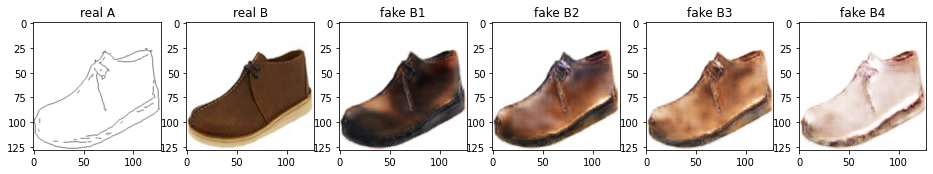

Train Epoch: 1 74% 	Total Loss: 5.723734 	Loss_GAN: 3.195268	Loss_GAN_VAE: 0.947674	Loss_GAN_LR: 1.012210	Loss_D_VAE: 1.182654	Loss_D_LR: 1.345811
0 37009 T:  10.568342208862305
Train Epoch: 1 74% 	Total Loss: 5.603312 	Loss_GAN: 3.137061	Loss_GAN_VAE: 0.918964	Loss_GAN_LR: 1.018195	Loss_D_VAE: 1.288375	Loss_D_LR: 1.177876
0 37019 T:  8.76328444480896
Train Epoch: 1 74% 	Total Loss: 5.853274 	Loss_GAN: 3.186997	Loss_GAN_VAE: 0.957333	Loss_GAN_LR: 0.802890	Loss_D_VAE: 1.244293	Loss_D_LR: 1.421983
0 37029 T:  8.913484811782837
Train Epoch: 1 74% 	Total Loss: 5.429860 	Loss_GAN: 3.359459	Loss_GAN_VAE: 1.074581	Loss_GAN_LR: 1.056525	Loss_D_VAE: 1.129368	Loss_D_LR: 0.941034
0 37039 T:  9.017040014266968
Train Epoch: 1 74% 	Total Loss: 6.404199 	Loss_GAN: 3.733919	Loss_GAN_VAE: 0.867741	Loss_GAN_LR: 1.096486	Loss_D_VAE: 1.360297	Loss_D_LR: 1.309983
0 37049 T:  8.84576678276062
Train Epoch: 1 74% 	Total Loss: 5.725531 	Loss_GAN: 3.077710	Loss_GAN_VAE: 0.808387	Loss_GAN_LR: 0.931342	Loss_D_VAE

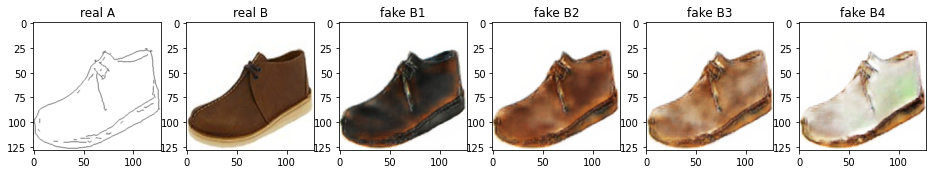

Train Epoch: 1 75% 	Total Loss: 5.303804 	Loss_GAN: 2.853884	Loss_GAN_VAE: 0.826423	Loss_GAN_LR: 0.872175	Loss_D_VAE: 1.202044	Loss_D_LR: 1.247876
0 37509 T:  10.83216142654419
Train Epoch: 1 75% 	Total Loss: 6.067209 	Loss_GAN: 3.810572	Loss_GAN_VAE: 1.080370	Loss_GAN_LR: 1.225482	Loss_D_VAE: 1.095842	Loss_D_LR: 1.160795
0 37519 T:  8.741052865982056
Train Epoch: 1 75% 	Total Loss: 5.735690 	Loss_GAN: 3.041606	Loss_GAN_VAE: 0.934422	Loss_GAN_LR: 0.957286	Loss_D_VAE: 1.274738	Loss_D_LR: 1.419346
0 37529 T:  8.638648271560669
Train Epoch: 1 75% 	Total Loss: 5.710743 	Loss_GAN: 3.051236	Loss_GAN_VAE: 0.888577	Loss_GAN_LR: 0.913724	Loss_D_VAE: 1.409451	Loss_D_LR: 1.250056
0 37539 T:  8.806202411651611
Train Epoch: 1 75% 	Total Loss: 5.994058 	Loss_GAN: 3.311336	Loss_GAN_VAE: 0.811616	Loss_GAN_LR: 1.021672	Loss_D_VAE: 1.387477	Loss_D_LR: 1.295245
0 37549 T:  8.460281133651733
Train Epoch: 1 75% 	Total Loss: 6.111131 	Loss_GAN: 3.773638	Loss_GAN_VAE: 0.864748	Loss_GAN_LR: 1.260952	Loss_D_VA

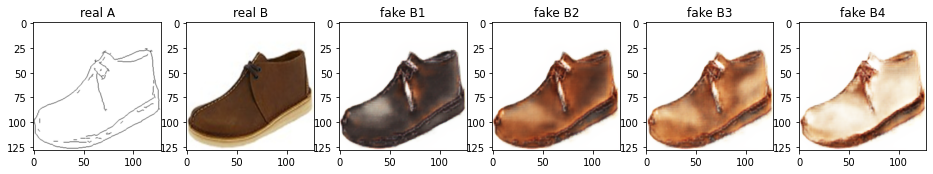

Train Epoch: 1 76% 	Total Loss: 5.866099 	Loss_GAN: 3.489554	Loss_GAN_VAE: 0.917712	Loss_GAN_LR: 0.887251	Loss_D_VAE: 1.174005	Loss_D_LR: 1.202540
0 38009 T:  9.84958004951477
Train Epoch: 1 76% 	Total Loss: 6.142697 	Loss_GAN: 3.560784	Loss_GAN_VAE: 0.916428	Loss_GAN_LR: 1.186668	Loss_D_VAE: 1.353728	Loss_D_LR: 1.228185
0 38019 T:  8.969088792800903
Train Epoch: 1 76% 	Total Loss: 6.225591 	Loss_GAN: 3.384145	Loss_GAN_VAE: 0.853305	Loss_GAN_LR: 0.926926	Loss_D_VAE: 1.570316	Loss_D_LR: 1.271131
0 38029 T:  8.625372171401978
Train Epoch: 1 76% 	Total Loss: 5.458493 	Loss_GAN: 3.311072	Loss_GAN_VAE: 0.827385	Loss_GAN_LR: 1.077508	Loss_D_VAE: 1.204349	Loss_D_LR: 0.943072
0 38039 T:  8.915833711624146
Train Epoch: 1 76% 	Total Loss: 6.257944 	Loss_GAN: 4.064494	Loss_GAN_VAE: 1.094910	Loss_GAN_LR: 1.060173	Loss_D_VAE: 1.239077	Loss_D_LR: 0.954373
0 38049 T:  9.00876498222351
Train Epoch: 1 76% 	Total Loss: 5.867458 	Loss_GAN: 3.032997	Loss_GAN_VAE: 0.802793	Loss_GAN_LR: 0.925431	Loss_D_VAE:

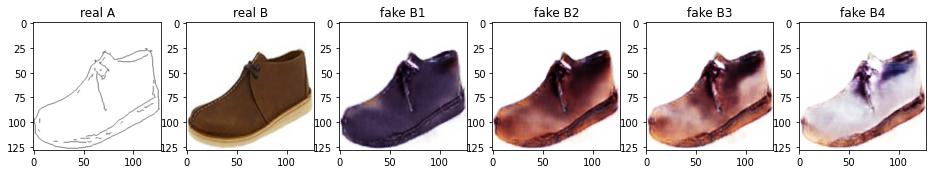

Train Epoch: 1 77% 	Total Loss: 5.986996 	Loss_GAN: 3.955865	Loss_GAN_VAE: 0.999147	Loss_GAN_LR: 1.232858	Loss_D_VAE: 1.221676	Loss_D_LR: 0.809455
0 38509 T:  9.379513502120972
Train Epoch: 1 77% 	Total Loss: 6.417211 	Loss_GAN: 3.880200	Loss_GAN_VAE: 0.775272	Loss_GAN_LR: 1.330916	Loss_D_VAE: 1.380355	Loss_D_LR: 1.156656
0 38519 T:  8.385532855987549
Train Epoch: 1 77% 	Total Loss: 5.759630 	Loss_GAN: 3.495121	Loss_GAN_VAE: 0.947894	Loss_GAN_LR: 1.199537	Loss_D_VAE: 1.309548	Loss_D_LR: 0.954961
0 38529 T:  9.055519104003906
Train Epoch: 1 77% 	Total Loss: 5.689465 	Loss_GAN: 3.503059	Loss_GAN_VAE: 0.940767	Loss_GAN_LR: 1.217401	Loss_D_VAE: 1.101098	Loss_D_LR: 1.085308
0 38539 T:  9.17941951751709
Train Epoch: 1 77% 	Total Loss: 5.768228 	Loss_GAN: 3.430806	Loss_GAN_VAE: 0.965109	Loss_GAN_LR: 1.152143	Loss_D_VAE: 1.153396	Loss_D_LR: 1.184027
0 38549 T:  8.624969959259033
Train Epoch: 1 77% 	Total Loss: 5.777654 	Loss_GAN: 3.306332	Loss_GAN_VAE: 0.860080	Loss_GAN_LR: 0.931365	Loss_D_VAE

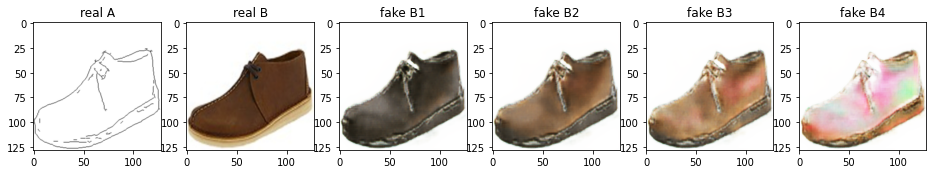

Train Epoch: 1 78% 	Total Loss: 5.711622 	Loss_GAN: 2.894206	Loss_GAN_VAE: 0.822066	Loss_GAN_LR: 0.810616	Loss_D_VAE: 1.334953	Loss_D_LR: 1.482464
0 39009 T:  10.548726320266724
Train Epoch: 1 78% 	Total Loss: 5.531627 	Loss_GAN: 3.569016	Loss_GAN_VAE: 1.070860	Loss_GAN_LR: 1.116135	Loss_D_VAE: 1.057023	Loss_D_LR: 0.905588
0 39019 T:  8.810844898223877
Train Epoch: 1 78% 	Total Loss: 6.683217 	Loss_GAN: 4.088640	Loss_GAN_VAE: 1.009608	Loss_GAN_LR: 1.081753	Loss_D_VAE: 1.275767	Loss_D_LR: 1.318810
0 39029 T:  9.036472082138062
Train Epoch: 1 78% 	Total Loss: 6.079798 	Loss_GAN: 3.266871	Loss_GAN_VAE: 0.794986	Loss_GAN_LR: 0.942507	Loss_D_VAE: 1.471460	Loss_D_LR: 1.341468
0 39039 T:  9.161290168762207
Train Epoch: 1 78% 	Total Loss: 5.926220 	Loss_GAN: 3.780315	Loss_GAN_VAE: 0.916753	Loss_GAN_LR: 1.363922	Loss_D_VAE: 1.161485	Loss_D_LR: 0.984419
0 39049 T:  9.662074327468872
Train Epoch: 1 78% 	Total Loss: 5.541214 	Loss_GAN: 3.213887	Loss_GAN_VAE: 0.961446	Loss_GAN_LR: 0.979644	Loss_D_V

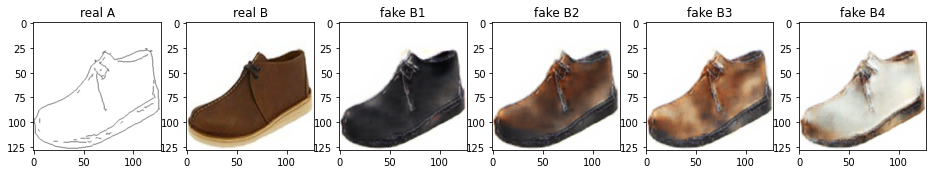

Train Epoch: 1 79% 	Total Loss: 5.972272 	Loss_GAN: 3.307200	Loss_GAN_VAE: 0.819327	Loss_GAN_LR: 1.004995	Loss_D_VAE: 1.340814	Loss_D_LR: 1.324259
0 39509 T:  9.981457233428955
Train Epoch: 1 79% 	Total Loss: 5.619889 	Loss_GAN: 2.947864	Loss_GAN_VAE: 0.886939	Loss_GAN_LR: 0.849290	Loss_D_VAE: 1.227099	Loss_D_LR: 1.444925
0 39519 T:  9.097238063812256
Train Epoch: 1 79% 	Total Loss: 5.566035 	Loss_GAN: 3.075272	Loss_GAN_VAE: 0.916086	Loss_GAN_LR: 0.858498	Loss_D_VAE: 1.177623	Loss_D_LR: 1.313140
0 39529 T:  8.78510308265686
Train Epoch: 1 79% 	Total Loss: 5.471860 	Loss_GAN: 2.946914	Loss_GAN_VAE: 0.922673	Loss_GAN_LR: 0.903218	Loss_D_VAE: 1.299095	Loss_D_LR: 1.225851
0 39539 T:  8.495126247406006
Train Epoch: 1 79% 	Total Loss: 5.680816 	Loss_GAN: 3.109472	Loss_GAN_VAE: 0.939490	Loss_GAN_LR: 0.918261	Loss_D_VAE: 1.215702	Loss_D_LR: 1.355643
0 39549 T:  9.103673219680786
Train Epoch: 1 79% 	Total Loss: 5.422195 	Loss_GAN: 2.778707	Loss_GAN_VAE: 0.821819	Loss_GAN_LR: 0.762259	Loss_D_VAE

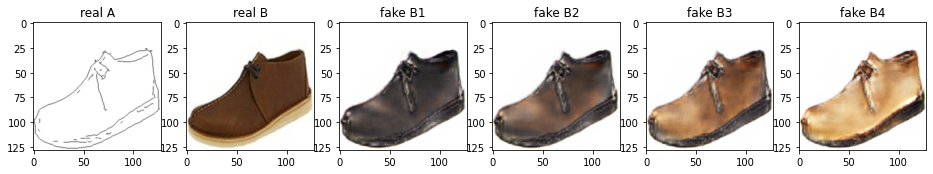

Train Epoch: 1 80% 	Total Loss: 5.768830 	Loss_GAN: 3.277091	Loss_GAN_VAE: 0.895609	Loss_GAN_LR: 1.011505	Loss_D_VAE: 1.361114	Loss_D_LR: 1.130625
0 40009 T:  10.086894273757935
Train Epoch: 1 80% 	Total Loss: 5.450629 	Loss_GAN: 2.893572	Loss_GAN_VAE: 0.790086	Loss_GAN_LR: 0.876703	Loss_D_VAE: 1.282817	Loss_D_LR: 1.274240
0 40019 T:  8.805578708648682
Train Epoch: 1 80% 	Total Loss: 5.300249 	Loss_GAN: 3.485164	Loss_GAN_VAE: 1.019117	Loss_GAN_LR: 1.188073	Loss_D_VAE: 0.981266	Loss_D_LR: 0.833819
0 40029 T:  8.76336407661438
Train Epoch: 1 80% 	Total Loss: 6.354532 	Loss_GAN: 4.234408	Loss_GAN_VAE: 0.951759	Loss_GAN_LR: 1.212987	Loss_D_VAE: 1.218288	Loss_D_LR: 0.901836
0 40039 T:  9.068770408630371
Train Epoch: 1 80% 	Total Loss: 5.694752 	Loss_GAN: 3.251953	Loss_GAN_VAE: 0.831550	Loss_GAN_LR: 0.993275	Loss_D_VAE: 1.345085	Loss_D_LR: 1.097715
0 40049 T:  8.718748331069946
Train Epoch: 1 80% 	Total Loss: 6.398141 	Loss_GAN: 5.159614	Loss_GAN_VAE: 1.235593	Loss_GAN_LR: 2.026703	Loss_D_VA

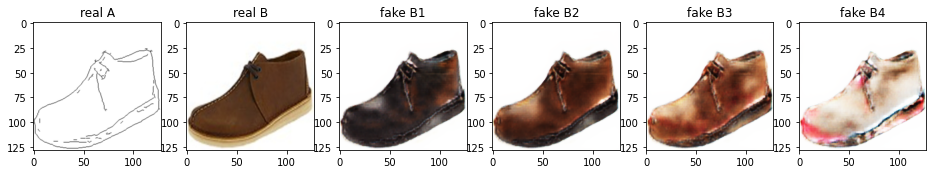

Train Epoch: 1 81% 	Total Loss: 5.874319 	Loss_GAN: 2.876577	Loss_GAN_VAE: 0.805324	Loss_GAN_LR: 0.882294	Loss_D_VAE: 1.421571	Loss_D_LR: 1.576171
0 40509 T:  9.789412021636963
Train Epoch: 1 81% 	Total Loss: 5.900937 	Loss_GAN: 3.392962	Loss_GAN_VAE: 1.027248	Loss_GAN_LR: 0.879901	Loss_D_VAE: 1.190540	Loss_D_LR: 1.317435
0 40519 T:  8.269136667251587
Train Epoch: 1 81% 	Total Loss: 6.442320 	Loss_GAN: 3.522560	Loss_GAN_VAE: 0.708963	Loss_GAN_LR: 0.973652	Loss_D_VAE: 1.716259	Loss_D_LR: 1.203501
0 40529 T:  9.090730905532837
Train Epoch: 1 81% 	Total Loss: 6.195453 	Loss_GAN: 3.729764	Loss_GAN_VAE: 0.993709	Loss_GAN_LR: 0.940203	Loss_D_VAE: 1.254354	Loss_D_LR: 1.211336
0 40539 T:  8.694276809692383
Train Epoch: 1 81% 	Total Loss: 6.033682 	Loss_GAN: 3.423162	Loss_GAN_VAE: 0.804580	Loss_GAN_LR: 1.041147	Loss_D_VAE: 1.344027	Loss_D_LR: 1.266492
0 40549 T:  9.209700345993042
Train Epoch: 1 81% 	Total Loss: 5.620715 	Loss_GAN: 3.088740	Loss_GAN_VAE: 0.801920	Loss_GAN_LR: 1.052707	Loss_D_VA

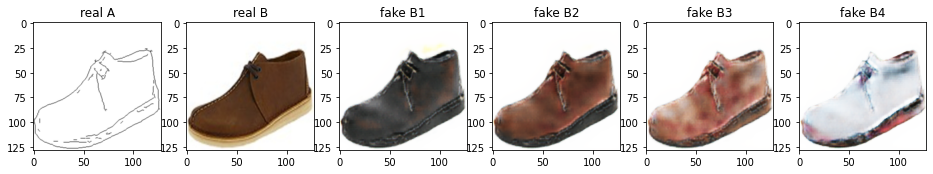

Train Epoch: 1 82% 	Total Loss: 5.285629 	Loss_GAN: 2.714107	Loss_GAN_VAE: 0.746565	Loss_GAN_LR: 0.878585	Loss_D_VAE: 1.195122	Loss_D_LR: 1.376400
0 41009 T:  10.62008285522461
Train Epoch: 1 82% 	Total Loss: 5.644765 	Loss_GAN: 2.886461	Loss_GAN_VAE: 0.956550	Loss_GAN_LR: 0.761002	Loss_D_VAE: 1.327248	Loss_D_LR: 1.431055
0 41019 T:  8.883839130401611
Train Epoch: 1 82% 	Total Loss: 5.396946 	Loss_GAN: 2.680652	Loss_GAN_VAE: 0.820590	Loss_GAN_LR: 0.815459	Loss_D_VAE: 1.296741	Loss_D_LR: 1.419553
0 41029 T:  8.344035387039185
Train Epoch: 1 82% 	Total Loss: 5.887843 	Loss_GAN: 3.467522	Loss_GAN_VAE: 0.931418	Loss_GAN_LR: 0.982048	Loss_D_VAE: 1.295555	Loss_D_LR: 1.124766
0 41039 T:  8.923237323760986
Train Epoch: 1 82% 	Total Loss: 5.340148 	Loss_GAN: 2.866549	Loss_GAN_VAE: 0.853606	Loss_GAN_LR: 1.001968	Loss_D_VAE: 1.422399	Loss_D_LR: 1.051200
0 41049 T:  8.72226619720459
Train Epoch: 1 82% 	Total Loss: 5.650211 	Loss_GAN: 2.981452	Loss_GAN_VAE: 0.780712	Loss_GAN_LR: 0.776378	Loss_D_VAE

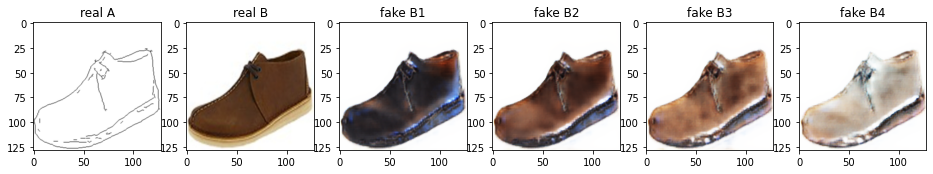

Train Epoch: 1 83% 	Total Loss: 5.979942 	Loss_GAN: 3.075494	Loss_GAN_VAE: 0.784149	Loss_GAN_LR: 0.914519	Loss_D_VAE: 1.423530	Loss_D_LR: 1.480917
0 41509 T:  9.334729671478271
Train Epoch: 1 83% 	Total Loss: 5.595425 	Loss_GAN: 3.281617	Loss_GAN_VAE: 0.945332	Loss_GAN_LR: 0.983741	Loss_D_VAE: 1.210070	Loss_D_LR: 1.103738
0 41519 T:  9.047328472137451
Train Epoch: 1 83% 	Total Loss: 6.140591 	Loss_GAN: 2.944229	Loss_GAN_VAE: 0.776014	Loss_GAN_LR: 0.827477	Loss_D_VAE: 1.542714	Loss_D_LR: 1.653648
0 41529 T:  8.774931907653809
Train Epoch: 1 83% 	Total Loss: 5.651267 	Loss_GAN: 2.803041	Loss_GAN_VAE: 0.780039	Loss_GAN_LR: 0.777817	Loss_D_VAE: 1.342792	Loss_D_LR: 1.505435
0 41539 T:  9.030173778533936
Train Epoch: 1 83% 	Total Loss: 6.119948 	Loss_GAN: 3.465156	Loss_GAN_VAE: 0.778140	Loss_GAN_LR: 0.907641	Loss_D_VAE: 1.354541	Loss_D_LR: 1.300251
0 41549 T:  8.957413673400879
Train Epoch: 1 83% 	Total Loss: 5.593965 	Loss_GAN: 2.873600	Loss_GAN_VAE: 0.827103	Loss_GAN_LR: 0.771564	Loss_D_VA

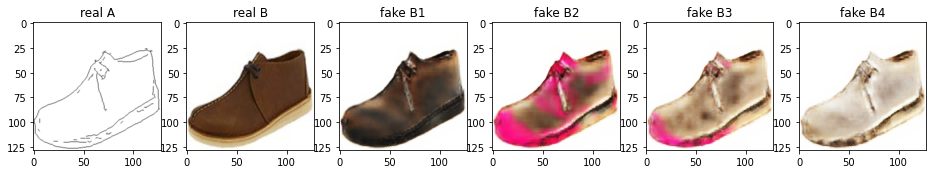

Train Epoch: 1 84% 	Total Loss: 5.912738 	Loss_GAN: 3.316005	Loss_GAN_VAE: 0.928635	Loss_GAN_LR: 0.850843	Loss_D_VAE: 1.212519	Loss_D_LR: 1.384213
0 42009 T:  10.326659440994263
Train Epoch: 1 84% 	Total Loss: 5.415194 	Loss_GAN: 3.026824	Loss_GAN_VAE: 0.953286	Loss_GAN_LR: 0.987270	Loss_D_VAE: 1.241538	Loss_D_LR: 1.146833
0 42019 T:  8.662592649459839
Train Epoch: 1 84% 	Total Loss: 5.827863 	Loss_GAN: 3.719456	Loss_GAN_VAE: 1.039396	Loss_GAN_LR: 1.019945	Loss_D_VAE: 1.012063	Loss_D_LR: 1.096344
0 42029 T:  8.203172206878662
Train Epoch: 1 84% 	Total Loss: 5.990853 	Loss_GAN: 3.213913	Loss_GAN_VAE: 0.893421	Loss_GAN_LR: 0.969650	Loss_D_VAE: 1.313977	Loss_D_LR: 1.462962
0 42039 T:  8.919538259506226
Train Epoch: 1 84% 	Total Loss: 5.605680 	Loss_GAN: 3.470616	Loss_GAN_VAE: 1.057608	Loss_GAN_LR: 1.131660	Loss_D_VAE: 1.139901	Loss_D_LR: 0.995163
0 42049 T:  8.501272678375244
Train Epoch: 1 84% 	Total Loss: 5.420635 	Loss_GAN: 3.113903	Loss_GAN_VAE: 0.861378	Loss_GAN_LR: 0.992100	Loss_D_V

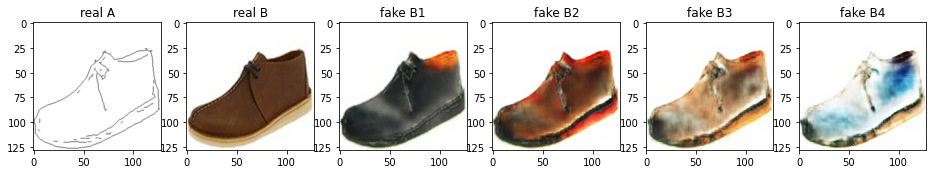

Train Epoch: 1 85% 	Total Loss: 6.050135 	Loss_GAN: 3.183045	Loss_GAN_VAE: 0.954842	Loss_GAN_LR: 0.857063	Loss_D_VAE: 1.405110	Loss_D_LR: 1.461981
0 42509 T:  9.80465579032898
Train Epoch: 1 85% 	Total Loss: 5.746876 	Loss_GAN: 3.544520	Loss_GAN_VAE: 0.983266	Loss_GAN_LR: 1.052132	Loss_D_VAE: 1.138825	Loss_D_LR: 1.063531
0 42519 T:  8.887165069580078
Train Epoch: 1 85% 	Total Loss: 6.034841 	Loss_GAN: 3.322485	Loss_GAN_VAE: 1.009793	Loss_GAN_LR: 0.992989	Loss_D_VAE: 1.223572	Loss_D_LR: 1.488785
0 42529 T:  8.83812141418457
Train Epoch: 1 85% 	Total Loss: 5.640548 	Loss_GAN: 2.990379	Loss_GAN_VAE: 0.875862	Loss_GAN_LR: 0.898773	Loss_D_VAE: 1.388822	Loss_D_LR: 1.261346
0 42539 T:  8.900384187698364
Train Epoch: 1 85% 	Total Loss: 5.674152 	Loss_GAN: 2.812316	Loss_GAN_VAE: 0.778042	Loss_GAN_LR: 0.755158	Loss_D_VAE: 1.405932	Loss_D_LR: 1.455904
0 42549 T:  8.92833685874939
Train Epoch: 1 85% 	Total Loss: 6.070524 	Loss_GAN: 3.856864	Loss_GAN_VAE: 1.057036	Loss_GAN_LR: 1.070882	Loss_D_VAE: 

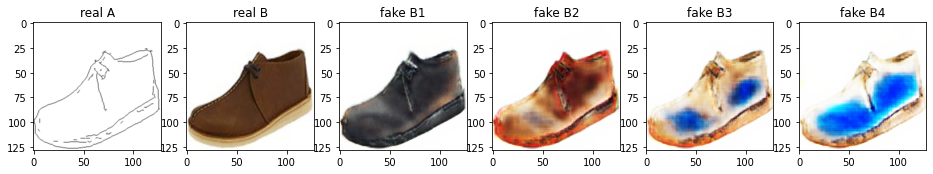

Train Epoch: 1 86% 	Total Loss: 5.899611 	Loss_GAN: 3.076274	Loss_GAN_VAE: 0.902134	Loss_GAN_LR: 0.874043	Loss_D_VAE: 1.381366	Loss_D_LR: 1.441971
0 43009 T:  9.836960077285767
Train Epoch: 1 86% 	Total Loss: 5.897231 	Loss_GAN: 3.212160	Loss_GAN_VAE: 0.878904	Loss_GAN_LR: 0.954427	Loss_D_VAE: 1.380355	Loss_D_LR: 1.304716
0 43019 T:  8.985221147537231
Train Epoch: 1 86% 	Total Loss: 5.603989 	Loss_GAN: 2.957120	Loss_GAN_VAE: 0.926966	Loss_GAN_LR: 0.764691	Loss_D_VAE: 1.337804	Loss_D_LR: 1.309065
0 43029 T:  8.567567586898804
Train Epoch: 1 86% 	Total Loss: 5.886382 	Loss_GAN: 3.463373	Loss_GAN_VAE: 0.905518	Loss_GAN_LR: 1.047061	Loss_D_VAE: 1.293899	Loss_D_LR: 1.129111
0 43039 T:  9.02957272529602
Train Epoch: 1 86% 	Total Loss: 6.272768 	Loss_GAN: 3.979401	Loss_GAN_VAE: 1.033035	Loss_GAN_LR: 0.906400	Loss_D_VAE: 1.047134	Loss_D_LR: 1.246233
0 43049 T:  9.070072650909424
Train Epoch: 1 86% 	Total Loss: 6.013442 	Loss_GAN: 3.677408	Loss_GAN_VAE: 0.840803	Loss_GAN_LR: 1.117832	Loss_D_VAE

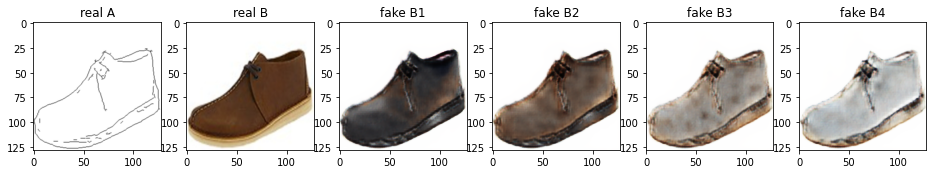

Train Epoch: 1 87% 	Total Loss: 5.679105 	Loss_GAN: 3.155698	Loss_GAN_VAE: 0.922364	Loss_GAN_LR: 0.918509	Loss_D_VAE: 1.224998	Loss_D_LR: 1.298409
0 43509 T:  11.183656930923462
Train Epoch: 1 87% 	Total Loss: 6.139712 	Loss_GAN: 3.621438	Loss_GAN_VAE: 0.886484	Loss_GAN_LR: 1.043234	Loss_D_VAE: 1.336829	Loss_D_LR: 1.181445
0 43519 T:  8.718163013458252
Train Epoch: 1 87% 	Total Loss: 5.693419 	Loss_GAN: 2.754401	Loss_GAN_VAE: 0.879823	Loss_GAN_LR: 0.824227	Loss_D_VAE: 1.384397	Loss_D_LR: 1.554621
0 43529 T:  9.353572607040405
Train Epoch: 1 87% 	Total Loss: 5.572405 	Loss_GAN: 3.271211	Loss_GAN_VAE: 0.893035	Loss_GAN_LR: 0.978424	Loss_D_VAE: 1.185403	Loss_D_LR: 1.115791
0 43539 T:  8.711503982543945
Train Epoch: 1 87% 	Total Loss: 5.586362 	Loss_GAN: 3.308373	Loss_GAN_VAE: 0.953785	Loss_GAN_LR: 0.939972	Loss_D_VAE: 1.144488	Loss_D_LR: 1.133501
0 43549 T:  8.908525705337524
Train Epoch: 1 87% 	Total Loss: 6.324550 	Loss_GAN: 3.830083	Loss_GAN_VAE: 1.048995	Loss_GAN_LR: 1.102682	Loss_D_V

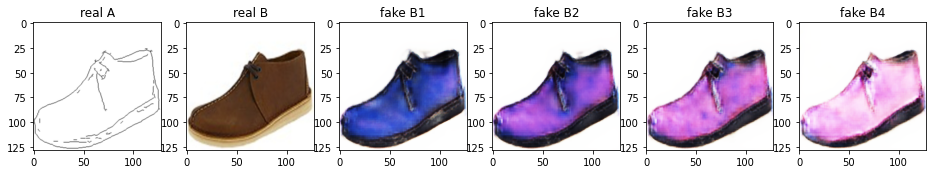

Train Epoch: 1 88% 	Total Loss: 6.655228 	Loss_GAN: 4.408557	Loss_GAN_VAE: 1.093694	Loss_GAN_LR: 1.689025	Loss_D_VAE: 1.124722	Loss_D_LR: 1.121949
0 44009 T:  10.100810289382935
Train Epoch: 1 88% 	Total Loss: 6.420035 	Loss_GAN: 3.433607	Loss_GAN_VAE: 0.862248	Loss_GAN_LR: 0.856035	Loss_D_VAE: 1.403563	Loss_D_LR: 1.582865
0 44019 T:  9.030618906021118
Train Epoch: 1 88% 	Total Loss: 6.073163 	Loss_GAN: 3.752567	Loss_GAN_VAE: 0.998703	Loss_GAN_LR: 1.236057	Loss_D_VAE: 1.202048	Loss_D_LR: 1.118547
0 44029 T:  8.80886435508728
Train Epoch: 1 88% 	Total Loss: 5.715664 	Loss_GAN: 3.789054	Loss_GAN_VAE: 1.151387	Loss_GAN_LR: 1.079108	Loss_D_VAE: 0.899908	Loss_D_LR: 1.026702
0 44039 T:  8.363255977630615
Train Epoch: 1 88% 	Total Loss: 5.992895 	Loss_GAN: 3.510805	Loss_GAN_VAE: 0.996643	Loss_GAN_LR: 1.122214	Loss_D_VAE: 1.204422	Loss_D_LR: 1.277668
0 44049 T:  8.791262865066528
Train Epoch: 1 88% 	Total Loss: 5.705955 	Loss_GAN: 3.208257	Loss_GAN_VAE: 0.896170	Loss_GAN_LR: 1.210339	Loss_D_VA

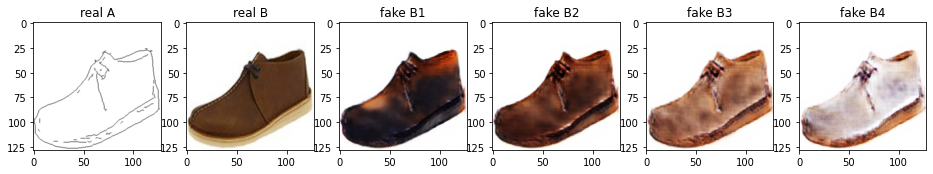

Train Epoch: 1 89% 	Total Loss: 5.666988 	Loss_GAN: 3.073343	Loss_GAN_VAE: 0.848100	Loss_GAN_LR: 0.813932	Loss_D_VAE: 1.298272	Loss_D_LR: 1.295373
0 44509 T:  9.3987717628479
Train Epoch: 1 89% 	Total Loss: 5.433431 	Loss_GAN: 2.758013	Loss_GAN_VAE: 0.817347	Loss_GAN_LR: 0.797161	Loss_D_VAE: 1.338304	Loss_D_LR: 1.337114
0 44519 T:  8.405837774276733
Train Epoch: 1 89% 	Total Loss: 5.736468 	Loss_GAN: 3.407952	Loss_GAN_VAE: 0.828436	Loss_GAN_LR: 0.928910	Loss_D_VAE: 1.224956	Loss_D_LR: 1.103560
0 44529 T:  8.556047201156616
Train Epoch: 1 89% 	Total Loss: 5.538728 	Loss_GAN: 3.399611	Loss_GAN_VAE: 1.060465	Loss_GAN_LR: 1.230904	Loss_D_VAE: 1.145863	Loss_D_LR: 0.993255
0 44539 T:  8.708870649337769
Train Epoch: 1 89% 	Total Loss: 5.592640 	Loss_GAN: 3.055528	Loss_GAN_VAE: 0.836899	Loss_GAN_LR: 1.056268	Loss_D_VAE: 1.383378	Loss_D_LR: 1.153734
0 44549 T:  8.972823143005371
Train Epoch: 1 89% 	Total Loss: 5.490750 	Loss_GAN: 3.038834	Loss_GAN_VAE: 0.832992	Loss_GAN_LR: 1.009311	Loss_D_VAE:

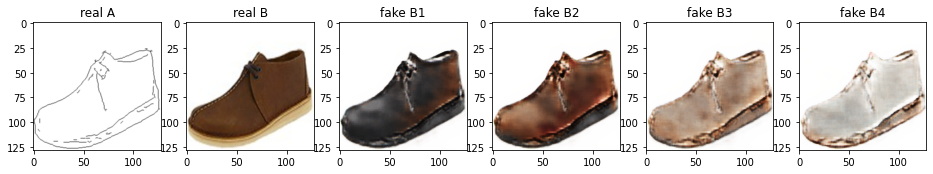

Train Epoch: 1 90% 	Total Loss: 5.872589 	Loss_GAN: 3.281005	Loss_GAN_VAE: 0.889497	Loss_GAN_LR: 0.911595	Loss_D_VAE: 1.375390	Loss_D_LR: 1.216193
0 45009 T:  10.289647579193115
Train Epoch: 1 90% 	Total Loss: 5.697999 	Loss_GAN: 3.228565	Loss_GAN_VAE: 0.829281	Loss_GAN_LR: 0.973456	Loss_D_VAE: 1.266635	Loss_D_LR: 1.202800
0 45019 T:  8.645931243896484
Train Epoch: 1 90% 	Total Loss: 5.736807 	Loss_GAN: 3.143842	Loss_GAN_VAE: 0.975641	Loss_GAN_LR: 0.884359	Loss_D_VAE: 1.345812	Loss_D_LR: 1.247153
0 45029 T:  8.983922719955444
Train Epoch: 1 90% 	Total Loss: 5.930318 	Loss_GAN: 3.378970	Loss_GAN_VAE: 0.881897	Loss_GAN_LR: 0.941595	Loss_D_VAE: 1.497389	Loss_D_LR: 1.053960
0 45039 T:  8.372005939483643
Train Epoch: 1 90% 	Total Loss: 5.650021 	Loss_GAN: 3.075684	Loss_GAN_VAE: 0.949522	Loss_GAN_LR: 1.044279	Loss_D_VAE: 1.300780	Loss_D_LR: 1.273557
0 45049 T:  9.017094612121582
Train Epoch: 1 90% 	Total Loss: 5.717621 	Loss_GAN: 3.556751	Loss_GAN_VAE: 0.876252	Loss_GAN_LR: 1.189953	Loss_D_V

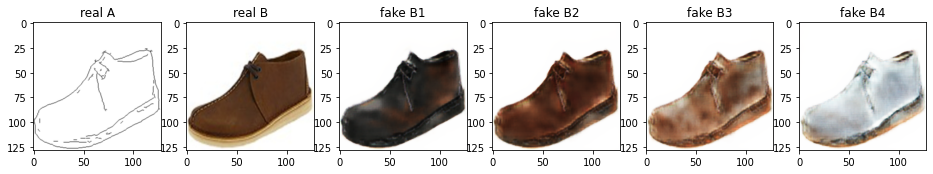

Train Epoch: 1 91% 	Total Loss: 5.346301 	Loss_GAN: 2.835306	Loss_GAN_VAE: 0.880240	Loss_GAN_LR: 0.811354	Loss_D_VAE: 1.148645	Loss_D_LR: 1.362350
0 45509 T:  9.072406768798828
Train Epoch: 1 91% 	Total Loss: 5.653402 	Loss_GAN: 2.947660	Loss_GAN_VAE: 0.935437	Loss_GAN_LR: 0.852597	Loss_D_VAE: 1.385744	Loss_D_LR: 1.319997
0 45519 T:  8.888497114181519
Train Epoch: 1 91% 	Total Loss: 6.451640 	Loss_GAN: 3.700292	Loss_GAN_VAE: 0.890499	Loss_GAN_LR: 0.925248	Loss_D_VAE: 1.353626	Loss_D_LR: 1.397721
0 45529 T:  10.809404134750366
Train Epoch: 1 91% 	Total Loss: 5.882514 	Loss_GAN: 3.420213	Loss_GAN_VAE: 0.855771	Loss_GAN_LR: 0.903764	Loss_D_VAE: 1.255062	Loss_D_LR: 1.207239
0 45539 T:  9.015689611434937
Train Epoch: 1 91% 	Total Loss: 5.984117 	Loss_GAN: 3.638265	Loss_GAN_VAE: 0.949216	Loss_GAN_LR: 0.867948	Loss_D_VAE: 1.144476	Loss_D_LR: 1.201376
0 45549 T:  8.813941955566406
Train Epoch: 1 91% 	Total Loss: 5.576313 	Loss_GAN: 3.142104	Loss_GAN_VAE: 0.902989	Loss_GAN_LR: 0.942332	Loss_D_V

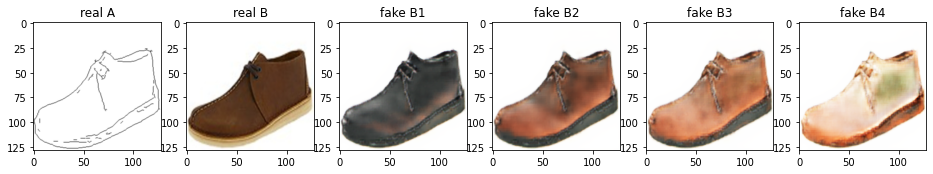

Train Epoch: 1 92% 	Total Loss: 5.183260 	Loss_GAN: 2.701986	Loss_GAN_VAE: 0.808407	Loss_GAN_LR: 0.909286	Loss_D_VAE: 1.209605	Loss_D_LR: 1.271669
0 46009 T:  9.603507995605469
Train Epoch: 1 92% 	Total Loss: 5.639319 	Loss_GAN: 3.362427	Loss_GAN_VAE: 1.014959	Loss_GAN_LR: 0.997406	Loss_D_VAE: 1.081908	Loss_D_LR: 1.194984
0 46019 T:  8.926395893096924
Train Epoch: 1 92% 	Total Loss: 5.463814 	Loss_GAN: 3.017977	Loss_GAN_VAE: 0.881919	Loss_GAN_LR: 0.859224	Loss_D_VAE: 1.173872	Loss_D_LR: 1.271965
0 46029 T:  8.581159114837646
Train Epoch: 1 92% 	Total Loss: 6.252200 	Loss_GAN: 3.569680	Loss_GAN_VAE: 1.025142	Loss_GAN_LR: 0.913768	Loss_D_VAE: 1.265900	Loss_D_LR: 1.416620
0 46039 T:  9.093021154403687
Train Epoch: 1 92% 	Total Loss: 5.813790 	Loss_GAN: 3.629931	Loss_GAN_VAE: 0.866135	Loss_GAN_LR: 1.068173	Loss_D_VAE: 1.226685	Loss_D_LR: 0.957174
0 46049 T:  8.651911735534668
Train Epoch: 1 92% 	Total Loss: 5.335317 	Loss_GAN: 3.091052	Loss_GAN_VAE: 0.874312	Loss_GAN_LR: 1.121548	Loss_D_VA

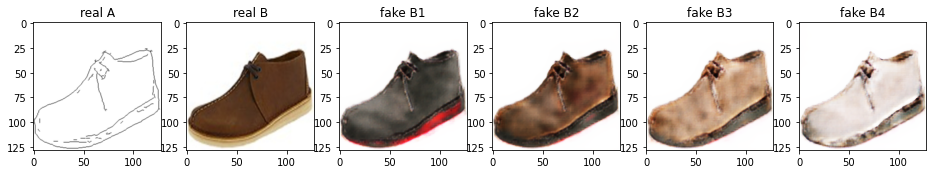

Train Epoch: 1 93% 	Total Loss: 5.788806 	Loss_GAN: 4.028028	Loss_GAN_VAE: 1.293332	Loss_GAN_LR: 1.097361	Loss_D_VAE: 0.864929	Loss_D_LR: 0.895849
0 46509 T:  9.876734256744385
Train Epoch: 1 93% 	Total Loss: 6.328441 	Loss_GAN: 3.260055	Loss_GAN_VAE: 0.886318	Loss_GAN_LR: 0.896614	Loss_D_VAE: 1.393830	Loss_D_LR: 1.674556
0 46519 T:  8.89064645767212
Train Epoch: 1 93% 	Total Loss: 6.273004 	Loss_GAN: 3.675615	Loss_GAN_VAE: 1.003953	Loss_GAN_LR: 0.936642	Loss_D_VAE: 1.330925	Loss_D_LR: 1.266463
0 46529 T:  8.440258026123047
Train Epoch: 1 93% 	Total Loss: 5.981991 	Loss_GAN: 3.454814	Loss_GAN_VAE: 0.889562	Loss_GAN_LR: 1.005072	Loss_D_VAE: 1.312122	Loss_D_LR: 1.215055
0 46539 T:  8.919419050216675
Train Epoch: 1 93% 	Total Loss: 6.032764 	Loss_GAN: 3.571032	Loss_GAN_VAE: 1.046998	Loss_GAN_LR: 0.940134	Loss_D_VAE: 1.166381	Loss_D_LR: 1.295352
0 46549 T:  8.289482116699219
Train Epoch: 1 93% 	Total Loss: 5.847272 	Loss_GAN: 3.189074	Loss_GAN_VAE: 0.810849	Loss_GAN_LR: 0.848334	Loss_D_VAE

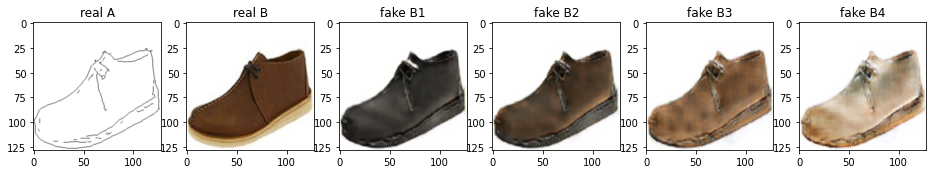

Train Epoch: 1 94% 	Total Loss: 5.599034 	Loss_GAN: 3.349625	Loss_GAN_VAE: 0.991472	Loss_GAN_LR: 1.004620	Loss_D_VAE: 1.144679	Loss_D_LR: 1.104730
0 47009 T:  10.59461236000061
Train Epoch: 1 94% 	Total Loss: 5.274226 	Loss_GAN: 2.830653	Loss_GAN_VAE: 0.916915	Loss_GAN_LR: 0.849269	Loss_D_VAE: 1.239426	Loss_D_LR: 1.204148
0 47019 T:  8.594634771347046
Train Epoch: 1 94% 	Total Loss: 5.796803 	Loss_GAN: 3.268264	Loss_GAN_VAE: 1.026288	Loss_GAN_LR: 0.911936	Loss_D_VAE: 1.186116	Loss_D_LR: 1.342423
0 47029 T:  8.824869155883789
Train Epoch: 1 94% 	Total Loss: 5.491738 	Loss_GAN: 2.973096	Loss_GAN_VAE: 0.966119	Loss_GAN_LR: 0.898549	Loss_D_VAE: 1.321409	Loss_D_LR: 1.197234
0 47039 T:  9.134397983551025
Train Epoch: 1 94% 	Total Loss: 5.842172 	Loss_GAN: 3.320352	Loss_GAN_VAE: 0.941402	Loss_GAN_LR: 0.991899	Loss_D_VAE: 1.309042	Loss_D_LR: 1.212778
0 47049 T:  9.196496486663818
Train Epoch: 1 94% 	Total Loss: 5.791991 	Loss_GAN: 3.180238	Loss_GAN_VAE: 0.780986	Loss_GAN_LR: 0.953486	Loss_D_VA

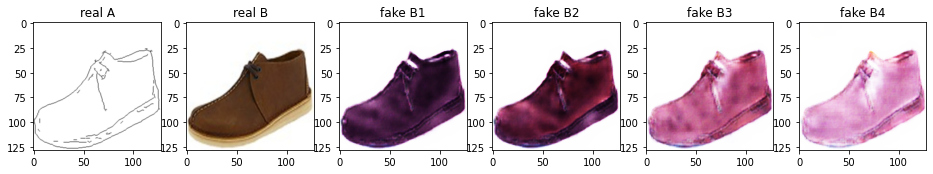

Train Epoch: 1 95% 	Total Loss: 5.718984 	Loss_GAN: 4.312790	Loss_GAN_VAE: 1.222168	Loss_GAN_LR: 1.659483	Loss_D_VAE: 0.837836	Loss_D_LR: 0.568358
0 47509 T:  8.8373441696167
Train Epoch: 1 95% 	Total Loss: 6.336731 	Loss_GAN: 3.569795	Loss_GAN_VAE: 1.044469	Loss_GAN_LR: 0.973415	Loss_D_VAE: 1.326285	Loss_D_LR: 1.440651
0 47519 T:  8.192814111709595
Train Epoch: 1 95% 	Total Loss: 5.714433 	Loss_GAN: 3.116807	Loss_GAN_VAE: 0.884890	Loss_GAN_LR: 0.965144	Loss_D_VAE: 1.302593	Loss_D_LR: 1.295033
0 47529 T:  8.910648345947266
Train Epoch: 1 95% 	Total Loss: 5.912318 	Loss_GAN: 2.931204	Loss_GAN_VAE: 0.785672	Loss_GAN_LR: 0.793201	Loss_D_VAE: 1.548247	Loss_D_LR: 1.432866
0 47539 T:  9.074612379074097
Train Epoch: 1 95% 	Total Loss: 5.388856 	Loss_GAN: 2.608656	Loss_GAN_VAE: 0.802599	Loss_GAN_LR: 0.814019	Loss_D_VAE: 1.373897	Loss_D_LR: 1.406303
0 47549 T:  8.93934440612793
Train Epoch: 1 95% 	Total Loss: 5.830499 	Loss_GAN: 3.363473	Loss_GAN_VAE: 0.929599	Loss_GAN_LR: 0.988826	Loss_D_VAE: 

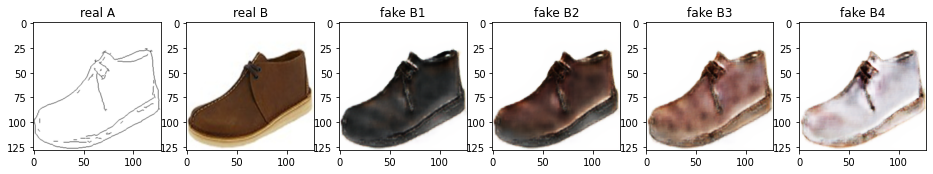

Train Epoch: 1 96% 	Total Loss: 5.805176 	Loss_GAN: 3.325903	Loss_GAN_VAE: 0.848834	Loss_GAN_LR: 0.881138	Loss_D_VAE: 1.249284	Loss_D_LR: 1.229988
0 48009 T:  10.78301739692688
Train Epoch: 1 96% 	Total Loss: 5.526640 	Loss_GAN: 3.087082	Loss_GAN_VAE: 0.985040	Loss_GAN_LR: 0.957391	Loss_D_VAE: 1.136236	Loss_D_LR: 1.303322
0 48019 T:  9.077591180801392
Train Epoch: 1 96% 	Total Loss: 6.099270 	Loss_GAN: 3.935431	Loss_GAN_VAE: 1.037158	Loss_GAN_LR: 1.114217	Loss_D_VAE: 1.077332	Loss_D_LR: 1.086506
0 48029 T:  10.423932075500488
Train Epoch: 1 96% 	Total Loss: 5.666321 	Loss_GAN: 2.931431	Loss_GAN_VAE: 0.895344	Loss_GAN_LR: 0.935872	Loss_D_VAE: 1.436394	Loss_D_LR: 1.298497
0 48039 T:  8.79514765739441
Train Epoch: 1 96% 	Total Loss: 5.867355 	Loss_GAN: 3.440220	Loss_GAN_VAE: 0.892524	Loss_GAN_LR: 1.000043	Loss_D_VAE: 1.230213	Loss_D_LR: 1.196922
0 48049 T:  9.073472023010254
Train Epoch: 1 96% 	Total Loss: 5.962065 	Loss_GAN: 3.683815	Loss_GAN_VAE: 0.937304	Loss_GAN_LR: 1.098935	Loss_D_VA

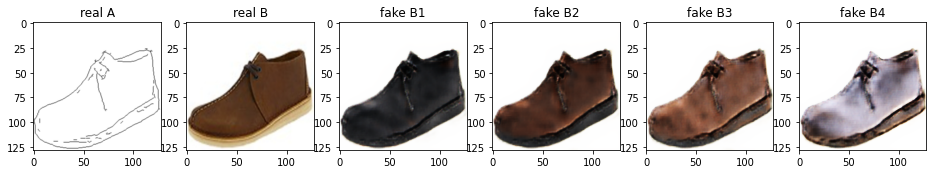

Train Epoch: 1 97% 	Total Loss: 5.729434 	Loss_GAN: 3.593847	Loss_GAN_VAE: 1.068936	Loss_GAN_LR: 1.103279	Loss_D_VAE: 1.076554	Loss_D_LR: 1.059032
0 48509 T:  9.834531784057617
Train Epoch: 1 97% 	Total Loss: 5.805483 	Loss_GAN: 3.134881	Loss_GAN_VAE: 0.827857	Loss_GAN_LR: 0.793841	Loss_D_VAE: 1.279172	Loss_D_LR: 1.391430
0 48519 T:  9.217419385910034
Train Epoch: 1 97% 	Total Loss: 5.387404 	Loss_GAN: 2.872541	Loss_GAN_VAE: 0.868580	Loss_GAN_LR: 0.845664	Loss_D_VAE: 1.282286	Loss_D_LR: 1.232577
0 48529 T:  9.166032075881958
Train Epoch: 1 97% 	Total Loss: 5.658697 	Loss_GAN: 3.163157	Loss_GAN_VAE: 0.956593	Loss_GAN_LR: 0.948202	Loss_D_VAE: 1.270714	Loss_D_LR: 1.224826
0 48539 T:  8.973938703536987
Train Epoch: 1 97% 	Total Loss: 5.499676 	Loss_GAN: 3.033923	Loss_GAN_VAE: 0.907972	Loss_GAN_LR: 0.903455	Loss_D_VAE: 1.210695	Loss_D_LR: 1.255058
0 48549 T:  10.043104410171509
Train Epoch: 1 97% 	Total Loss: 5.365648 	Loss_GAN: 2.810135	Loss_GAN_VAE: 0.803293	Loss_GAN_LR: 0.839313	Loss_D_V

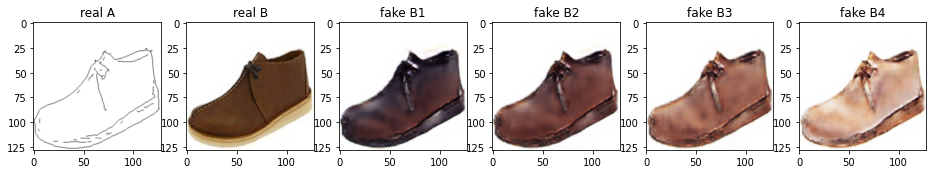

Train Epoch: 1 98% 	Total Loss: 5.360404 	Loss_GAN: 3.023286	Loss_GAN_VAE: 0.920697	Loss_GAN_LR: 1.064057	Loss_D_VAE: 1.379993	Loss_D_LR: 0.957125
0 49009 T:  10.72728681564331
Train Epoch: 1 98% 	Total Loss: 6.069853 	Loss_GAN: 3.504192	Loss_GAN_VAE: 0.933811	Loss_GAN_LR: 1.080396	Loss_D_VAE: 1.220248	Loss_D_LR: 1.345413
0 49019 T:  9.067826747894287
Train Epoch: 1 98% 	Total Loss: 5.769683 	Loss_GAN: 3.352679	Loss_GAN_VAE: 0.986008	Loss_GAN_LR: 0.806158	Loss_D_VAE: 1.283701	Loss_D_LR: 1.133303
0 49029 T:  9.147727727890015
Train Epoch: 1 98% 	Total Loss: 5.590551 	Loss_GAN: 2.912889	Loss_GAN_VAE: 0.753995	Loss_GAN_LR: 0.887886	Loss_D_VAE: 1.413207	Loss_D_LR: 1.264456
0 49039 T:  9.014915227890015
Train Epoch: 1 98% 	Total Loss: 5.849039 	Loss_GAN: 3.748178	Loss_GAN_VAE: 1.154246	Loss_GAN_LR: 1.205056	Loss_D_VAE: 1.034165	Loss_D_LR: 1.066696
0 49049 T:  9.05488657951355
Train Epoch: 1 98% 	Total Loss: 5.836418 	Loss_GAN: 3.133026	Loss_GAN_VAE: 0.769921	Loss_GAN_LR: 0.968852	Loss_D_VAE

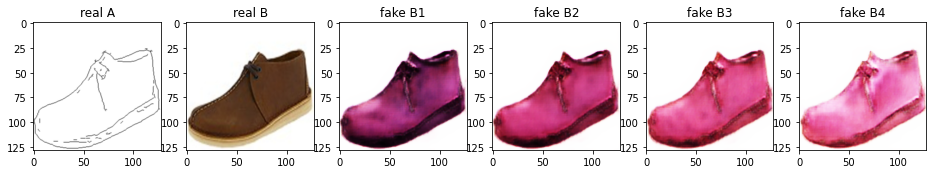

Train Epoch: 1 99% 	Total Loss: 6.435369 	Loss_GAN: 4.412404	Loss_GAN_VAE: 1.104789	Loss_GAN_LR: 1.779994	Loss_D_VAE: 1.296675	Loss_D_LR: 0.726290
0 49509 T:  9.781395196914673
Train Epoch: 1 99% 	Total Loss: 6.822459 	Loss_GAN: 4.642497	Loss_GAN_VAE: 1.206549	Loss_GAN_LR: 1.461996	Loss_D_VAE: 0.936751	Loss_D_LR: 1.243211
0 49519 T:  9.282840251922607
Train Epoch: 1 99% 	Total Loss: 5.991036 	Loss_GAN: 3.777192	Loss_GAN_VAE: 1.104587	Loss_GAN_LR: 1.018723	Loss_D_VAE: 1.001243	Loss_D_LR: 1.212600
0 49529 T:  9.074934959411621
Train Epoch: 1 99% 	Total Loss: 6.923732 	Loss_GAN: 3.978978	Loss_GAN_VAE: 1.068519	Loss_GAN_LR: 1.080680	Loss_D_VAE: 1.555293	Loss_D_LR: 1.389461
0 49539 T:  9.137640237808228
Train Epoch: 1 99% 	Total Loss: 5.963820 	Loss_GAN: 3.268681	Loss_GAN_VAE: 0.904728	Loss_GAN_LR: 0.850709	Loss_D_VAE: 1.371220	Loss_D_LR: 1.323919
0 49549 T:  9.073676586151123
Train Epoch: 1 99% 	Total Loss: 5.897797 	Loss_GAN: 3.651913	Loss_GAN_VAE: 0.953694	Loss_GAN_LR: 1.070023	Loss_D_VA

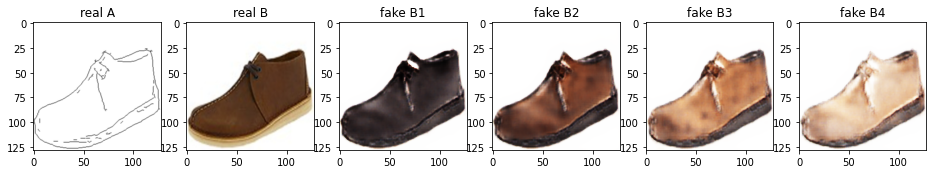

Train Epoch: 2 0% 	Total Loss: 5.748927 	Loss_GAN: 3.060354	Loss_GAN_VAE: 0.887244	Loss_GAN_LR: 1.012444	Loss_D_VAE: 1.275567	Loss_D_LR: 1.413006
1 50009 T:  3.916464328765869
Train Epoch: 2 0% 	Total Loss: 5.627519 	Loss_GAN: 3.228355	Loss_GAN_VAE: 0.862516	Loss_GAN_LR: 0.923161	Loss_D_VAE: 1.181920	Loss_D_LR: 1.217244
1 50019 T:  2.5923449993133545
Train Epoch: 2 0% 	Total Loss: 5.483253 	Loss_GAN: 2.847702	Loss_GAN_VAE: 0.752538	Loss_GAN_LR: 0.858027	Loss_D_VAE: 1.311120	Loss_D_LR: 1.324431
1 50029 T:  2.5964112281799316
Train Epoch: 2 0% 	Total Loss: 5.462139 	Loss_GAN: 2.955483	Loss_GAN_VAE: 0.973777	Loss_GAN_LR: 1.015536	Loss_D_VAE: 1.291266	Loss_D_LR: 1.215391
1 50039 T:  2.8750360012054443
Train Epoch: 2 0% 	Total Loss: 5.375175 	Loss_GAN: 2.825132	Loss_GAN_VAE: 0.858556	Loss_GAN_LR: 0.903319	Loss_D_VAE: 1.311062	Loss_D_LR: 1.238981
1 50049 T:  2.568586826324463
Train Epoch: 2 0% 	Total Loss: 5.266423 	Loss_GAN: 2.570679	Loss_GAN_VAE: 0.849653	Loss_GAN_LR: 0.879852	Loss_D_VAE: 

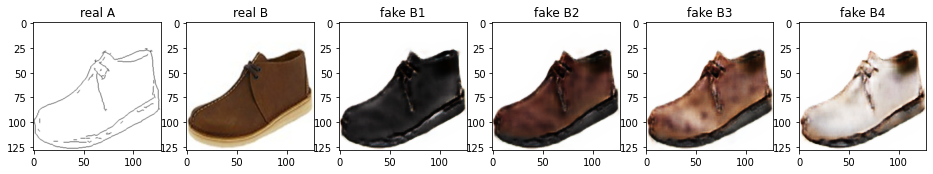

Train Epoch: 2 1% 	Total Loss: 5.743848 	Loss_GAN: 2.801346	Loss_GAN_VAE: 0.902044	Loss_GAN_LR: 0.709890	Loss_D_VAE: 1.338121	Loss_D_LR: 1.604380
1 50509 T:  3.3202385902404785
Train Epoch: 2 1% 	Total Loss: 6.153066 	Loss_GAN: 3.499626	Loss_GAN_VAE: 0.873906	Loss_GAN_LR: 1.010053	Loss_D_VAE: 1.368744	Loss_D_LR: 1.284697
1 50519 T:  2.5233218669891357
Train Epoch: 2 1% 	Total Loss: 5.387469 	Loss_GAN: 3.139313	Loss_GAN_VAE: 0.849445	Loss_GAN_LR: 0.972347	Loss_D_VAE: 1.186794	Loss_D_LR: 1.061361
1 50529 T:  2.5402233600616455
Train Epoch: 2 1% 	Total Loss: 6.209122 	Loss_GAN: 3.909882	Loss_GAN_VAE: 1.094901	Loss_GAN_LR: 1.076291	Loss_D_VAE: 1.115010	Loss_D_LR: 1.184230
1 50539 T:  2.56575345993042
Train Epoch: 2 1% 	Total Loss: 5.838870 	Loss_GAN: 3.277959	Loss_GAN_VAE: 0.779671	Loss_GAN_LR: 0.991465	Loss_D_VAE: 1.391700	Loss_D_LR: 1.169211
1 50549 T:  2.5871024131774902
Train Epoch: 2 1% 	Total Loss: 5.508548 	Loss_GAN: 2.803118	Loss_GAN_VAE: 0.848852	Loss_GAN_LR: 0.872891	Loss_D_VAE: 

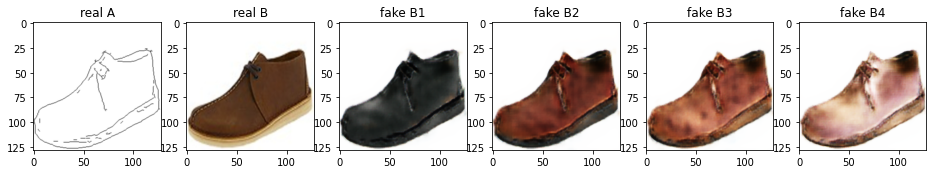

Train Epoch: 2 2% 	Total Loss: 5.539340 	Loss_GAN: 3.241340	Loss_GAN_VAE: 0.895934	Loss_GAN_LR: 0.978801	Loss_D_VAE: 1.224013	Loss_D_LR: 1.073987
1 51009 T:  3.929725170135498
Train Epoch: 2 2% 	Total Loss: 5.767742 	Loss_GAN: 3.004614	Loss_GAN_VAE: 0.816818	Loss_GAN_LR: 0.887277	Loss_D_VAE: 1.395917	Loss_D_LR: 1.367212
1 51019 T:  2.5568032264709473
Train Epoch: 2 2% 	Total Loss: 5.582803 	Loss_GAN: 3.094583	Loss_GAN_VAE: 0.798857	Loss_GAN_LR: 0.981640	Loss_D_VAE: 1.330785	Loss_D_LR: 1.157435
1 51029 T:  2.4806902408599854
Train Epoch: 2 2% 	Total Loss: 5.690364 	Loss_GAN: 3.301945	Loss_GAN_VAE: 0.929374	Loss_GAN_LR: 1.002844	Loss_D_VAE: 1.296931	Loss_D_LR: 1.091487
1 51039 T:  2.872340440750122
Train Epoch: 2 2% 	Total Loss: 5.796020 	Loss_GAN: 3.318942	Loss_GAN_VAE: 0.896357	Loss_GAN_LR: 0.967926	Loss_D_VAE: 1.263604	Loss_D_LR: 1.213475
1 51049 T:  2.582627773284912
Train Epoch: 2 2% 	Total Loss: 6.224100 	Loss_GAN: 3.497038	Loss_GAN_VAE: 0.989920	Loss_GAN_LR: 0.795644	Loss_D_VAE: 1

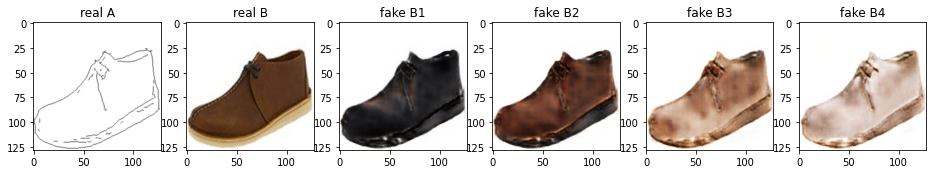

Train Epoch: 2 3% 	Total Loss: 5.829251 	Loss_GAN: 3.245493	Loss_GAN_VAE: 0.964045	Loss_GAN_LR: 0.831829	Loss_D_VAE: 1.150086	Loss_D_LR: 1.433672
1 51509 T:  3.3779382705688477
Train Epoch: 2 3% 	Total Loss: 5.812489 	Loss_GAN: 3.103538	Loss_GAN_VAE: 0.988896	Loss_GAN_LR: 0.794858	Loss_D_VAE: 1.228431	Loss_D_LR: 1.480520
1 51519 T:  2.5460755825042725
Train Epoch: 2 3% 	Total Loss: 5.591844 	Loss_GAN: 3.162006	Loss_GAN_VAE: 0.843641	Loss_GAN_LR: 0.939590	Loss_D_VAE: 1.285468	Loss_D_LR: 1.144370
1 51529 T:  2.489781141281128
Train Epoch: 2 3% 	Total Loss: 5.863124 	Loss_GAN: 3.141296	Loss_GAN_VAE: 0.876602	Loss_GAN_LR: 0.956076	Loss_D_VAE: 1.400203	Loss_D_LR: 1.321624
1 51539 T:  2.577416181564331
Train Epoch: 2 3% 	Total Loss: 5.741044 	Loss_GAN: 3.695305	Loss_GAN_VAE: 1.094495	Loss_GAN_LR: 1.114424	Loss_D_VAE: 1.024223	Loss_D_LR: 1.021517
1 51549 T:  2.531118631362915
Train Epoch: 2 3% 	Total Loss: 5.431100 	Loss_GAN: 2.939009	Loss_GAN_VAE: 0.846629	Loss_GAN_LR: 0.811991	Loss_D_VAE: 1

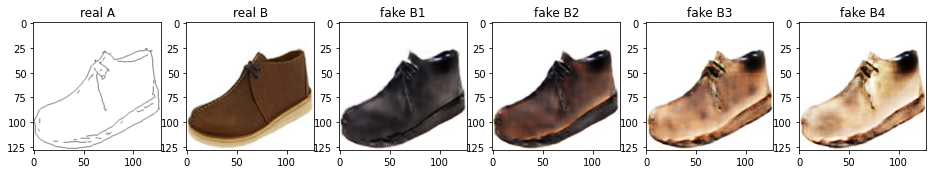

Train Epoch: 2 4% 	Total Loss: 5.595770 	Loss_GAN: 2.807309	Loss_GAN_VAE: 0.849419	Loss_GAN_LR: 0.947128	Loss_D_VAE: 1.402015	Loss_D_LR: 1.386446
1 52009 T:  3.9311139583587646
Train Epoch: 2 4% 	Total Loss: 5.602805 	Loss_GAN: 3.326874	Loss_GAN_VAE: 1.047071	Loss_GAN_LR: 0.858223	Loss_D_VAE: 1.080094	Loss_D_LR: 1.195838
1 52019 T:  2.53039288520813
Train Epoch: 2 4% 	Total Loss: 5.226462 	Loss_GAN: 2.859806	Loss_GAN_VAE: 0.859613	Loss_GAN_LR: 0.925275	Loss_D_VAE: 1.190027	Loss_D_LR: 1.176629
1 52029 T:  2.563478469848633
Train Epoch: 2 4% 	Total Loss: 5.846535 	Loss_GAN: 3.160415	Loss_GAN_VAE: 0.993896	Loss_GAN_LR: 0.923322	Loss_D_VAE: 1.333053	Loss_D_LR: 1.353067
1 52039 T:  2.7796645164489746
Train Epoch: 2 4% 	Total Loss: 6.100719 	Loss_GAN: 3.825225	Loss_GAN_VAE: 1.011902	Loss_GAN_LR: 1.105941	Loss_D_VAE: 1.188288	Loss_D_LR: 1.087206
1 52049 T:  2.5190787315368652
Train Epoch: 2 4% 	Total Loss: 5.848335 	Loss_GAN: 3.418364	Loss_GAN_VAE: 0.868409	Loss_GAN_LR: 0.898283	Loss_D_VAE: 1

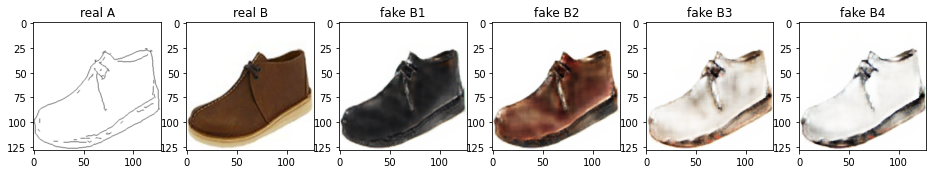

Train Epoch: 2 5% 	Total Loss: 5.460050 	Loss_GAN: 2.871835	Loss_GAN_VAE: 0.863678	Loss_GAN_LR: 0.796294	Loss_D_VAE: 1.244193	Loss_D_LR: 1.344021
1 52509 T:  3.296923875808716
Train Epoch: 2 5% 	Total Loss: 5.493125 	Loss_GAN: 2.936466	Loss_GAN_VAE: 0.890545	Loss_GAN_LR: 0.956354	Loss_D_VAE: 1.329367	Loss_D_LR: 1.227293
1 52519 T:  2.5099971294403076
Train Epoch: 2 5% 	Total Loss: 5.445619 	Loss_GAN: 3.013734	Loss_GAN_VAE: 0.886719	Loss_GAN_LR: 0.954374	Loss_D_VAE: 1.272540	Loss_D_LR: 1.159346
1 52529 T:  2.5439915657043457
Train Epoch: 2 5% 	Total Loss: 5.402937 	Loss_GAN: 3.052178	Loss_GAN_VAE: 0.914456	Loss_GAN_LR: 0.954033	Loss_D_VAE: 1.177940	Loss_D_LR: 1.172818
1 52539 T:  2.5163533687591553
Train Epoch: 2 5% 	Total Loss: 5.601093 	Loss_GAN: 3.073952	Loss_GAN_VAE: 0.825117	Loss_GAN_LR: 0.907410	Loss_D_VAE: 1.303032	Loss_D_LR: 1.224109
1 52549 T:  2.5482287406921387
Train Epoch: 2 5% 	Total Loss: 5.948595 	Loss_GAN: 3.189003	Loss_GAN_VAE: 0.788484	Loss_GAN_LR: 0.838840	Loss_D_VAE:

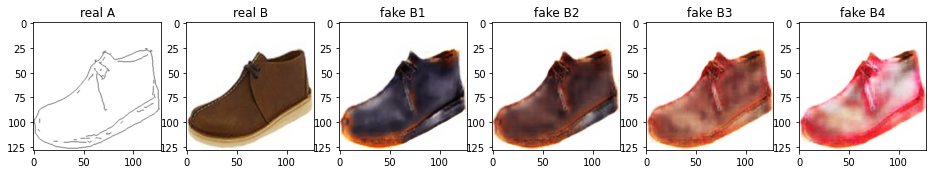

Train Epoch: 2 6% 	Total Loss: 5.553335 	Loss_GAN: 3.287309	Loss_GAN_VAE: 0.963412	Loss_GAN_LR: 1.121512	Loss_D_VAE: 1.242125	Loss_D_LR: 1.023902
1 53009 T:  4.088636636734009
Train Epoch: 2 6% 	Total Loss: 6.034962 	Loss_GAN: 4.005146	Loss_GAN_VAE: 1.023444	Loss_GAN_LR: 1.258552	Loss_D_VAE: 1.145221	Loss_D_LR: 0.884596
1 53019 T:  2.5225589275360107
Train Epoch: 2 6% 	Total Loss: 5.923115 	Loss_GAN: 3.614645	Loss_GAN_VAE: 1.019295	Loss_GAN_LR: 1.153525	Loss_D_VAE: 1.260044	Loss_D_LR: 1.048426
1 53029 T:  2.5510215759277344
Train Epoch: 2 6% 	Total Loss: 6.100786 	Loss_GAN: 3.359969	Loss_GAN_VAE: 0.941030	Loss_GAN_LR: 1.142721	Loss_D_VAE: 1.412358	Loss_D_LR: 1.328459
1 53039 T:  2.8637137413024902
Train Epoch: 2 6% 	Total Loss: 5.645278 	Loss_GAN: 3.043987	Loss_GAN_VAE: 0.846152	Loss_GAN_LR: 0.872153	Loss_D_VAE: 1.476836	Loss_D_LR: 1.124455
1 53049 T:  2.462440252304077
Train Epoch: 2 6% 	Total Loss: 6.106765 	Loss_GAN: 3.550286	Loss_GAN_VAE: 0.929130	Loss_GAN_LR: 1.042717	Loss_D_VAE: 

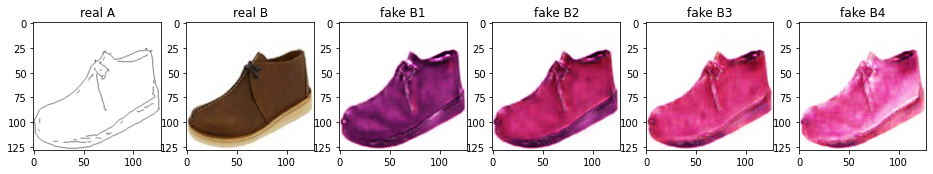

Train Epoch: 2 7% 	Total Loss: 6.842031 	Loss_GAN: 5.534191	Loss_GAN_VAE: 1.499344	Loss_GAN_LR: 2.196987	Loss_D_VAE: 0.858305	Loss_D_LR: 0.449535
1 53509 T:  3.28909969329834
Train Epoch: 2 7% 	Total Loss: 6.191801 	Loss_GAN: 4.858126	Loss_GAN_VAE: 1.342904	Loss_GAN_LR: 1.625020	Loss_D_VAE: 0.723552	Loss_D_LR: 0.610123
1 53519 T:  2.4853978157043457
Train Epoch: 2 7% 	Total Loss: 6.328499 	Loss_GAN: 3.589713	Loss_GAN_VAE: 0.973580	Loss_GAN_LR: 1.122727	Loss_D_VAE: 1.404491	Loss_D_LR: 1.334296
1 53529 T:  2.5045268535614014
Train Epoch: 2 7% 	Total Loss: 5.836741 	Loss_GAN: 3.695506	Loss_GAN_VAE: 1.032057	Loss_GAN_LR: 1.181552	Loss_D_VAE: 1.133309	Loss_D_LR: 1.007926
1 53539 T:  2.5249075889587402
Train Epoch: 2 7% 	Total Loss: 5.922824 	Loss_GAN: 3.458671	Loss_GAN_VAE: 0.888818	Loss_GAN_LR: 1.107758	Loss_D_VAE: 1.370293	Loss_D_LR: 1.093860
1 53549 T:  2.7375664710998535
Train Epoch: 2 7% 	Total Loss: 6.149212 	Loss_GAN: 4.359391	Loss_GAN_VAE: 1.141843	Loss_GAN_LR: 1.534842	Loss_D_VAE: 

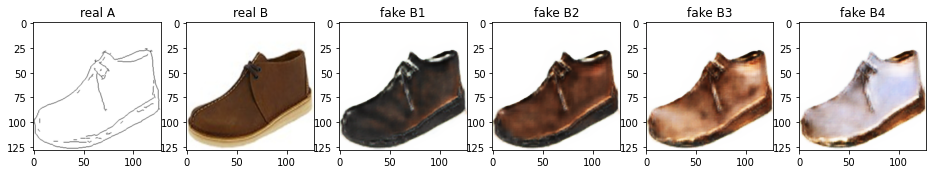

Train Epoch: 2 8% 	Total Loss: 6.179523 	Loss_GAN: 3.556170	Loss_GAN_VAE: 0.957693	Loss_GAN_LR: 1.038014	Loss_D_VAE: 1.369508	Loss_D_LR: 1.253845
1 54009 T:  3.940373420715332
Train Epoch: 2 8% 	Total Loss: 5.228167 	Loss_GAN: 2.724706	Loss_GAN_VAE: 0.774109	Loss_GAN_LR: 0.843181	Loss_D_VAE: 1.329118	Loss_D_LR: 1.174342
1 54019 T:  2.5097403526306152
Train Epoch: 2 8% 	Total Loss: 6.104142 	Loss_GAN: 3.653844	Loss_GAN_VAE: 1.095547	Loss_GAN_LR: 1.238232	Loss_D_VAE: 1.275516	Loss_D_LR: 1.174782
1 54029 T:  2.5352675914764404
Train Epoch: 2 8% 	Total Loss: 5.684176 	Loss_GAN: 3.071426	Loss_GAN_VAE: 0.958763	Loss_GAN_LR: 0.874180	Loss_D_VAE: 1.212034	Loss_D_LR: 1.400717
1 54039 T:  2.882052183151245
Train Epoch: 2 8% 	Total Loss: 6.049622 	Loss_GAN: 3.325511	Loss_GAN_VAE: 0.836832	Loss_GAN_LR: 1.027793	Loss_D_VAE: 1.533085	Loss_D_LR: 1.191026
1 54049 T:  2.5592164993286133
Train Epoch: 2 8% 	Total Loss: 5.337783 	Loss_GAN: 3.117634	Loss_GAN_VAE: 0.867370	Loss_GAN_LR: 1.212639	Loss_D_VAE: 

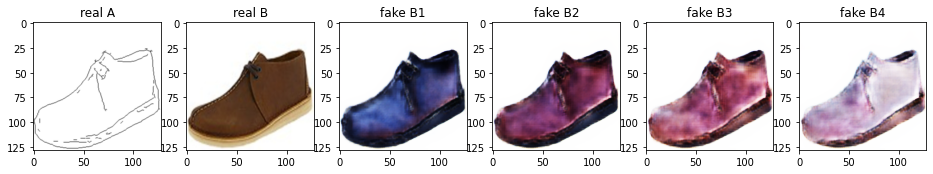

Train Epoch: 2 9% 	Total Loss: 5.395285 	Loss_GAN: 3.746450	Loss_GAN_VAE: 0.996562	Loss_GAN_LR: 1.185317	Loss_D_VAE: 0.875011	Loss_D_LR: 0.773824
1 54509 T:  3.180220365524292
Train Epoch: 2 9% 	Total Loss: 6.034447 	Loss_GAN: 3.534670	Loss_GAN_VAE: 1.004606	Loss_GAN_LR: 1.053846	Loss_D_VAE: 1.211034	Loss_D_LR: 1.288743
1 54519 T:  2.560177803039551
Train Epoch: 2 9% 	Total Loss: 5.671707 	Loss_GAN: 3.253583	Loss_GAN_VAE: 1.046407	Loss_GAN_LR: 0.976538	Loss_D_VAE: 1.314855	Loss_D_LR: 1.103268
1 54529 T:  2.509896993637085
Train Epoch: 2 9% 	Total Loss: 5.557471 	Loss_GAN: 3.173254	Loss_GAN_VAE: 0.860520	Loss_GAN_LR: 0.981171	Loss_D_VAE: 1.166782	Loss_D_LR: 1.217436
1 54539 T:  2.528531074523926
Train Epoch: 2 9% 	Total Loss: 5.557327 	Loss_GAN: 3.214941	Loss_GAN_VAE: 1.058555	Loss_GAN_LR: 0.900280	Loss_D_VAE: 1.211598	Loss_D_LR: 1.130787
1 54549 T:  2.527881383895874
Train Epoch: 2 10% 	Total Loss: 6.176274 	Loss_GAN: 3.395422	Loss_GAN_VAE: 0.877435	Loss_GAN_LR: 1.218508	Loss_D_VAE: 1.

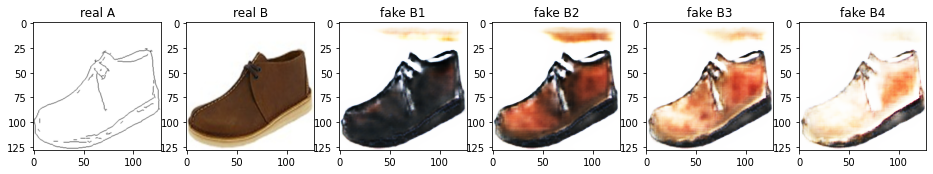

Train Epoch: 2 10% 	Total Loss: 6.463387 	Loss_GAN: 3.569255	Loss_GAN_VAE: 0.761498	Loss_GAN_LR: 0.990112	Loss_D_VAE: 1.596119	Loss_D_LR: 1.298014
1 55009 T:  3.9256529808044434
Train Epoch: 2 10% 	Total Loss: 6.407021 	Loss_GAN: 4.076760	Loss_GAN_VAE: 0.965722	Loss_GAN_LR: 1.098342	Loss_D_VAE: 1.232825	Loss_D_LR: 1.097436
1 55019 T:  2.5371994972229004
Train Epoch: 2 10% 	Total Loss: 5.688527 	Loss_GAN: 3.982696	Loss_GAN_VAE: 1.221601	Loss_GAN_LR: 1.205259	Loss_D_VAE: 0.871267	Loss_D_LR: 0.834564
1 55029 T:  2.4971187114715576
Train Epoch: 2 10% 	Total Loss: 6.100439 	Loss_GAN: 3.846244	Loss_GAN_VAE: 0.998523	Loss_GAN_LR: 1.110642	Loss_D_VAE: 1.098899	Loss_D_LR: 1.155296
1 55039 T:  2.8410470485687256
Train Epoch: 2 10% 	Total Loss: 5.376801 	Loss_GAN: 2.870064	Loss_GAN_VAE: 0.835008	Loss_GAN_LR: 0.892719	Loss_D_VAE: 1.288126	Loss_D_LR: 1.218612
1 55049 T:  2.634382963180542
Train Epoch: 2 11% 	Total Loss: 5.681548 	Loss_GAN: 3.540994	Loss_GAN_VAE: 0.984416	Loss_GAN_LR: 1.329995	Loss_

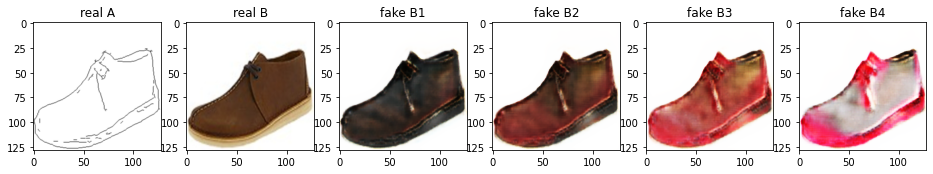

Train Epoch: 2 11% 	Total Loss: 5.695497 	Loss_GAN: 3.093157	Loss_GAN_VAE: 1.025950	Loss_GAN_LR: 0.851586	Loss_D_VAE: 1.189543	Loss_D_LR: 1.412797
1 55509 T:  3.147049903869629
Train Epoch: 2 11% 	Total Loss: 5.524120 	Loss_GAN: 2.844896	Loss_GAN_VAE: 0.849455	Loss_GAN_LR: 0.886263	Loss_D_VAE: 1.338363	Loss_D_LR: 1.340860
1 55519 T:  2.5575995445251465
Train Epoch: 2 11% 	Total Loss: 5.714826 	Loss_GAN: 3.111216	Loss_GAN_VAE: 0.910250	Loss_GAN_LR: 0.850134	Loss_D_VAE: 1.179587	Loss_D_LR: 1.424023
1 55529 T:  2.527209997177124
Train Epoch: 2 11% 	Total Loss: 6.077721 	Loss_GAN: 3.947411	Loss_GAN_VAE: 1.079248	Loss_GAN_LR: 1.093265	Loss_D_VAE: 1.163740	Loss_D_LR: 0.966570
1 55539 T:  2.529078960418701
Train Epoch: 2 11% 	Total Loss: 5.638974 	Loss_GAN: 3.358484	Loss_GAN_VAE: 0.941220	Loss_GAN_LR: 1.120667	Loss_D_VAE: 1.207074	Loss_D_LR: 1.073417
1 55549 T:  2.524221658706665
Train Epoch: 2 12% 	Total Loss: 5.895413 	Loss_GAN: 3.654049	Loss_GAN_VAE: 1.147231	Loss_GAN_LR: 0.988204	Loss_D_V

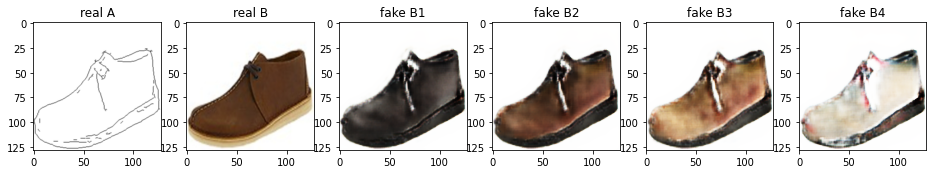

Train Epoch: 2 12% 	Total Loss: 5.708749 	Loss_GAN: 3.399922	Loss_GAN_VAE: 0.876409	Loss_GAN_LR: 0.958490	Loss_D_VAE: 1.208749	Loss_D_LR: 1.100078
1 56009 T:  3.9154577255249023
Train Epoch: 2 12% 	Total Loss: 5.981712 	Loss_GAN: 3.811367	Loss_GAN_VAE: 1.040762	Loss_GAN_LR: 1.064261	Loss_D_VAE: 1.120438	Loss_D_LR: 1.049907
1 56019 T:  2.487252950668335
Train Epoch: 2 12% 	Total Loss: 5.861435 	Loss_GAN: 3.603759	Loss_GAN_VAE: 0.900961	Loss_GAN_LR: 0.943568	Loss_D_VAE: 1.135070	Loss_D_LR: 1.122606
1 56029 T:  2.557015895843506
Train Epoch: 2 12% 	Total Loss: 5.955265 	Loss_GAN: 3.655743	Loss_GAN_VAE: 1.071115	Loss_GAN_LR: 1.161693	Loss_D_VAE: 1.104525	Loss_D_LR: 1.194997
1 56039 T:  2.8579347133636475
Train Epoch: 2 12% 	Total Loss: 5.724686 	Loss_GAN: 3.124835	Loss_GAN_VAE: 0.826333	Loss_GAN_LR: 0.823097	Loss_D_VAE: 1.224050	Loss_D_LR: 1.375801
1 56049 T:  2.6213574409484863
Train Epoch: 2 13% 	Total Loss: 5.706981 	Loss_GAN: 3.667884	Loss_GAN_VAE: 1.086672	Loss_GAN_LR: 1.178155	Loss_D

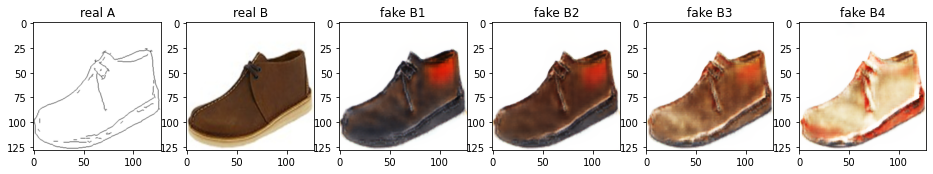

Train Epoch: 2 13% 	Total Loss: 5.961086 	Loss_GAN: 3.296776	Loss_GAN_VAE: 0.854194	Loss_GAN_LR: 1.099436	Loss_D_VAE: 1.348793	Loss_D_LR: 1.315517
1 56509 T:  3.249460458755493
Train Epoch: 2 13% 	Total Loss: 5.966700 	Loss_GAN: 4.216041	Loss_GAN_VAE: 1.489172	Loss_GAN_LR: 1.148384	Loss_D_VAE: 0.935811	Loss_D_LR: 0.814848
1 56519 T:  2.54055118560791
Train Epoch: 2 13% 	Total Loss: 5.862418 	Loss_GAN: 2.917220	Loss_GAN_VAE: 0.926639	Loss_GAN_LR: 0.866382	Loss_D_VAE: 1.454548	Loss_D_LR: 1.490650
1 56529 T:  2.5250720977783203
Train Epoch: 2 13% 	Total Loss: 5.863630 	Loss_GAN: 3.474154	Loss_GAN_VAE: 1.001489	Loss_GAN_LR: 0.990671	Loss_D_VAE: 1.136676	Loss_D_LR: 1.252800
1 56539 T:  2.4835824966430664
Train Epoch: 2 13% 	Total Loss: 5.829492 	Loss_GAN: 3.139049	Loss_GAN_VAE: 0.917937	Loss_GAN_LR: 0.827702	Loss_D_VAE: 1.302820	Loss_D_LR: 1.387623
1 56549 T:  2.5688486099243164
Train Epoch: 2 14% 	Total Loss: 5.494075 	Loss_GAN: 2.844936	Loss_GAN_VAE: 0.796444	Loss_GAN_LR: 0.810387	Loss_D_

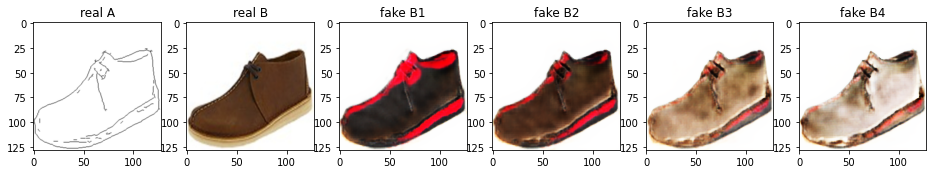

Train Epoch: 2 14% 	Total Loss: 6.078486 	Loss_GAN: 3.681388	Loss_GAN_VAE: 0.886870	Loss_GAN_LR: 1.179038	Loss_D_VAE: 1.362416	Loss_D_LR: 1.034682
1 57009 T:  3.9878547191619873
Train Epoch: 2 14% 	Total Loss: 5.724884 	Loss_GAN: 2.916210	Loss_GAN_VAE: 0.778183	Loss_GAN_LR: 0.860761	Loss_D_VAE: 1.367396	Loss_D_LR: 1.441277
1 57019 T:  2.4519073963165283
Train Epoch: 2 14% 	Total Loss: 5.760243 	Loss_GAN: 3.059018	Loss_GAN_VAE: 0.848812	Loss_GAN_LR: 0.922519	Loss_D_VAE: 1.277596	Loss_D_LR: 1.423629
1 57029 T:  2.5010154247283936
Train Epoch: 2 14% 	Total Loss: 5.281847 	Loss_GAN: 2.649051	Loss_GAN_VAE: 0.779999	Loss_GAN_LR: 0.793320	Loss_D_VAE: 1.325614	Loss_D_LR: 1.307182
1 57039 T:  2.8276565074920654
Train Epoch: 2 14% 	Total Loss: 5.638742 	Loss_GAN: 2.899185	Loss_GAN_VAE: 0.886669	Loss_GAN_LR: 0.907634	Loss_D_VAE: 1.311774	Loss_D_LR: 1.427783
1 57049 T:  2.5081229209899902
Train Epoch: 2 15% 	Total Loss: 5.524915 	Loss_GAN: 3.345756	Loss_GAN_VAE: 0.938585	Loss_GAN_LR: 1.007640	Loss

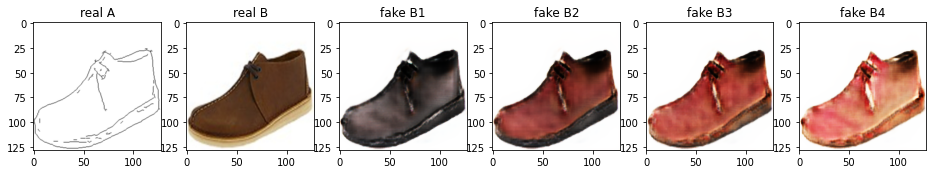

Train Epoch: 2 15% 	Total Loss: 6.186068 	Loss_GAN: 3.533810	Loss_GAN_VAE: 0.798266	Loss_GAN_LR: 1.025312	Loss_D_VAE: 1.259454	Loss_D_LR: 1.392804
1 57509 T:  3.316577672958374
Train Epoch: 2 15% 	Total Loss: 6.144276 	Loss_GAN: 3.633736	Loss_GAN_VAE: 0.855624	Loss_GAN_LR: 0.988222	Loss_D_VAE: 1.445423	Loss_D_LR: 1.065118
1 57519 T:  2.5233333110809326
Train Epoch: 2 15% 	Total Loss: 5.909586 	Loss_GAN: 3.434713	Loss_GAN_VAE: 0.821908	Loss_GAN_LR: 1.213656	Loss_D_VAE: 1.410513	Loss_D_LR: 1.064360
1 57529 T:  2.511078357696533
Train Epoch: 2 15% 	Total Loss: 5.602062 	Loss_GAN: 3.149746	Loss_GAN_VAE: 0.914970	Loss_GAN_LR: 0.971930	Loss_D_VAE: 1.204307	Loss_D_LR: 1.248009
1 57539 T:  2.5501480102539062
Train Epoch: 2 16% 	Total Loss: 5.648213 	Loss_GAN: 3.128859	Loss_GAN_VAE: 0.774214	Loss_GAN_LR: 0.944412	Loss_D_VAE: 1.298251	Loss_D_LR: 1.221103
1 57549 T:  2.5510025024414062
Train Epoch: 2 16% 	Total Loss: 6.048980 	Loss_GAN: 3.536377	Loss_GAN_VAE: 0.901718	Loss_GAN_LR: 1.061822	Loss_D

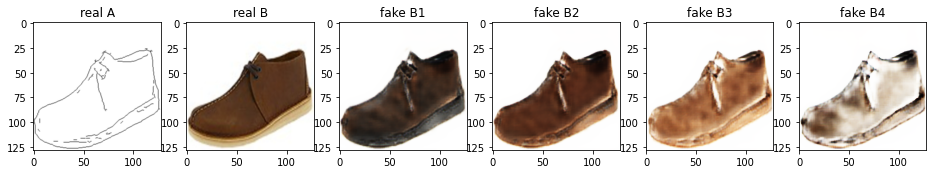

Train Epoch: 2 16% 	Total Loss: 5.731134 	Loss_GAN: 2.794533	Loss_GAN_VAE: 0.722125	Loss_GAN_LR: 0.706981	Loss_D_VAE: 1.493745	Loss_D_LR: 1.442855
1 58009 T:  3.962817668914795
Train Epoch: 2 16% 	Total Loss: 5.772486 	Loss_GAN: 3.267726	Loss_GAN_VAE: 0.882139	Loss_GAN_LR: 0.987429	Loss_D_VAE: 1.200802	Loss_D_LR: 1.303958
1 58019 T:  2.5913829803466797
Train Epoch: 2 16% 	Total Loss: 5.667856 	Loss_GAN: 3.518572	Loss_GAN_VAE: 0.974982	Loss_GAN_LR: 0.929446	Loss_D_VAE: 1.151237	Loss_D_LR: 0.998047
1 58029 T:  2.501315116882324
Train Epoch: 2 16% 	Total Loss: 6.258826 	Loss_GAN: 4.021421	Loss_GAN_VAE: 1.242549	Loss_GAN_LR: 1.090440	Loss_D_VAE: 1.047062	Loss_D_LR: 1.190343
1 58039 T:  2.8784098625183105
Train Epoch: 2 17% 	Total Loss: 5.354562 	Loss_GAN: 2.893367	Loss_GAN_VAE: 0.843138	Loss_GAN_LR: 0.862527	Loss_D_VAE: 1.199496	Loss_D_LR: 1.261700
1 58049 T:  2.6226956844329834
Train Epoch: 2 17% 	Total Loss: 5.545414 	Loss_GAN: 2.797376	Loss_GAN_VAE: 0.843772	Loss_GAN_LR: 0.917266	Loss_D

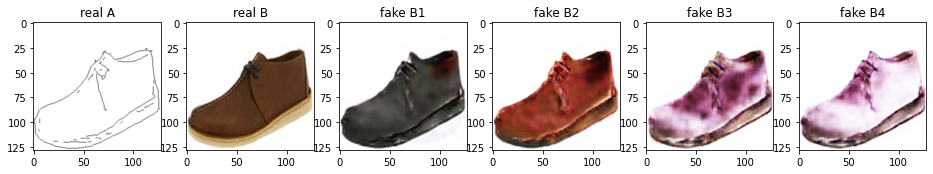

Train Epoch: 2 17% 	Total Loss: 6.233304 	Loss_GAN: 3.923213	Loss_GAN_VAE: 0.888857	Loss_GAN_LR: 1.047588	Loss_D_VAE: 1.264626	Loss_D_LR: 1.045465
1 58509 T:  3.229447841644287
Train Epoch: 2 17% 	Total Loss: 5.538803 	Loss_GAN: 3.408686	Loss_GAN_VAE: 0.836965	Loss_GAN_LR: 1.315762	Loss_D_VAE: 1.255099	Loss_D_LR: 0.875018
1 58519 T:  2.56992244720459
Train Epoch: 2 17% 	Total Loss: 5.996500 	Loss_GAN: 3.789955	Loss_GAN_VAE: 0.956144	Loss_GAN_LR: 1.240721	Loss_D_VAE: 1.153887	Loss_D_LR: 1.052658
1 58529 T:  2.529327869415283
Train Epoch: 2 17% 	Total Loss: 5.873580 	Loss_GAN: 3.877509	Loss_GAN_VAE: 1.014002	Loss_GAN_LR: 1.449933	Loss_D_VAE: 1.065915	Loss_D_LR: 0.930155
1 58539 T:  2.555386543273926
Train Epoch: 2 18% 	Total Loss: 5.554389 	Loss_GAN: 3.128914	Loss_GAN_VAE: 0.978019	Loss_GAN_LR: 0.999632	Loss_D_VAE: 1.156180	Loss_D_LR: 1.269296
1 58549 T:  2.4964663982391357
Train Epoch: 2 18% 	Total Loss: 6.079060 	Loss_GAN: 3.377206	Loss_GAN_VAE: 1.052906	Loss_GAN_LR: 0.922320	Loss_D_VA

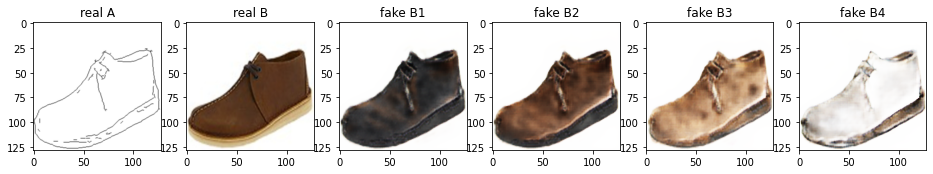

Train Epoch: 2 18% 	Total Loss: 5.757294 	Loss_GAN: 3.369111	Loss_GAN_VAE: 1.018697	Loss_GAN_LR: 0.943696	Loss_D_VAE: 1.174115	Loss_D_LR: 1.214068
1 59009 T:  4.09707498550415
Train Epoch: 2 18% 	Total Loss: 5.640460 	Loss_GAN: 2.857268	Loss_GAN_VAE: 0.814579	Loss_GAN_LR: 0.795748	Loss_D_VAE: 1.335213	Loss_D_LR: 1.447979
1 59019 T:  2.517665147781372
Train Epoch: 2 18% 	Total Loss: 5.750564 	Loss_GAN: 3.231560	Loss_GAN_VAE: 0.942624	Loss_GAN_LR: 0.965170	Loss_D_VAE: 1.283078	Loss_D_LR: 1.235925
1 59029 T:  2.537097215652466
Train Epoch: 2 18% 	Total Loss: 5.570923 	Loss_GAN: 3.314828	Loss_GAN_VAE: 1.010416	Loss_GAN_LR: 0.923907	Loss_D_VAE: 1.092920	Loss_D_LR: 1.163175
1 59039 T:  2.8602793216705322
Train Epoch: 2 19% 	Total Loss: 5.582687 	Loss_GAN: 3.370521	Loss_GAN_VAE: 1.018835	Loss_GAN_LR: 1.074205	Loss_D_VAE: 1.179756	Loss_D_LR: 1.032409
1 59049 T:  2.566039800643921
Train Epoch: 2 19% 	Total Loss: 5.304823 	Loss_GAN: 2.901532	Loss_GAN_VAE: 0.851212	Loss_GAN_LR: 0.932368	Loss_D_VA

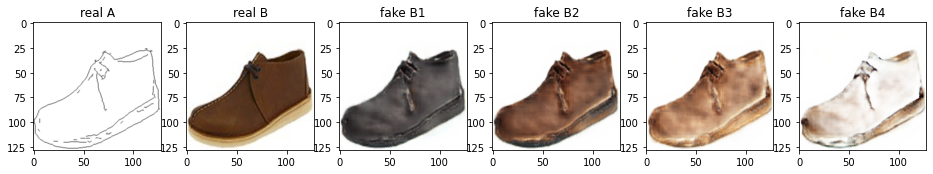

Train Epoch: 2 19% 	Total Loss: 5.431350 	Loss_GAN: 3.038440	Loss_GAN_VAE: 0.883474	Loss_GAN_LR: 0.895264	Loss_D_VAE: 1.283481	Loss_D_LR: 1.109430
1 59509 T:  3.218804121017456
Train Epoch: 2 19% 	Total Loss: 5.607655 	Loss_GAN: 3.145860	Loss_GAN_VAE: 0.889286	Loss_GAN_LR: 0.931097	Loss_D_VAE: 1.138083	Loss_D_LR: 1.323711
1 59519 T:  2.5449647903442383
Train Epoch: 2 19% 	Total Loss: 5.457095 	Loss_GAN: 3.135483	Loss_GAN_VAE: 1.019113	Loss_GAN_LR: 0.867091	Loss_D_VAE: 1.101447	Loss_D_LR: 1.220166
1 59529 T:  2.544046640396118
Train Epoch: 2 19% 	Total Loss: 5.751618 	Loss_GAN: 3.491630	Loss_GAN_VAE: 0.898689	Loss_GAN_LR: 1.166365	Loss_D_VAE: 1.121667	Loss_D_LR: 1.138321
1 59539 T:  2.486497163772583
Train Epoch: 2 20% 	Total Loss: 5.359151 	Loss_GAN: 2.895835	Loss_GAN_VAE: 1.025494	Loss_GAN_LR: 0.749517	Loss_D_VAE: 1.193620	Loss_D_LR: 1.269695
1 59549 T:  2.5353925228118896
Train Epoch: 2 20% 	Total Loss: 6.368728 	Loss_GAN: 3.977066	Loss_GAN_VAE: 1.008244	Loss_GAN_LR: 1.113001	Loss_D_

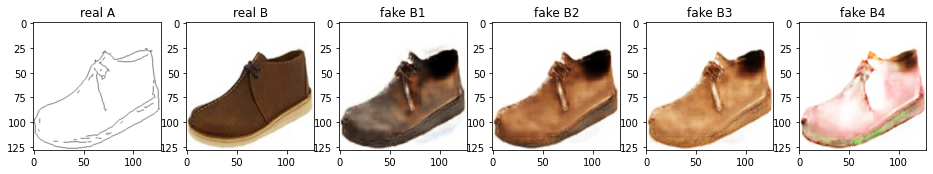

Train Epoch: 2 20% 	Total Loss: 6.205689 	Loss_GAN: 3.821466	Loss_GAN_VAE: 1.012484	Loss_GAN_LR: 1.129512	Loss_D_VAE: 1.207215	Loss_D_LR: 1.177008
1 60009 T:  3.9533519744873047
Train Epoch: 2 20% 	Total Loss: 6.212809 	Loss_GAN: 3.545199	Loss_GAN_VAE: 0.993384	Loss_GAN_LR: 1.101711	Loss_D_VAE: 1.323392	Loss_D_LR: 1.344218
1 60019 T:  2.549081325531006
Train Epoch: 2 20% 	Total Loss: 5.759029 	Loss_GAN: 3.417517	Loss_GAN_VAE: 0.999129	Loss_GAN_LR: 1.029758	Loss_D_VAE: 1.186677	Loss_D_LR: 1.154835
1 60029 T:  2.5016496181488037
Train Epoch: 2 20% 	Total Loss: 6.001279 	Loss_GAN: 3.498509	Loss_GAN_VAE: 1.032497	Loss_GAN_LR: 0.932047	Loss_D_VAE: 0.982909	Loss_D_LR: 1.519861
1 60039 T:  2.8180220127105713
Train Epoch: 2 21% 	Total Loss: 5.635400 	Loss_GAN: 3.222342	Loss_GAN_VAE: 0.929128	Loss_GAN_LR: 0.958770	Loss_D_VAE: 1.117220	Loss_D_LR: 1.295838
1 60049 T:  2.4753799438476562
Train Epoch: 2 21% 	Total Loss: 5.596653 	Loss_GAN: 2.938467	Loss_GAN_VAE: 0.963664	Loss_GAN_LR: 0.788299	Loss_

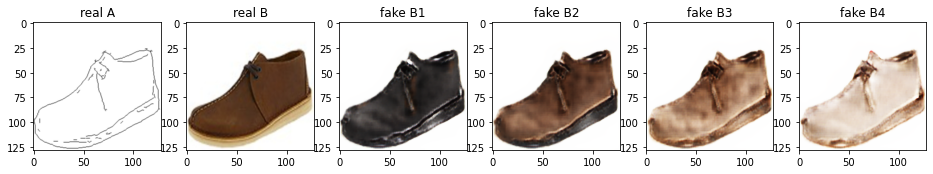

Train Epoch: 2 21% 	Total Loss: 5.886238 	Loss_GAN: 3.305658	Loss_GAN_VAE: 0.987610	Loss_GAN_LR: 1.091843	Loss_D_VAE: 1.240397	Loss_D_LR: 1.340184
1 60509 T:  3.1810059547424316
Train Epoch: 2 21% 	Total Loss: 5.256815 	Loss_GAN: 3.268739	Loss_GAN_VAE: 0.924723	Loss_GAN_LR: 1.040572	Loss_D_VAE: 1.087166	Loss_D_LR: 0.900910
1 60519 T:  2.5516390800476074
Train Epoch: 2 21% 	Total Loss: 5.486279 	Loss_GAN: 3.372588	Loss_GAN_VAE: 0.923536	Loss_GAN_LR: 1.096996	Loss_D_VAE: 1.206885	Loss_D_LR: 0.906806
1 60529 T:  2.5301849842071533
Train Epoch: 2 22% 	Total Loss: 6.113265 	Loss_GAN: 4.102430	Loss_GAN_VAE: 1.216140	Loss_GAN_LR: 1.242513	Loss_D_VAE: 0.914097	Loss_D_LR: 1.096737
1 60539 T:  2.490388870239258
Train Epoch: 2 22% 	Total Loss: 5.969166 	Loss_GAN: 3.339271	Loss_GAN_VAE: 1.055222	Loss_GAN_LR: 0.764199	Loss_D_VAE: 1.103351	Loss_D_LR: 1.526544
1 60549 T:  2.48370361328125
Train Epoch: 2 22% 	Total Loss: 5.727490 	Loss_GAN: 3.251752	Loss_GAN_VAE: 0.966420	Loss_GAN_LR: 0.856183	Loss_D_

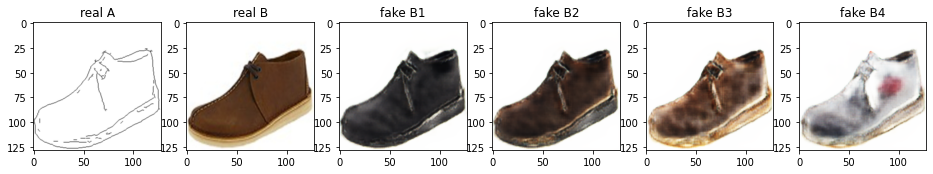

Train Epoch: 2 22% 	Total Loss: 5.509850 	Loss_GAN: 3.230023	Loss_GAN_VAE: 0.981729	Loss_GAN_LR: 0.955943	Loss_D_VAE: 1.062864	Loss_D_LR: 1.216963
1 61009 T:  3.938359260559082
Train Epoch: 2 22% 	Total Loss: 5.578449 	Loss_GAN: 3.441719	Loss_GAN_VAE: 1.048480	Loss_GAN_LR: 1.086202	Loss_D_VAE: 1.096267	Loss_D_LR: 1.040463
1 61019 T:  2.5398576259613037
Train Epoch: 2 22% 	Total Loss: 6.064000 	Loss_GAN: 3.208880	Loss_GAN_VAE: 0.919812	Loss_GAN_LR: 0.777014	Loss_D_VAE: 1.384922	Loss_D_LR: 1.470199
1 61029 T:  2.487582206726074
Train Epoch: 2 23% 	Total Loss: 6.040576 	Loss_GAN: 3.578246	Loss_GAN_VAE: 0.995482	Loss_GAN_LR: 1.083151	Loss_D_VAE: 1.176534	Loss_D_LR: 1.285797
1 61039 T:  2.8222696781158447
Train Epoch: 2 23% 	Total Loss: 5.669764 	Loss_GAN: 3.054756	Loss_GAN_VAE: 0.922538	Loss_GAN_LR: 0.877144	Loss_D_VAE: 1.365066	Loss_D_LR: 1.249942
1 61049 T:  2.5561437606811523
Train Epoch: 2 23% 	Total Loss: 5.554650 	Loss_GAN: 3.321706	Loss_GAN_VAE: 0.826822	Loss_GAN_LR: 1.265150	Loss_D

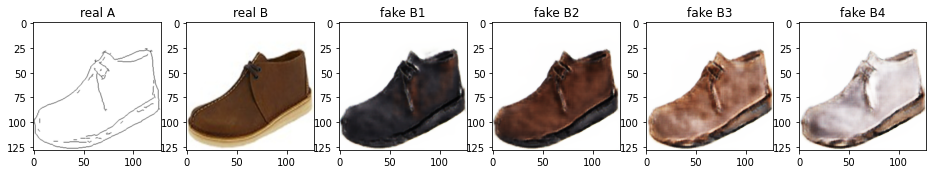

Train Epoch: 2 23% 	Total Loss: 5.698955 	Loss_GAN: 3.079386	Loss_GAN_VAE: 0.798099	Loss_GAN_LR: 0.814311	Loss_D_VAE: 1.294284	Loss_D_LR: 1.325285
1 61509 T:  3.210662603378296
Train Epoch: 2 23% 	Total Loss: 5.515477 	Loss_GAN: 2.815402	Loss_GAN_VAE: 0.850288	Loss_GAN_LR: 0.923012	Loss_D_VAE: 1.298794	Loss_D_LR: 1.401281
1 61519 T:  2.516702890396118
Train Epoch: 2 23% 	Total Loss: 5.650077 	Loss_GAN: 3.175974	Loss_GAN_VAE: 0.963384	Loss_GAN_LR: 0.870415	Loss_D_VAE: 1.174048	Loss_D_LR: 1.300055
1 61529 T:  2.558966636657715
Train Epoch: 2 24% 	Total Loss: 5.260445 	Loss_GAN: 2.779778	Loss_GAN_VAE: 0.909496	Loss_GAN_LR: 0.959321	Loss_D_VAE: 1.228614	Loss_D_LR: 1.252053
1 61539 T:  2.505014181137085
Train Epoch: 2 24% 	Total Loss: 5.250770 	Loss_GAN: 2.766735	Loss_GAN_VAE: 0.754181	Loss_GAN_LR: 0.832207	Loss_D_VAE: 1.315020	Loss_D_LR: 1.169015
1 61549 T:  2.497276544570923
Train Epoch: 2 24% 	Total Loss: 5.729692 	Loss_GAN: 3.430435	Loss_GAN_VAE: 1.061247	Loss_GAN_LR: 1.103471	Loss_D_VA

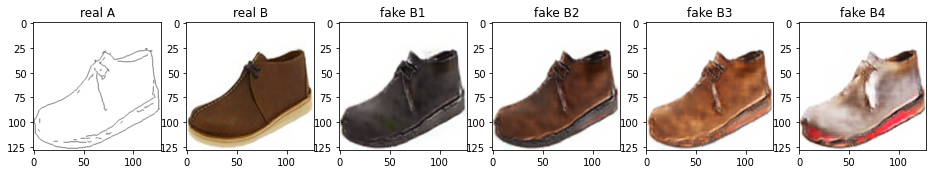

Train Epoch: 2 24% 	Total Loss: 5.724479 	Loss_GAN: 3.488969	Loss_GAN_VAE: 1.103752	Loss_GAN_LR: 0.999952	Loss_D_VAE: 1.079239	Loss_D_LR: 1.156271
1 62009 T:  3.93468976020813
Train Epoch: 2 24% 	Total Loss: 5.817278 	Loss_GAN: 3.493568	Loss_GAN_VAE: 0.962088	Loss_GAN_LR: 1.001997	Loss_D_VAE: 1.223534	Loss_D_LR: 1.100176
1 62019 T:  2.522690773010254
Train Epoch: 2 24% 	Total Loss: 5.777021 	Loss_GAN: 3.006970	Loss_GAN_VAE: 0.918124	Loss_GAN_LR: 0.907939	Loss_D_VAE: 1.379463	Loss_D_LR: 1.390587
1 62029 T:  2.5940239429473877
Train Epoch: 2 25% 	Total Loss: 5.494629 	Loss_GAN: 2.833088	Loss_GAN_VAE: 0.956647	Loss_GAN_LR: 0.774589	Loss_D_VAE: 1.200819	Loss_D_LR: 1.460722
1 62039 T:  2.8632984161376953
Train Epoch: 2 25% 	Total Loss: 5.644610 	Loss_GAN: 2.973639	Loss_GAN_VAE: 0.888615	Loss_GAN_LR: 0.850761	Loss_D_VAE: 1.355014	Loss_D_LR: 1.315957
1 62049 T:  2.6178202629089355
Train Epoch: 2 25% 	Total Loss: 5.727098 	Loss_GAN: 2.954597	Loss_GAN_VAE: 0.891594	Loss_GAN_LR: 0.788384	Loss_D_

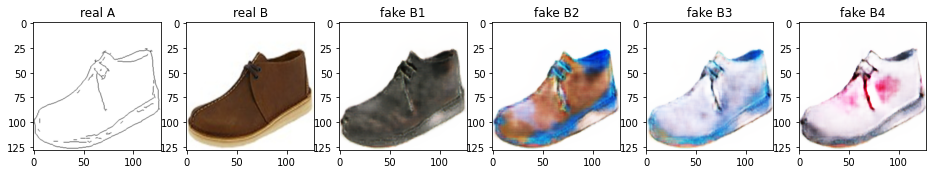

Train Epoch: 2 25% 	Total Loss: 5.904394 	Loss_GAN: 3.404924	Loss_GAN_VAE: 0.938515	Loss_GAN_LR: 1.090035	Loss_D_VAE: 1.321718	Loss_D_LR: 1.177752
1 62509 T:  3.2374300956726074
Train Epoch: 2 25% 	Total Loss: 5.894544 	Loss_GAN: 3.838605	Loss_GAN_VAE: 1.049846	Loss_GAN_LR: 1.251773	Loss_D_VAE: 1.194806	Loss_D_LR: 0.861134
1 62519 T:  2.4691271781921387
Train Epoch: 2 25% 	Total Loss: 6.035055 	Loss_GAN: 3.839974	Loss_GAN_VAE: 1.144720	Loss_GAN_LR: 0.941122	Loss_D_VAE: 1.086044	Loss_D_LR: 1.109037
1 62529 T:  2.540977954864502
Train Epoch: 2 26% 	Total Loss: 5.851743 	Loss_GAN: 3.894394	Loss_GAN_VAE: 1.200895	Loss_GAN_LR: 1.144396	Loss_D_VAE: 0.959953	Loss_D_LR: 0.997397
1 62539 T:  2.475252389907837
Train Epoch: 2 26% 	Total Loss: 5.883808 	Loss_GAN: 3.700014	Loss_GAN_VAE: 0.956429	Loss_GAN_LR: 1.517020	Loss_D_VAE: 1.292521	Loss_D_LR: 0.891274
1 62549 T:  2.5640907287597656
Train Epoch: 2 26% 	Total Loss: 6.400972 	Loss_GAN: 3.925981	Loss_GAN_VAE: 0.902611	Loss_GAN_LR: 1.357791	Loss_D

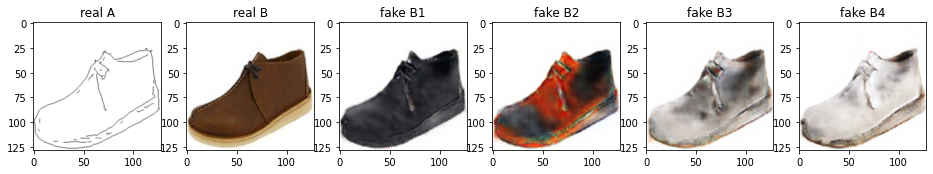

Train Epoch: 2 26% 	Total Loss: 5.746304 	Loss_GAN: 3.197631	Loss_GAN_VAE: 1.033143	Loss_GAN_LR: 0.935802	Loss_D_VAE: 1.300928	Loss_D_LR: 1.247746
1 63009 T:  4.055762052536011
Train Epoch: 2 26% 	Total Loss: 5.690397 	Loss_GAN: 3.198492	Loss_GAN_VAE: 0.949878	Loss_GAN_LR: 0.902432	Loss_D_VAE: 1.151224	Loss_D_LR: 1.340681
1 63019 T:  2.527475357055664
Train Epoch: 2 27% 	Total Loss: 5.261028 	Loss_GAN: 2.768965	Loss_GAN_VAE: 0.925052	Loss_GAN_LR: 0.830472	Loss_D_VAE: 1.218380	Loss_D_LR: 1.273683
1 63029 T:  2.511317729949951
Train Epoch: 2 27% 	Total Loss: 5.258337 	Loss_GAN: 2.860673	Loss_GAN_VAE: 0.809140	Loss_GAN_LR: 0.899930	Loss_D_VAE: 1.207243	Loss_D_LR: 1.190421
1 63039 T:  2.7846784591674805
Train Epoch: 2 27% 	Total Loss: 5.716260 	Loss_GAN: 3.001621	Loss_GAN_VAE: 0.864412	Loss_GAN_LR: 0.825958	Loss_D_VAE: 1.317033	Loss_D_LR: 1.397606
1 63049 T:  2.5228469371795654
Train Epoch: 2 27% 	Total Loss: 5.238076 	Loss_GAN: 3.371666	Loss_GAN_VAE: 1.039830	Loss_GAN_LR: 1.084293	Loss_D_

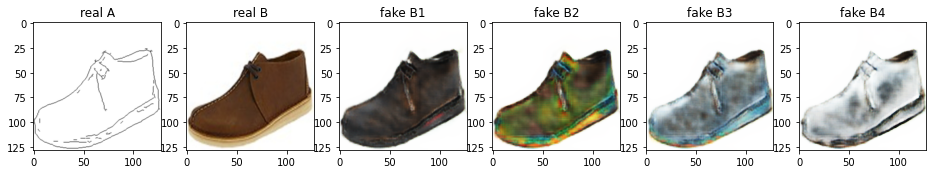

Train Epoch: 2 27% 	Total Loss: 5.664560 	Loss_GAN: 3.269724	Loss_GAN_VAE: 1.017922	Loss_GAN_LR: 0.995428	Loss_D_VAE: 1.199192	Loss_D_LR: 1.195644
1 63509 T:  3.2656731605529785
Train Epoch: 2 27% 	Total Loss: 5.950231 	Loss_GAN: 3.723667	Loss_GAN_VAE: 0.976697	Loss_GAN_LR: 1.223624	Loss_D_VAE: 1.169599	Loss_D_LR: 1.056964
1 63519 T:  2.5206055641174316
Train Epoch: 2 28% 	Total Loss: 5.680740 	Loss_GAN: 3.401562	Loss_GAN_VAE: 1.054109	Loss_GAN_LR: 1.138903	Loss_D_VAE: 1.237283	Loss_D_LR: 1.041895
1 63529 T:  2.5177435874938965
Train Epoch: 2 28% 	Total Loss: 6.438362 	Loss_GAN: 3.690770	Loss_GAN_VAE: 1.145212	Loss_GAN_LR: 1.040635	Loss_D_VAE: 1.212051	Loss_D_LR: 1.535541
1 63539 T:  2.554497241973877
Train Epoch: 2 28% 	Total Loss: 5.653880 	Loss_GAN: 2.739944	Loss_GAN_VAE: 0.767685	Loss_GAN_LR: 0.732971	Loss_D_VAE: 1.371936	Loss_D_LR: 1.542000
1 63549 T:  2.500281572341919
Train Epoch: 2 28% 	Total Loss: 5.665047 	Loss_GAN: 3.000706	Loss_GAN_VAE: 0.925306	Loss_GAN_LR: 0.934761	Loss_D

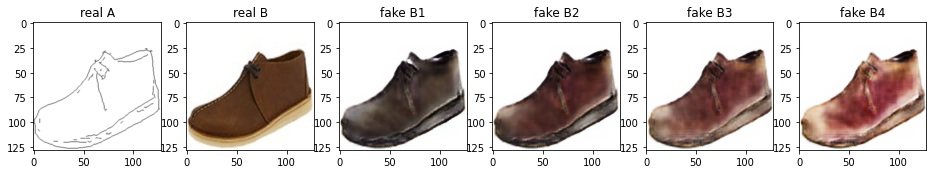

Train Epoch: 2 28% 	Total Loss: 6.151997 	Loss_GAN: 3.660095	Loss_GAN_VAE: 1.003620	Loss_GAN_LR: 0.926422	Loss_D_VAE: 1.126599	Loss_D_LR: 1.365303
1 64009 T:  3.858337640762329
Train Epoch: 2 28% 	Total Loss: 5.413237 	Loss_GAN: 3.290244	Loss_GAN_VAE: 1.059308	Loss_GAN_LR: 1.121389	Loss_D_VAE: 1.084464	Loss_D_LR: 1.038528
1 64019 T:  2.5325076580047607
Train Epoch: 2 29% 	Total Loss: 6.069886 	Loss_GAN: 3.493562	Loss_GAN_VAE: 1.085283	Loss_GAN_LR: 1.041814	Loss_D_VAE: 1.304952	Loss_D_LR: 1.271373
1 64029 T:  2.531198501586914
Train Epoch: 2 29% 	Total Loss: 6.113607 	Loss_GAN: 3.692075	Loss_GAN_VAE: 1.143141	Loss_GAN_LR: 0.969230	Loss_D_VAE: 1.045677	Loss_D_LR: 1.375855
1 64039 T:  2.8786420822143555
Train Epoch: 2 29% 	Total Loss: 5.794578 	Loss_GAN: 3.588658	Loss_GAN_VAE: 1.024297	Loss_GAN_LR: 1.080323	Loss_D_VAE: 1.127712	Loss_D_LR: 1.078208
1 64049 T:  2.5636768341064453
Train Epoch: 2 29% 	Total Loss: 6.109691 	Loss_GAN: 3.894108	Loss_GAN_VAE: 1.191848	Loss_GAN_LR: 1.194164	Loss_D

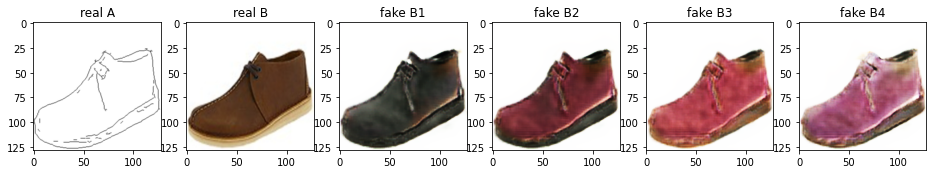

Train Epoch: 2 29% 	Total Loss: 6.001752 	Loss_GAN: 3.647682	Loss_GAN_VAE: 1.029081	Loss_GAN_LR: 1.241177	Loss_D_VAE: 1.467556	Loss_D_LR: 0.886514
1 64509 T:  3.2348477840423584
Train Epoch: 2 29% 	Total Loss: 5.682450 	Loss_GAN: 3.117343	Loss_GAN_VAE: 0.909588	Loss_GAN_LR: 1.057072	Loss_D_VAE: 1.491807	Loss_D_LR: 1.073300
1 64519 T:  2.5401382446289062
Train Epoch: 2 30% 	Total Loss: 5.632216 	Loss_GAN: 2.888191	Loss_GAN_VAE: 0.858579	Loss_GAN_LR: 0.944798	Loss_D_VAE: 1.313995	Loss_D_LR: 1.430030
1 64529 T:  2.5480005741119385
Train Epoch: 2 30% 	Total Loss: 5.672815 	Loss_GAN: 3.493422	Loss_GAN_VAE: 0.942380	Loss_GAN_LR: 1.095519	Loss_D_VAE: 1.162603	Loss_D_LR: 1.016790
1 64539 T:  2.465365409851074
Train Epoch: 2 30% 	Total Loss: 5.594722 	Loss_GAN: 3.107116	Loss_GAN_VAE: 0.895825	Loss_GAN_LR: 1.078024	Loss_D_VAE: 1.235655	Loss_D_LR: 1.251952
1 64549 T:  2.5135445594787598
Train Epoch: 2 30% 	Total Loss: 5.868787 	Loss_GAN: 3.951759	Loss_GAN_VAE: 1.078835	Loss_GAN_LR: 1.184917	Loss_

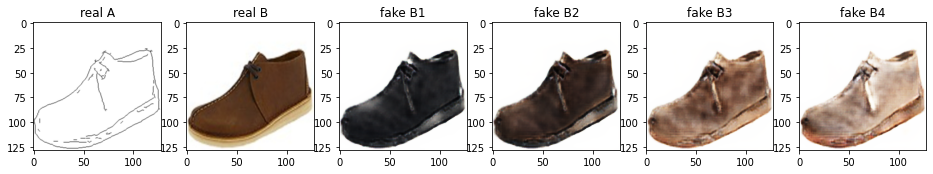

Train Epoch: 2 30% 	Total Loss: 6.618363 	Loss_GAN: 3.498089	Loss_GAN_VAE: 1.013831	Loss_GAN_LR: 1.036594	Loss_D_VAE: 1.412328	Loss_D_LR: 1.707946
1 65009 T:  4.032068729400635
Train Epoch: 2 30% 	Total Loss: 5.406668 	Loss_GAN: 3.166766	Loss_GAN_VAE: 0.935045	Loss_GAN_LR: 0.920002	Loss_D_VAE: 1.095924	Loss_D_LR: 1.143978
1 65019 T:  2.5173189640045166
Train Epoch: 2 31% 	Total Loss: 5.829747 	Loss_GAN: 3.427949	Loss_GAN_VAE: 1.177884	Loss_GAN_LR: 0.954133	Loss_D_VAE: 1.240497	Loss_D_LR: 1.161302
1 65029 T:  2.5119991302490234
Train Epoch: 2 31% 	Total Loss: 5.631617 	Loss_GAN: 3.343791	Loss_GAN_VAE: 0.963517	Loss_GAN_LR: 1.071724	Loss_D_VAE: 1.130806	Loss_D_LR: 1.157021
1 65039 T:  2.8513216972351074
Train Epoch: 2 31% 	Total Loss: 5.656442 	Loss_GAN: 3.385688	Loss_GAN_VAE: 1.034013	Loss_GAN_LR: 0.942483	Loss_D_VAE: 0.996777	Loss_D_LR: 1.273978
1 65049 T:  2.58388614654541
Train Epoch: 2 31% 	Total Loss: 5.412487 	Loss_GAN: 2.926975	Loss_GAN_VAE: 0.963427	Loss_GAN_LR: 0.817184	Loss_D_

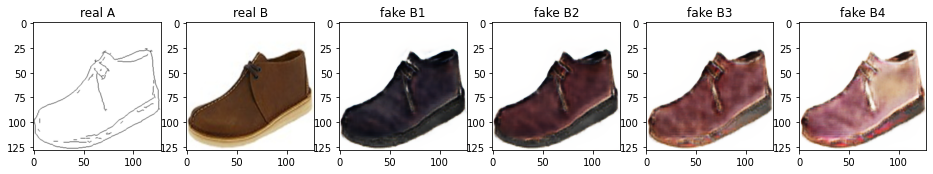

Train Epoch: 2 31% 	Total Loss: 5.888695 	Loss_GAN: 3.613143	Loss_GAN_VAE: 1.105311	Loss_GAN_LR: 0.891300	Loss_D_VAE: 1.016970	Loss_D_LR: 1.258581
1 65509 T:  3.269089698791504
Train Epoch: 2 31% 	Total Loss: 5.667737 	Loss_GAN: 3.483040	Loss_GAN_VAE: 1.000260	Loss_GAN_LR: 1.126464	Loss_D_VAE: 1.165692	Loss_D_LR: 1.019005
1 65519 T:  2.5620830059051514
Train Epoch: 2 32% 	Total Loss: 6.270943 	Loss_GAN: 4.110972	Loss_GAN_VAE: 1.249086	Loss_GAN_LR: 1.265888	Loss_D_VAE: 0.923272	Loss_D_LR: 1.236699
1 65529 T:  2.551692247390747
Train Epoch: 2 32% 	Total Loss: 5.789287 	Loss_GAN: 4.615619	Loss_GAN_VAE: 1.495588	Loss_GAN_LR: 1.602627	Loss_D_VAE: 0.627738	Loss_D_LR: 0.545930
1 65539 T:  2.5108747482299805
Train Epoch: 2 32% 	Total Loss: 7.201026 	Loss_GAN: 6.060102	Loss_GAN_VAE: 1.770692	Loss_GAN_LR: 2.206250	Loss_D_VAE: 0.728544	Loss_D_LR: 0.412381
1 65549 T:  2.492126941680908
Train Epoch: 2 32% 	Total Loss: 6.182486 	Loss_GAN: 4.479206	Loss_GAN_VAE: 1.341300	Loss_GAN_LR: 1.368121	Loss_D_

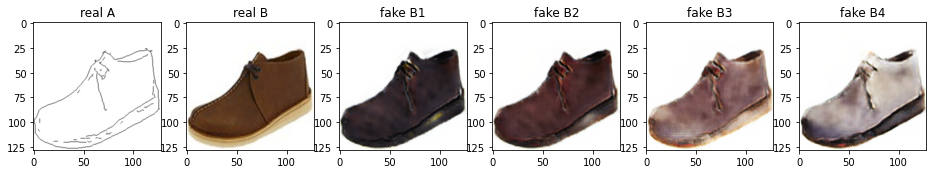

Train Epoch: 2 32% 	Total Loss: 5.522049 	Loss_GAN: 3.054650	Loss_GAN_VAE: 0.855918	Loss_GAN_LR: 0.981047	Loss_D_VAE: 1.315827	Loss_D_LR: 1.151572
1 66009 T:  4.216501474380493
Train Epoch: 2 33% 	Total Loss: 5.407922 	Loss_GAN: 3.069220	Loss_GAN_VAE: 1.105689	Loss_GAN_LR: 0.930352	Loss_D_VAE: 1.243591	Loss_D_LR: 1.095111
1 66019 T:  2.5500926971435547
Train Epoch: 2 33% 	Total Loss: 5.760308 	Loss_GAN: 3.658390	Loss_GAN_VAE: 1.122848	Loss_GAN_LR: 1.176352	Loss_D_VAE: 1.113118	Loss_D_LR: 0.988800
1 66029 T:  2.645866870880127
Train Epoch: 2 33% 	Total Loss: 5.664938 	Loss_GAN: 3.298636	Loss_GAN_VAE: 0.940877	Loss_GAN_LR: 0.957287	Loss_D_VAE: 1.161103	Loss_D_LR: 1.205199
1 66039 T:  2.721608877182007
Train Epoch: 2 33% 	Total Loss: 5.493477 	Loss_GAN: 3.069690	Loss_GAN_VAE: 0.951394	Loss_GAN_LR: 0.988744	Loss_D_VAE: 1.090820	Loss_D_LR: 1.332967
1 66049 T:  2.4793264865875244
Train Epoch: 2 33% 	Total Loss: 5.661423 	Loss_GAN: 3.270251	Loss_GAN_VAE: 1.002832	Loss_GAN_LR: 1.001501	Loss_D_

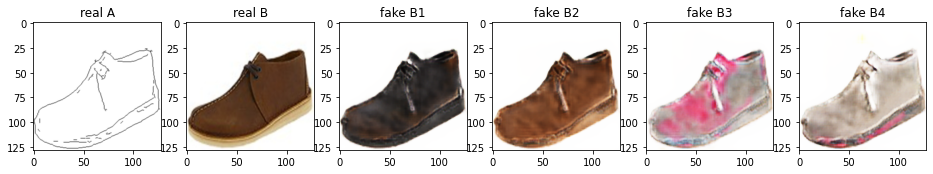

Train Epoch: 2 33% 	Total Loss: 5.740719 	Loss_GAN: 3.335751	Loss_GAN_VAE: 0.975389	Loss_GAN_LR: 1.094352	Loss_D_VAE: 1.237152	Loss_D_LR: 1.167816
1 66509 T:  3.319322347640991
Train Epoch: 2 34% 	Total Loss: 5.181991 	Loss_GAN: 3.266357	Loss_GAN_VAE: 1.053992	Loss_GAN_LR: 1.066484	Loss_D_VAE: 0.937286	Loss_D_LR: 0.978349
1 66519 T:  2.661839008331299
Train Epoch: 2 34% 	Total Loss: 5.996274 	Loss_GAN: 3.479709	Loss_GAN_VAE: 1.003988	Loss_GAN_LR: 1.124026	Loss_D_VAE: 1.313838	Loss_D_LR: 1.202726
1 66529 T:  2.695730447769165
Train Epoch: 2 34% 	Total Loss: 6.053624 	Loss_GAN: 3.795993	Loss_GAN_VAE: 0.991409	Loss_GAN_LR: 1.028297	Loss_D_VAE: 1.209316	Loss_D_LR: 1.048315
1 66539 T:  2.616511344909668
Train Epoch: 2 34% 	Total Loss: 5.784680 	Loss_GAN: 3.522874	Loss_GAN_VAE: 1.088697	Loss_GAN_LR: 1.083833	Loss_D_VAE: 1.105148	Loss_D_LR: 1.156658
1 66549 T:  2.5588762760162354
Train Epoch: 2 34% 	Total Loss: 5.848232 	Loss_GAN: 3.366576	Loss_GAN_VAE: 0.936506	Loss_GAN_LR: 0.989733	Loss_D_V

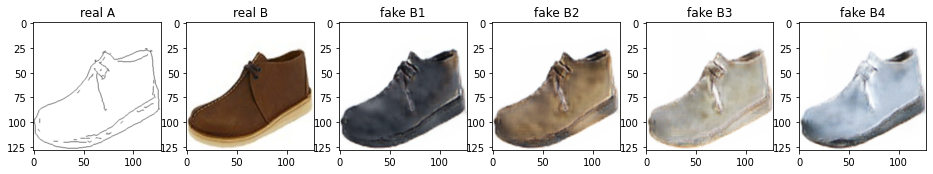

Train Epoch: 2 34% 	Total Loss: 5.417462 	Loss_GAN: 2.919950	Loss_GAN_VAE: 0.946772	Loss_GAN_LR: 0.907456	Loss_D_VAE: 1.188110	Loss_D_LR: 1.309402
1 67009 T:  4.094461917877197
Train Epoch: 2 35% 	Total Loss: 6.172873 	Loss_GAN: 4.248871	Loss_GAN_VAE: 1.403278	Loss_GAN_LR: 1.113602	Loss_D_VAE: 0.818279	Loss_D_LR: 1.105723
1 67019 T:  2.5558481216430664
Train Epoch: 2 35% 	Total Loss: 5.908405 	Loss_GAN: 3.533366	Loss_GAN_VAE: 1.099435	Loss_GAN_LR: 1.128239	Loss_D_VAE: 1.249997	Loss_D_LR: 1.125043
1 67029 T:  2.4787960052490234
Train Epoch: 2 35% 	Total Loss: 5.409566 	Loss_GAN: 3.131746	Loss_GAN_VAE: 1.012505	Loss_GAN_LR: 0.988118	Loss_D_VAE: 1.211508	Loss_D_LR: 1.066312
1 67039 T:  2.803548812866211
Train Epoch: 2 35% 	Total Loss: 6.244930 	Loss_GAN: 3.513772	Loss_GAN_VAE: 0.962915	Loss_GAN_LR: 1.518679	Loss_D_VAE: 1.274748	Loss_D_LR: 1.456410
1 67049 T:  2.553718090057373
Train Epoch: 2 35% 	Total Loss: 6.183203 	Loss_GAN: 4.164717	Loss_GAN_VAE: 1.188273	Loss_GAN_LR: 1.269184	Loss_D_

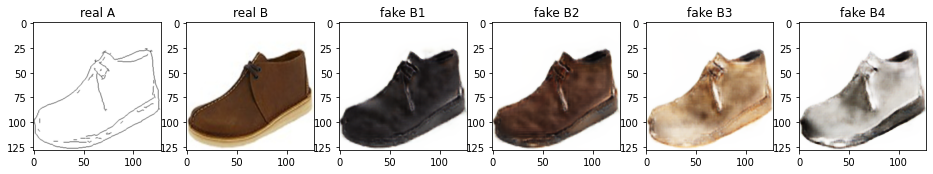

Train Epoch: 2 35% 	Total Loss: 5.934983 	Loss_GAN: 3.590853	Loss_GAN_VAE: 1.119475	Loss_GAN_LR: 1.006436	Loss_D_VAE: 1.238036	Loss_D_LR: 1.106094
1 67509 T:  3.1464641094207764
Train Epoch: 2 36% 	Total Loss: 6.085103 	Loss_GAN: 3.637478	Loss_GAN_VAE: 1.070667	Loss_GAN_LR: 1.002064	Loss_D_VAE: 1.140113	Loss_D_LR: 1.307511
1 67519 T:  2.537485361099243
Train Epoch: 2 36% 	Total Loss: 5.828805 	Loss_GAN: 3.518031	Loss_GAN_VAE: 1.177905	Loss_GAN_LR: 0.926863	Loss_D_VAE: 1.064553	Loss_D_LR: 1.246220
1 67529 T:  2.513314962387085
Train Epoch: 2 36% 	Total Loss: 5.868620 	Loss_GAN: 3.916993	Loss_GAN_VAE: 1.108712	Loss_GAN_LR: 1.103502	Loss_D_VAE: 0.993490	Loss_D_LR: 0.958137
1 67539 T:  2.4900872707366943
Train Epoch: 2 36% 	Total Loss: 5.409867 	Loss_GAN: 2.946037	Loss_GAN_VAE: 0.969874	Loss_GAN_LR: 0.810879	Loss_D_VAE: 1.188092	Loss_D_LR: 1.275738
1 67549 T:  2.5345265865325928
Train Epoch: 2 36% 	Total Loss: 5.584474 	Loss_GAN: 3.521697	Loss_GAN_VAE: 1.187906	Loss_GAN_LR: 1.125200	Loss_D

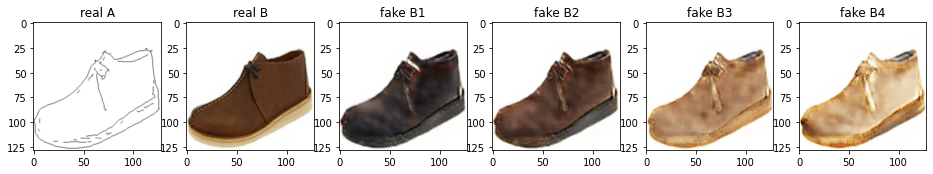

Train Epoch: 2 36% 	Total Loss: 6.571714 	Loss_GAN: 4.369569	Loss_GAN_VAE: 1.385362	Loss_GAN_LR: 1.073323	Loss_D_VAE: 0.913335	Loss_D_LR: 1.288811
1 68009 T:  4.046522378921509
Train Epoch: 2 37% 	Total Loss: 5.880111 	Loss_GAN: 3.502925	Loss_GAN_VAE: 1.136918	Loss_GAN_LR: 0.945482	Loss_D_VAE: 1.171870	Loss_D_LR: 1.205316
1 68019 T:  2.492931604385376
Train Epoch: 2 37% 	Total Loss: 6.117762 	Loss_GAN: 3.892916	Loss_GAN_VAE: 1.104639	Loss_GAN_LR: 1.067891	Loss_D_VAE: 0.932844	Loss_D_LR: 1.292001
1 68029 T:  2.5294442176818848
Train Epoch: 2 37% 	Total Loss: 6.020474 	Loss_GAN: 3.660407	Loss_GAN_VAE: 1.273952	Loss_GAN_LR: 1.022027	Loss_D_VAE: 1.189034	Loss_D_LR: 1.171033
1 68039 T:  2.8377692699432373
Train Epoch: 2 37% 	Total Loss: 6.434337 	Loss_GAN: 4.771181	Loss_GAN_VAE: 1.615531	Loss_GAN_LR: 1.265506	Loss_D_VAE: 0.817184	Loss_D_LR: 0.845972
1 68049 T:  2.551145076751709
Train Epoch: 2 37% 	Total Loss: 5.673325 	Loss_GAN: 3.243206	Loss_GAN_VAE: 0.940182	Loss_GAN_LR: 0.984661	Loss_D_

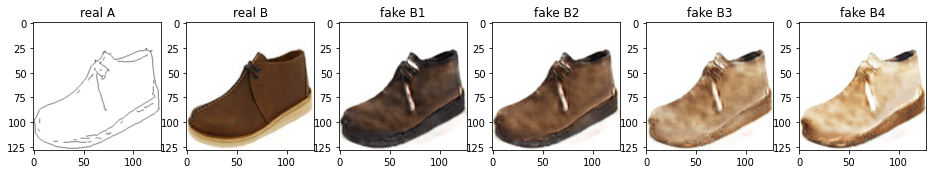

Train Epoch: 2 37% 	Total Loss: 5.689475 	Loss_GAN: 3.200807	Loss_GAN_VAE: 1.140170	Loss_GAN_LR: 1.019674	Loss_D_VAE: 1.128450	Loss_D_LR: 1.360218
1 68509 T:  3.186923027038574
Train Epoch: 2 38% 	Total Loss: 5.565954 	Loss_GAN: 3.141787	Loss_GAN_VAE: 1.170618	Loss_GAN_LR: 0.991677	Loss_D_VAE: 1.067698	Loss_D_LR: 1.356469
1 68519 T:  2.549321174621582
Train Epoch: 2 38% 	Total Loss: 5.822812 	Loss_GAN: 3.371059	Loss_GAN_VAE: 1.139825	Loss_GAN_LR: 1.039490	Loss_D_VAE: 1.255420	Loss_D_LR: 1.196334
1 68529 T:  2.490354061126709
Train Epoch: 2 38% 	Total Loss: 5.978654 	Loss_GAN: 3.654640	Loss_GAN_VAE: 1.183288	Loss_GAN_LR: 0.978815	Loss_D_VAE: 1.122812	Loss_D_LR: 1.201202
1 68539 T:  2.4836175441741943
Train Epoch: 2 38% 	Total Loss: 5.578004 	Loss_GAN: 3.681403	Loss_GAN_VAE: 1.163100	Loss_GAN_LR: 1.073921	Loss_D_VAE: 0.941815	Loss_D_LR: 0.954786
1 68549 T:  2.4996426105499268
Train Epoch: 2 38% 	Total Loss: 5.438575 	Loss_GAN: 3.394896	Loss_GAN_VAE: 1.040736	Loss_GAN_LR: 1.042526	Loss_D_

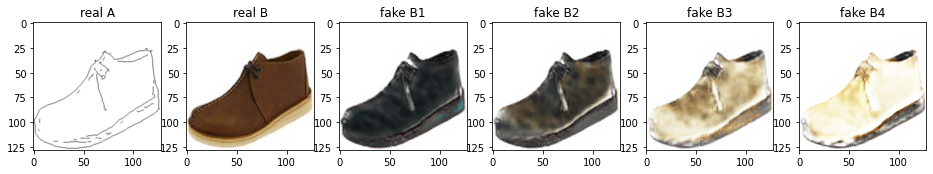

Train Epoch: 2 39% 	Total Loss: 5.817501 	Loss_GAN: 3.635929	Loss_GAN_VAE: 1.283413	Loss_GAN_LR: 1.167066	Loss_D_VAE: 1.177881	Loss_D_LR: 1.003691
1 69009 T:  4.174278020858765
Train Epoch: 2 39% 	Total Loss: 5.738740 	Loss_GAN: 3.548775	Loss_GAN_VAE: 1.219901	Loss_GAN_LR: 0.959233	Loss_D_VAE: 0.999260	Loss_D_LR: 1.190705
1 69019 T:  2.6177926063537598
Train Epoch: 2 39% 	Total Loss: 5.650615 	Loss_GAN: 3.148099	Loss_GAN_VAE: 0.983999	Loss_GAN_LR: 1.069335	Loss_D_VAE: 1.163749	Loss_D_LR: 1.338766
1 69029 T:  2.5466253757476807
Train Epoch: 2 39% 	Total Loss: 5.863018 	Loss_GAN: 3.560984	Loss_GAN_VAE: 1.193893	Loss_GAN_LR: 0.970705	Loss_D_VAE: 1.120337	Loss_D_LR: 1.181698
1 69039 T:  2.844632387161255
Train Epoch: 2 39% 	Total Loss: 5.679608 	Loss_GAN: 3.926716	Loss_GAN_VAE: 1.424980	Loss_GAN_LR: 1.088523	Loss_D_VAE: 0.775108	Loss_D_LR: 0.977785
1 69049 T:  2.474944829940796
Train Epoch: 2 39% 	Total Loss: 6.056664 	Loss_GAN: 3.643029	Loss_GAN_VAE: 1.293209	Loss_GAN_LR: 0.984547	Loss_D_

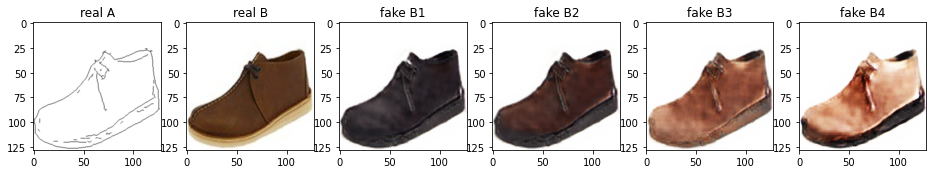

Train Epoch: 2 40% 	Total Loss: 5.975779 	Loss_GAN: 3.971304	Loss_GAN_VAE: 1.259451	Loss_GAN_LR: 1.111171	Loss_D_VAE: 1.008887	Loss_D_LR: 0.995588
1 69509 T:  3.2045881748199463
Train Epoch: 2 40% 	Total Loss: 5.884927 	Loss_GAN: 3.634699	Loss_GAN_VAE: 1.353080	Loss_GAN_LR: 0.892051	Loss_D_VAE: 1.097960	Loss_D_LR: 1.152268
1 69519 T:  2.494194984436035
Train Epoch: 2 40% 	Total Loss: 5.598936 	Loss_GAN: 3.400547	Loss_GAN_VAE: 1.127749	Loss_GAN_LR: 1.058875	Loss_D_VAE: 1.091127	Loss_D_LR: 1.107262
1 69529 T:  2.4941232204437256
Train Epoch: 2 40% 	Total Loss: 6.239383 	Loss_GAN: 4.105208	Loss_GAN_VAE: 1.234186	Loss_GAN_LR: 1.305321	Loss_D_VAE: 0.993956	Loss_D_LR: 1.140219
1 69539 T:  2.53210186958313
Train Epoch: 2 40% 	Total Loss: 6.105374 	Loss_GAN: 4.161690	Loss_GAN_VAE: 1.150460	Loss_GAN_LR: 1.165415	Loss_D_VAE: 0.968078	Loss_D_LR: 0.975606
1 69549 T:  2.5184273719787598
Train Epoch: 2 40% 	Total Loss: 5.177629 	Loss_GAN: 2.369767	Loss_GAN_VAE: 0.941466	Loss_GAN_LR: 0.683816	Loss_D_

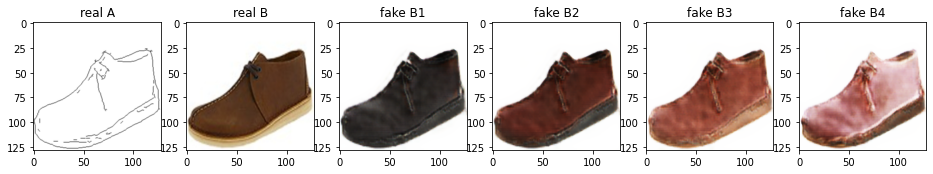

Train Epoch: 2 41% 	Total Loss: 5.917881 	Loss_GAN: 3.705717	Loss_GAN_VAE: 1.242151	Loss_GAN_LR: 1.040846	Loss_D_VAE: 0.996437	Loss_D_LR: 1.215728
1 70009 T:  4.263604402542114
Train Epoch: 2 41% 	Total Loss: 6.061799 	Loss_GAN: 4.098867	Loss_GAN_VAE: 1.279748	Loss_GAN_LR: 1.178056	Loss_D_VAE: 0.888302	Loss_D_LR: 1.074630
1 70019 T:  2.5807790756225586
Train Epoch: 2 41% 	Total Loss: 5.958205 	Loss_GAN: 3.650305	Loss_GAN_VAE: 1.403513	Loss_GAN_LR: 0.940091	Loss_D_VAE: 1.051462	Loss_D_LR: 1.256438
1 70029 T:  2.504805326461792
Train Epoch: 2 41% 	Total Loss: 5.803564 	Loss_GAN: 3.547698	Loss_GAN_VAE: 1.268755	Loss_GAN_LR: 1.109653	Loss_D_VAE: 0.993198	Loss_D_LR: 1.262668
1 70039 T:  2.849169969558716
Train Epoch: 2 41% 	Total Loss: 6.015902 	Loss_GAN: 3.919261	Loss_GAN_VAE: 1.349252	Loss_GAN_LR: 0.951773	Loss_D_VAE: 0.978481	Loss_D_LR: 1.118160
1 70049 T:  2.5393760204315186
Train Epoch: 2 41% 	Total Loss: 6.082971 	Loss_GAN: 3.564374	Loss_GAN_VAE: 1.235080	Loss_GAN_LR: 0.984496	Loss_D_

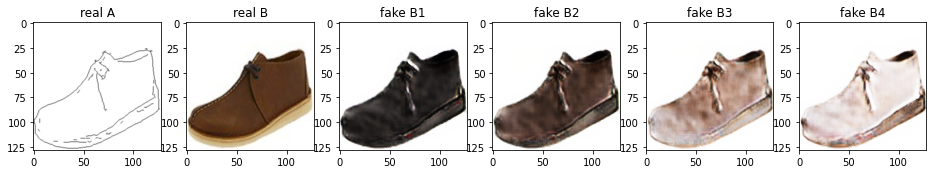

Train Epoch: 2 42% 	Total Loss: 6.227959 	Loss_GAN: 3.505771	Loss_GAN_VAE: 1.128329	Loss_GAN_LR: 0.965929	Loss_D_VAE: 1.366684	Loss_D_LR: 1.355504
1 70509 T:  3.215808629989624
Train Epoch: 2 42% 	Total Loss: 6.065621 	Loss_GAN: 3.809272	Loss_GAN_VAE: 1.190839	Loss_GAN_LR: 0.920695	Loss_D_VAE: 1.069348	Loss_D_LR: 1.187001
1 70519 T:  2.5238382816314697
Train Epoch: 2 42% 	Total Loss: 5.702384 	Loss_GAN: 3.830034	Loss_GAN_VAE: 1.267894	Loss_GAN_LR: 1.188765	Loss_D_VAE: 0.907497	Loss_D_LR: 0.964853
1 70529 T:  2.5367074012756348
Train Epoch: 2 42% 	Total Loss: 5.584877 	Loss_GAN: 3.261236	Loss_GAN_VAE: 1.101727	Loss_GAN_LR: 0.965394	Loss_D_VAE: 1.022281	Loss_D_LR: 1.301361
1 70539 T:  2.515568256378174
Train Epoch: 2 42% 	Total Loss: 6.161085 	Loss_GAN: 4.033672	Loss_GAN_VAE: 1.482463	Loss_GAN_LR: 1.105875	Loss_D_VAE: 0.882640	Loss_D_LR: 1.244773
1 70549 T:  2.556365966796875
Train Epoch: 2 42% 	Total Loss: 6.133546 	Loss_GAN: 3.998092	Loss_GAN_VAE: 1.370468	Loss_GAN_LR: 1.148553	Loss_D_

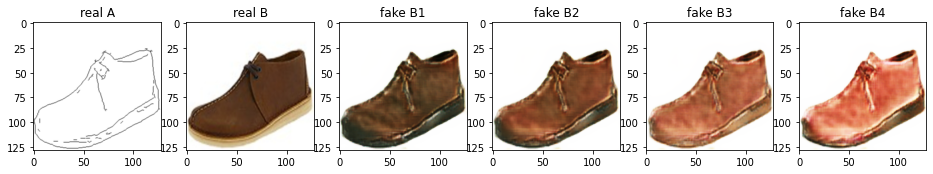

Train Epoch: 2 43% 	Total Loss: 5.768217 	Loss_GAN: 3.920176	Loss_GAN_VAE: 1.220475	Loss_GAN_LR: 1.198556	Loss_D_VAE: 0.830685	Loss_D_LR: 1.017356
1 71009 T:  3.9506914615631104
Train Epoch: 2 43% 	Total Loss: 5.756306 	Loss_GAN: 3.353129	Loss_GAN_VAE: 1.229114	Loss_GAN_LR: 1.004881	Loss_D_VAE: 1.292400	Loss_D_LR: 1.110778
1 71019 T:  2.4910547733306885
Train Epoch: 2 43% 	Total Loss: 5.812323 	Loss_GAN: 3.446164	Loss_GAN_VAE: 0.889588	Loss_GAN_LR: 1.281311	Loss_D_VAE: 1.469913	Loss_D_LR: 0.896246
1 71029 T:  2.538045883178711
Train Epoch: 2 43% 	Total Loss: 6.497991 	Loss_GAN: 4.635384	Loss_GAN_VAE: 1.502208	Loss_GAN_LR: 1.651067	Loss_D_VAE: 0.897584	Loss_D_LR: 0.965023
1 71039 T:  2.8214111328125
Train Epoch: 2 43% 	Total Loss: 5.647469 	Loss_GAN: 3.838738	Loss_GAN_VAE: 1.378420	Loss_GAN_LR: 1.140563	Loss_D_VAE: 0.867893	Loss_D_LR: 0.940838
1 71049 T:  2.5167908668518066
Train Epoch: 2 43% 	Total Loss: 5.958730 	Loss_GAN: 4.073330	Loss_GAN_VAE: 1.489561	Loss_GAN_LR: 1.143063	Loss_D_V

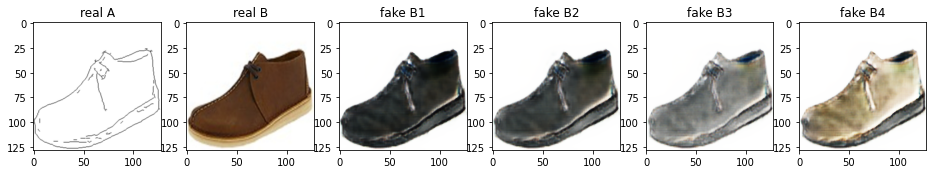

Train Epoch: 2 44% 	Total Loss: 6.162583 	Loss_GAN: 3.455179	Loss_GAN_VAE: 1.197099	Loss_GAN_LR: 1.079607	Loss_D_VAE: 1.182376	Loss_D_LR: 1.525029
1 71509 T:  3.1901841163635254
Train Epoch: 2 44% 	Total Loss: 6.675427 	Loss_GAN: 4.676964	Loss_GAN_VAE: 1.574677	Loss_GAN_LR: 1.158010	Loss_D_VAE: 0.800358	Loss_D_LR: 1.198105
1 71519 T:  2.6164379119873047
Train Epoch: 2 44% 	Total Loss: 6.002540 	Loss_GAN: 3.627967	Loss_GAN_VAE: 1.277712	Loss_GAN_LR: 1.087011	Loss_D_VAE: 1.152490	Loss_D_LR: 1.222083
1 71529 T:  2.504258632659912
Train Epoch: 2 44% 	Total Loss: 6.279414 	Loss_GAN: 4.529800	Loss_GAN_VAE: 1.554111	Loss_GAN_LR: 1.312160	Loss_D_VAE: 0.688944	Loss_D_LR: 1.060671
1 71539 T:  2.4870717525482178
Train Epoch: 2 44% 	Total Loss: 5.944863 	Loss_GAN: 4.176361	Loss_GAN_VAE: 1.396142	Loss_GAN_LR: 1.302923	Loss_D_VAE: 0.661193	Loss_D_LR: 1.107308
1 71549 T:  2.523979425430298
Train Epoch: 2 44% 	Total Loss: 6.001397 	Loss_GAN: 4.291369	Loss_GAN_VAE: 1.513629	Loss_GAN_LR: 1.336055	Loss_D

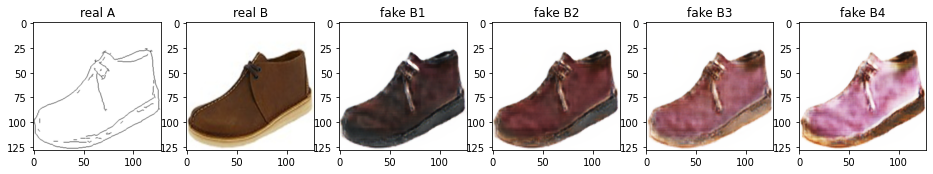

Train Epoch: 2 45% 	Total Loss: 6.873274 	Loss_GAN: 4.760618	Loss_GAN_VAE: 1.675107	Loss_GAN_LR: 1.463326	Loss_D_VAE: 0.954904	Loss_D_LR: 1.157752
1 72009 T:  3.9361534118652344
Train Epoch: 2 45% 	Total Loss: 5.772518 	Loss_GAN: 4.066525	Loss_GAN_VAE: 1.492400	Loss_GAN_LR: 1.107988	Loss_D_VAE: 0.637021	Loss_D_LR: 1.068972
1 72019 T:  2.5181872844696045
Train Epoch: 2 45% 	Total Loss: 6.111952 	Loss_GAN: 4.193212	Loss_GAN_VAE: 1.606449	Loss_GAN_LR: 1.177759	Loss_D_VAE: 0.673445	Loss_D_LR: 1.245295
1 72029 T:  2.5666871070861816
Train Epoch: 2 45% 	Total Loss: 5.991344 	Loss_GAN: 3.271270	Loss_GAN_VAE: 1.317336	Loss_GAN_LR: 0.893838	Loss_D_VAE: 1.024429	Loss_D_LR: 1.695645
1 72039 T:  2.8197171688079834
Train Epoch: 2 45% 	Total Loss: 5.789274 	Loss_GAN: 3.559982	Loss_GAN_VAE: 1.284658	Loss_GAN_LR: 0.946641	Loss_D_VAE: 0.931963	Loss_D_LR: 1.297329
1 72049 T:  2.5800185203552246
Train Epoch: 2 45% 	Total Loss: 5.652066 	Loss_GAN: 3.046950	Loss_GAN_VAE: 1.186883	Loss_GAN_LR: 0.890262	Loss

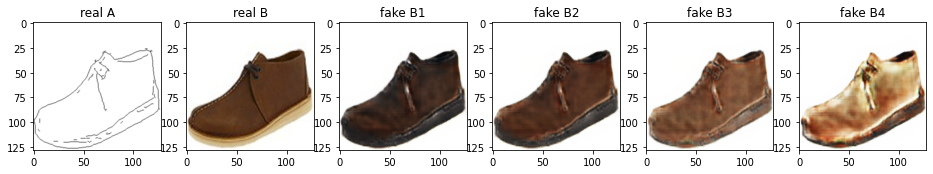

Train Epoch: 2 46% 	Total Loss: 6.233136 	Loss_GAN: 3.832734	Loss_GAN_VAE: 1.645851	Loss_GAN_LR: 1.049397	Loss_D_VAE: 1.155832	Loss_D_LR: 1.244569
1 72509 T:  3.199375867843628
Train Epoch: 2 46% 	Total Loss: 5.997585 	Loss_GAN: 4.330302	Loss_GAN_VAE: 1.612092	Loss_GAN_LR: 1.245884	Loss_D_VAE: 0.684111	Loss_D_LR: 0.983171
1 72519 T:  2.524853229522705
Train Epoch: 2 46% 	Total Loss: 5.950960 	Loss_GAN: 3.963984	Loss_GAN_VAE: 1.603529	Loss_GAN_LR: 1.030402	Loss_D_VAE: 0.860790	Loss_D_LR: 1.126185
1 72529 T:  2.597073554992676
Train Epoch: 2 46% 	Total Loss: 5.781466 	Loss_GAN: 3.841322	Loss_GAN_VAE: 1.421988	Loss_GAN_LR: 1.131580	Loss_D_VAE: 0.849605	Loss_D_LR: 1.090539
1 72539 T:  2.552872657775879
Train Epoch: 2 46% 	Total Loss: 5.558400 	Loss_GAN: 3.594878	Loss_GAN_VAE: 1.583860	Loss_GAN_LR: 0.875590	Loss_D_VAE: 0.782962	Loss_D_LR: 1.180560
1 72549 T:  2.503262758255005
Train Epoch: 2 46% 	Total Loss: 6.152547 	Loss_GAN: 3.770294	Loss_GAN_VAE: 1.438515	Loss_GAN_LR: 1.159732	Loss_D_VA

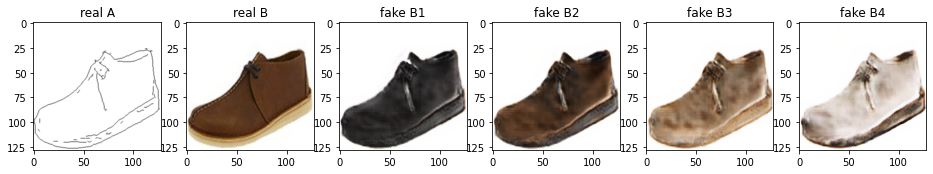

Train Epoch: 2 47% 	Total Loss: 6.017718 	Loss_GAN: 4.028342	Loss_GAN_VAE: 1.522928	Loss_GAN_LR: 1.307783	Loss_D_VAE: 0.994842	Loss_D_LR: 0.994535
1 73009 T:  4.204046964645386
Train Epoch: 2 47% 	Total Loss: 5.523156 	Loss_GAN: 3.519872	Loss_GAN_VAE: 1.251418	Loss_GAN_LR: 1.100517	Loss_D_VAE: 1.035243	Loss_D_LR: 0.968042
1 73019 T:  2.5051000118255615
Train Epoch: 2 47% 	Total Loss: 5.855711 	Loss_GAN: 3.740228	Loss_GAN_VAE: 1.315152	Loss_GAN_LR: 1.013874	Loss_D_VAE: 0.792969	Loss_D_LR: 1.322515
1 73029 T:  2.543447494506836
Train Epoch: 2 47% 	Total Loss: 6.303492 	Loss_GAN: 4.069004	Loss_GAN_VAE: 1.477521	Loss_GAN_LR: 0.898582	Loss_D_VAE: 0.928110	Loss_D_LR: 1.306378
1 73039 T:  2.890812635421753
Train Epoch: 2 47% 	Total Loss: 6.460668 	Loss_GAN: 4.799447	Loss_GAN_VAE: 1.882179	Loss_GAN_LR: 1.262900	Loss_D_VAE: 0.876465	Loss_D_LR: 0.784757
1 73049 T:  2.5287435054779053
Train Epoch: 2 47% 	Total Loss: 6.624776 	Loss_GAN: 4.517374	Loss_GAN_VAE: 1.724705	Loss_GAN_LR: 1.053589	Loss_D_

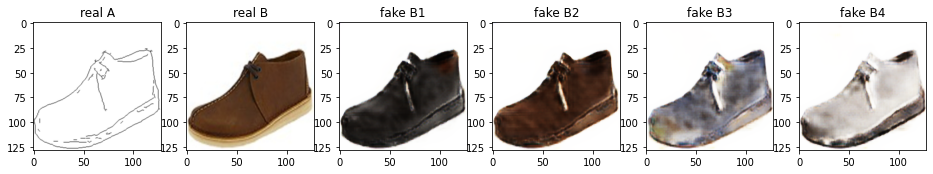

Train Epoch: 2 48% 	Total Loss: 5.905286 	Loss_GAN: 4.257787	Loss_GAN_VAE: 1.677778	Loss_GAN_LR: 1.213952	Loss_D_VAE: 0.582527	Loss_D_LR: 1.064971
1 73509 T:  3.2374322414398193
Train Epoch: 2 48% 	Total Loss: 6.034718 	Loss_GAN: 4.029346	Loss_GAN_VAE: 1.537125	Loss_GAN_LR: 1.081050	Loss_D_VAE: 0.763776	Loss_D_LR: 1.241596
1 73519 T:  2.502946376800537
Train Epoch: 2 48% 	Total Loss: 6.745745 	Loss_GAN: 4.832528	Loss_GAN_VAE: 1.737753	Loss_GAN_LR: 1.351908	Loss_D_VAE: 0.842116	Loss_D_LR: 1.071101
1 73529 T:  2.560272455215454
Train Epoch: 2 48% 	Total Loss: 6.401960 	Loss_GAN: 4.006690	Loss_GAN_VAE: 1.387394	Loss_GAN_LR: 0.972286	Loss_D_VAE: 1.070899	Loss_D_LR: 1.324371
1 73539 T:  2.473177194595337
Train Epoch: 2 48% 	Total Loss: 5.541237 	Loss_GAN: 3.677121	Loss_GAN_VAE: 1.687237	Loss_GAN_LR: 0.942093	Loss_D_VAE: 0.545286	Loss_D_LR: 1.318830
1 73549 T:  2.5138535499572754
Train Epoch: 2 48% 	Total Loss: 7.014842 	Loss_GAN: 5.183798	Loss_GAN_VAE: 2.070855	Loss_GAN_LR: 1.424161	Loss_D_

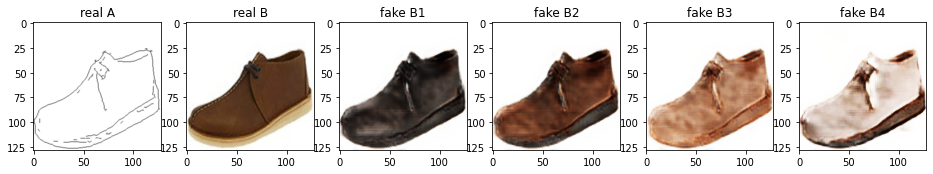

Train Epoch: 2 49% 	Total Loss: 6.013243 	Loss_GAN: 4.249475	Loss_GAN_VAE: 1.912423	Loss_GAN_LR: 1.182510	Loss_D_VAE: 0.634170	Loss_D_LR: 1.129597
1 74009 T:  3.9599735736846924
Train Epoch: 2 49% 	Total Loss: 5.709824 	Loss_GAN: 3.105868	Loss_GAN_VAE: 1.243486	Loss_GAN_LR: 0.867147	Loss_D_VAE: 1.107309	Loss_D_LR: 1.496647
1 74019 T:  2.5365610122680664
Train Epoch: 2 49% 	Total Loss: 5.865812 	Loss_GAN: 3.813922	Loss_GAN_VAE: 1.470610	Loss_GAN_LR: 0.987635	Loss_D_VAE: 0.879966	Loss_D_LR: 1.171924
1 74029 T:  2.4767744541168213
Train Epoch: 2 49% 	Total Loss: 6.028007 	Loss_GAN: 4.234254	Loss_GAN_VAE: 1.806925	Loss_GAN_LR: 0.972923	Loss_D_VAE: 0.721415	Loss_D_LR: 1.072338
1 74039 T:  2.816333532333374
Train Epoch: 2 49% 	Total Loss: 6.344513 	Loss_GAN: 4.372545	Loss_GAN_VAE: 1.628172	Loss_GAN_LR: 1.266158	Loss_D_VAE: 0.954875	Loss_D_LR: 1.017093
1 74049 T:  2.5610570907592773
Train Epoch: 2 49% 	Total Loss: 6.070947 	Loss_GAN: 4.222718	Loss_GAN_VAE: 1.728348	Loss_GAN_LR: 1.179997	Loss_

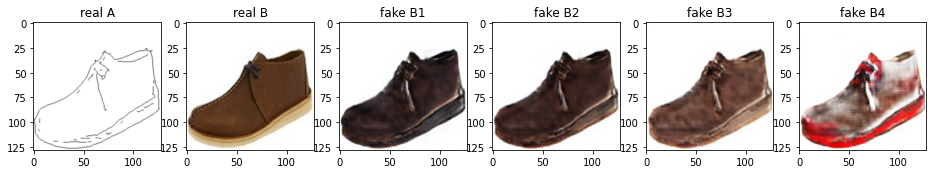

Train Epoch: 2 50% 	Total Loss: 6.785012 	Loss_GAN: 4.654812	Loss_GAN_VAE: 1.687044	Loss_GAN_LR: 1.362271	Loss_D_VAE: 0.871911	Loss_D_LR: 1.258289
1 74509 T:  3.2185709476470947
Train Epoch: 2 50% 	Total Loss: 6.286733 	Loss_GAN: 4.447649	Loss_GAN_VAE: 1.844836	Loss_GAN_LR: 1.153417	Loss_D_VAE: 0.836995	Loss_D_LR: 1.002089
1 74519 T:  2.4789111614227295
Train Epoch: 2 50% 	Total Loss: 6.106058 	Loss_GAN: 4.091826	Loss_GAN_VAE: 1.456437	Loss_GAN_LR: 1.079370	Loss_D_VAE: 0.893650	Loss_D_LR: 1.120582
1 74529 T:  2.5139474868774414
Train Epoch: 2 50% 	Total Loss: 6.045362 	Loss_GAN: 3.997007	Loss_GAN_VAE: 1.712945	Loss_GAN_LR: 1.040170	Loss_D_VAE: 0.744827	Loss_D_LR: 1.303529
1 74539 T:  2.559319019317627
Train Epoch: 2 50% 	Total Loss: 6.407989 	Loss_GAN: 4.323306	Loss_GAN_VAE: 1.692509	Loss_GAN_LR: 0.943681	Loss_D_VAE: 0.880504	Loss_D_LR: 1.204179
1 74549 T:  2.483128786087036
Train Epoch: 2 50% 	Total Loss: 6.391885 	Loss_GAN: 4.610994	Loss_GAN_VAE: 2.019810	Loss_GAN_LR: 1.056928	Loss_D

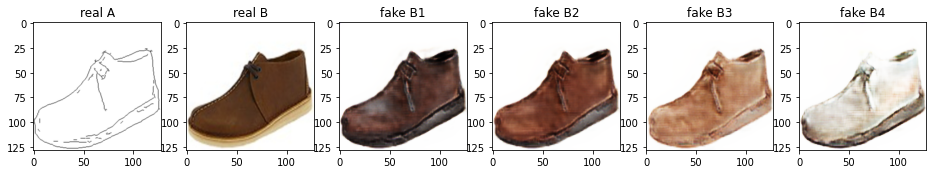

Train Epoch: 2 51% 	Total Loss: 5.818431 	Loss_GAN: 4.096803	Loss_GAN_VAE: 1.541058	Loss_GAN_LR: 1.261553	Loss_D_VAE: 0.771310	Loss_D_LR: 0.950318
1 75009 T:  3.987797975540161
Train Epoch: 2 51% 	Total Loss: 7.154691 	Loss_GAN: 5.068572	Loss_GAN_VAE: 1.927738	Loss_GAN_LR: 1.335981	Loss_D_VAE: 1.180323	Loss_D_LR: 0.905795
1 75019 T:  2.568145513534546
Train Epoch: 2 51% 	Total Loss: 6.383900 	Loss_GAN: 4.609251	Loss_GAN_VAE: 2.042881	Loss_GAN_LR: 1.166040	Loss_D_VAE: 0.719979	Loss_D_LR: 1.054670
1 75029 T:  2.6151132583618164
Train Epoch: 2 51% 	Total Loss: 6.099976 	Loss_GAN: 4.532983	Loss_GAN_VAE: 1.903890	Loss_GAN_LR: 1.152636	Loss_D_VAE: 0.641490	Loss_D_LR: 0.925502
1 75039 T:  2.9086897373199463
Train Epoch: 2 51% 	Total Loss: 6.855007 	Loss_GAN: 4.943622	Loss_GAN_VAE: 1.753962	Loss_GAN_LR: 1.467773	Loss_D_VAE: 0.861788	Loss_D_LR: 1.049597
1 75049 T:  2.533379316329956
Train Epoch: 2 51% 	Total Loss: 6.287267 	Loss_GAN: 4.006834	Loss_GAN_VAE: 1.810948	Loss_GAN_LR: 0.965250	Loss_D_

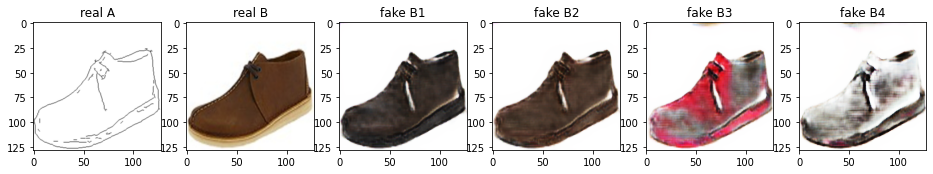

Train Epoch: 2 52% 	Total Loss: 6.513864 	Loss_GAN: 4.119063	Loss_GAN_VAE: 1.441560	Loss_GAN_LR: 1.043408	Loss_D_VAE: 1.067281	Loss_D_LR: 1.327520
1 75509 T:  3.2506539821624756
Train Epoch: 2 52% 	Total Loss: 6.464207 	Loss_GAN: 4.770332	Loss_GAN_VAE: 1.940959	Loss_GAN_LR: 1.313790	Loss_D_VAE: 0.711735	Loss_D_LR: 0.982140
1 75519 T:  2.478078603744507
Train Epoch: 2 52% 	Total Loss: 6.241713 	Loss_GAN: 3.996244	Loss_GAN_VAE: 1.800517	Loss_GAN_LR: 0.944371	Loss_D_VAE: 0.830580	Loss_D_LR: 1.414888
1 75529 T:  2.504559278488159
Train Epoch: 2 52% 	Total Loss: 6.055483 	Loss_GAN: 3.980850	Loss_GAN_VAE: 1.464135	Loss_GAN_LR: 1.141871	Loss_D_VAE: 0.856430	Loss_D_LR: 1.218203
1 75539 T:  2.5268239974975586
Train Epoch: 2 52% 	Total Loss: 6.403463 	Loss_GAN: 4.641125	Loss_GAN_VAE: 1.866008	Loss_GAN_LR: 1.305278	Loss_D_VAE: 0.890827	Loss_D_LR: 0.871511
1 75549 T:  2.4551689624786377
Train Epoch: 2 52% 	Total Loss: 6.032721 	Loss_GAN: 3.751388	Loss_GAN_VAE: 1.305378	Loss_GAN_LR: 1.153175	Loss_D

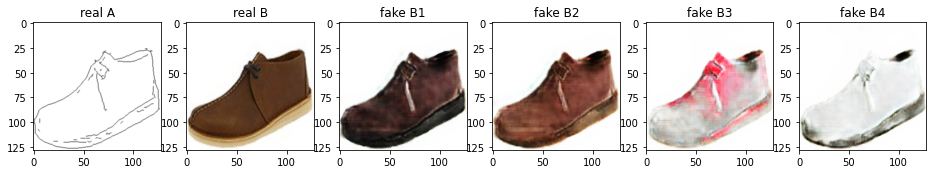

Train Epoch: 2 53% 	Total Loss: 6.361164 	Loss_GAN: 4.035512	Loss_GAN_VAE: 1.581840	Loss_GAN_LR: 0.847772	Loss_D_VAE: 0.870853	Loss_D_LR: 1.454800
1 76009 T:  4.244577407836914
Train Epoch: 2 53% 	Total Loss: 5.743978 	Loss_GAN: 3.769083	Loss_GAN_VAE: 1.493146	Loss_GAN_LR: 0.926279	Loss_D_VAE: 0.747783	Loss_D_LR: 1.227112
1 76019 T:  2.5557374954223633
Train Epoch: 2 53% 	Total Loss: 6.469137 	Loss_GAN: 4.592797	Loss_GAN_VAE: 1.737217	Loss_GAN_LR: 1.248936	Loss_D_VAE: 0.548126	Loss_D_LR: 1.328214
1 76029 T:  2.4867351055145264
Train Epoch: 2 53% 	Total Loss: 6.280260 	Loss_GAN: 3.980609	Loss_GAN_VAE: 1.896693	Loss_GAN_LR: 0.952840	Loss_D_VAE: 0.878348	Loss_D_LR: 1.421303
1 76039 T:  2.806835889816284
Train Epoch: 2 53% 	Total Loss: 5.990712 	Loss_GAN: 4.367933	Loss_GAN_VAE: 1.788173	Loss_GAN_LR: 1.199597	Loss_D_VAE: 0.725999	Loss_D_LR: 0.896780
1 76049 T:  2.4869167804718018
Train Epoch: 2 53% 	Total Loss: 6.063568 	Loss_GAN: 3.910818	Loss_GAN_VAE: 1.691060	Loss_GAN_LR: 1.062470	Loss_D

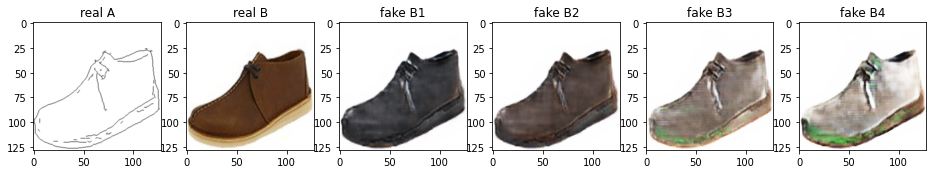

Train Epoch: 2 54% 	Total Loss: 6.105494 	Loss_GAN: 4.402204	Loss_GAN_VAE: 1.730637	Loss_GAN_LR: 1.498279	Loss_D_VAE: 0.839172	Loss_D_LR: 0.864118
1 76509 T:  3.1670327186584473
Train Epoch: 2 54% 	Total Loss: 6.278710 	Loss_GAN: 5.108267	Loss_GAN_VAE: 2.153708	Loss_GAN_LR: 1.681847	Loss_D_VAE: 0.493548	Loss_D_LR: 0.676894
1 76519 T:  2.5169718265533447
Train Epoch: 2 54% 	Total Loss: 6.146508 	Loss_GAN: 4.226528	Loss_GAN_VAE: 1.834735	Loss_GAN_LR: 1.088520	Loss_D_VAE: 0.696598	Loss_D_LR: 1.223381
1 76529 T:  2.560729503631592
Train Epoch: 2 54% 	Total Loss: 5.854783 	Loss_GAN: 4.345796	Loss_GAN_VAE: 1.647774	Loss_GAN_LR: 1.373119	Loss_D_VAE: 0.694949	Loss_D_LR: 0.814038
1 76539 T:  2.4385712146759033
Train Epoch: 2 54% 	Total Loss: 6.076667 	Loss_GAN: 3.384888	Loss_GAN_VAE: 1.687992	Loss_GAN_LR: 0.707255	Loss_D_VAE: 0.943060	Loss_D_LR: 1.748719
1 76549 T:  2.5278844833374023
Train Epoch: 2 54% 	Total Loss: 5.785225 	Loss_GAN: 3.697107	Loss_GAN_VAE: 1.579110	Loss_GAN_LR: 1.047001	Loss_

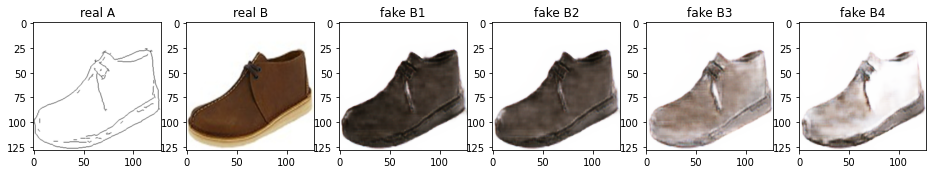

Train Epoch: 2 55% 	Total Loss: 6.488503 	Loss_GAN: 5.116597	Loss_GAN_VAE: 2.251833	Loss_GAN_LR: 1.530847	Loss_D_VAE: 0.576074	Loss_D_LR: 0.795832
1 77009 T:  4.0150465965271
Train Epoch: 2 55% 	Total Loss: 7.018838 	Loss_GAN: 4.895208	Loss_GAN_VAE: 2.158518	Loss_GAN_LR: 1.055128	Loss_D_VAE: 1.025853	Loss_D_LR: 1.097778
1 77019 T:  2.6004767417907715
Train Epoch: 2 55% 	Total Loss: 6.649476 	Loss_GAN: 5.289736	Loss_GAN_VAE: 1.959208	Loss_GAN_LR: 1.998279	Loss_D_VAE: 0.674738	Loss_D_LR: 0.685002
1 77029 T:  2.5680947303771973
Train Epoch: 2 55% 	Total Loss: 6.771795 	Loss_GAN: 5.195064	Loss_GAN_VAE: 1.950181	Loss_GAN_LR: 1.806372	Loss_D_VAE: 0.770215	Loss_D_LR: 0.806515
1 77039 T:  2.8170599937438965
Train Epoch: 2 55% 	Total Loss: 5.948288 	Loss_GAN: 4.663248	Loss_GAN_VAE: 1.872058	Loss_GAN_LR: 1.385821	Loss_D_VAE: 0.559889	Loss_D_LR: 0.725152
1 77049 T:  2.500730514526367
Train Epoch: 2 55% 	Total Loss: 8.426618 	Loss_GAN: 6.646298	Loss_GAN_VAE: 2.959968	Loss_GAN_LR: 1.825485	Loss_D_V

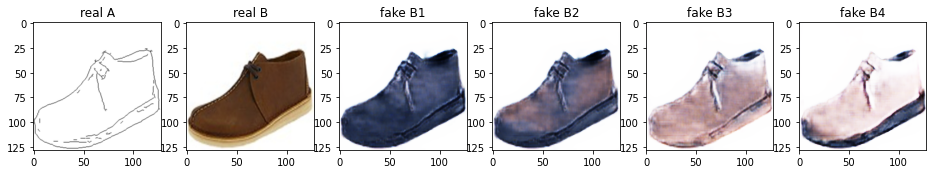

Train Epoch: 2 56% 	Total Loss: 7.960812 	Loss_GAN: 6.288288	Loss_GAN_VAE: 2.408453	Loss_GAN_LR: 2.374522	Loss_D_VAE: 0.717375	Loss_D_LR: 0.955149
1 77509 T:  3.2328760623931885
Train Epoch: 2 56% 	Total Loss: 8.306848 	Loss_GAN: 7.594545	Loss_GAN_VAE: 3.207014	Loss_GAN_LR: 2.852543	Loss_D_VAE: 0.218663	Loss_D_LR: 0.493640
1 77519 T:  2.531191349029541
Train Epoch: 2 56% 	Total Loss: 7.014273 	Loss_GAN: 4.665898	Loss_GAN_VAE: 1.957001	Loss_GAN_LR: 1.573840	Loss_D_VAE: 1.401098	Loss_D_LR: 0.947277
1 77529 T:  2.500176429748535
Train Epoch: 2 56% 	Total Loss: 6.441944 	Loss_GAN: 4.724236	Loss_GAN_VAE: 1.957135	Loss_GAN_LR: 1.158072	Loss_D_VAE: 0.451597	Loss_D_LR: 1.266111
1 77539 T:  2.548678159713745
Train Epoch: 2 56% 	Total Loss: 5.422881 	Loss_GAN: 3.604777	Loss_GAN_VAE: 1.463257	Loss_GAN_LR: 1.150001	Loss_D_VAE: 0.790527	Loss_D_LR: 1.027577
1 77549 T:  2.5464625358581543
Train Epoch: 2 56% 	Total Loss: 6.398355 	Loss_GAN: 4.436433	Loss_GAN_VAE: 1.970050	Loss_GAN_LR: 1.113282	Loss_D_

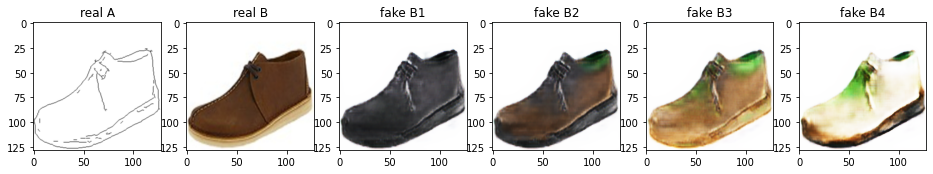

Train Epoch: 2 57% 	Total Loss: 6.864039 	Loss_GAN: 5.423653	Loss_GAN_VAE: 2.119834	Loss_GAN_LR: 1.726713	Loss_D_VAE: 0.470082	Loss_D_LR: 0.970303
1 78009 T:  3.9558606147766113
Train Epoch: 2 57% 	Total Loss: 6.459837 	Loss_GAN: 5.222234	Loss_GAN_VAE: 2.089743	Loss_GAN_LR: 1.515823	Loss_D_VAE: 0.531550	Loss_D_LR: 0.706053
1 78019 T:  2.5170013904571533
Train Epoch: 2 57% 	Total Loss: 6.505802 	Loss_GAN: 4.301025	Loss_GAN_VAE: 1.826141	Loss_GAN_LR: 1.165123	Loss_D_VAE: 0.969563	Loss_D_LR: 1.235214
1 78029 T:  2.558734655380249
Train Epoch: 2 57% 	Total Loss: 6.547938 	Loss_GAN: 4.473115	Loss_GAN_VAE: 1.765194	Loss_GAN_LR: 1.323647	Loss_D_VAE: 1.104302	Loss_D_LR: 0.970521
1 78039 T:  2.8273770809173584
Train Epoch: 2 57% 	Total Loss: 7.238222 	Loss_GAN: 4.648674	Loss_GAN_VAE: 2.375640	Loss_GAN_LR: 1.110534	Loss_D_VAE: 1.362433	Loss_D_LR: 1.227115
1 78049 T:  2.5745105743408203
Train Epoch: 2 57% 	Total Loss: 6.150149 	Loss_GAN: 4.123241	Loss_GAN_VAE: 1.389753	Loss_GAN_LR: 1.235756	Loss_

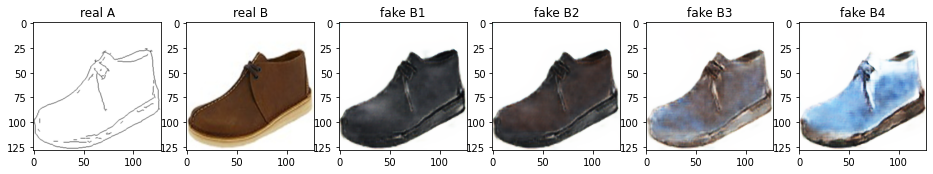

Train Epoch: 2 58% 	Total Loss: 6.574097 	Loss_GAN: 4.582952	Loss_GAN_VAE: 1.921847	Loss_GAN_LR: 1.087547	Loss_D_VAE: 0.812011	Loss_D_LR: 1.179135
1 78509 T:  3.242004632949829
Train Epoch: 2 58% 	Total Loss: 6.498307 	Loss_GAN: 5.367934	Loss_GAN_VAE: 2.262241	Loss_GAN_LR: 1.505841	Loss_D_VAE: 0.418550	Loss_D_LR: 0.711823
1 78519 T:  2.550842523574829
Train Epoch: 2 58% 	Total Loss: 6.835544 	Loss_GAN: 5.028644	Loss_GAN_VAE: 2.325839	Loss_GAN_LR: 1.177826	Loss_D_VAE: 0.576850	Loss_D_LR: 1.230050
1 78529 T:  2.523942232131958
Train Epoch: 2 58% 	Total Loss: 7.646102 	Loss_GAN: 5.756201	Loss_GAN_VAE: 2.712248	Loss_GAN_LR: 1.442456	Loss_D_VAE: 0.952496	Loss_D_LR: 0.937405
1 78539 T:  2.5095086097717285
Train Epoch: 2 58% 	Total Loss: 6.910889 	Loss_GAN: 4.936211	Loss_GAN_VAE: 2.009889	Loss_GAN_LR: 1.340471	Loss_D_VAE: 0.928106	Loss_D_LR: 1.046572
1 78549 T:  2.52787709236145
Train Epoch: 2 58% 	Total Loss: 6.569420 	Loss_GAN: 4.950953	Loss_GAN_VAE: 1.984698	Loss_GAN_LR: 1.278749	Loss_D_VA

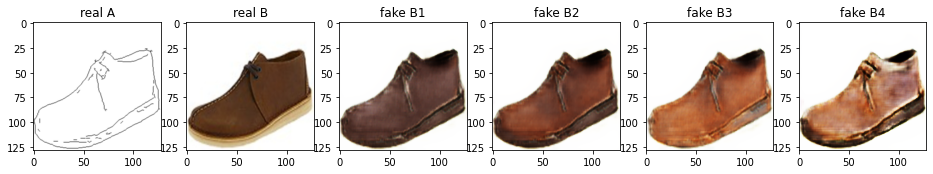

Train Epoch: 2 59% 	Total Loss: 7.165079 	Loss_GAN: 5.184051	Loss_GAN_VAE: 2.170605	Loss_GAN_LR: 1.533789	Loss_D_VAE: 0.735496	Loss_D_LR: 1.245532
1 79009 T:  4.412641286849976
Train Epoch: 2 59% 	Total Loss: 6.672337 	Loss_GAN: 5.342486	Loss_GAN_VAE: 2.258166	Loss_GAN_LR: 1.738388	Loss_D_VAE: 0.465224	Loss_D_LR: 0.864628
1 79019 T:  2.502790689468384
Train Epoch: 2 59% 	Total Loss: 7.000243 	Loss_GAN: 5.290386	Loss_GAN_VAE: 1.997482	Loss_GAN_LR: 1.539987	Loss_D_VAE: 0.697579	Loss_D_LR: 1.012279
1 79029 T:  2.630429983139038
Train Epoch: 2 59% 	Total Loss: 7.020754 	Loss_GAN: 5.131549	Loss_GAN_VAE: 2.211603	Loss_GAN_LR: 1.192170	Loss_D_VAE: 0.702497	Loss_D_LR: 1.186708
1 79039 T:  2.8481431007385254
Train Epoch: 2 59% 	Total Loss: 7.000564 	Loss_GAN: 5.325403	Loss_GAN_VAE: 2.420853	Loss_GAN_LR: 1.257953	Loss_D_VAE: 0.526228	Loss_D_LR: 1.148933
1 79049 T:  2.584049701690674
Train Epoch: 2 59% 	Total Loss: 6.389146 	Loss_GAN: 4.068311	Loss_GAN_VAE: 1.789147	Loss_GAN_LR: 1.174373	Loss_D_V

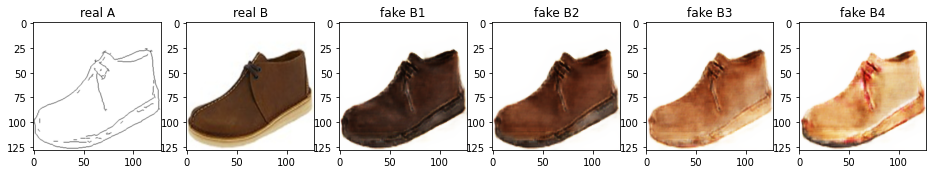

Train Epoch: 2 60% 	Total Loss: 7.113401 	Loss_GAN: 5.508582	Loss_GAN_VAE: 1.995063	Loss_GAN_LR: 1.823362	Loss_D_VAE: 0.780689	Loss_D_LR: 0.824130
1 79509 T:  3.2465004920959473
Train Epoch: 2 60% 	Total Loss: 7.367720 	Loss_GAN: 6.063548	Loss_GAN_VAE: 2.478445	Loss_GAN_LR: 1.986379	Loss_D_VAE: 0.675680	Loss_D_LR: 0.628492
1 79519 T:  2.577052354812622
Train Epoch: 2 60% 	Total Loss: 8.129106 	Loss_GAN: 5.354147	Loss_GAN_VAE: 2.674141	Loss_GAN_LR: 1.336673	Loss_D_VAE: 1.175077	Loss_D_LR: 1.599882
1 79529 T:  2.444009780883789
Train Epoch: 2 60% 	Total Loss: 6.593137 	Loss_GAN: 4.609162	Loss_GAN_VAE: 1.540644	Loss_GAN_LR: 1.273219	Loss_D_VAE: 1.002803	Loss_D_LR: 0.981172
1 79539 T:  2.4927594661712646
Train Epoch: 2 60% 	Total Loss: 6.534761 	Loss_GAN: 5.143802	Loss_GAN_VAE: 1.621249	Loss_GAN_LR: 1.972248	Loss_D_VAE: 0.662616	Loss_D_LR: 0.728343
1 79549 T:  2.5319459438323975
Train Epoch: 2 60% 	Total Loss: 6.101270 	Loss_GAN: 4.326709	Loss_GAN_VAE: 2.006038	Loss_GAN_LR: 1.149688	Loss_D

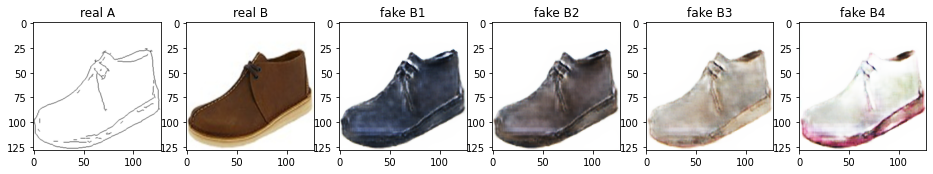

Train Epoch: 2 61% 	Total Loss: 6.772249 	Loss_GAN: 5.276361	Loss_GAN_VAE: 2.007823	Loss_GAN_LR: 1.764692	Loss_D_VAE: 0.850094	Loss_D_LR: 0.645794
1 80009 T:  3.939366102218628
Train Epoch: 2 61% 	Total Loss: 8.051052 	Loss_GAN: 7.227408	Loss_GAN_VAE: 3.220938	Loss_GAN_LR: 2.358897	Loss_D_VAE: 0.362698	Loss_D_LR: 0.460945
1 80019 T:  2.4847655296325684
Train Epoch: 2 61% 	Total Loss: 7.236637 	Loss_GAN: 5.040628	Loss_GAN_VAE: 2.082101	Loss_GAN_LR: 1.341165	Loss_D_VAE: 0.839685	Loss_D_LR: 1.356324
1 80029 T:  2.4790713787078857
Train Epoch: 2 61% 	Total Loss: 6.795940 	Loss_GAN: 4.609326	Loss_GAN_VAE: 2.023413	Loss_GAN_LR: 1.460227	Loss_D_VAE: 1.144370	Loss_D_LR: 1.042244
1 80039 T:  2.8265066146850586
Train Epoch: 2 61% 	Total Loss: 7.058010 	Loss_GAN: 5.364389	Loss_GAN_VAE: 2.278793	Loss_GAN_LR: 1.718904	Loss_D_VAE: 0.652582	Loss_D_LR: 1.041039
1 80049 T:  2.5994374752044678
Train Epoch: 2 61% 	Total Loss: 7.242525 	Loss_GAN: 6.212115	Loss_GAN_VAE: 2.335364	Loss_GAN_LR: 2.333413	Loss_

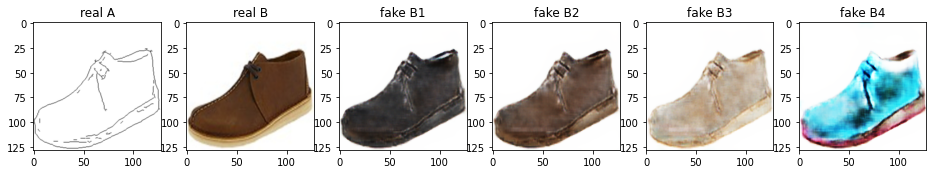

Train Epoch: 2 62% 	Total Loss: 6.807240 	Loss_GAN: 5.157362	Loss_GAN_VAE: 2.188190	Loss_GAN_LR: 1.318332	Loss_D_VAE: 0.641375	Loss_D_LR: 1.008503
1 80509 T:  3.259589195251465
Train Epoch: 2 62% 	Total Loss: 5.459387 	Loss_GAN: 3.791338	Loss_GAN_VAE: 1.479548	Loss_GAN_LR: 1.238591	Loss_D_VAE: 0.677174	Loss_D_LR: 0.990874
1 80519 T:  2.483354330062866
Train Epoch: 2 62% 	Total Loss: 6.661407 	Loss_GAN: 5.263078	Loss_GAN_VAE: 2.171365	Loss_GAN_LR: 1.689508	Loss_D_VAE: 0.506375	Loss_D_LR: 0.891955
1 80529 T:  2.5221619606018066
Train Epoch: 2 62% 	Total Loss: 5.875980 	Loss_GAN: 4.061067	Loss_GAN_VAE: 1.652348	Loss_GAN_LR: 1.191968	Loss_D_VAE: 0.608564	Loss_D_LR: 1.206349
1 80539 T:  2.5326483249664307
Train Epoch: 2 62% 	Total Loss: 6.562092 	Loss_GAN: 4.851153	Loss_GAN_VAE: 2.322882	Loss_GAN_LR: 1.305655	Loss_D_VAE: 0.374074	Loss_D_LR: 1.336865
1 80549 T:  2.485905885696411
Train Epoch: 2 62% 	Total Loss: 6.671423 	Loss_GAN: 4.734272	Loss_GAN_VAE: 1.911688	Loss_GAN_LR: 1.107824	Loss_D_

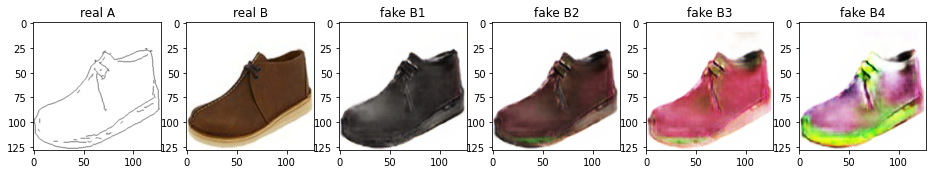

Train Epoch: 2 63% 	Total Loss: 6.351650 	Loss_GAN: 4.834423	Loss_GAN_VAE: 2.059862	Loss_GAN_LR: 1.273561	Loss_D_VAE: 0.653121	Loss_D_LR: 0.864106
1 81009 T:  3.961993932723999
Train Epoch: 2 63% 	Total Loss: 7.276021 	Loss_GAN: 6.014470	Loss_GAN_VAE: 2.334419	Loss_GAN_LR: 1.758144	Loss_D_VAE: 0.657385	Loss_D_LR: 0.604165
1 81019 T:  2.478424310684204
Train Epoch: 2 63% 	Total Loss: 5.998762 	Loss_GAN: 4.678085	Loss_GAN_VAE: 2.062640	Loss_GAN_LR: 1.326500	Loss_D_VAE: 0.515780	Loss_D_LR: 0.804896
1 81029 T:  2.4630112648010254
Train Epoch: 2 63% 	Total Loss: 7.931865 	Loss_GAN: 6.195492	Loss_GAN_VAE: 2.406830	Loss_GAN_LR: 1.664356	Loss_D_VAE: 0.743217	Loss_D_LR: 0.993157
1 81039 T:  2.7991771697998047
Train Epoch: 2 63% 	Total Loss: 6.655815 	Loss_GAN: 4.604204	Loss_GAN_VAE: 1.736969	Loss_GAN_LR: 1.663075	Loss_D_VAE: 0.719183	Loss_D_LR: 1.332428
1 81049 T:  2.5779049396514893
Train Epoch: 2 63% 	Total Loss: 6.850591 	Loss_GAN: 5.097732	Loss_GAN_VAE: 2.442988	Loss_GAN_LR: 1.146626	Loss_D

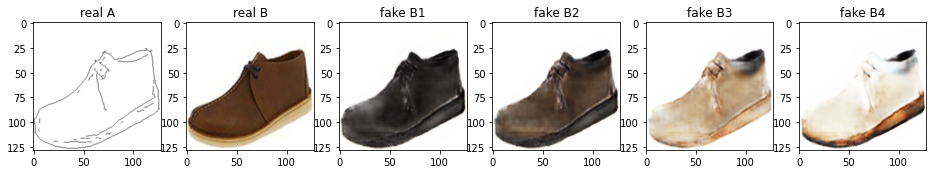

Train Epoch: 2 64% 	Total Loss: 7.038315 	Loss_GAN: 5.940919	Loss_GAN_VAE: 2.580198	Loss_GAN_LR: 1.745865	Loss_D_VAE: 0.343361	Loss_D_LR: 0.754035
1 81509 T:  3.1778101921081543
Train Epoch: 2 64% 	Total Loss: 6.822438 	Loss_GAN: 5.019160	Loss_GAN_VAE: 1.872279	Loss_GAN_LR: 1.463847	Loss_D_VAE: 0.647465	Loss_D_LR: 1.155813
1 81519 T:  2.5284504890441895
Train Epoch: 2 64% 	Total Loss: 6.631979 	Loss_GAN: 4.956910	Loss_GAN_VAE: 2.188323	Loss_GAN_LR: 1.270097	Loss_D_VAE: 0.761203	Loss_D_LR: 0.913866
1 81529 T:  2.5161385536193848
Train Epoch: 2 64% 	Total Loss: 7.047866 	Loss_GAN: 4.891929	Loss_GAN_VAE: 2.214785	Loss_GAN_LR: 1.498267	Loss_D_VAE: 0.828657	Loss_D_LR: 1.327280
1 81539 T:  2.580270290374756
Train Epoch: 2 64% 	Total Loss: 7.407291 	Loss_GAN: 5.670995	Loss_GAN_VAE: 2.280498	Loss_GAN_LR: 1.669599	Loss_D_VAE: 0.775469	Loss_D_LR: 0.960827
1 81549 T:  2.508789539337158
Train Epoch: 2 64% 	Total Loss: 6.071450 	Loss_GAN: 4.709827	Loss_GAN_VAE: 2.022393	Loss_GAN_LR: 1.586292	Loss_D

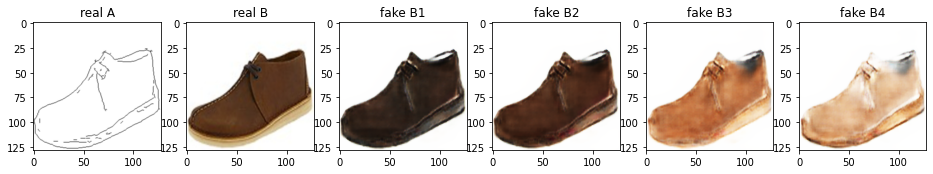

Train Epoch: 2 65% 	Total Loss: 6.277739 	Loss_GAN: 4.704670	Loss_GAN_VAE: 2.236489	Loss_GAN_LR: 1.168405	Loss_D_VAE: 0.524494	Loss_D_LR: 1.048576
1 82009 T:  3.9474191665649414
Train Epoch: 2 65% 	Total Loss: 6.693429 	Loss_GAN: 5.409594	Loss_GAN_VAE: 2.515319	Loss_GAN_LR: 1.330601	Loss_D_VAE: 0.511658	Loss_D_LR: 0.772177
1 82019 T:  2.589162826538086
Train Epoch: 2 65% 	Total Loss: 6.556190 	Loss_GAN: 4.461976	Loss_GAN_VAE: 1.932550	Loss_GAN_LR: 1.373665	Loss_D_VAE: 0.909974	Loss_D_LR: 1.184240
1 82029 T:  2.4968862533569336
Train Epoch: 2 65% 	Total Loss: 6.309628 	Loss_GAN: 4.739413	Loss_GAN_VAE: 1.904530	Loss_GAN_LR: 1.213051	Loss_D_VAE: 0.564553	Loss_D_LR: 1.005662
1 82039 T:  2.803842306137085
Train Epoch: 2 65% 	Total Loss: 6.441038 	Loss_GAN: 4.606775	Loss_GAN_VAE: 1.721256	Loss_GAN_LR: 1.388721	Loss_D_VAE: 0.862893	Loss_D_LR: 0.971370
1 82049 T:  2.6037442684173584
Train Epoch: 2 65% 	Total Loss: 6.619752 	Loss_GAN: 5.116471	Loss_GAN_VAE: 2.096411	Loss_GAN_LR: 1.438496	Loss_D

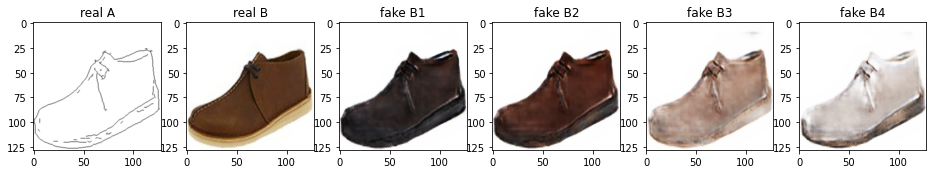

Train Epoch: 2 66% 	Total Loss: 5.934698 	Loss_GAN: 4.374438	Loss_GAN_VAE: 2.034486	Loss_GAN_LR: 0.928698	Loss_D_VAE: 0.500005	Loss_D_LR: 1.060256
1 82509 T:  3.1868767738342285
Train Epoch: 2 66% 	Total Loss: 7.584992 	Loss_GAN: 5.902157	Loss_GAN_VAE: 2.696550	Loss_GAN_LR: 1.597603	Loss_D_VAE: 0.636032	Loss_D_LR: 1.046803
1 82519 T:  2.5272603034973145
Train Epoch: 2 66% 	Total Loss: 6.788351 	Loss_GAN: 5.402125	Loss_GAN_VAE: 2.585913	Loss_GAN_LR: 1.277110	Loss_D_VAE: 0.585118	Loss_D_LR: 0.801109
1 82529 T:  2.484034299850464
Train Epoch: 2 66% 	Total Loss: 6.579465 	Loss_GAN: 4.637654	Loss_GAN_VAE: 2.238692	Loss_GAN_LR: 1.104737	Loss_D_VAE: 0.643365	Loss_D_LR: 1.298446
1 82539 T:  2.5690977573394775
Train Epoch: 2 66% 	Total Loss: 6.454975 	Loss_GAN: 4.807735	Loss_GAN_VAE: 2.399851	Loss_GAN_LR: 1.274671	Loss_D_VAE: 0.545725	Loss_D_LR: 1.101515
1 82549 T:  2.55525541305542
Train Epoch: 2 66% 	Total Loss: 5.743819 	Loss_GAN: 4.041046	Loss_GAN_VAE: 1.740713	Loss_GAN_LR: 1.124275	Loss_D_

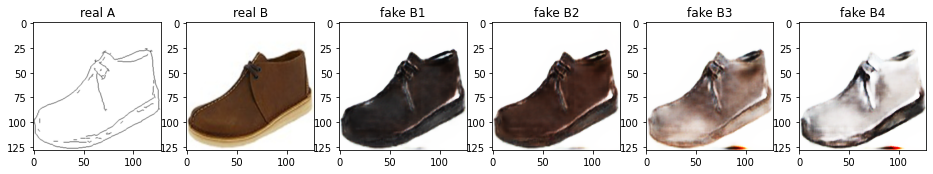

Train Epoch: 2 67% 	Total Loss: 6.526375 	Loss_GAN: 4.706773	Loss_GAN_VAE: 1.955947	Loss_GAN_LR: 1.276894	Loss_D_VAE: 0.802388	Loss_D_LR: 1.017214
1 83009 T:  3.9249730110168457
Train Epoch: 2 67% 	Total Loss: 6.496841 	Loss_GAN: 4.557024	Loss_GAN_VAE: 2.040624	Loss_GAN_LR: 1.015555	Loss_D_VAE: 0.646286	Loss_D_LR: 1.293531
1 83019 T:  2.5220160484313965
Train Epoch: 2 67% 	Total Loss: 6.581542 	Loss_GAN: 4.969234	Loss_GAN_VAE: 2.439088	Loss_GAN_LR: 1.344475	Loss_D_VAE: 0.451277	Loss_D_LR: 1.161030
1 83029 T:  2.5287251472473145
Train Epoch: 2 67% 	Total Loss: 5.884591 	Loss_GAN: 4.191981	Loss_GAN_VAE: 1.828424	Loss_GAN_LR: 1.102323	Loss_D_VAE: 0.685563	Loss_D_LR: 1.007048
1 83039 T:  2.8056271076202393
Train Epoch: 2 67% 	Total Loss: 7.137049 	Loss_GAN: 5.023782	Loss_GAN_VAE: 2.178812	Loss_GAN_LR: 1.295838	Loss_D_VAE: 1.134671	Loss_D_LR: 0.978595
1 83049 T:  2.5665369033813477
Train Epoch: 2 67% 	Total Loss: 7.773144 	Loss_GAN: 6.031476	Loss_GAN_VAE: 2.718180	Loss_GAN_LR: 1.561019	Loss

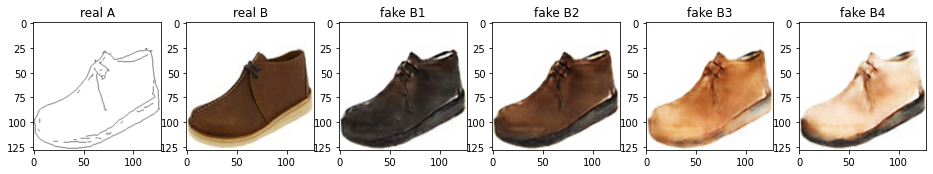

Train Epoch: 2 68% 	Total Loss: 6.390682 	Loss_GAN: 4.652123	Loss_GAN_VAE: 1.850981	Loss_GAN_LR: 1.538179	Loss_D_VAE: 0.897733	Loss_D_LR: 0.840826
1 83509 T:  3.2574644088745117
Train Epoch: 2 68% 	Total Loss: 5.785601 	Loss_GAN: 4.502898	Loss_GAN_VAE: 1.957608	Loss_GAN_LR: 1.492540	Loss_D_VAE: 0.574686	Loss_D_LR: 0.708017
1 83519 T:  2.5547432899475098
Train Epoch: 2 68% 	Total Loss: 6.387425 	Loss_GAN: 4.880405	Loss_GAN_VAE: 1.994034	Loss_GAN_LR: 1.579797	Loss_D_VAE: 0.782856	Loss_D_LR: 0.724164
1 83529 T:  2.6357038021087646
Train Epoch: 2 68% 	Total Loss: 6.869502 	Loss_GAN: 5.034914	Loss_GAN_VAE: 2.255811	Loss_GAN_LR: 1.471283	Loss_D_VAE: 0.883355	Loss_D_LR: 0.951234
1 83539 T:  2.5681772232055664
Train Epoch: 2 68% 	Total Loss: 6.230235 	Loss_GAN: 4.225535	Loss_GAN_VAE: 1.851746	Loss_GAN_LR: 1.008641	Loss_D_VAE: 0.638011	Loss_D_LR: 1.366689
1 83549 T:  2.678269624710083
Train Epoch: 2 68% 	Total Loss: 6.764846 	Loss_GAN: 5.270275	Loss_GAN_VAE: 2.265023	Loss_GAN_LR: 1.271162	Loss_

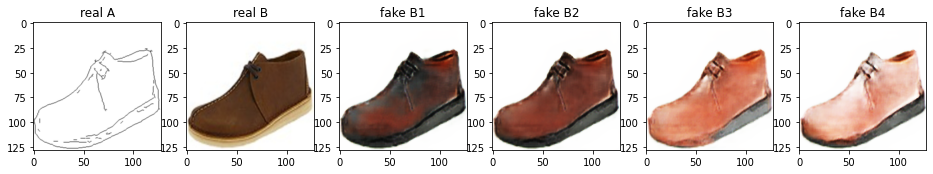

Train Epoch: 2 69% 	Total Loss: 6.989225 	Loss_GAN: 4.255282	Loss_GAN_VAE: 1.781886	Loss_GAN_LR: 1.345902	Loss_D_VAE: 1.590004	Loss_D_LR: 1.143939
1 84009 T:  3.9951043128967285
Train Epoch: 2 69% 	Total Loss: 6.666637 	Loss_GAN: 4.900156	Loss_GAN_VAE: 1.959263	Loss_GAN_LR: 1.303101	Loss_D_VAE: 0.866164	Loss_D_LR: 0.900316
1 84019 T:  2.5619893074035645
Train Epoch: 2 69% 	Total Loss: 6.991271 	Loss_GAN: 5.300645	Loss_GAN_VAE: 2.204514	Loss_GAN_LR: 1.418140	Loss_D_VAE: 0.755142	Loss_D_LR: 0.935483
1 84029 T:  2.521876096725464
Train Epoch: 2 69% 	Total Loss: 6.778097 	Loss_GAN: 5.818305	Loss_GAN_VAE: 2.076704	Loss_GAN_LR: 1.794131	Loss_D_VAE: 0.557447	Loss_D_LR: 0.402345
1 84039 T:  2.8497042655944824
Train Epoch: 2 69% 	Total Loss: 6.625695 	Loss_GAN: 4.598319	Loss_GAN_VAE: 1.906940	Loss_GAN_LR: 1.388057	Loss_D_VAE: 0.984519	Loss_D_LR: 1.042857
1 84049 T:  2.559199333190918
Train Epoch: 2 69% 	Total Loss: 6.160781 	Loss_GAN: 4.587437	Loss_GAN_VAE: 1.819054	Loss_GAN_LR: 1.417831	Loss_D

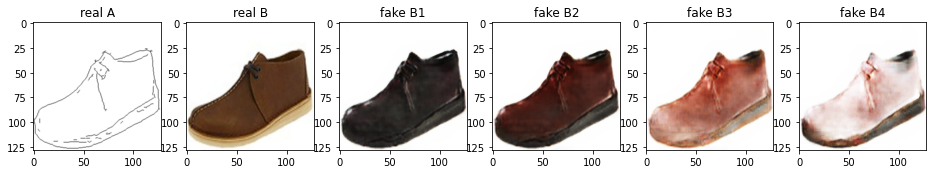

Train Epoch: 2 70% 	Total Loss: 6.519530 	Loss_GAN: 4.744309	Loss_GAN_VAE: 2.204538	Loss_GAN_LR: 1.188474	Loss_D_VAE: 0.782671	Loss_D_LR: 0.992549
1 84509 T:  3.2744040489196777
Train Epoch: 2 70% 	Total Loss: 6.442513 	Loss_GAN: 4.883069	Loss_GAN_VAE: 2.089827	Loss_GAN_LR: 1.475151	Loss_D_VAE: 0.746180	Loss_D_LR: 0.813264
1 84519 T:  2.4954919815063477
Train Epoch: 2 70% 	Total Loss: 6.330522 	Loss_GAN: 4.499537	Loss_GAN_VAE: 1.890365	Loss_GAN_LR: 1.181286	Loss_D_VAE: 0.843237	Loss_D_LR: 0.987749
1 84529 T:  2.5272719860076904
Train Epoch: 2 70% 	Total Loss: 6.937338 	Loss_GAN: 5.484006	Loss_GAN_VAE: 2.335989	Loss_GAN_LR: 1.621874	Loss_D_VAE: 0.546365	Loss_D_LR: 0.906967
1 84539 T:  2.5421886444091797
Train Epoch: 2 70% 	Total Loss: 7.392981 	Loss_GAN: 5.724709	Loss_GAN_VAE: 2.480585	Loss_GAN_LR: 1.561303	Loss_D_VAE: 0.573332	Loss_D_LR: 1.094940
1 84549 T:  2.546386957168579
Train Epoch: 2 70% 	Total Loss: 7.096537 	Loss_GAN: 5.640826	Loss_GAN_VAE: 2.578715	Loss_GAN_LR: 1.532489	Loss_

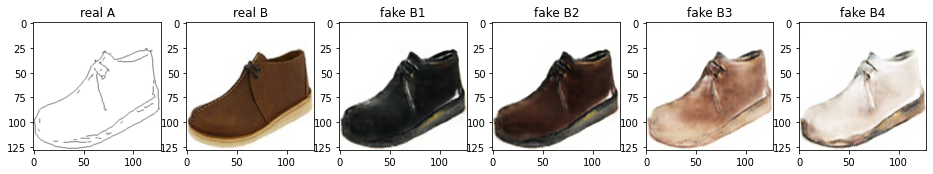

Train Epoch: 2 71% 	Total Loss: 6.573395 	Loss_GAN: 4.753544	Loss_GAN_VAE: 1.771855	Loss_GAN_LR: 1.274208	Loss_D_VAE: 0.581910	Loss_D_LR: 1.237941
1 85009 T:  3.9602932929992676
Train Epoch: 2 71% 	Total Loss: 6.590979 	Loss_GAN: 4.783947	Loss_GAN_VAE: 2.184109	Loss_GAN_LR: 1.175543	Loss_D_VAE: 0.720526	Loss_D_LR: 1.086506
1 85019 T:  2.5234415531158447
Train Epoch: 2 71% 	Total Loss: 6.477953 	Loss_GAN: 4.856199	Loss_GAN_VAE: 1.927236	Loss_GAN_LR: 1.367893	Loss_D_VAE: 0.742588	Loss_D_LR: 0.879166
1 85029 T:  2.4541149139404297
Train Epoch: 2 71% 	Total Loss: 6.725475 	Loss_GAN: 4.306073	Loss_GAN_VAE: 1.460667	Loss_GAN_LR: 1.288297	Loss_D_VAE: 1.479343	Loss_D_LR: 0.940059
1 85039 T:  2.752190351486206
Train Epoch: 2 71% 	Total Loss: 6.624717 	Loss_GAN: 4.958974	Loss_GAN_VAE: 1.711203	Loss_GAN_LR: 1.484942	Loss_D_VAE: 0.686631	Loss_D_LR: 0.979112
1 85049 T:  2.566606283187866
Train Epoch: 2 71% 	Total Loss: 7.039194 	Loss_GAN: 5.340729	Loss_GAN_VAE: 2.351996	Loss_GAN_LR: 1.367845	Loss_D

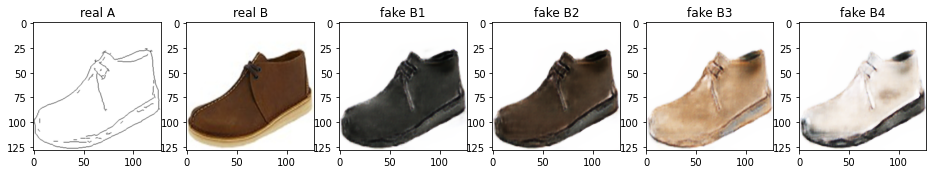

Train Epoch: 2 72% 	Total Loss: 7.164225 	Loss_GAN: 4.782792	Loss_GAN_VAE: 2.140767	Loss_GAN_LR: 1.312997	Loss_D_VAE: 1.103949	Loss_D_LR: 1.277483
1 85509 T:  3.2807133197784424
Train Epoch: 2 72% 	Total Loss: 6.844666 	Loss_GAN: 4.937387	Loss_GAN_VAE: 2.357852	Loss_GAN_LR: 1.136303	Loss_D_VAE: 0.579448	Loss_D_LR: 1.327830
1 85519 T:  2.5710086822509766
Train Epoch: 2 72% 	Total Loss: 5.569945 	Loss_GAN: 3.698688	Loss_GAN_VAE: 1.575575	Loss_GAN_LR: 1.138205	Loss_D_VAE: 0.762949	Loss_D_LR: 1.108309
1 85529 T:  2.4787232875823975
Train Epoch: 2 72% 	Total Loss: 5.848777 	Loss_GAN: 3.685548	Loss_GAN_VAE: 1.680301	Loss_GAN_LR: 1.127739	Loss_D_VAE: 0.867112	Loss_D_LR: 1.296118
1 85539 T:  2.5234508514404297
Train Epoch: 2 72% 	Total Loss: 7.064865 	Loss_GAN: 5.489752	Loss_GAN_VAE: 2.608671	Loss_GAN_LR: 1.423613	Loss_D_VAE: 0.566259	Loss_D_LR: 1.008854
1 85549 T:  2.5085833072662354
Train Epoch: 2 72% 	Total Loss: 7.009852 	Loss_GAN: 5.974858	Loss_GAN_VAE: 2.668484	Loss_GAN_LR: 1.889024	Loss

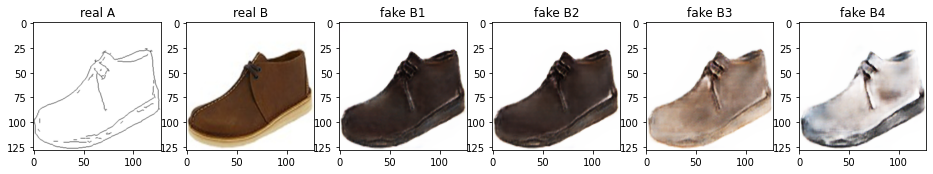

Train Epoch: 2 73% 	Total Loss: 6.164687 	Loss_GAN: 4.483039	Loss_GAN_VAE: 1.920623	Loss_GAN_LR: 1.389192	Loss_D_VAE: 0.588327	Loss_D_LR: 1.093320
1 86009 T:  4.0047125816345215
Train Epoch: 2 73% 	Total Loss: 6.849506 	Loss_GAN: 5.561315	Loss_GAN_VAE: 2.496600	Loss_GAN_LR: 1.571973	Loss_D_VAE: 0.497357	Loss_D_LR: 0.790834
1 86019 T:  2.5302891731262207
Train Epoch: 2 73% 	Total Loss: 5.959401 	Loss_GAN: 4.096044	Loss_GAN_VAE: 1.937133	Loss_GAN_LR: 0.961310	Loss_D_VAE: 0.738539	Loss_D_LR: 1.124818
1 86029 T:  2.5071542263031006
Train Epoch: 2 73% 	Total Loss: 7.507660 	Loss_GAN: 6.041191	Loss_GAN_VAE: 3.017745	Loss_GAN_LR: 1.530514	Loss_D_VAE: 0.456536	Loss_D_LR: 1.009933
1 86039 T:  2.8514699935913086
Train Epoch: 2 73% 	Total Loss: 6.970252 	Loss_GAN: 5.002741	Loss_GAN_VAE: 2.352439	Loss_GAN_LR: 1.498109	Loss_D_VAE: 0.956046	Loss_D_LR: 1.011465
1 86049 T:  2.575927495956421
Train Epoch: 2 73% 	Total Loss: 7.315351 	Loss_GAN: 5.740786	Loss_GAN_VAE: 2.606879	Loss_GAN_LR: 1.394324	Loss_

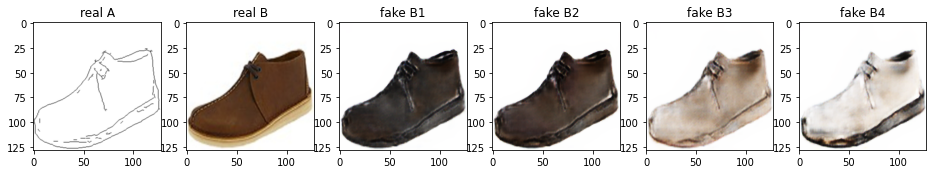

Train Epoch: 2 74% 	Total Loss: 6.502755 	Loss_GAN: 4.781549	Loss_GAN_VAE: 2.227406	Loss_GAN_LR: 1.215071	Loss_D_VAE: 0.896876	Loss_D_LR: 0.824330
1 86509 T:  3.3016364574432373
Train Epoch: 2 74% 	Total Loss: 7.072454 	Loss_GAN: 5.052267	Loss_GAN_VAE: 2.070923	Loss_GAN_LR: 1.170981	Loss_D_VAE: 0.835543	Loss_D_LR: 1.184644
1 86519 T:  2.4658021926879883
Train Epoch: 2 74% 	Total Loss: 6.734595 	Loss_GAN: 4.924587	Loss_GAN_VAE: 2.240729	Loss_GAN_LR: 1.601962	Loss_D_VAE: 0.812871	Loss_D_LR: 0.997137
1 86529 T:  2.545945405960083
Train Epoch: 2 74% 	Total Loss: 6.751609 	Loss_GAN: 5.099540	Loss_GAN_VAE: 1.858758	Loss_GAN_LR: 1.677682	Loss_D_VAE: 0.800636	Loss_D_LR: 0.851433
1 86539 T:  2.513374090194702
Train Epoch: 2 74% 	Total Loss: 6.737723 	Loss_GAN: 5.142548	Loss_GAN_VAE: 1.962882	Loss_GAN_LR: 1.340666	Loss_D_VAE: 0.645643	Loss_D_LR: 0.949533
1 86549 T:  2.511850357055664
Train Epoch: 2 74% 	Total Loss: 7.034728 	Loss_GAN: 5.316835	Loss_GAN_VAE: 2.063533	Loss_GAN_LR: 1.699925	Loss_D_

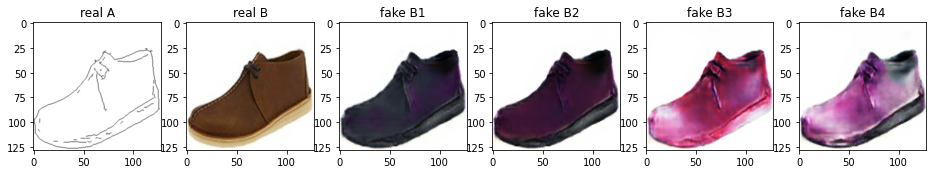

Train Epoch: 2 75% 	Total Loss: 6.848925 	Loss_GAN: 5.054581	Loss_GAN_VAE: 2.239764	Loss_GAN_LR: 1.439513	Loss_D_VAE: 0.530679	Loss_D_LR: 1.263665
1 87009 T:  3.927666664123535
Train Epoch: 2 75% 	Total Loss: 7.492108 	Loss_GAN: 6.159796	Loss_GAN_VAE: 2.312347	Loss_GAN_LR: 1.863482	Loss_D_VAE: 0.479006	Loss_D_LR: 0.853306
1 87019 T:  2.4927353858947754
Train Epoch: 2 75% 	Total Loss: 7.298113 	Loss_GAN: 5.474756	Loss_GAN_VAE: 2.344698	Loss_GAN_LR: 1.653747	Loss_D_VAE: 0.786271	Loss_D_LR: 1.037086
1 87029 T:  2.51076602935791
Train Epoch: 2 75% 	Total Loss: 7.184232 	Loss_GAN: 5.385856	Loss_GAN_VAE: 2.200688	Loss_GAN_LR: 1.252210	Loss_D_VAE: 0.449511	Loss_D_LR: 1.348864
1 87039 T:  2.8339996337890625
Train Epoch: 2 75% 	Total Loss: 7.009283 	Loss_GAN: 4.868581	Loss_GAN_VAE: 2.154341	Loss_GAN_LR: 1.067431	Loss_D_VAE: 0.730306	Loss_D_LR: 1.410396
1 87049 T:  2.5370748043060303
Train Epoch: 2 75% 	Total Loss: 7.261843 	Loss_GAN: 5.366995	Loss_GAN_VAE: 2.702043	Loss_GAN_LR: 1.064873	Loss_D_

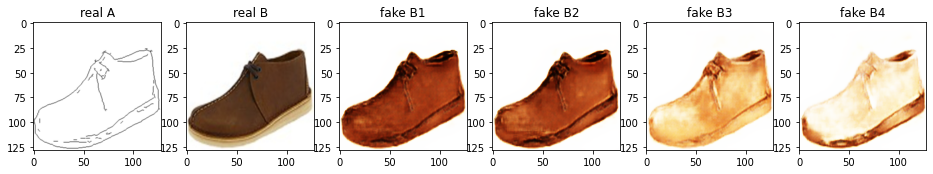

Train Epoch: 2 76% 	Total Loss: 8.340980 	Loss_GAN: 6.649202	Loss_GAN_VAE: 3.026306	Loss_GAN_LR: 1.860647	Loss_D_VAE: 0.868595	Loss_D_LR: 0.823183
1 87509 T:  3.278383493423462
Train Epoch: 2 76% 	Total Loss: 7.564024 	Loss_GAN: 6.505540	Loss_GAN_VAE: 2.709925	Loss_GAN_LR: 2.119786	Loss_D_VAE: 0.315873	Loss_D_LR: 0.742611
1 87519 T:  2.5343897342681885
Train Epoch: 2 76% 	Total Loss: 6.802893 	Loss_GAN: 6.035770	Loss_GAN_VAE: 2.570840	Loss_GAN_LR: 2.133757	Loss_D_VAE: 0.340687	Loss_D_LR: 0.426436
1 87529 T:  2.515713691711426
Train Epoch: 2 76% 	Total Loss: 7.099902 	Loss_GAN: 5.063792	Loss_GAN_VAE: 2.151531	Loss_GAN_LR: 1.307636	Loss_D_VAE: 0.646967	Loss_D_LR: 1.389144
1 87539 T:  2.537735939025879
Train Epoch: 2 76% 	Total Loss: 6.879661 	Loss_GAN: 5.235216	Loss_GAN_VAE: 2.459122	Loss_GAN_LR: 1.436844	Loss_D_VAE: 0.495536	Loss_D_LR: 1.148910
1 87549 T:  2.6154651641845703
Train Epoch: 2 76% 	Total Loss: 7.312778 	Loss_GAN: 5.649637	Loss_GAN_VAE: 2.699206	Loss_GAN_LR: 1.631767	Loss_D_

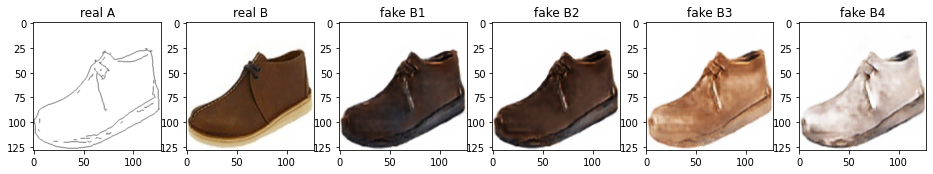

Train Epoch: 2 77% 	Total Loss: 6.713391 	Loss_GAN: 4.634365	Loss_GAN_VAE: 2.273906	Loss_GAN_LR: 1.144867	Loss_D_VAE: 1.035470	Loss_D_LR: 1.043557
1 88009 T:  4.081530570983887
Train Epoch: 2 77% 	Total Loss: 6.468133 	Loss_GAN: 5.017535	Loss_GAN_VAE: 1.926370	Loss_GAN_LR: 1.633310	Loss_D_VAE: 0.668930	Loss_D_LR: 0.781668
1 88019 T:  2.5431337356567383
Train Epoch: 2 77% 	Total Loss: 6.928599 	Loss_GAN: 5.413922	Loss_GAN_VAE: 2.356782	Loss_GAN_LR: 1.200487	Loss_D_VAE: 0.485984	Loss_D_LR: 1.028693
1 88029 T:  2.515791416168213
Train Epoch: 2 77% 	Total Loss: 5.786848 	Loss_GAN: 3.974727	Loss_GAN_VAE: 1.704328	Loss_GAN_LR: 1.286392	Loss_D_VAE: 0.659535	Loss_D_LR: 1.152585
1 88039 T:  2.780519485473633
Train Epoch: 2 77% 	Total Loss: 6.472175 	Loss_GAN: 4.881549	Loss_GAN_VAE: 2.138594	Loss_GAN_LR: 1.226785	Loss_D_VAE: 0.574706	Loss_D_LR: 1.015920
1 88049 T:  2.5195090770721436
Train Epoch: 2 77% 	Total Loss: 6.556837 	Loss_GAN: 4.854559	Loss_GAN_VAE: 2.044311	Loss_GAN_LR: 1.591447	Loss_D_

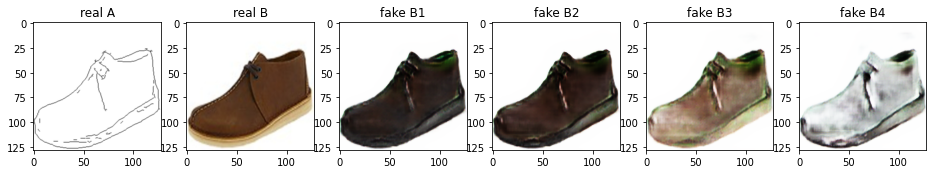

Train Epoch: 2 78% 	Total Loss: 6.604742 	Loss_GAN: 5.013648	Loss_GAN_VAE: 1.987447	Loss_GAN_LR: 1.590482	Loss_D_VAE: 0.718794	Loss_D_LR: 0.872300
1 88509 T:  3.17923903465271
Train Epoch: 2 78% 	Total Loss: 7.820223 	Loss_GAN: 6.429082	Loss_GAN_VAE: 2.582938	Loss_GAN_LR: 1.813569	Loss_D_VAE: 0.476575	Loss_D_LR: 0.914566
1 88519 T:  2.5616421699523926
Train Epoch: 2 78% 	Total Loss: 8.202733 	Loss_GAN: 6.981963	Loss_GAN_VAE: 3.410268	Loss_GAN_LR: 1.953984	Loss_D_VAE: 0.483716	Loss_D_LR: 0.737053
1 88529 T:  2.487030506134033
Train Epoch: 2 78% 	Total Loss: 8.524083 	Loss_GAN: 7.945738	Loss_GAN_VAE: 3.491372	Loss_GAN_LR: 2.479328	Loss_D_VAE: 0.202653	Loss_D_LR: 0.375691
1 88539 T:  2.548980236053467
Train Epoch: 2 78% 	Total Loss: 9.288948 	Loss_GAN: 8.429979	Loss_GAN_VAE: 3.471644	Loss_GAN_LR: 2.830711	Loss_D_VAE: 0.275218	Loss_D_LR: 0.583751
1 88549 T:  2.4805309772491455
Train Epoch: 2 78% 	Total Loss: 7.737276 	Loss_GAN: 6.526779	Loss_GAN_VAE: 2.769010	Loss_GAN_LR: 1.967244	Loss_D_V

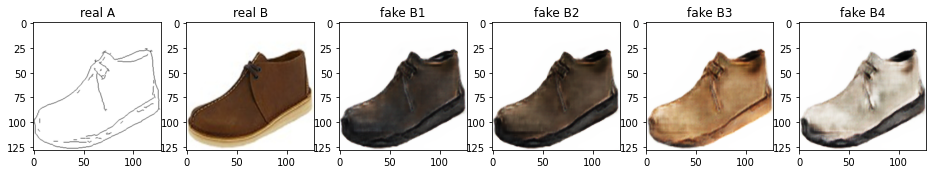

Train Epoch: 2 79% 	Total Loss: 6.606183 	Loss_GAN: 4.965045	Loss_GAN_VAE: 1.987695	Loss_GAN_LR: 1.373522	Loss_D_VAE: 0.603141	Loss_D_LR: 1.037996
1 89009 T:  4.231927394866943
Train Epoch: 2 79% 	Total Loss: 7.664331 	Loss_GAN: 5.645146	Loss_GAN_VAE: 2.481836	Loss_GAN_LR: 1.615176	Loss_D_VAE: 0.678558	Loss_D_LR: 1.340627
1 89019 T:  2.4818360805511475
Train Epoch: 2 79% 	Total Loss: 6.999968 	Loss_GAN: 5.924170	Loss_GAN_VAE: 2.683702	Loss_GAN_LR: 1.473891	Loss_D_VAE: 0.300445	Loss_D_LR: 0.775352
1 89029 T:  2.633941173553467
Train Epoch: 2 79% 	Total Loss: 6.678766 	Loss_GAN: 5.483383	Loss_GAN_VAE: 2.406866	Loss_GAN_LR: 1.363158	Loss_D_VAE: 0.475187	Loss_D_LR: 0.720196
1 89039 T:  2.751558780670166
Train Epoch: 2 79% 	Total Loss: 7.465885 	Loss_GAN: 5.622167	Loss_GAN_VAE: 2.172447	Loss_GAN_LR: 1.450181	Loss_D_VAE: 0.801999	Loss_D_LR: 1.041719
1 89049 T:  2.4995369911193848
Train Epoch: 2 79% 	Total Loss: 6.194243 	Loss_GAN: 4.585832	Loss_GAN_VAE: 1.849469	Loss_GAN_LR: 1.546718	Loss_D_

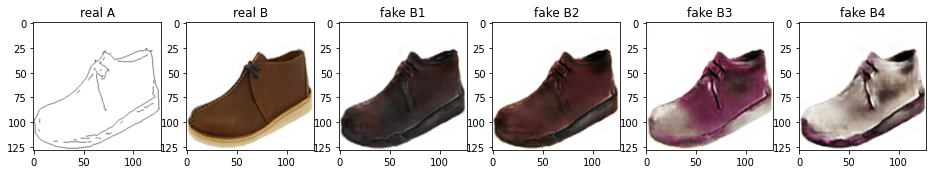

Train Epoch: 2 80% 	Total Loss: 6.509184 	Loss_GAN: 4.672088	Loss_GAN_VAE: 2.302234	Loss_GAN_LR: 1.028692	Loss_D_VAE: 0.591913	Loss_D_LR: 1.245182
1 89509 T:  3.2678334712982178
Train Epoch: 2 80% 	Total Loss: 6.313613 	Loss_GAN: 4.381731	Loss_GAN_VAE: 1.812329	Loss_GAN_LR: 1.331674	Loss_D_VAE: 0.833053	Loss_D_LR: 1.098829
1 89519 T:  2.500340700149536
Train Epoch: 2 80% 	Total Loss: 7.112535 	Loss_GAN: 4.828054	Loss_GAN_VAE: 1.962073	Loss_GAN_LR: 1.315144	Loss_D_VAE: 0.982830	Loss_D_LR: 1.301652
1 89529 T:  2.5488362312316895
Train Epoch: 2 80% 	Total Loss: 7.448106 	Loss_GAN: 5.425396	Loss_GAN_VAE: 2.780458	Loss_GAN_LR: 1.226131	Loss_D_VAE: 0.826250	Loss_D_LR: 1.196460
1 89539 T:  2.5431010723114014
Train Epoch: 2 80% 	Total Loss: 7.112326 	Loss_GAN: 5.086892	Loss_GAN_VAE: 2.050912	Loss_GAN_LR: 1.434414	Loss_D_VAE: 0.829307	Loss_D_LR: 1.196128
1 89549 T:  2.509119987487793
Train Epoch: 2 80% 	Total Loss: 6.332226 	Loss_GAN: 4.450119	Loss_GAN_VAE: 2.081597	Loss_GAN_LR: 1.148127	Loss_D

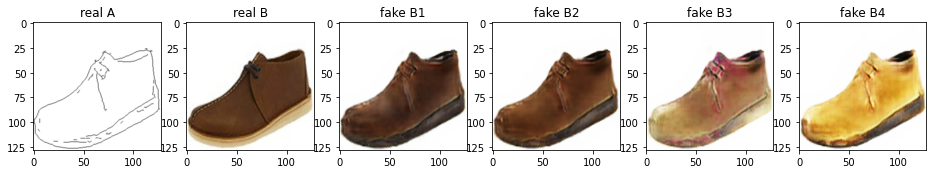

Train Epoch: 2 81% 	Total Loss: 6.610354 	Loss_GAN: 5.113074	Loss_GAN_VAE: 1.915050	Loss_GAN_LR: 1.734993	Loss_D_VAE: 0.768753	Loss_D_LR: 0.728527
1 90009 T:  3.9080023765563965
Train Epoch: 2 81% 	Total Loss: 7.324548 	Loss_GAN: 5.522600	Loss_GAN_VAE: 2.529417	Loss_GAN_LR: 1.566220	Loss_D_VAE: 0.869918	Loss_D_LR: 0.932031
1 90019 T:  2.530780553817749
Train Epoch: 2 81% 	Total Loss: 6.799863 	Loss_GAN: 5.075274	Loss_GAN_VAE: 2.306239	Loss_GAN_LR: 1.355898	Loss_D_VAE: 0.721397	Loss_D_LR: 1.003192
1 90029 T:  2.5336923599243164
Train Epoch: 2 81% 	Total Loss: 7.141138 	Loss_GAN: 5.725303	Loss_GAN_VAE: 2.373931	Loss_GAN_LR: 1.608458	Loss_D_VAE: 0.638444	Loss_D_LR: 0.777391
1 90039 T:  2.805326461791992
Train Epoch: 2 81% 	Total Loss: 6.599137 	Loss_GAN: 4.892405	Loss_GAN_VAE: 2.028156	Loss_GAN_LR: 1.297111	Loss_D_VAE: 0.740201	Loss_D_LR: 0.966531
1 90049 T:  2.526974678039551
Train Epoch: 2 81% 	Total Loss: 7.257128 	Loss_GAN: 4.920597	Loss_GAN_VAE: 1.754056	Loss_GAN_LR: 1.690934	Loss_D_

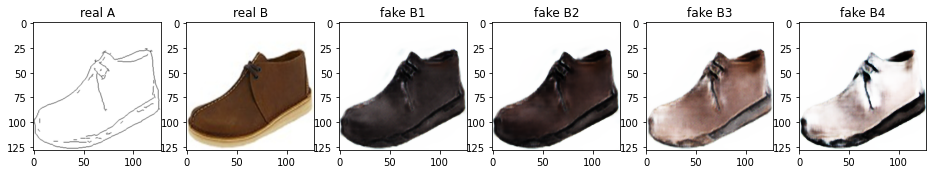

Train Epoch: 2 82% 	Total Loss: 6.791535 	Loss_GAN: 5.107854	Loss_GAN_VAE: 2.093153	Loss_GAN_LR: 1.602521	Loss_D_VAE: 0.789631	Loss_D_LR: 0.894050
1 90509 T:  3.2047505378723145
Train Epoch: 2 82% 	Total Loss: 6.317290 	Loss_GAN: 4.586389	Loss_GAN_VAE: 1.958448	Loss_GAN_LR: 1.233650	Loss_D_VAE: 0.836939	Loss_D_LR: 0.893962
1 90519 T:  2.507585048675537
Train Epoch: 2 82% 	Total Loss: 6.724017 	Loss_GAN: 4.806210	Loss_GAN_VAE: 2.101519	Loss_GAN_LR: 1.458813	Loss_D_VAE: 0.722543	Loss_D_LR: 1.195264
1 90529 T:  2.48083758354187
Train Epoch: 2 82% 	Total Loss: 6.080451 	Loss_GAN: 4.467518	Loss_GAN_VAE: 1.999039	Loss_GAN_LR: 1.272934	Loss_D_VAE: 0.708650	Loss_D_LR: 0.904283
1 90539 T:  2.4574949741363525
Train Epoch: 2 82% 	Total Loss: 6.492807 	Loss_GAN: 4.898457	Loss_GAN_VAE: 2.132512	Loss_GAN_LR: 1.599167	Loss_D_VAE: 0.713380	Loss_D_LR: 0.880969
1 90549 T:  2.4920008182525635
Train Epoch: 2 82% 	Total Loss: 6.328045 	Loss_GAN: 4.607835	Loss_GAN_VAE: 1.964608	Loss_GAN_LR: 1.317612	Loss_D_

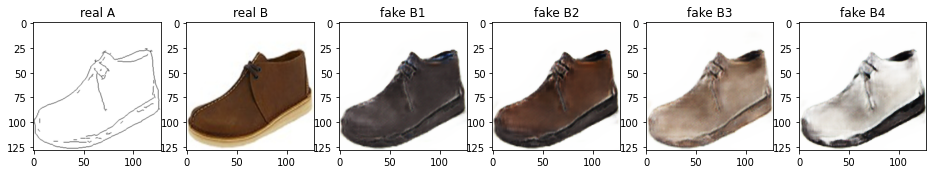

Train Epoch: 2 83% 	Total Loss: 7.322501 	Loss_GAN: 5.296497	Loss_GAN_VAE: 2.213715	Loss_GAN_LR: 1.539566	Loss_D_VAE: 1.269036	Loss_D_LR: 0.756968
1 91009 T:  3.936283826828003
Train Epoch: 2 83% 	Total Loss: 6.122968 	Loss_GAN: 4.591665	Loss_GAN_VAE: 1.601510	Loss_GAN_LR: 1.430970	Loss_D_VAE: 0.705976	Loss_D_LR: 0.825326
1 91019 T:  2.5772552490234375
Train Epoch: 2 83% 	Total Loss: 6.662694 	Loss_GAN: 5.170414	Loss_GAN_VAE: 2.152137	Loss_GAN_LR: 1.414598	Loss_D_VAE: 0.621577	Loss_D_LR: 0.870702
1 91029 T:  2.5040013790130615
Train Epoch: 2 83% 	Total Loss: 7.432388 	Loss_GAN: 6.079126	Loss_GAN_VAE: 3.052932	Loss_GAN_LR: 1.367890	Loss_D_VAE: 0.356703	Loss_D_LR: 0.996559
1 91039 T:  2.830007553100586
Train Epoch: 2 83% 	Total Loss: 7.648489 	Loss_GAN: 6.122948	Loss_GAN_VAE: 2.200953	Loss_GAN_LR: 1.939189	Loss_D_VAE: 0.746439	Loss_D_LR: 0.779101
1 91049 T:  2.589980125427246
Train Epoch: 2 83% 	Total Loss: 6.397114 	Loss_GAN: 4.766274	Loss_GAN_VAE: 1.889424	Loss_GAN_LR: 1.493787	Loss_D_

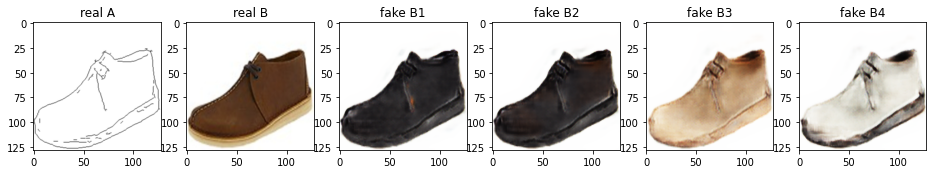

Train Epoch: 2 84% 	Total Loss: 6.332317 	Loss_GAN: 4.647626	Loss_GAN_VAE: 2.055715	Loss_GAN_LR: 1.210674	Loss_D_VAE: 0.688841	Loss_D_LR: 0.995850
1 91509 T:  3.2857556343078613
Train Epoch: 2 84% 	Total Loss: 6.943392 	Loss_GAN: 4.925276	Loss_GAN_VAE: 1.961101	Loss_GAN_LR: 1.634001	Loss_D_VAE: 1.162597	Loss_D_LR: 0.855519
1 91519 T:  2.4548914432525635
Train Epoch: 2 84% 	Total Loss: 6.590989 	Loss_GAN: 4.598558	Loss_GAN_VAE: 1.880024	Loss_GAN_LR: 1.260292	Loss_D_VAE: 0.799850	Loss_D_LR: 1.192580
1 91529 T:  2.489056348800659
Train Epoch: 2 84% 	Total Loss: 6.224928 	Loss_GAN: 4.154581	Loss_GAN_VAE: 1.819444	Loss_GAN_LR: 1.177897	Loss_D_VAE: 1.071254	Loss_D_LR: 0.999092
1 91539 T:  2.493102550506592
Train Epoch: 2 84% 	Total Loss: 5.912771 	Loss_GAN: 4.089438	Loss_GAN_VAE: 2.048268	Loss_GAN_LR: 1.022113	Loss_D_VAE: 0.589157	Loss_D_LR: 1.234176
1 91549 T:  2.468418836593628
Train Epoch: 2 84% 	Total Loss: 6.617241 	Loss_GAN: 5.443635	Loss_GAN_VAE: 2.332833	Loss_GAN_LR: 1.779975	Loss_D_

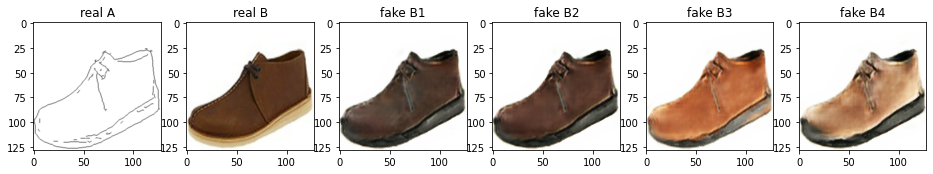

Train Epoch: 2 85% 	Total Loss: 7.358982 	Loss_GAN: 5.240796	Loss_GAN_VAE: 2.495132	Loss_GAN_LR: 1.636829	Loss_D_VAE: 1.015601	Loss_D_LR: 1.102585
1 92009 T:  4.316050291061401
Train Epoch: 2 85% 	Total Loss: 7.170189 	Loss_GAN: 5.629115	Loss_GAN_VAE: 2.195428	Loss_GAN_LR: 1.911888	Loss_D_VAE: 0.675501	Loss_D_LR: 0.865574
1 92019 T:  2.542588710784912
Train Epoch: 2 85% 	Total Loss: 6.891091 	Loss_GAN: 5.458464	Loss_GAN_VAE: 2.426764	Loss_GAN_LR: 1.432423	Loss_D_VAE: 0.422983	Loss_D_LR: 1.009644
1 92029 T:  2.515669107437134
Train Epoch: 2 85% 	Total Loss: 7.130598 	Loss_GAN: 5.005628	Loss_GAN_VAE: 2.110648	Loss_GAN_LR: 1.397872	Loss_D_VAE: 0.952908	Loss_D_LR: 1.172063
1 92039 T:  2.7447638511657715
Train Epoch: 2 85% 	Total Loss: 6.404625 	Loss_GAN: 4.510673	Loss_GAN_VAE: 1.745684	Loss_GAN_LR: 1.387050	Loss_D_VAE: 0.684262	Loss_D_LR: 1.209690
1 92049 T:  2.6405906677246094
Train Epoch: 2 85% 	Total Loss: 6.474711 	Loss_GAN: 4.772545	Loss_GAN_VAE: 2.070858	Loss_GAN_LR: 1.313478	Loss_D_

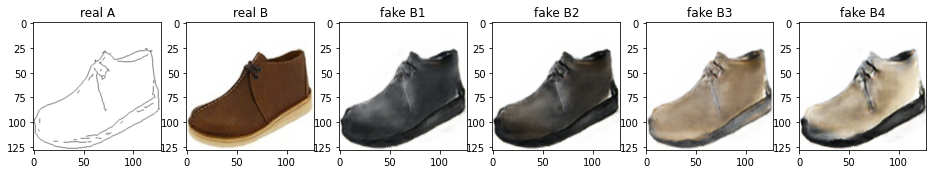

Train Epoch: 2 86% 	Total Loss: 6.618097 	Loss_GAN: 5.091435	Loss_GAN_VAE: 2.300135	Loss_GAN_LR: 1.519036	Loss_D_VAE: 0.786025	Loss_D_LR: 0.740637
1 92509 T:  3.304094076156616
Train Epoch: 2 86% 	Total Loss: 7.174069 	Loss_GAN: 5.447461	Loss_GAN_VAE: 2.085420	Loss_GAN_LR: 1.756945	Loss_D_VAE: 0.785386	Loss_D_LR: 0.941222
1 92519 T:  2.5356955528259277
Train Epoch: 2 86% 	Total Loss: 7.286904 	Loss_GAN: 5.419768	Loss_GAN_VAE: 2.430968	Loss_GAN_LR: 1.382943	Loss_D_VAE: 0.901788	Loss_D_LR: 0.965348
1 92529 T:  2.481729745864868
Train Epoch: 2 86% 	Total Loss: 6.320457 	Loss_GAN: 4.564492	Loss_GAN_VAE: 1.863380	Loss_GAN_LR: 1.076819	Loss_D_VAE: 0.764968	Loss_D_LR: 0.990997
1 92539 T:  2.48490047454834
Train Epoch: 2 86% 	Total Loss: 7.039626 	Loss_GAN: 5.683832	Loss_GAN_VAE: 2.355856	Loss_GAN_LR: 1.885588	Loss_D_VAE: 0.623318	Loss_D_LR: 0.732476
1 92549 T:  2.475553274154663
Train Epoch: 2 86% 	Total Loss: 6.777432 	Loss_GAN: 4.838199	Loss_GAN_VAE: 2.200421	Loss_GAN_LR: 1.362909	Loss_D_VA

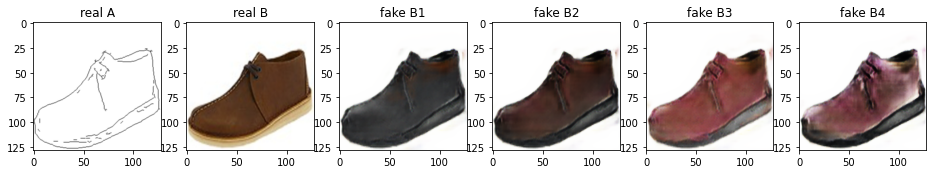

Train Epoch: 2 87% 	Total Loss: 7.598395 	Loss_GAN: 5.017117	Loss_GAN_VAE: 2.277629	Loss_GAN_LR: 1.348417	Loss_D_VAE: 1.568140	Loss_D_LR: 1.013138
1 93009 T:  3.966261148452759
Train Epoch: 2 87% 	Total Loss: 6.520353 	Loss_GAN: 4.648515	Loss_GAN_VAE: 2.006763	Loss_GAN_LR: 1.402595	Loss_D_VAE: 0.652988	Loss_D_LR: 1.218850
1 93019 T:  2.592913866043091
Train Epoch: 2 87% 	Total Loss: 6.865523 	Loss_GAN: 4.834125	Loss_GAN_VAE: 2.167445	Loss_GAN_LR: 0.999645	Loss_D_VAE: 0.823403	Loss_D_LR: 1.207995
1 93029 T:  2.5397963523864746
Train Epoch: 2 87% 	Total Loss: 7.185030 	Loss_GAN: 5.842640	Loss_GAN_VAE: 2.644021	Loss_GAN_LR: 1.749237	Loss_D_VAE: 0.430162	Loss_D_LR: 0.912228
1 93039 T:  2.8590939044952393
Train Epoch: 2 87% 	Total Loss: 6.341660 	Loss_GAN: 4.867626	Loss_GAN_VAE: 2.217003	Loss_GAN_LR: 1.511078	Loss_D_VAE: 0.608692	Loss_D_LR: 0.865342
1 93049 T:  2.607665538787842
Train Epoch: 2 87% 	Total Loss: 6.422962 	Loss_GAN: 5.170234	Loss_GAN_VAE: 2.322945	Loss_GAN_LR: 1.333968	Loss_D_

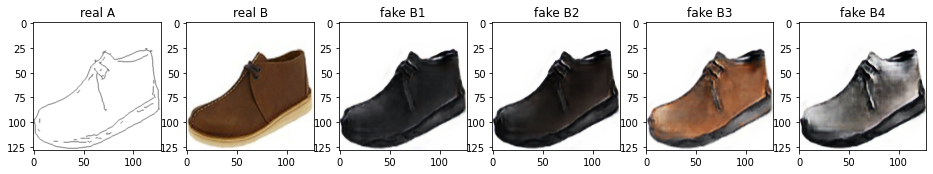

Train Epoch: 2 88% 	Total Loss: 8.033266 	Loss_GAN: 6.779243	Loss_GAN_VAE: 3.047319	Loss_GAN_LR: 1.743764	Loss_D_VAE: 0.472896	Loss_D_LR: 0.781127
1 93509 T:  3.2119600772857666
Train Epoch: 2 88% 	Total Loss: 6.449658 	Loss_GAN: 4.956544	Loss_GAN_VAE: 1.963559	Loss_GAN_LR: 1.345595	Loss_D_VAE: 0.473682	Loss_D_LR: 1.019432
1 93519 T:  2.5052850246429443
Train Epoch: 2 88% 	Total Loss: 6.635416 	Loss_GAN: 4.814663	Loss_GAN_VAE: 2.013883	Loss_GAN_LR: 1.334871	Loss_D_VAE: 0.760464	Loss_D_LR: 1.060289
1 93529 T:  2.6019930839538574
Train Epoch: 2 88% 	Total Loss: 6.720410 	Loss_GAN: 4.924536	Loss_GAN_VAE: 2.385767	Loss_GAN_LR: 1.282659	Loss_D_VAE: 0.713541	Loss_D_LR: 1.082334
1 93539 T:  2.5351059436798096
Train Epoch: 2 88% 	Total Loss: 6.667530 	Loss_GAN: 5.528877	Loss_GAN_VAE: 2.361269	Loss_GAN_LR: 1.396996	Loss_D_VAE: 0.398006	Loss_D_LR: 0.740648
1 93549 T:  2.508195161819458
Train Epoch: 2 88% 	Total Loss: 6.796567 	Loss_GAN: 5.257666	Loss_GAN_VAE: 2.660500	Loss_GAN_LR: 1.281657	Loss_

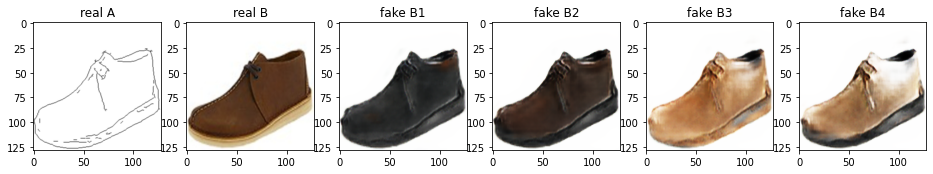

Train Epoch: 2 89% 	Total Loss: 6.645386 	Loss_GAN: 4.888034	Loss_GAN_VAE: 2.211566	Loss_GAN_LR: 1.343373	Loss_D_VAE: 0.642660	Loss_D_LR: 1.114693
1 94009 T:  3.9712278842926025
Train Epoch: 2 89% 	Total Loss: 7.004661 	Loss_GAN: 5.154308	Loss_GAN_VAE: 2.557675	Loss_GAN_LR: 1.214823	Loss_D_VAE: 0.773610	Loss_D_LR: 1.076744
1 94019 T:  2.6462810039520264
Train Epoch: 2 89% 	Total Loss: 6.342715 	Loss_GAN: 4.249561	Loss_GAN_VAE: 1.609941	Loss_GAN_LR: 1.215040	Loss_D_VAE: 0.987745	Loss_D_LR: 1.105409
1 94029 T:  2.6155128479003906
Train Epoch: 2 89% 	Total Loss: 6.702010 	Loss_GAN: 4.994395	Loss_GAN_VAE: 2.153072	Loss_GAN_LR: 1.542160	Loss_D_VAE: 0.875700	Loss_D_LR: 0.831916
1 94039 T:  2.8789901733398438
Train Epoch: 2 89% 	Total Loss: 6.359971 	Loss_GAN: 4.454372	Loss_GAN_VAE: 1.819606	Loss_GAN_LR: 1.380541	Loss_D_VAE: 1.053166	Loss_D_LR: 0.852433
1 94049 T:  2.4731204509735107
Train Epoch: 2 89% 	Total Loss: 7.070877 	Loss_GAN: 5.389227	Loss_GAN_VAE: 2.018972	Loss_GAN_LR: 1.368528	Loss

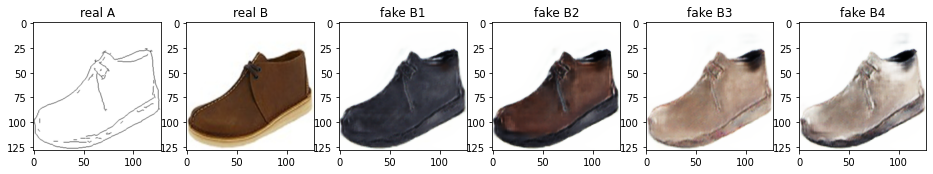

Train Epoch: 2 90% 	Total Loss: 7.649555 	Loss_GAN: 6.584165	Loss_GAN_VAE: 3.166254	Loss_GAN_LR: 1.751201	Loss_D_VAE: 0.379754	Loss_D_LR: 0.685636
1 94509 T:  3.3078219890594482
Train Epoch: 2 90% 	Total Loss: 8.072297 	Loss_GAN: 5.281301	Loss_GAN_VAE: 2.470658	Loss_GAN_LR: 1.317984	Loss_D_VAE: 1.153827	Loss_D_LR: 1.637170
1 94519 T:  2.6329450607299805
Train Epoch: 2 90% 	Total Loss: 6.855827 	Loss_GAN: 4.683053	Loss_GAN_VAE: 2.014751	Loss_GAN_LR: 1.401534	Loss_D_VAE: 0.944724	Loss_D_LR: 1.228050
1 94529 T:  2.537292242050171
Train Epoch: 2 90% 	Total Loss: 6.305823 	Loss_GAN: 4.433241	Loss_GAN_VAE: 2.032192	Loss_GAN_LR: 1.275606	Loss_D_VAE: 0.852173	Loss_D_LR: 1.020409
1 94539 T:  2.5536742210388184
Train Epoch: 2 90% 	Total Loss: 6.132930 	Loss_GAN: 4.306469	Loss_GAN_VAE: 1.523335	Loss_GAN_LR: 1.392821	Loss_D_VAE: 0.941173	Loss_D_LR: 0.885289
1 94549 T:  2.492649555206299
Train Epoch: 2 90% 	Total Loss: 6.675538 	Loss_GAN: 4.961387	Loss_GAN_VAE: 2.440770	Loss_GAN_LR: 1.369952	Loss_D

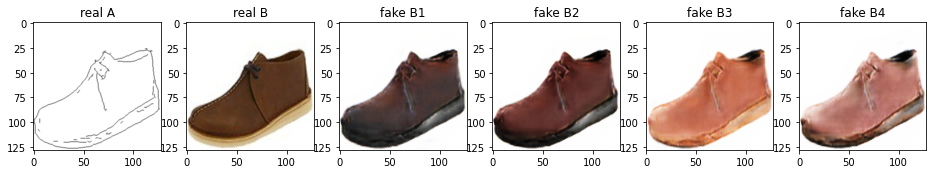

Train Epoch: 2 91% 	Total Loss: 6.105975 	Loss_GAN: 4.179652	Loss_GAN_VAE: 1.981258	Loss_GAN_LR: 0.972183	Loss_D_VAE: 0.573346	Loss_D_LR: 1.352978
1 95009 T:  4.447165250778198
Train Epoch: 2 91% 	Total Loss: 6.494110 	Loss_GAN: 4.638653	Loss_GAN_VAE: 2.229261	Loss_GAN_LR: 1.196481	Loss_D_VAE: 0.682052	Loss_D_LR: 1.173404
1 95019 T:  2.5506720542907715
Train Epoch: 2 91% 	Total Loss: 6.469617 	Loss_GAN: 4.732221	Loss_GAN_VAE: 1.941988	Loss_GAN_LR: 1.226141	Loss_D_VAE: 0.679869	Loss_D_LR: 1.057527
1 95029 T:  2.5711703300476074
Train Epoch: 2 91% 	Total Loss: 6.991296 	Loss_GAN: 4.796324	Loss_GAN_VAE: 1.927589	Loss_GAN_LR: 1.404144	Loss_D_VAE: 1.252270	Loss_D_LR: 0.942702
1 95039 T:  2.8422648906707764
Train Epoch: 2 91% 	Total Loss: 7.139535 	Loss_GAN: 5.951911	Loss_GAN_VAE: 2.658533	Loss_GAN_LR: 1.815866	Loss_D_VAE: 0.410891	Loss_D_LR: 0.776734
1 95049 T:  2.5038468837738037
Train Epoch: 2 91% 	Total Loss: 6.989809 	Loss_GAN: 5.310264	Loss_GAN_VAE: 2.326380	Loss_GAN_LR: 1.484945	Loss_

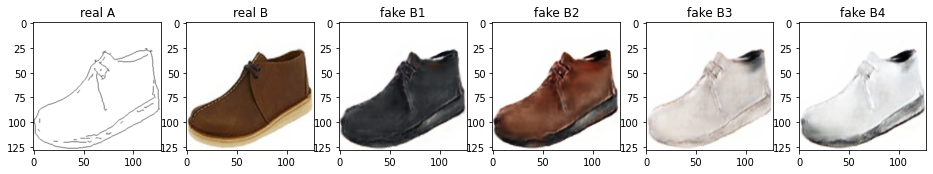

Train Epoch: 2 92% 	Total Loss: 5.864970 	Loss_GAN: 4.039507	Loss_GAN_VAE: 1.807780	Loss_GAN_LR: 1.179476	Loss_D_VAE: 0.696409	Loss_D_LR: 1.129055
1 95509 T:  3.2597663402557373
Train Epoch: 2 92% 	Total Loss: 6.585286 	Loss_GAN: 5.412326	Loss_GAN_VAE: 2.398584	Loss_GAN_LR: 1.478116	Loss_D_VAE: 0.434773	Loss_D_LR: 0.738187
1 95519 T:  2.4991111755371094
Train Epoch: 2 92% 	Total Loss: 7.026716 	Loss_GAN: 5.458925	Loss_GAN_VAE: 2.539501	Loss_GAN_LR: 1.361073	Loss_D_VAE: 0.439706	Loss_D_LR: 1.128086
1 95529 T:  2.525325059890747
Train Epoch: 2 92% 	Total Loss: 6.444181 	Loss_GAN: 5.028277	Loss_GAN_VAE: 2.480785	Loss_GAN_LR: 1.183989	Loss_D_VAE: 0.506468	Loss_D_LR: 0.909436
1 95539 T:  2.517606258392334
Train Epoch: 2 92% 	Total Loss: 7.614324 	Loss_GAN: 5.839073	Loss_GAN_VAE: 2.480422	Loss_GAN_LR: 1.603691	Loss_D_VAE: 0.846207	Loss_D_LR: 0.929044
1 95549 T:  2.4941630363464355
Train Epoch: 2 92% 	Total Loss: 7.639673 	Loss_GAN: 6.290891	Loss_GAN_VAE: 2.845327	Loss_GAN_LR: 1.709410	Loss_D

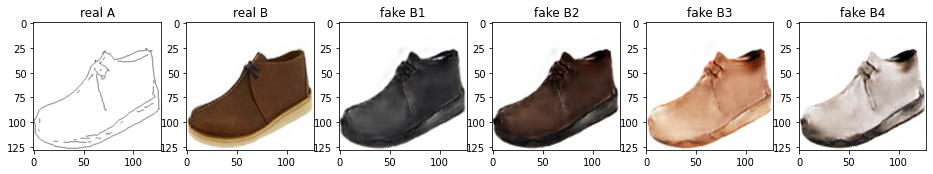

Train Epoch: 2 93% 	Total Loss: 7.005387 	Loss_GAN: 5.925993	Loss_GAN_VAE: 2.718737	Loss_GAN_LR: 1.603063	Loss_D_VAE: 0.406164	Loss_D_LR: 0.673230
1 96009 T:  4.0061047077178955
Train Epoch: 2 93% 	Total Loss: 7.381099 	Loss_GAN: 5.617365	Loss_GAN_VAE: 2.552838	Loss_GAN_LR: 1.281703	Loss_D_VAE: 0.506422	Loss_D_LR: 1.257312
1 96019 T:  2.489149332046509
Train Epoch: 2 93% 	Total Loss: 6.664514 	Loss_GAN: 4.900584	Loss_GAN_VAE: 2.111416	Loss_GAN_LR: 1.441786	Loss_D_VAE: 0.821161	Loss_D_LR: 0.942769
1 96029 T:  2.4653232097625732
Train Epoch: 2 93% 	Total Loss: 6.053948 	Loss_GAN: 4.206264	Loss_GAN_VAE: 1.765531	Loss_GAN_LR: 1.164641	Loss_D_VAE: 0.682280	Loss_D_LR: 1.165404
1 96039 T:  2.823101282119751
Train Epoch: 2 93% 	Total Loss: 7.663104 	Loss_GAN: 5.876593	Loss_GAN_VAE: 2.605367	Loss_GAN_LR: 1.635521	Loss_D_VAE: 0.569738	Loss_D_LR: 1.216774
1 96049 T:  2.4721620082855225
Train Epoch: 2 93% 	Total Loss: 5.898212 	Loss_GAN: 4.081281	Loss_GAN_VAE: 1.735368	Loss_GAN_LR: 1.167986	Loss_D

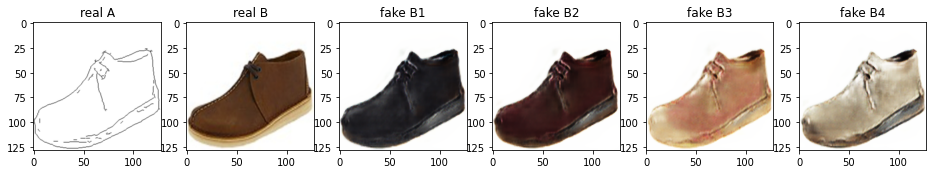

Train Epoch: 2 94% 	Total Loss: 7.210780 	Loss_GAN: 5.019021	Loss_GAN_VAE: 2.204601	Loss_GAN_LR: 1.304264	Loss_D_VAE: 0.970772	Loss_D_LR: 1.220987
1 96509 T:  3.2403204441070557
Train Epoch: 2 94% 	Total Loss: 7.147454 	Loss_GAN: 6.096994	Loss_GAN_VAE: 2.738725	Loss_GAN_LR: 1.699416	Loss_D_VAE: 0.449862	Loss_D_LR: 0.600599
1 96519 T:  2.519728899002075
Train Epoch: 2 94% 	Total Loss: 7.638898 	Loss_GAN: 5.986246	Loss_GAN_VAE: 2.658583	Loss_GAN_LR: 1.549841	Loss_D_VAE: 0.774196	Loss_D_LR: 0.878456
1 96529 T:  2.468317985534668
Train Epoch: 2 94% 	Total Loss: 6.262833 	Loss_GAN: 4.452291	Loss_GAN_VAE: 1.669960	Loss_GAN_LR: 1.525190	Loss_D_VAE: 0.976962	Loss_D_LR: 0.833580
1 96539 T:  2.566953659057617
Train Epoch: 2 94% 	Total Loss: 6.455507 	Loss_GAN: 4.958403	Loss_GAN_VAE: 2.466768	Loss_GAN_LR: 1.181520	Loss_D_VAE: 0.553358	Loss_D_LR: 0.943745
1 96549 T:  2.451554298400879
Train Epoch: 2 94% 	Total Loss: 7.732257 	Loss_GAN: 5.958782	Loss_GAN_VAE: 2.397950	Loss_GAN_LR: 1.980198	Loss_D_V

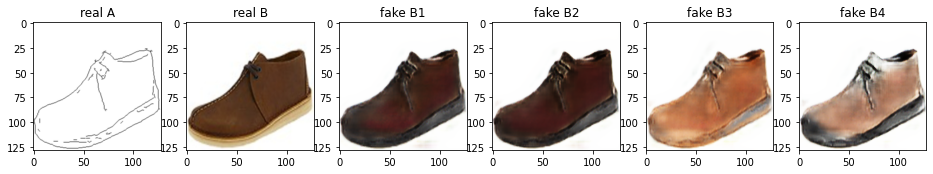

Train Epoch: 2 95% 	Total Loss: 7.201628 	Loss_GAN: 5.281437	Loss_GAN_VAE: 2.687208	Loss_GAN_LR: 1.247298	Loss_D_VAE: 0.842038	Loss_D_LR: 1.078153
1 97009 T:  3.9336588382720947
Train Epoch: 2 95% 	Total Loss: 7.644949 	Loss_GAN: 6.419405	Loss_GAN_VAE: 2.921881	Loss_GAN_LR: 1.608809	Loss_D_VAE: 0.357171	Loss_D_LR: 0.868374
1 97019 T:  2.5973470211029053
Train Epoch: 2 95% 	Total Loss: 6.740602 	Loss_GAN: 5.145606	Loss_GAN_VAE: 2.392764	Loss_GAN_LR: 1.503991	Loss_D_VAE: 0.483991	Loss_D_LR: 1.111007
1 97029 T:  2.504270315170288
Train Epoch: 2 95% 	Total Loss: 6.800671 	Loss_GAN: 4.945756	Loss_GAN_VAE: 2.517341	Loss_GAN_LR: 1.281178	Loss_D_VAE: 0.824038	Loss_D_LR: 1.030877
1 97039 T:  2.8368518352508545
Train Epoch: 2 95% 	Total Loss: 6.365736 	Loss_GAN: 4.487325	Loss_GAN_VAE: 1.700643	Loss_GAN_LR: 1.293536	Loss_D_VAE: 1.006274	Loss_D_LR: 0.872137
1 97049 T:  2.559577465057373
Train Epoch: 2 95% 	Total Loss: 7.581514 	Loss_GAN: 6.170445	Loss_GAN_VAE: 2.673022	Loss_GAN_LR: 1.751107	Loss_D

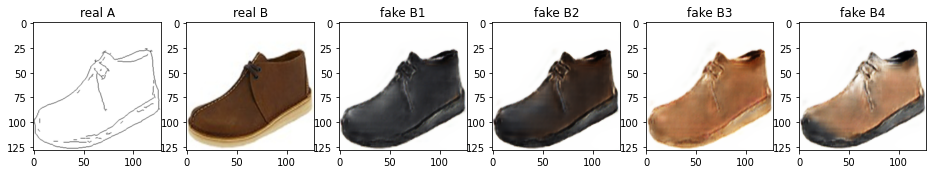

Train Epoch: 2 96% 	Total Loss: 6.548841 	Loss_GAN: 4.453569	Loss_GAN_VAE: 2.118143	Loss_GAN_LR: 1.183043	Loss_D_VAE: 0.748467	Loss_D_LR: 1.346805
1 97509 T:  3.2181663513183594
Train Epoch: 2 96% 	Total Loss: 7.533703 	Loss_GAN: 5.829616	Loss_GAN_VAE: 2.826306	Loss_GAN_LR: 1.631212	Loss_D_VAE: 0.798428	Loss_D_LR: 0.905659
1 97519 T:  2.5496366024017334
Train Epoch: 2 96% 	Total Loss: 6.414360 	Loss_GAN: 4.456590	Loss_GAN_VAE: 2.217858	Loss_GAN_LR: 1.235061	Loss_D_VAE: 0.878663	Loss_D_LR: 1.079107
1 97529 T:  2.522038459777832
Train Epoch: 2 96% 	Total Loss: 8.045109 	Loss_GAN: 6.457315	Loss_GAN_VAE: 3.063888	Loss_GAN_LR: 1.745848	Loss_D_VAE: 0.888639	Loss_D_LR: 0.699154
1 97539 T:  2.51674222946167
Train Epoch: 2 96% 	Total Loss: 6.094941 	Loss_GAN: 4.606619	Loss_GAN_VAE: 2.020447	Loss_GAN_LR: 1.278882	Loss_D_VAE: 0.582372	Loss_D_LR: 0.905950
1 97549 T:  2.4788575172424316
Train Epoch: 2 96% 	Total Loss: 6.975917 	Loss_GAN: 5.642771	Loss_GAN_VAE: 2.735329	Loss_GAN_LR: 1.564347	Loss_D_

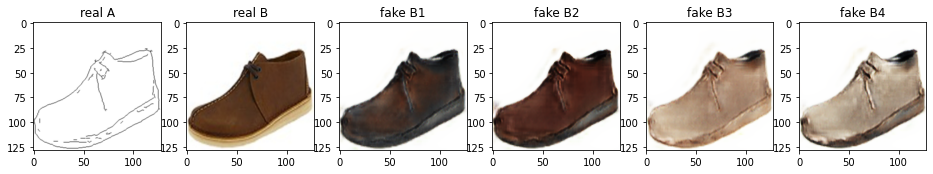

Train Epoch: 2 97% 	Total Loss: 6.562787 	Loss_GAN: 5.128058	Loss_GAN_VAE: 1.866533	Loss_GAN_LR: 1.729443	Loss_D_VAE: 0.633637	Loss_D_LR: 0.801092
1 98009 T:  4.428982496261597
Train Epoch: 2 97% 	Total Loss: 7.511912 	Loss_GAN: 5.700501	Loss_GAN_VAE: 2.475105	Loss_GAN_LR: 1.766665	Loss_D_VAE: 0.919336	Loss_D_LR: 0.892076
1 98019 T:  2.5884718894958496
Train Epoch: 2 97% 	Total Loss: 7.678756 	Loss_GAN: 6.015091	Loss_GAN_VAE: 2.697195	Loss_GAN_LR: 1.638918	Loss_D_VAE: 0.788486	Loss_D_LR: 0.875178
1 98029 T:  2.6517977714538574
Train Epoch: 2 97% 	Total Loss: 7.180294 	Loss_GAN: 5.864794	Loss_GAN_VAE: 2.703499	Loss_GAN_LR: 1.721722	Loss_D_VAE: 0.526735	Loss_D_LR: 0.788765
1 98039 T:  2.694546699523926
Train Epoch: 2 97% 	Total Loss: 6.465990 	Loss_GAN: 4.746343	Loss_GAN_VAE: 1.962486	Loss_GAN_LR: 1.475041	Loss_D_VAE: 0.761897	Loss_D_LR: 0.957750
1 98049 T:  2.520974636077881
Train Epoch: 2 97% 	Total Loss: 7.723390 	Loss_GAN: 5.577810	Loss_GAN_VAE: 2.917829	Loss_GAN_LR: 1.317174	Loss_D_

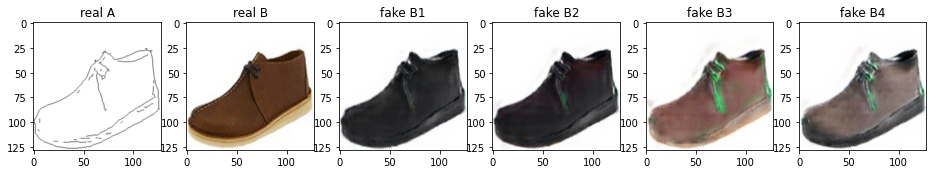

Train Epoch: 2 98% 	Total Loss: 8.320017 	Loss_GAN: 6.326411	Loss_GAN_VAE: 2.581448	Loss_GAN_LR: 1.897944	Loss_D_VAE: 0.953775	Loss_D_LR: 1.039831
1 98509 T:  3.307675361633301
Train Epoch: 2 98% 	Total Loss: 7.703886 	Loss_GAN: 5.936595	Loss_GAN_VAE: 2.441555	Loss_GAN_LR: 1.823263	Loss_D_VAE: 0.413226	Loss_D_LR: 1.354065
1 98519 T:  2.477330446243286
Train Epoch: 2 98% 	Total Loss: 6.961387 	Loss_GAN: 5.564270	Loss_GAN_VAE: 2.863840	Loss_GAN_LR: 1.344952	Loss_D_VAE: 0.488402	Loss_D_LR: 0.908715
1 98529 T:  2.541602849960327
Train Epoch: 2 98% 	Total Loss: 6.368948 	Loss_GAN: 4.831232	Loss_GAN_VAE: 2.068596	Loss_GAN_LR: 1.454326	Loss_D_VAE: 0.501120	Loss_D_LR: 1.036596
1 98539 T:  2.446549654006958
Train Epoch: 2 98% 	Total Loss: 7.449449 	Loss_GAN: 5.453084	Loss_GAN_VAE: 2.436135	Loss_GAN_LR: 1.639984	Loss_D_VAE: 0.936425	Loss_D_LR: 1.059939
1 98549 T:  2.519951820373535
Train Epoch: 2 98% 	Total Loss: 6.460489 	Loss_GAN: 4.605072	Loss_GAN_VAE: 2.067449	Loss_GAN_LR: 1.365901	Loss_D_VA

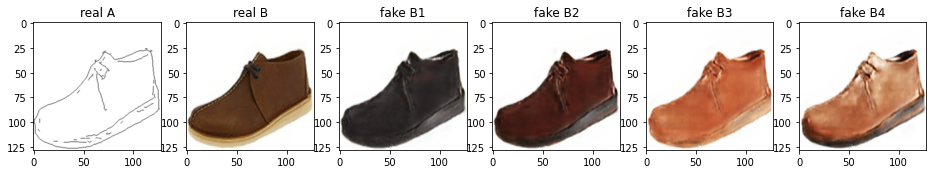

Train Epoch: 2 99% 	Total Loss: 7.223680 	Loss_GAN: 5.964381	Loss_GAN_VAE: 2.468626	Loss_GAN_LR: 1.710373	Loss_D_VAE: 0.610250	Loss_D_LR: 0.649049
1 99009 T:  3.9751696586608887
Train Epoch: 2 99% 	Total Loss: 6.314560 	Loss_GAN: 4.232040	Loss_GAN_VAE: 1.669283	Loss_GAN_LR: 1.303310	Loss_D_VAE: 1.267729	Loss_D_LR: 0.814791
1 99019 T:  2.526484966278076
Train Epoch: 2 99% 	Total Loss: 7.482121 	Loss_GAN: 5.340715	Loss_GAN_VAE: 2.251375	Loss_GAN_LR: 1.627273	Loss_D_VAE: 1.039730	Loss_D_LR: 1.101675
1 99029 T:  2.487678050994873
Train Epoch: 2 99% 	Total Loss: 6.978392 	Loss_GAN: 5.890687	Loss_GAN_VAE: 2.088513	Loss_GAN_LR: 1.847296	Loss_D_VAE: 0.458785	Loss_D_LR: 0.628920
1 99039 T:  2.8158562183380127
Train Epoch: 2 99% 	Total Loss: 7.303178 	Loss_GAN: 5.363766	Loss_GAN_VAE: 2.395865	Loss_GAN_LR: 1.260364	Loss_D_VAE: 0.932982	Loss_D_LR: 1.006430
1 99049 T:  2.516209602355957
Train Epoch: 2 99% 	Total Loss: 7.513235 	Loss_GAN: 5.460775	Loss_GAN_VAE: 2.554982	Loss_GAN_LR: 1.460075	Loss_D_

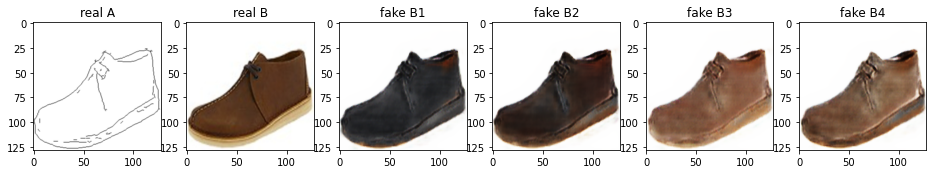

Train Epoch: 2 100% 	Total Loss: 7.023308 	Loss_GAN: 5.880993	Loss_GAN_VAE: 2.595825	Loss_GAN_LR: 1.654369	Loss_D_VAE: 0.381234	Loss_D_LR: 0.761081
1 99509 T:  3.233346939086914
Train Epoch: 2 100% 	Total Loss: 6.881403 	Loss_GAN: 4.974076	Loss_GAN_VAE: 2.267806	Loss_GAN_LR: 1.393443	Loss_D_VAE: 0.728429	Loss_D_LR: 1.178899
1 99519 T:  2.504000663757324
Train Epoch: 2 100% 	Total Loss: 5.973274 	Loss_GAN: 4.355478	Loss_GAN_VAE: 1.482811	Loss_GAN_LR: 1.462797	Loss_D_VAE: 0.807096	Loss_D_LR: 0.810699
1 99529 T:  2.599647045135498
Train Epoch: 2 100% 	Total Loss: 7.197648 	Loss_GAN: 5.833440	Loss_GAN_VAE: 2.593861	Loss_GAN_LR: 1.800376	Loss_D_VAE: 0.587176	Loss_D_LR: 0.777032
1 99539 T:  2.465466260910034
Train Epoch: 2 100% 	Total Loss: 7.295890 	Loss_GAN: 5.574259	Loss_GAN_VAE: 2.281736	Loss_GAN_LR: 1.846037	Loss_D_VAE: 0.685513	Loss_D_LR: 1.036118
1 99549 T:  2.5079164505004883
Train Epoch: 2 100% 	Total Loss: 8.339405 	Loss_GAN: 6.360127	Loss_GAN_VAE: 3.094539	Loss_GAN_LR: 1.775058	Lo

In [105]:
from torch.autograd import Variable
from torch.utils.data import DataLoader, TensorDataset
from torch import Tensor
import matplotlib.pyplot as plt


# Loss functions
mae_loss = torch.nn.L1Loss().to(device)

# Define generator, encoder and discriminators
n_residual_blocks = 6

generator = Generator(latent_dim, img_shape).to(device)
# generator = GeneratorResNet(img_shape, n_residual_blocks).to(device)
encoder = Encoder(latent_dim).to(device)
D_VAE = Discriminator().to(device)
D_LR = Discriminator().to(device)
# D_VAE = md.Discriminator(img_shape)
# D_LR = md.Discriminator(img_shape)

# Define optimizers for networks
optimizer_E = torch.optim.Adam(encoder.parameters(), lr=lr_rate, betas=betas)
optimizer_G = torch.optim.Adam(generator.parameters(), lr=lr_rate, betas=betas)
optimizer_D_VAE = torch.optim.Adam(D_VAE.parameters(), lr=lr_rate, betas=betas)
optimizer_D_LR = torch.optim.Adam(D_LR.parameters(), lr=lr_rate, betas=betas)

# For adversarial loss (optional to use)
valid_label = 1; fake_label = 0

# Training
total_steps = len(loader)*num_epochs; step = 0
start = time.time()

D_output_shape
if batch_size == 1:
  D_output_shape = (5, 5)
else:
  D_output_shape = (batch_size, 5, 5)

torch.autograd.set_detect_anomaly(True)

generator.train(); encoder.train()
D_VAE.train(); D_LR.train()

fixed_z = torch.randn(4, latent_dim).float().to(device)
fixed_z_1 = fixed_z[0].unsqueeze(0)
fixed_z_2 = fixed_z[1].unsqueeze(0)
fixed_z_3 = fixed_z[2].unsqueeze(0)
fixed_z_4 = fixed_z[3].unsqueeze(0)
fixed_edge, fixed_rgb = iter(loader).next()
fixed_A = norm(fixed_edge).to(device)
fixed_B = norm(fixed_rgb).to(device)

print(fixed_z)

for e in range(num_epochs):

    start = time.time()

    for idx, data in enumerate(loader):

      ########## Process Inputs ##########
      edge_tensor, rgb_tensor = data
      edge_tensor, rgb_tensor = norm(edge_tensor).to(device), norm(rgb_tensor).to(device)
      real_A = edge_tensor; real_B = rgb_tensor;

      # valid = Variable(Tensor(np.ones((real_A.size(0), *D_VAE.output_shape))), requires_grad=False)
      # fake = Variable(Tensor(np.zeros((real_A.size(0), *D_VAE.output_shape))), requires_grad=False)
      
      valid = torch.full(D_output_shape, valid_label, dtype=torch.float, device=device)
      fake = torch.full(D_output_shape, fake_label, dtype=torch.float, device=device)

      #-------------------------------
      #  Train Generator and Encoder
      #-------------------------------

      #-------------------------------
      #  Forward VAE
      #-------------------------------
      optimizer_G.zero_grad(); optimizer_E.zero_grad()

      z_VAE = torch.randn(batch_size, latent_dim).float().to(device)
      mu_VAE, logvar_VAE = encoder(real_B)
      encoded_z_VAE = reparam_z(z_VAE, mu_VAE.to(device), logvar_VAE.to(device))

      fake_B_VAE = generator(real_A, encoded_z_VAE)
      fake_B_prediction_VAE = D_VAE(fake_B_VAE)

      
      loss_GAN_VAE = loss_generator(fake_B_prediction_VAE, valid, criterion_GAN)
      loss_KL = (1/2) * torch.sum(torch.exp(logvar_VAE) + torch.pow(mu_VAE, 2) - 1 - logvar_VAE)
      loss_L1_VAE = criterion_L1(fake_B_VAE, real_B)

      #-------------------------------
      #  Forward LR
      #-------------------------------

      z_LR = torch.randn(batch_size, latent_dim).float().to(device)
      fake_B_LR = generator(real_A, z_LR)

      fake_B_prediction_LR = D_LR(fake_B_LR)

      loss_GAN_LR = loss_generator(fake_B_prediction_LR, valid, criterion_GAN)
      
      #-------------------------------
      #  Backwards
      #-------------------------------
      loss_GE = loss_GAN_VAE + (lambda_pixel * loss_L1_VAE) + \
                loss_GAN_LR + (lambda_kl * loss_KL)

      loss_GE.backward(retain_graph=True)
      optimizer_E.step();

      mu_LR, logvar_LR = encoder(fake_B_LR)
      encoded_z_LR = reparam_z(z_LR, mu_LR, logvar_LR)

      loss_L1_latent = criterion_L1(encoded_z_LR, z_LR)
      
      loss_latent = (lambda_latent * loss_L1_latent)
      loss_latent.backward()
      optimizer_G.step()

      #----------------------------------
      #  Train Discriminator (cVAE-GAN)
      #----------------------------------
      D_VAE.train()
      optimizer_D_VAE.zero_grad()
      loss_D_VAE = loss_discriminator(D_VAE, real_B, fake_B_VAE.detach(), valid, fake, criterion_GAN)
      
      loss_D_VAE.backward()
      optimizer_D_VAE.step()

      #---------------------------------
      #  Train Discriminator (cLR-GAN)
      #---------------------------------
      D_LR.train()
      optimizer_D_LR.zero_grad()
      loss_D_LR = loss_discriminator(D_LR, real_B, fake_B_LR.detach(), valid, fake, criterion_GAN)
      
      loss_D_LR.backward()
      optimizer_D_LR.step()

      #---------------------------------
      #  Track Running Loss
      #---------------------------------

      running_loss_total += (loss_GE + loss_D_VAE + loss_D_LR).item()
      running_loss_GAN += loss_GE.item()

      running_loss_GAN_VAE += loss_GAN_VAE.item()
      running_loss_GAN_LR += loss_GAN_LR.item()
      running_loss_L1_VAE += loss_L1_VAE.item()
      running_loss_L1_latent += loss_L1_latent.item()
      running_loss_KL += loss_KL.item()

      running_loss_D_VAE += loss_D_VAE.item()
      running_loss_D_LR += loss_D_LR.item()
    
      """ Optional TODO: 
        1. You may want to visualize results during training for debugging purpose
        2. Save your model every few iterations
      """
      if step % report_feq == report_feq-1:
            print('Train Epoch: {} {:.0f}% \tTotal Loss: {:.6f} \tLoss_GAN: {:.6f}\tLoss_GAN_VAE: {:.6f}\tLoss_GAN_LR: {:.6f}\tLoss_D_VAE: {:.6f}\tLoss_D_LR: {:.6f}'.format
                    (e+1, 100. * idx / len(loader), running_loss_total / report_feq, 
                    running_loss_GAN/report_feq, running_loss_GAN_VAE/report_feq, 
                    running_loss_GAN_LR/report_feq, running_loss_D_VAE/report_feq, 
                    running_loss_D_LR/report_feq))
            
            running_loss_total_list.append(running_loss_total / report_feq)
            running_loss_GAN_list.append(running_loss_GAN / report_feq)

            running_loss_GAN_VAE_list.append(running_loss_GAN_VAE / report_feq)
            running_loss_GAN_LR_list.append(running_loss_GAN_LR / report_feq)
            running_loss_L1_VAE_list.append(running_loss_L1_VAE / report_feq)
            running_loss_L1_latent_list.append(running_loss_L1_latent / report_feq)
            running_loss_KL_list.append(running_loss_KL / report_feq)

            running_loss_D_VAE_list.append(running_loss_D_VAE / report_feq)
            running_loss_D_LR_list.append(running_loss_D_LR / report_feq)

            running_loss_total = 0
            running_loss_GAN = 0

            running_loss_GAN_VAE = 0
            running_loss_GAN_LR = 0
            running_loss_L1_VAE = 0
            running_loss_L1_latent = 0
            running_loss_KL = 0

            running_loss_D_VAE = 0
            running_loss_D_LR = 0

            end = time.time()
            print(e, step, 'T: ', end-start)
            start = end

      if step % visual_feq == 0:
            vis_real_A = denorm(fixed_A[0].detach()).cpu().data.numpy().astype(np.uint8)
            vis_real_B = denorm(fixed_B[0].detach()).cpu().data.numpy().astype(np.uint8)
            vis_fake_B1 = denorm(generator(fixed_A, fixed_z_1)[0].detach()).cpu().data.numpy().astype(np.uint8)
            vis_fake_B2 = denorm(generator(fixed_A, fixed_z_2)[0].detach()).cpu().data.numpy().astype(np.uint8)
            vis_fake_B3 = denorm(generator(fixed_A, fixed_z_3)[0].detach()).cpu().data.numpy().astype(np.uint8)
            vis_fake_B4 = denorm(generator(fixed_A, fixed_z_4)[0].detach()).cpu().data.numpy().astype(np.uint8)
            fig, axs = plt.subplots(1,6, figsize = (16,16))	
            
            axs[0].imshow(vis_real_A.transpose(1,2,0))
            axs[0].set_title('real A')

            axs[1].imshow(vis_real_B.transpose(1,2,0))
            axs[1].set_title('real B')

            axs[2].imshow(vis_fake_B1.transpose(1,2,0))
            axs[2].set_title('fake B1')

            axs[3].imshow(vis_fake_B2.transpose(1,2,0))
            axs[3].set_title('fake B2')

            axs[4].imshow(vis_fake_B3.transpose(1,2,0))
            axs[4].set_title('fake B3')

            axs[5].imshow(vis_fake_B4.transpose(1,2,0))
            axs[5].set_title('fake B4')

            plt.show()
      
      if step % save_feq == save_feq-1:
          if not os.path.exists('models'): os.mkdir('models')
          torch.save(generator, './models/generator.pt')
          torch.save(encoder, './models/encoder.pt')
          torch.save(D_VAE, './models/D_VAE.pt')
          torch.save(D_LR, './models/D_LR.pt')

      step += 1



In [1]:
'''
      #-------------------------------
      #  Forward VAE
      #-------------------------------
      z = torch.randn(batch_size, latent_dim).float().to(device)
      mu_VAE, logvar_VAE = encoder(real_B)
      encoded_z_VAE = reparam_z(z, mu_VAE.to(device), logvar_VAE.to(device))
    
      fake_B_VAE = generator(real_A, encoded_z_VAE)
      fake_B_prediction_VAE = D_VAE(fake_B_VAE)
    
      #-------------------------------
      #  Forward LR
      #-------------------------------
      fake_B_LR = generator(real_A, z)

      mu_LR, logvar_LR = encoder(fake_B_LR)
      encoded_z_LR = reparam_z(z, mu_LR, logvar_LR)

      fake_B_prediction_LR = D_LR(fake_B_LR)

      #-------------------------------
      #  Train Generator and Encoder
      #-------------------------------
      generator.train(); encoder.train()
      optimizer_G.zero_grad(); optimizer_E.zero_grad()
    
      loss_GAN_VAE = loss_generator(fake_B_prediction_VAE, valid, criterion_GAN)
      loss_GAN_LR = loss_generator(fake_B_prediction_LR, valid, criterion_GAN)

      loss_L1_VAE = criterion_L1(fake_B_VAE, real_B)
      loss_L1_latent = criterion_L1(encoded_z_LR, z)

      loss_KL = (1/2) * torch.sum(torch.exp(logvar_VAE) + torch.pow(mu_VAE, 2) - 1 - logvar_VAE)
    
      loss_GE = loss_GAN_VAE + (lambda_pixel * loss_L1_VAE) + \
                loss_GAN_LR + (lambda_kl * loss_KL)
      
      loss_GE.backward()
      optimizer_E.step();
      
      loss_latent = (lambda_latent * loss_L1_latent)
      loss_latent.backward()
      optimizer_G.step()

      #----------------------------------
      #  Train Discriminator (cVAE-GAN)
      #----------------------------------
      D_VAE.train()
      optimizer_D_VAE.zero_grad()
      loss_D_VAE, _ = loss_discriminator(D_VAE, real_B, generator, z, valid, fake, valid, criterion_GAN)
      
      loss_D_VAE.backward()
      optimizer_VAE.step()

      #---------------------------------
      #  Train Discriminator (cLR-GAN)
      #---------------------------------
      D_LR.train()
      loss_D_LR, _ = loss_discriminator(D_LR, real_B, generator, z, valid, fake, valid, criterion_GAN)
      
      loss_D_LR.backward()
      optimizer_LR.step()
'''

'\n      #-------------------------------\n      #  Forward VAE\n      #-------------------------------\n      z = torch.randn(batch_size, latent_dim).float().to(device)\n      mu_VAE, logvar_VAE = encoder(real_B)\n      encoded_z_VAE = reparam_z(z, mu_VAE.to(device), logvar_VAE.to(device))\n    \n      fake_B_VAE = generator(real_A, encoded_z_VAE)\n      fake_B_prediction_VAE = D_VAE(fake_B_VAE)\n    \n      #-------------------------------\n      #  Forward LR\n      #-------------------------------\n      fake_B_LR = generator(real_A, z)\n\n      mu_LR, logvar_LR = encoder(fake_B_LR)\n      encoded_z_LR = reparam_z(z, mu_LR, logvar_LR)\n\n      fake_B_prediction_LR = D_LR(fake_B_LR)\n\n      #-------------------------------\n      #  Train Generator and Encoder\n      #-------------------------------\n      generator.train(); encoder.train()\n      optimizer_G.zero_grad(); optimizer_E.zero_grad()\n    \n      loss_GAN_VAE = loss_generator(fake_B_prediction_VAE, valid, criterion_GAN)